In [1]:
import numpy as np
import torch as t

import matplotlib.pyplot as plt
from IPython.display import clear_output, display

from torch.nn import Sequential, Linear, ReLU, LeakyReLU, Dropout, Sigmoid, Tanh

In [2]:
%matplotlib inline

In [3]:
device=t.device('cpu') #Overrride the above device choice

### Generate the sample 2D distribution: uniform from unit circle.  

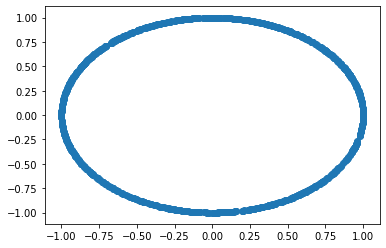

In [4]:
angle = np.random.uniform(-np.pi,np.pi,(1000,1)).astype('float32')
data = np.concatenate((np.cos(angle), np.sin(angle)),axis=1)
plt.scatter(data[:,0], data[:,1])

### GAN implementation

In [5]:
discriminator = Sequential(
    Linear(2,100),  
    LeakyReLU(0.2),
    
    Linear(100,50),  
    LeakyReLU(0.2),
       
    Linear(50, 25), 
    LeakyReLU(0.2),
    
    Linear(25, 1), 
    Sigmoid()
)

In [6]:
generator = Sequential(
    Linear(2,250),
    Dropout(0.5),
    LeakyReLU(0.1),
        
    Linear(250,125),
    Dropout(0.5),
    LeakyReLU(0.1),
    
    Linear(125,75),
    Dropout(0.5),
    LeakyReLU(0.1),
    
    Linear(75, 2),    
)

## Starting here

In [7]:
def real_data_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = t.ones(size, 1)

    return data

def fake_data_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = t.zeros(size, 1)

    return data

In [8]:
def train_discriminator(optimizer, real_data, fake_data):
    # Reset gradients
    optimizer.zero_grad()
    
    # Train on Real Data
    prediction_real = discriminator(real_data)
    
    # Calculate error and backpropagate
    error_real = loss(prediction_real, real_data_target(real_data.size(0)))
    error_real.backward()

    # Train on Fake Data
    prediction_fake = discriminator(fake_data)
    
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, fake_data_target(real_data.size(0)))
    error_fake.backward()
    
    # Update weights with gradients
    optimizer.step()
    
    # Return error
    return error_real + error_fake

In [9]:
def train_generator(optimizer, fake_data):
    # Train Generator
    
    # Reset gradients
    optimizer.zero_grad()
    
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    
    # Calculate error and backpropagate
    error = loss(prediction, real_data_target(prediction.size(0)))
    error.backward()
    
    # Update weights with gradients
    optimizer.step()
    
    # Return error
    return error

In [10]:
def show(noise, fake, real):
    
    fig, axs = plt.subplots(1,3, figsize = (12,4))
    
    for ax in axs:
        ax.set_xlim(-1.5, 1.5)
        ax.set_ylim((-1.5,1.5))
    
    axs[0].set_title("noise")
    axs[1].set_title("fake")
    axs[2].set_title("real")
    
    axs[0].scatter(noise.data.cpu().numpy()[:,0],noise.data.cpu().numpy()[:,1], color = 'gray')
    axs[1].scatter(fake.data.cpu().numpy()[:,0], fake.data.cpu().numpy()[:,1], color = 'red')
    axs[2].scatter(real.data.cpu().numpy()[:,0], real.data.cpu().numpy()[:,1], color = 'green')

    fig.tight_layout()
    plt.show()

## Starting the training:

In [11]:
discriminator = discriminator.to(device) 
generator= generator.to(device)

d_optimizer = t.optim.Adam(discriminator.parameters(), lr=0.00005)
g_optimizer = t.optim.Adam(generator.parameters(), lr=0.00005)

loss = t.nn.BCELoss()

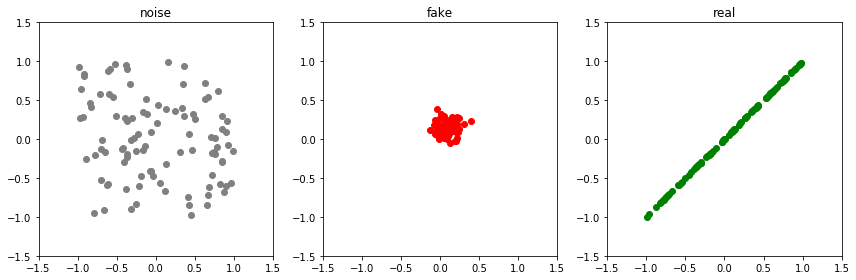

Epoch: 0 G-error: 0.6745128035545349 D-error: 1.3886547088623047


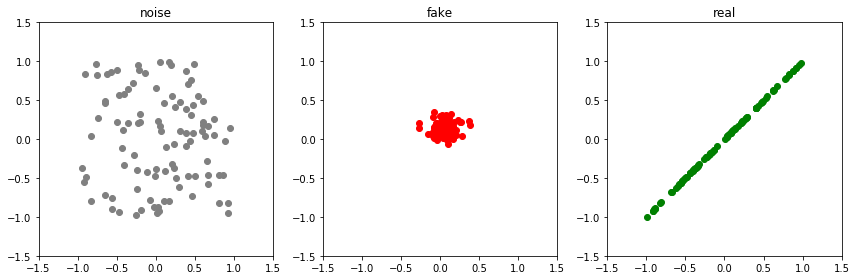

Epoch: 50 G-error: 0.6804520487785339 D-error: 1.3794500827789307


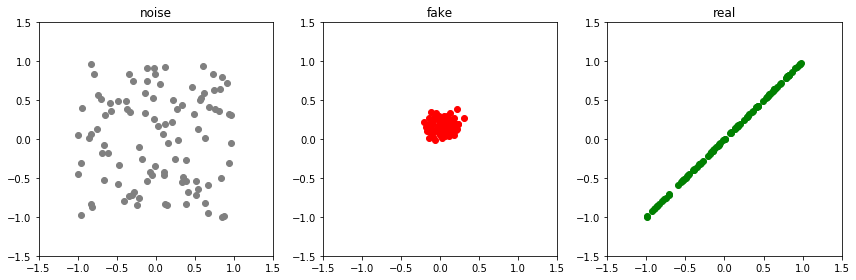

Epoch: 100 G-error: 0.6856299042701721 D-error: 1.3675317764282227


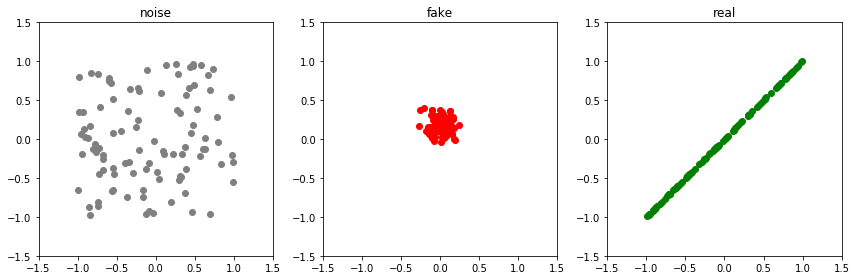

Epoch: 150 G-error: 0.6935781240463257 D-error: 1.349604845046997


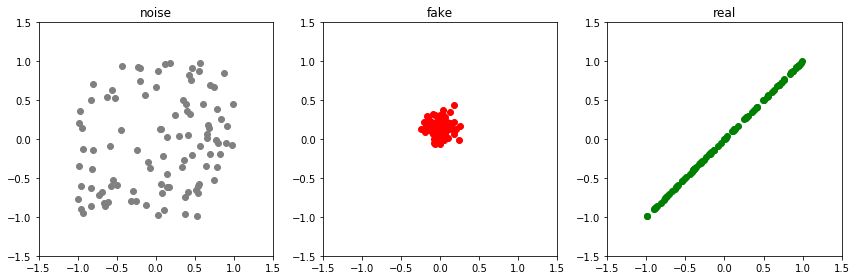

Epoch: 200 G-error: 0.70979905128479 D-error: 1.3279426097869873


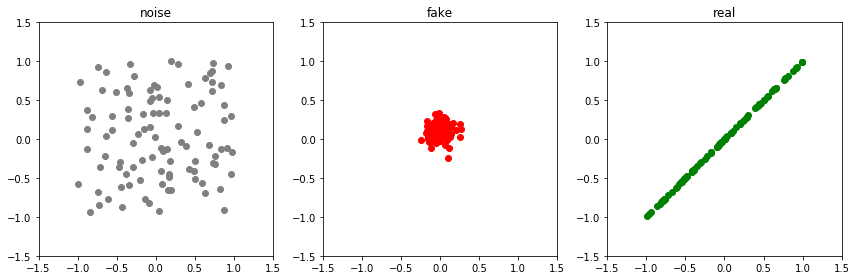

Epoch: 250 G-error: 0.7236229777336121 D-error: 1.3079484701156616


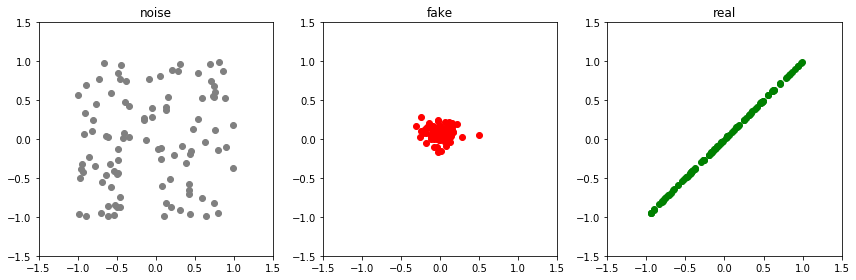

Epoch: 300 G-error: 0.7429267168045044 D-error: 1.2854137420654297


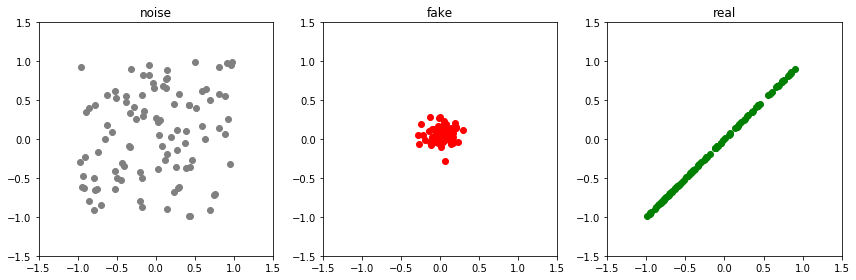

Epoch: 350 G-error: 0.7646425366401672 D-error: 1.2347427606582642


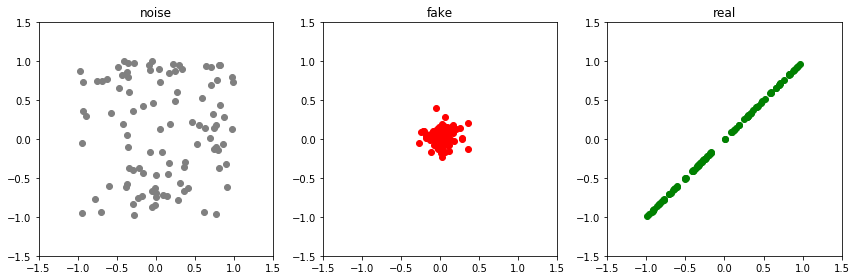

Epoch: 400 G-error: 0.7907938361167908 D-error: 1.2089600563049316


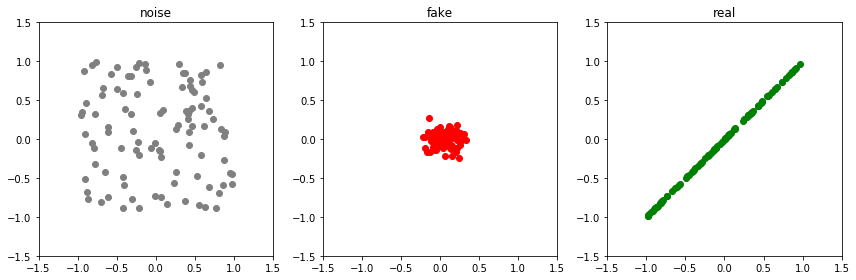

Epoch: 450 G-error: 0.8155264854431152 D-error: 1.1837519407272339


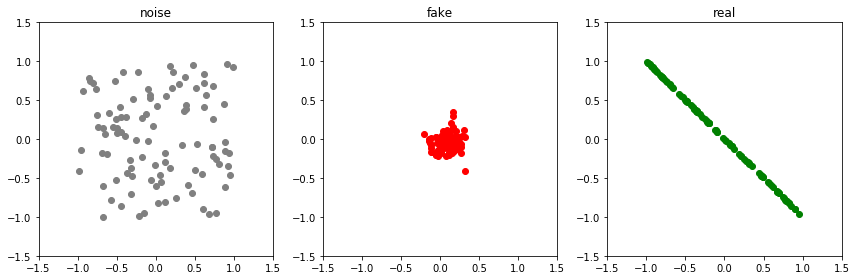

Epoch: 500 G-error: 0.8353983163833618 D-error: 1.3802571296691895


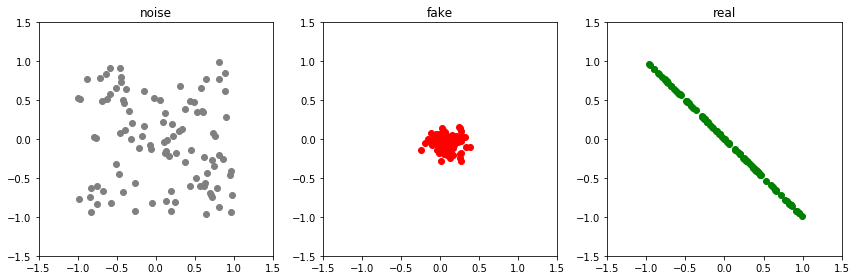

Epoch: 550 G-error: 0.7712463140487671 D-error: 1.3107867240905762


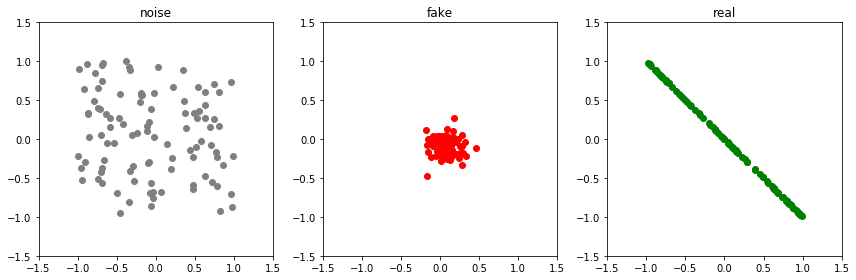

Epoch: 600 G-error: 0.784434974193573 D-error: 1.2644882202148438


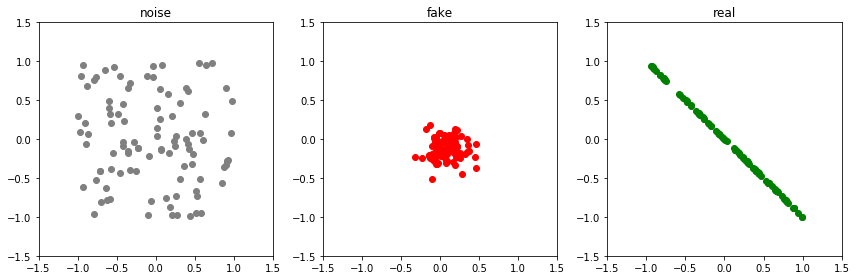

Epoch: 650 G-error: 0.7808369994163513 D-error: 1.2506924867630005


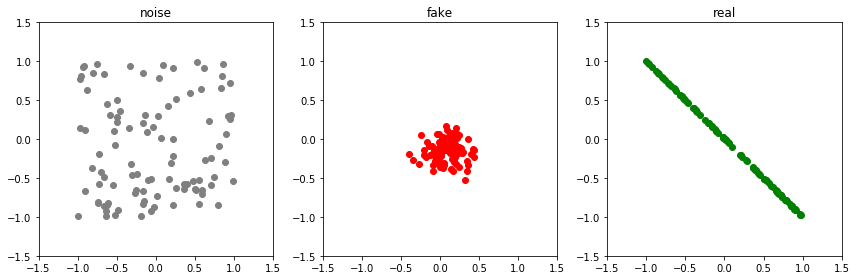

Epoch: 700 G-error: 0.8075063228607178 D-error: 1.1806442737579346


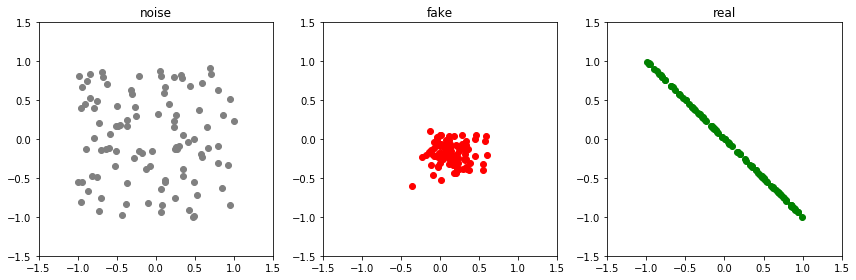

Epoch: 750 G-error: 0.8268783092498779 D-error: 1.151867389678955


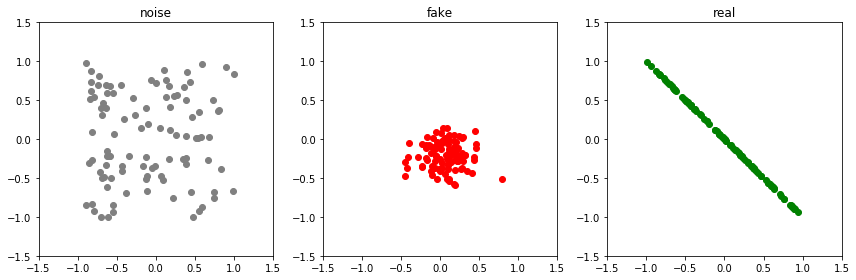

Epoch: 800 G-error: 0.8590766787528992 D-error: 1.1482549905776978


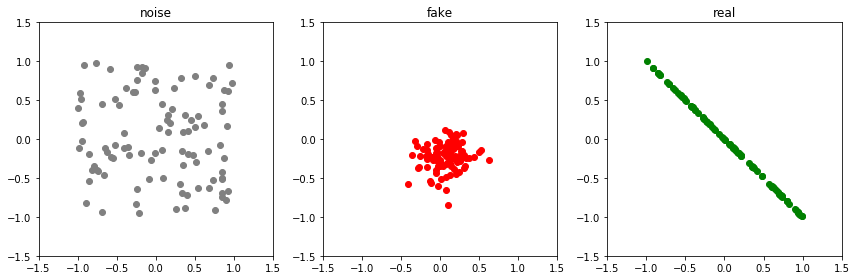

Epoch: 850 G-error: 0.8912143707275391 D-error: 1.0910216569900513


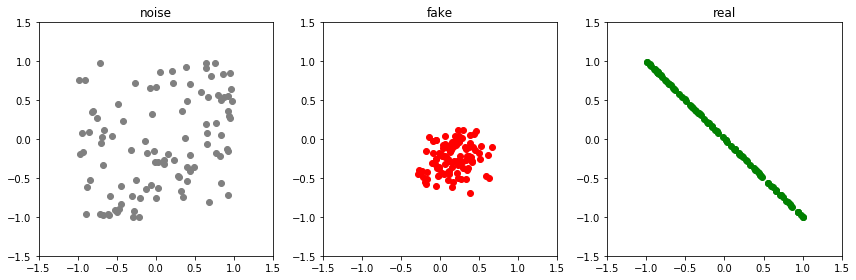

Epoch: 900 G-error: 0.9549617171287537 D-error: 1.0105719566345215


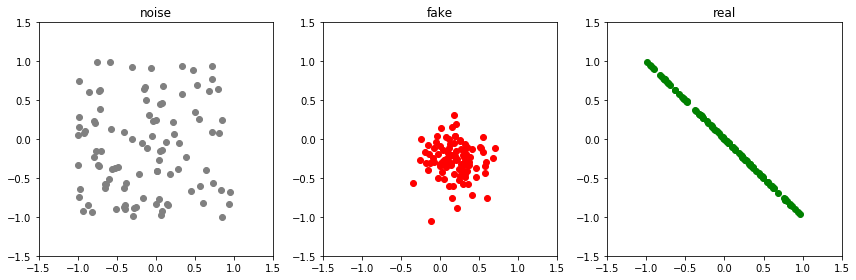

Epoch: 950 G-error: 0.9418102502822876 D-error: 1.0898123979568481


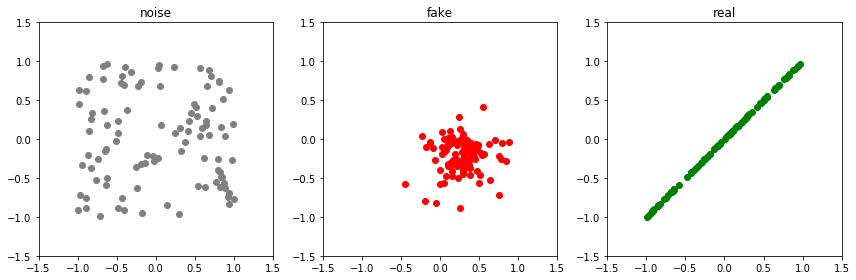

Epoch: 1000 G-error: 1.0232008695602417 D-error: 1.130458950996399


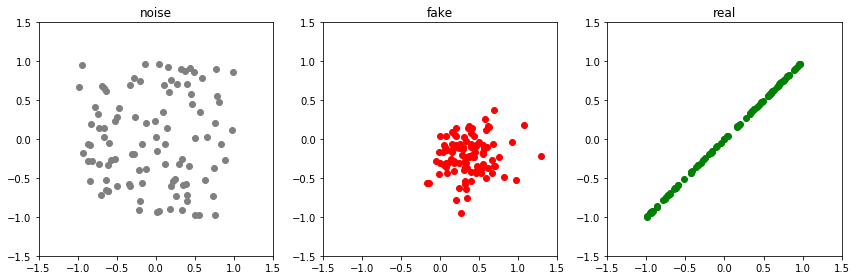

Epoch: 1050 G-error: 1.038158893585205 D-error: 0.8852012157440186


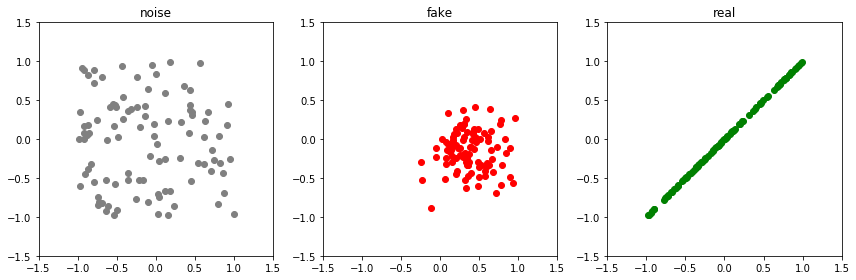

Epoch: 1100 G-error: 1.0741827487945557 D-error: 0.8748580813407898


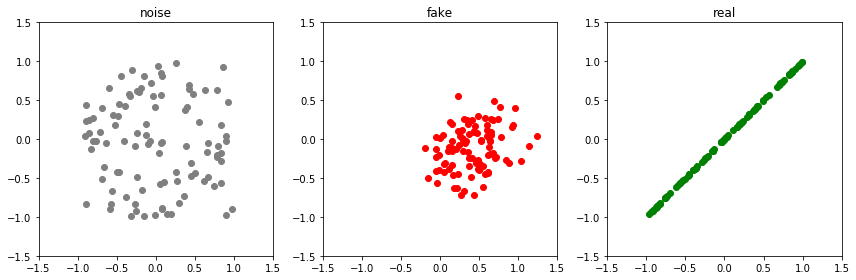

Epoch: 1150 G-error: 1.1665947437286377 D-error: 0.7760628461837769


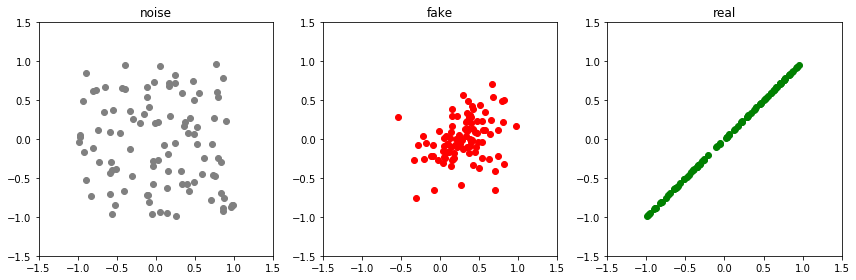

Epoch: 1200 G-error: 1.2247353792190552 D-error: 0.9174380302429199


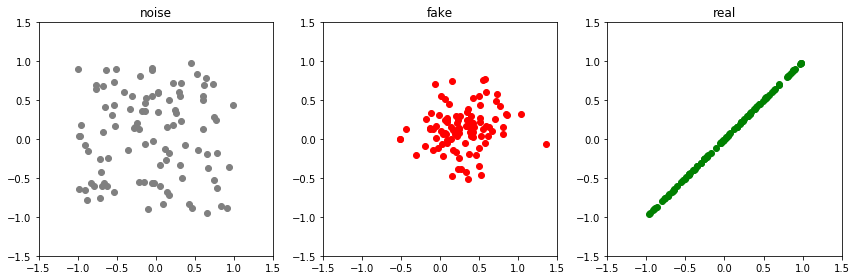

Epoch: 1250 G-error: 1.1566476821899414 D-error: 1.064445972442627


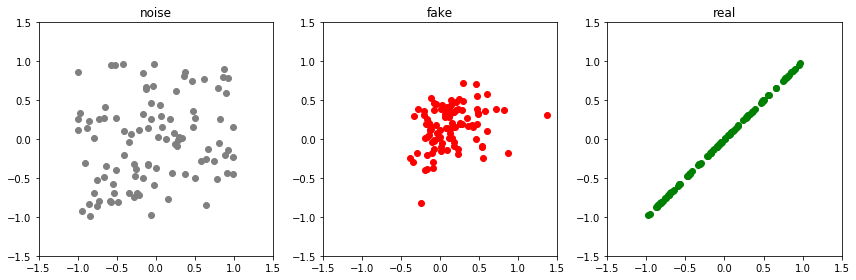

Epoch: 1300 G-error: 0.9590537548065186 D-error: 1.240628957748413


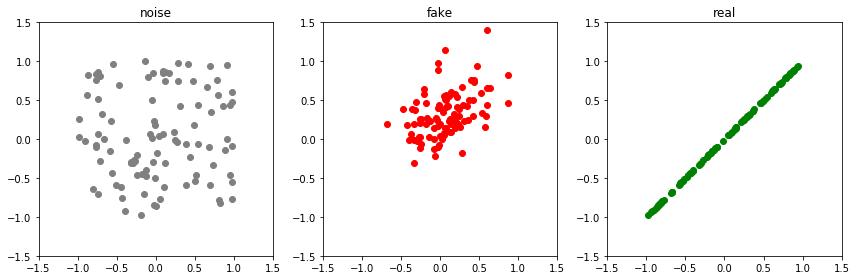

Epoch: 1350 G-error: 0.8900315165519714 D-error: 1.4447293281555176


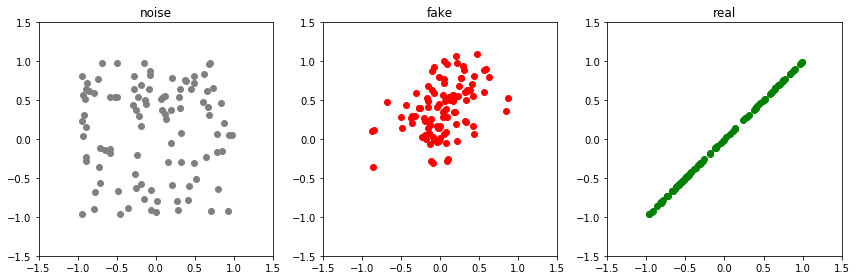

Epoch: 1400 G-error: 0.7967647314071655 D-error: 1.3358607292175293


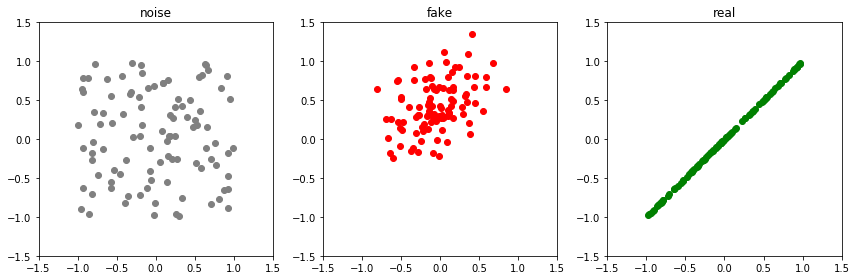

Epoch: 1450 G-error: 0.8486981391906738 D-error: 1.3701560497283936


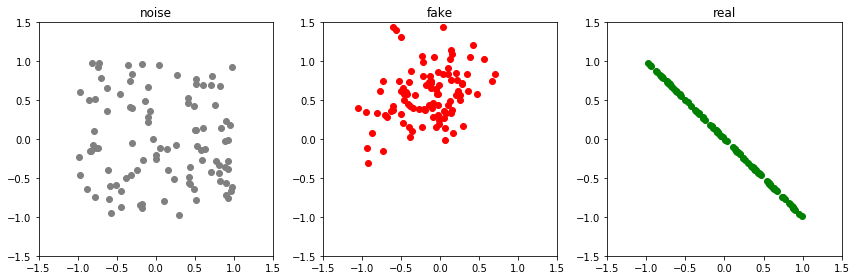

Epoch: 1500 G-error: 0.9038998484611511 D-error: 1.3561358451843262


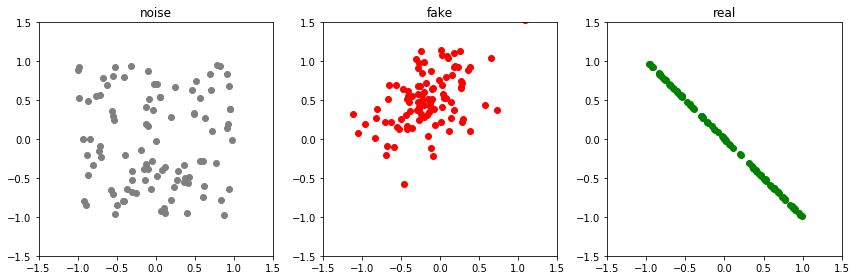

Epoch: 1550 G-error: 1.0168328285217285 D-error: 1.1258091926574707


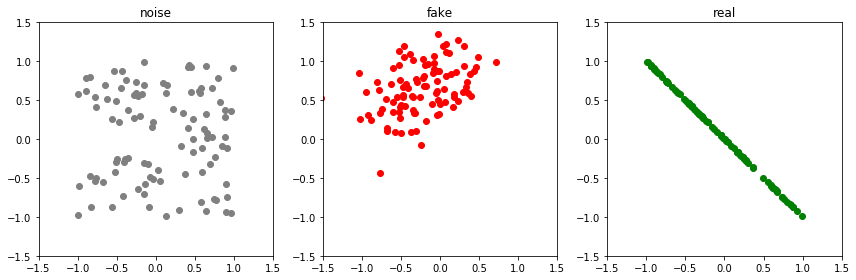

Epoch: 1600 G-error: 1.0807980298995972 D-error: 1.0762678384780884


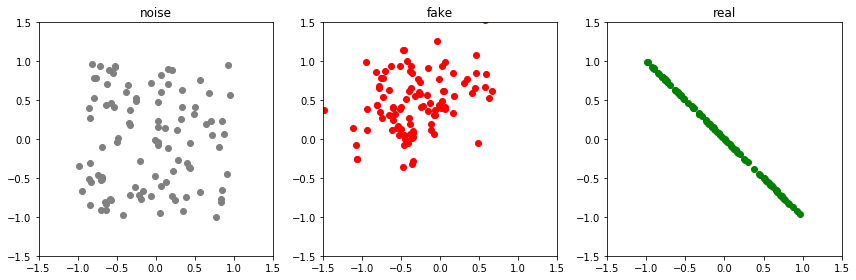

Epoch: 1650 G-error: 1.1120398044586182 D-error: 1.2283830642700195


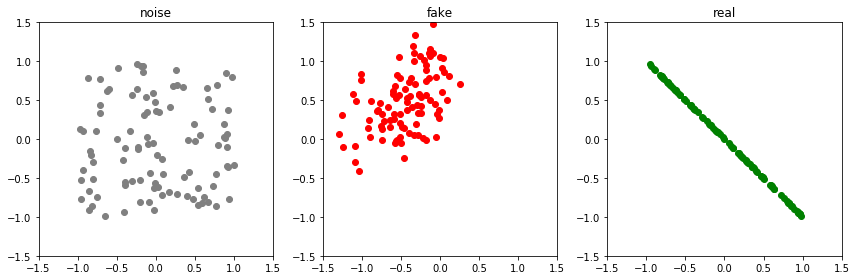

Epoch: 1700 G-error: 1.0486750602722168 D-error: 1.1750537157058716


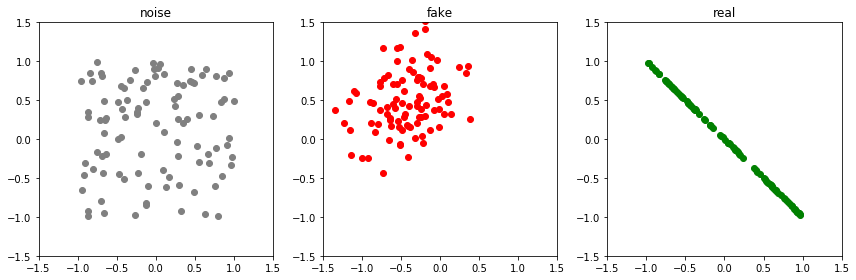

Epoch: 1750 G-error: 0.9455554485321045 D-error: 1.1363420486450195


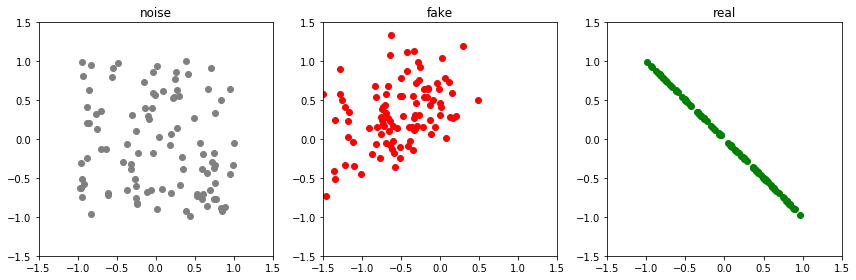

Epoch: 1800 G-error: 0.93854820728302 D-error: 1.2302978038787842


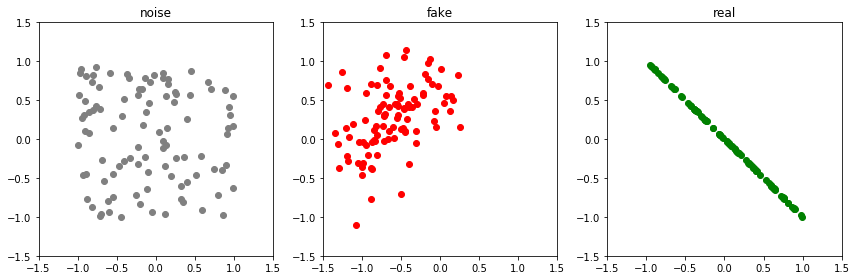

Epoch: 1850 G-error: 0.9591938257217407 D-error: 1.2481410503387451


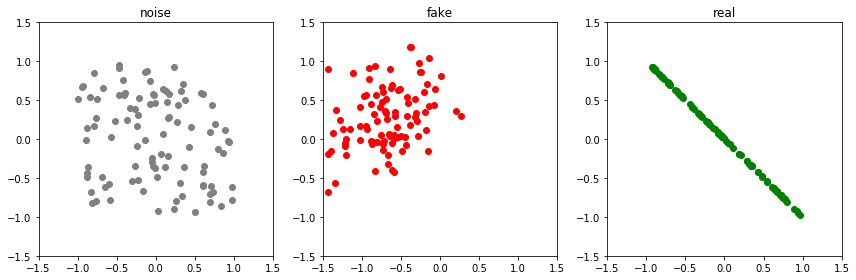

Epoch: 1900 G-error: 0.9757899641990662 D-error: 1.2151567935943604


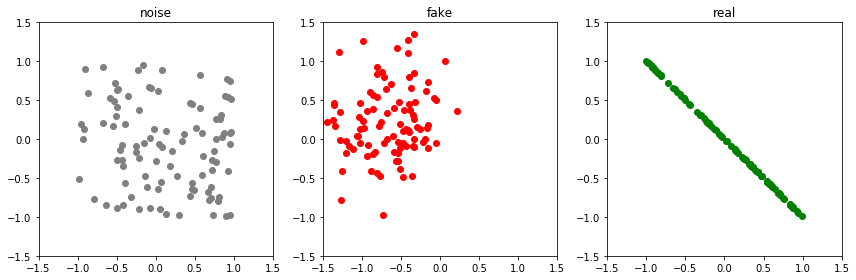

Epoch: 1950 G-error: 0.9487455487251282 D-error: 1.0906610488891602


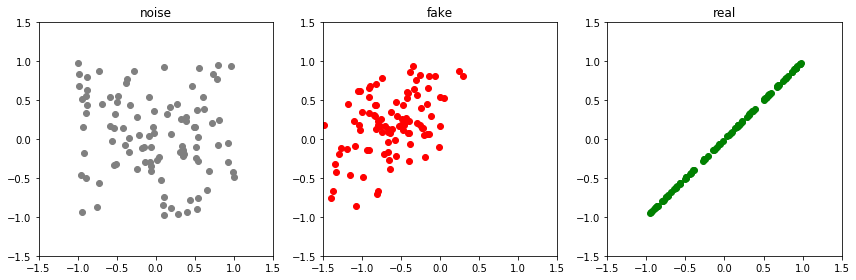

Epoch: 2000 G-error: 1.024877667427063 D-error: 1.0250394344329834


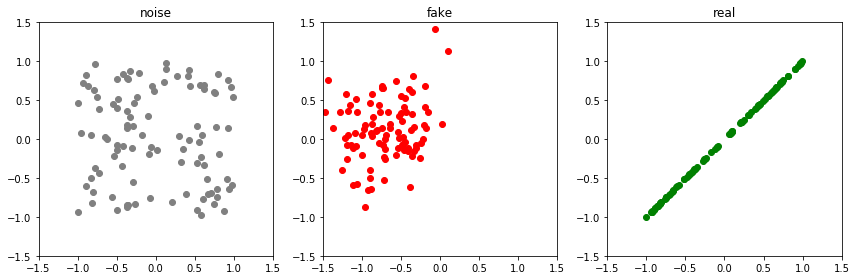

Epoch: 2050 G-error: 1.1340843439102173 D-error: 0.7870590686798096


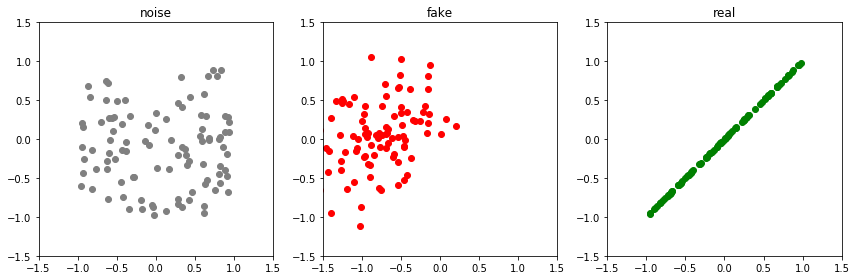

Epoch: 2100 G-error: 1.4605079889297485 D-error: 0.6740055084228516


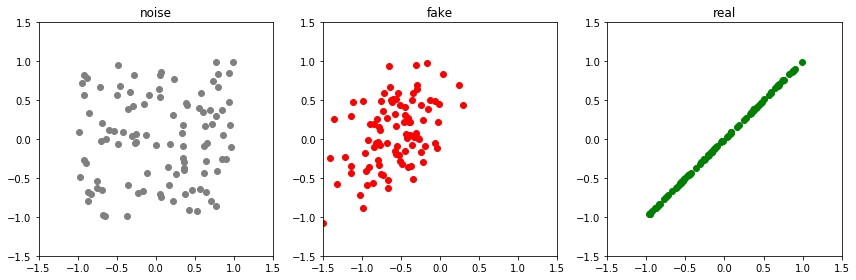

Epoch: 2150 G-error: 1.5634472370147705 D-error: 0.645543098449707


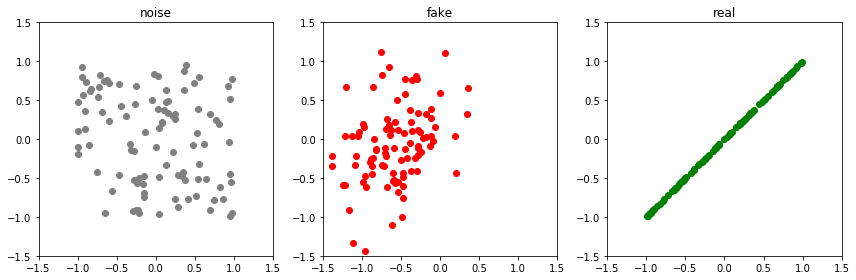

Epoch: 2200 G-error: 1.5726245641708374 D-error: 0.7726669907569885


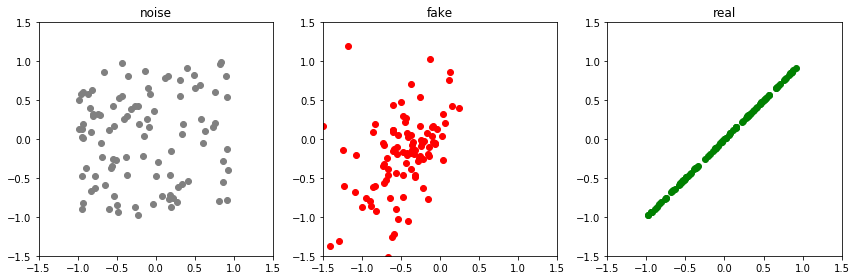

Epoch: 2250 G-error: 1.4118815660476685 D-error: 1.0287775993347168


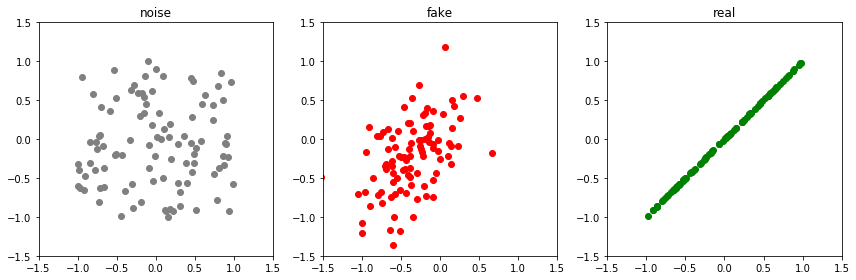

Epoch: 2300 G-error: 1.401780366897583 D-error: 1.2461236715316772


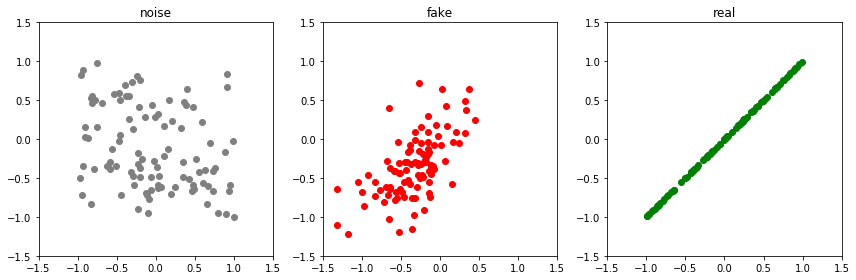

Epoch: 2350 G-error: 1.113815426826477 D-error: 1.3757250308990479


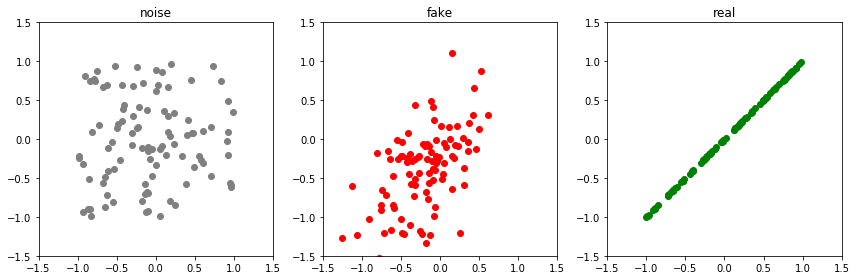

Epoch: 2400 G-error: 0.8170141577720642 D-error: 1.5945186614990234


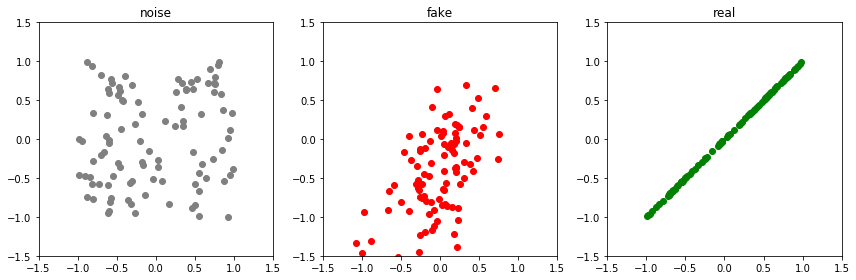

Epoch: 2450 G-error: 0.6309128403663635 D-error: 1.827115774154663


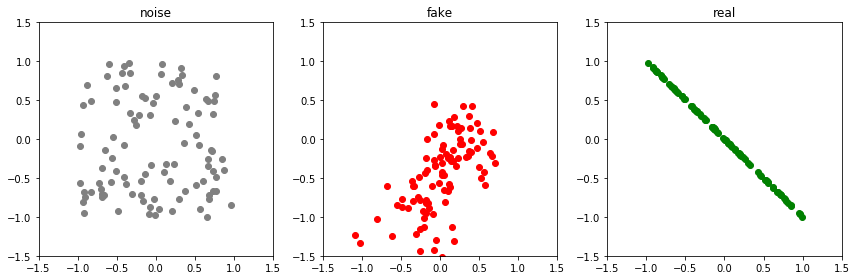

Epoch: 2500 G-error: 0.6299924850463867 D-error: 2.0330989360809326


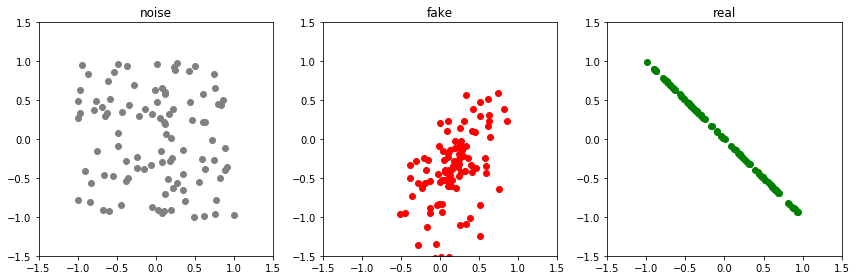

Epoch: 2550 G-error: 0.783491849899292 D-error: 1.6295151710510254


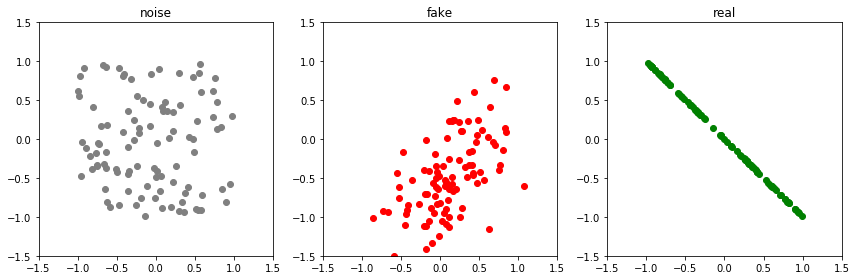

Epoch: 2600 G-error: 0.9605903029441833 D-error: 1.3406727313995361


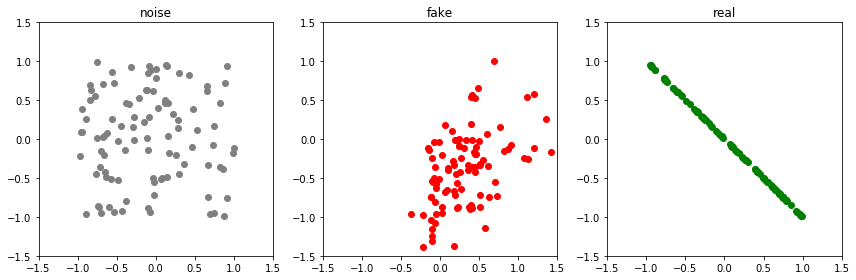

Epoch: 2650 G-error: 0.9322518706321716 D-error: 1.316514015197754


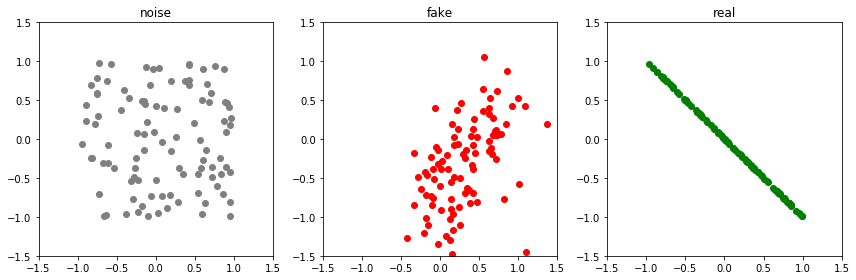

Epoch: 2700 G-error: 0.9185178875923157 D-error: 1.3080633878707886


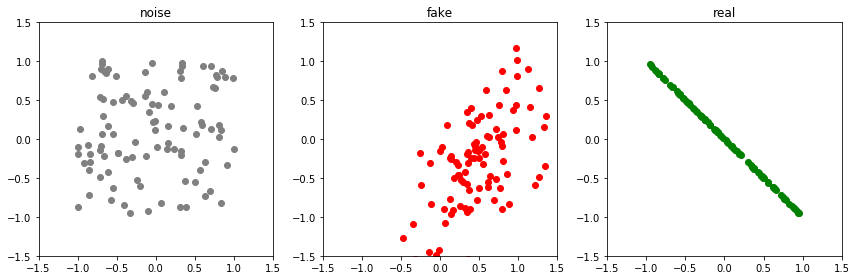

Epoch: 2750 G-error: 0.9376766681671143 D-error: 1.3435251712799072


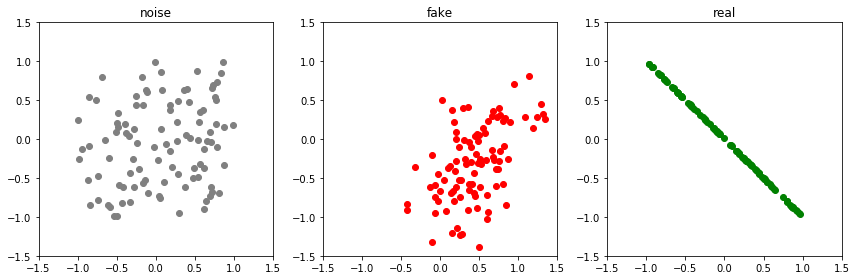

Epoch: 2800 G-error: 0.9402816295623779 D-error: 1.2493164539337158


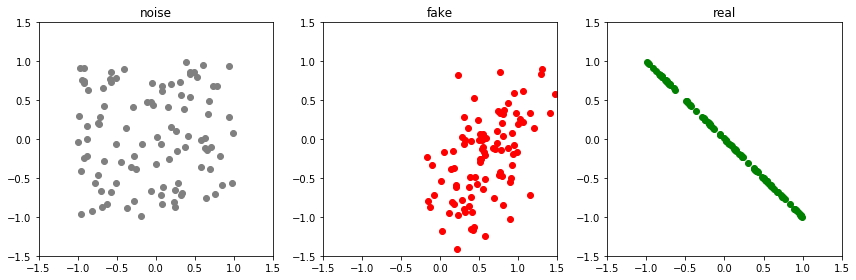

Epoch: 2850 G-error: 0.9262737035751343 D-error: 1.2056572437286377


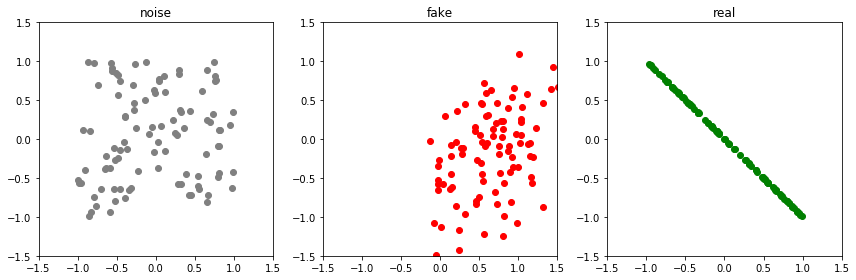

Epoch: 2900 G-error: 0.9297172427177429 D-error: 1.1658060550689697


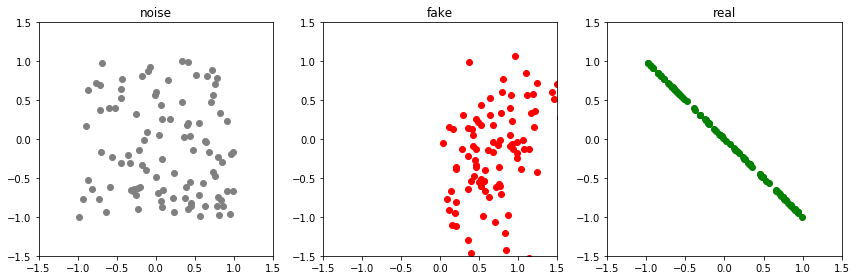

Epoch: 2950 G-error: 1.0042920112609863 D-error: 1.0548804998397827


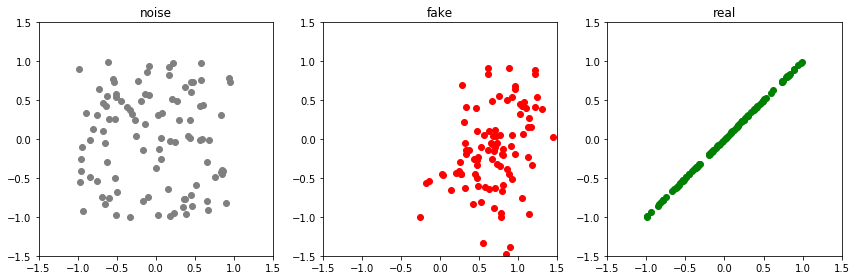

Epoch: 3000 G-error: 1.079350233078003 D-error: 1.1655040979385376


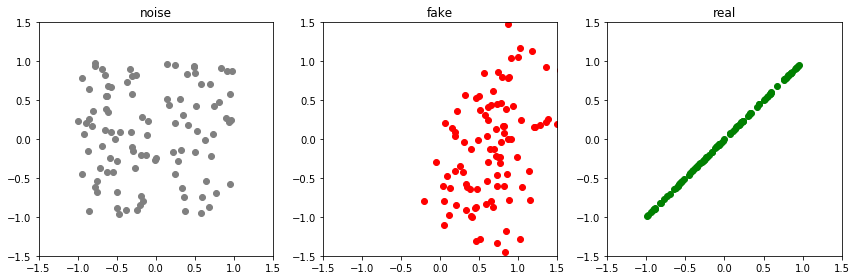

Epoch: 3050 G-error: 1.1708062887191772 D-error: 0.9790145754814148


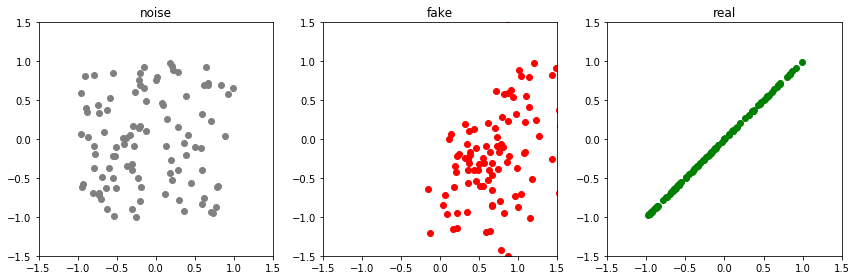

Epoch: 3100 G-error: 1.3172781467437744 D-error: 0.6947654485702515


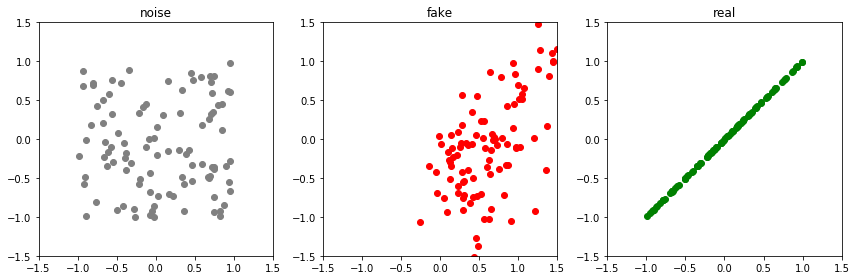

Epoch: 3150 G-error: 1.4958752393722534 D-error: 0.7406546473503113


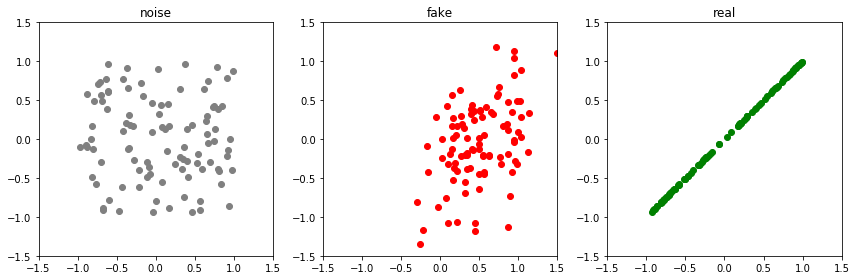

Epoch: 3200 G-error: 1.4112727642059326 D-error: 0.7581377625465393


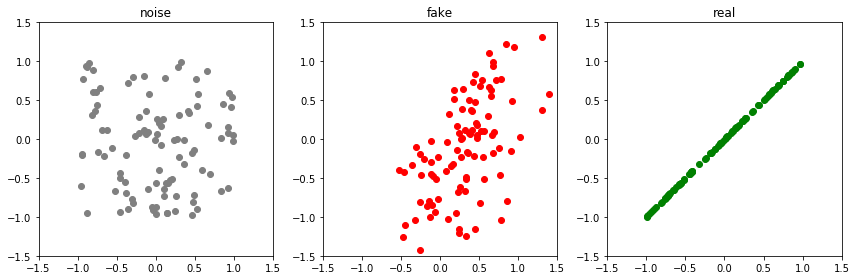

Epoch: 3250 G-error: 1.515386939048767 D-error: 1.0066519975662231


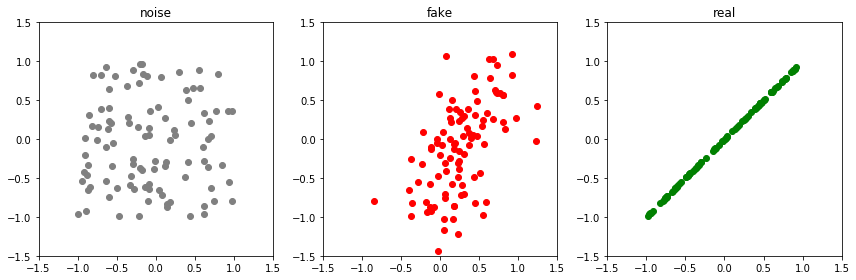

Epoch: 3300 G-error: 1.2336382865905762 D-error: 1.0219433307647705


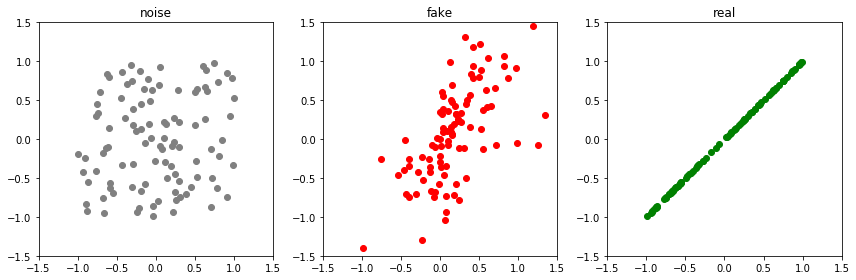

Epoch: 3350 G-error: 1.1402945518493652 D-error: 1.4049404859542847


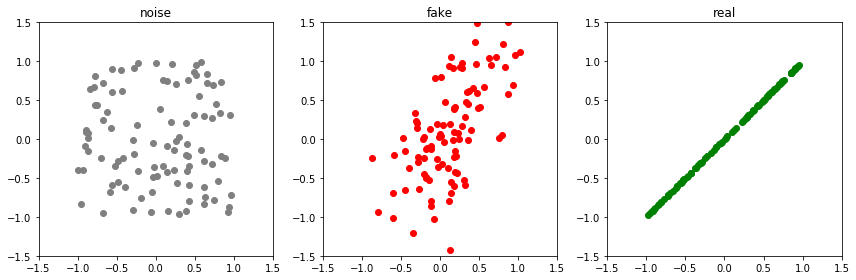

Epoch: 3400 G-error: 0.8473250865936279 D-error: 1.437220811843872


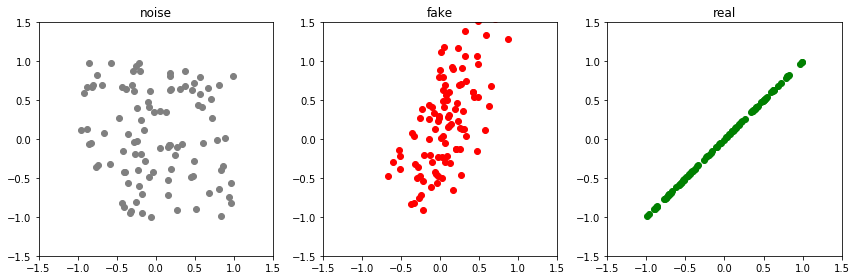

Epoch: 3450 G-error: 0.531057596206665 D-error: 1.572338581085205


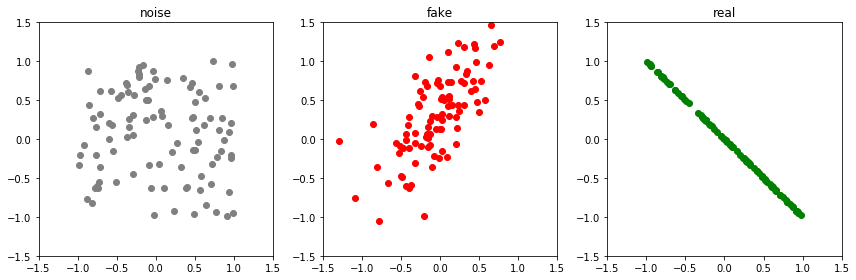

Epoch: 3500 G-error: 0.6446387767791748 D-error: 2.5600879192352295


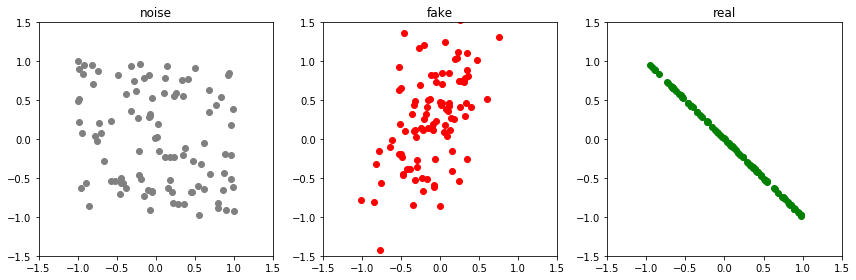

Epoch: 3550 G-error: 0.5953940749168396 D-error: 1.9065299034118652


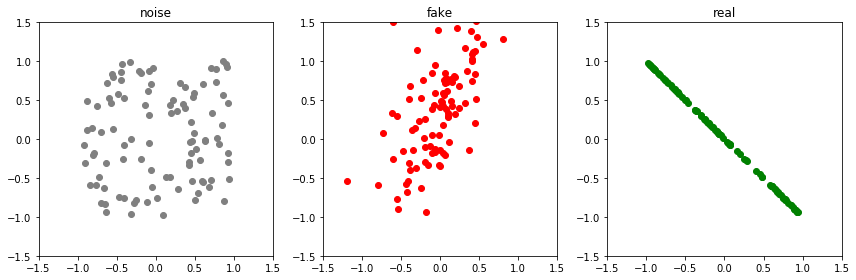

Epoch: 3600 G-error: 0.7355034351348877 D-error: 1.369391679763794


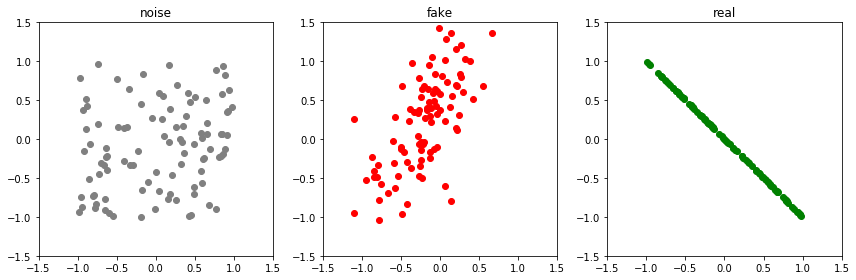

Epoch: 3650 G-error: 0.7837214469909668 D-error: 1.3212273120880127


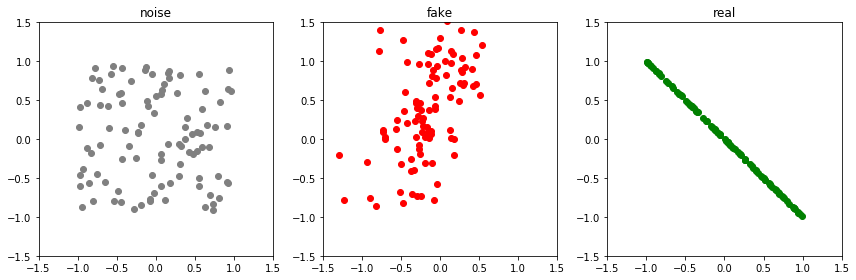

Epoch: 3700 G-error: 0.8944095373153687 D-error: 1.210368275642395


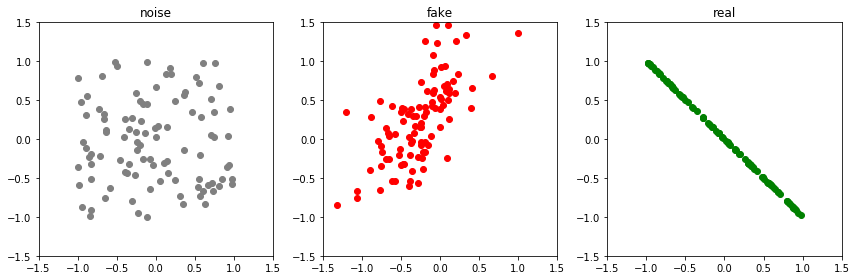

Epoch: 3750 G-error: 0.9306182861328125 D-error: 1.1401586532592773


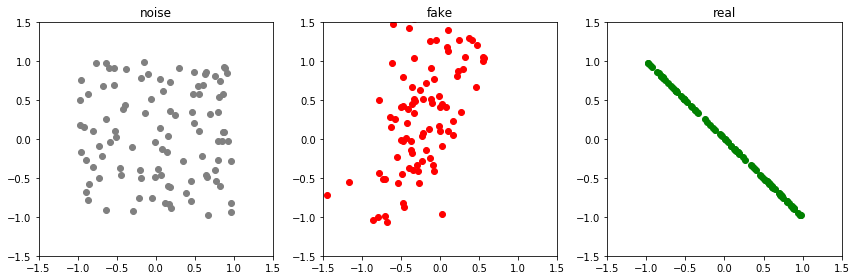

Epoch: 3800 G-error: 0.9981018304824829 D-error: 1.0442752838134766


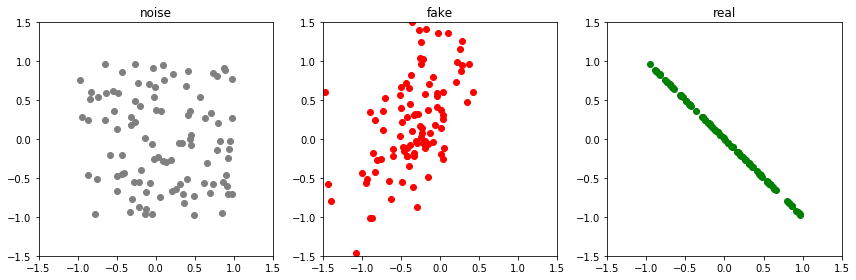

Epoch: 3850 G-error: 0.9322506189346313 D-error: 1.1163368225097656


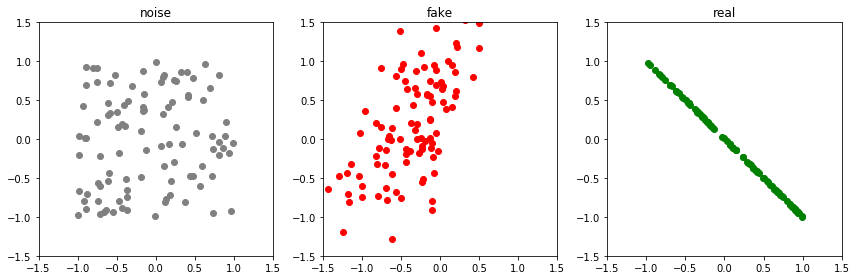

Epoch: 3900 G-error: 0.9826416969299316 D-error: 1.0393576622009277


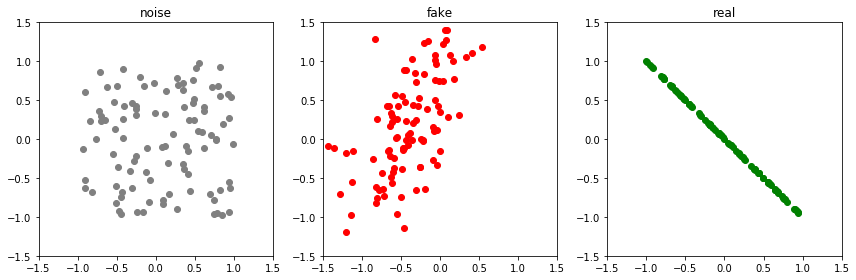

Epoch: 3950 G-error: 1.0061919689178467 D-error: 1.063286304473877


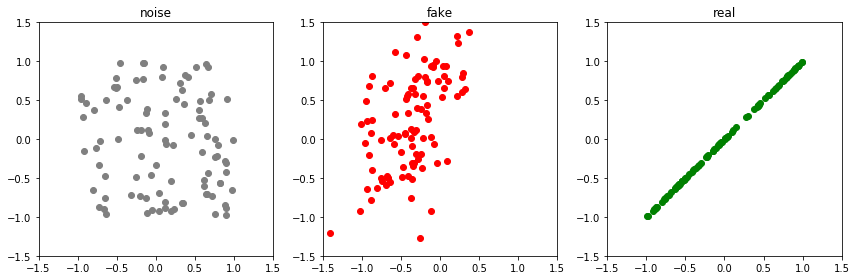

Epoch: 4000 G-error: 1.0566682815551758 D-error: 1.4986902475357056


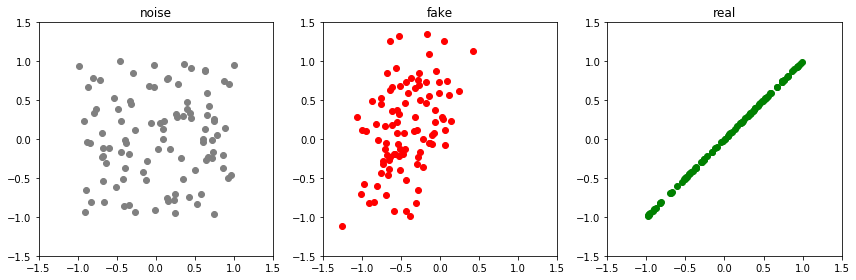

Epoch: 4050 G-error: 0.8207864165306091 D-error: 1.2046023607254028


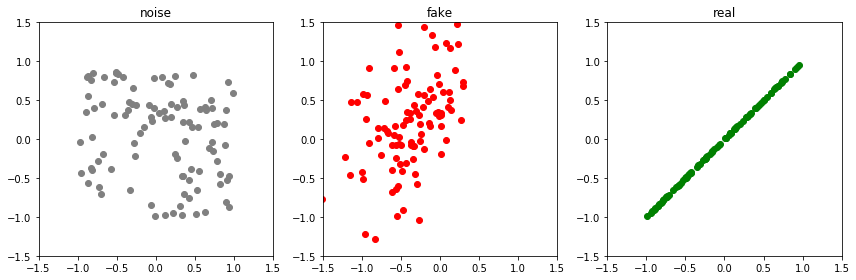

Epoch: 4100 G-error: 0.9240672588348389 D-error: 1.0837657451629639


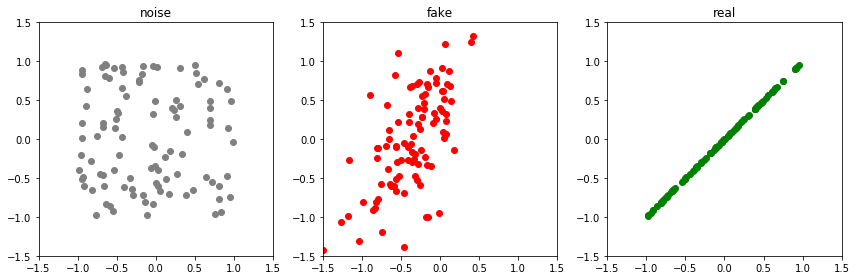

Epoch: 4150 G-error: 0.9818283319473267 D-error: 1.1164072751998901


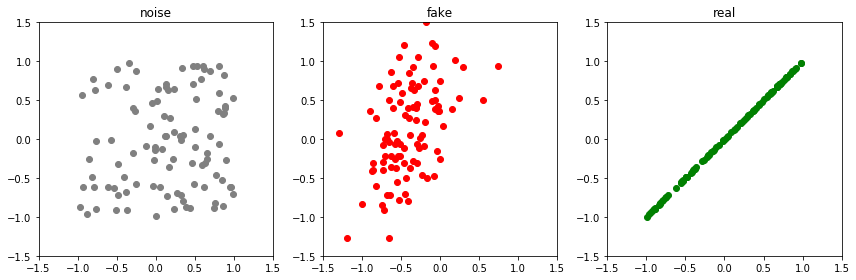

Epoch: 4200 G-error: 1.0962544679641724 D-error: 1.0330092906951904


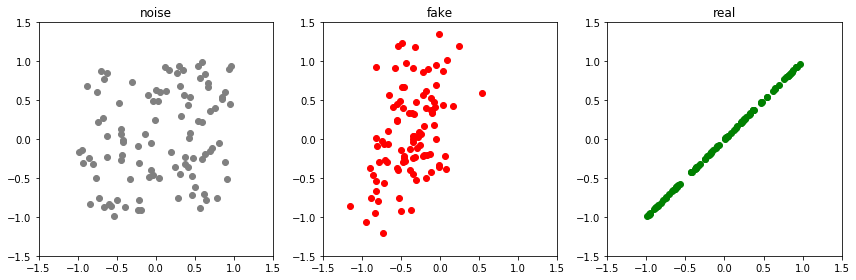

Epoch: 4250 G-error: 1.0929945707321167 D-error: 0.9985736608505249


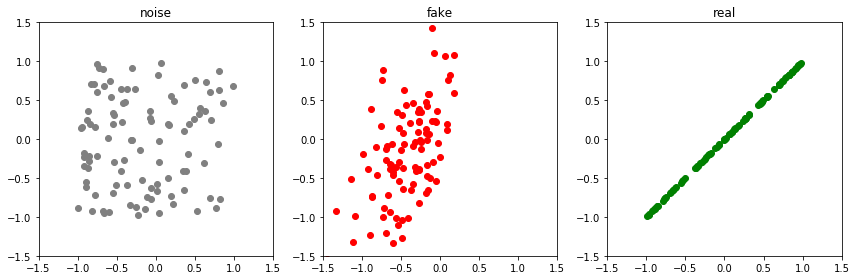

Epoch: 4300 G-error: 1.093470811843872 D-error: 1.0479844808578491


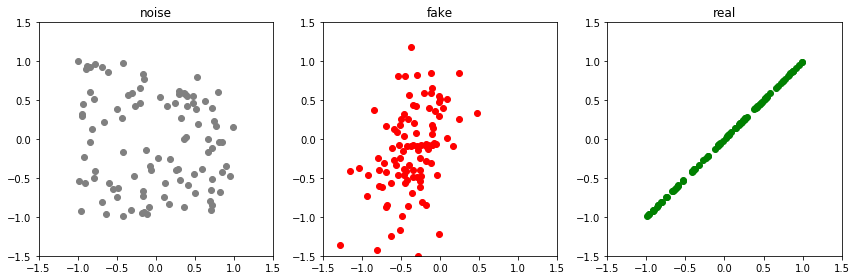

Epoch: 4350 G-error: 1.0034759044647217 D-error: 1.1078463792800903


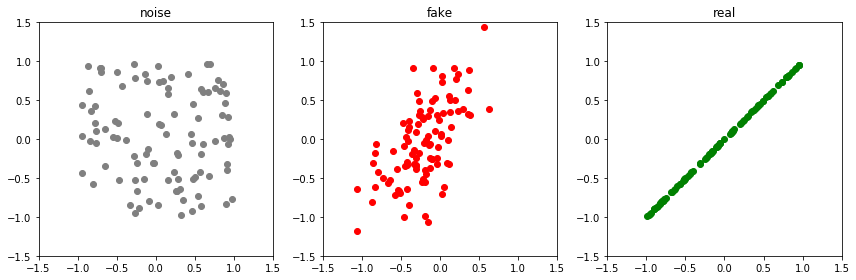

Epoch: 4400 G-error: 0.9804036021232605 D-error: 1.2192046642303467


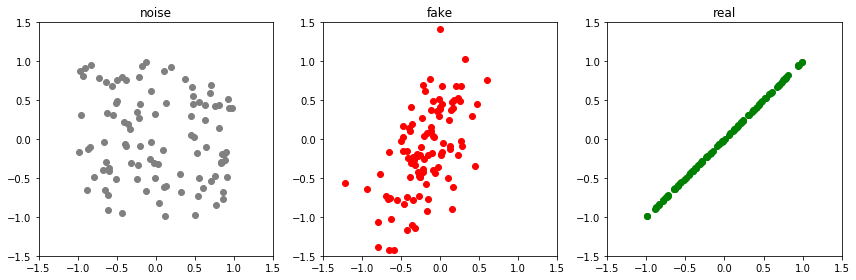

Epoch: 4450 G-error: 1.0148361921310425 D-error: 1.2879374027252197


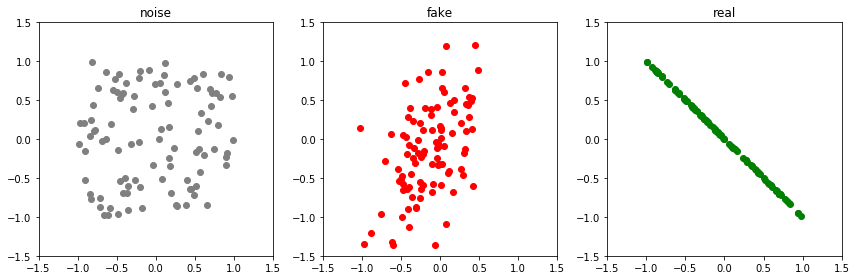

Epoch: 4500 G-error: 0.8916510939598083 D-error: 1.7879530191421509


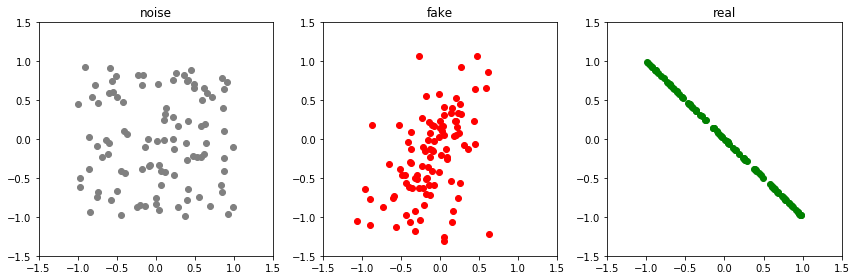

Epoch: 4550 G-error: 0.8951775431632996 D-error: 1.3654577732086182


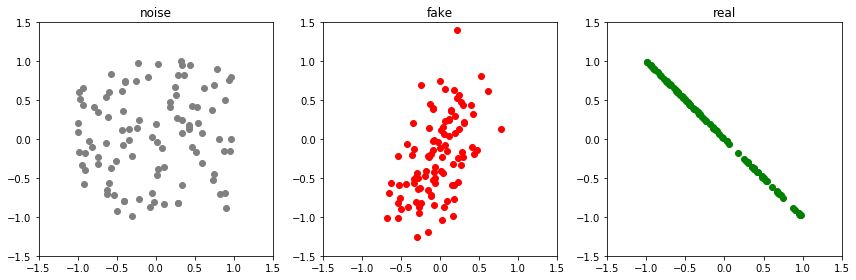

Epoch: 4600 G-error: 0.9860768914222717 D-error: 1.2617988586425781


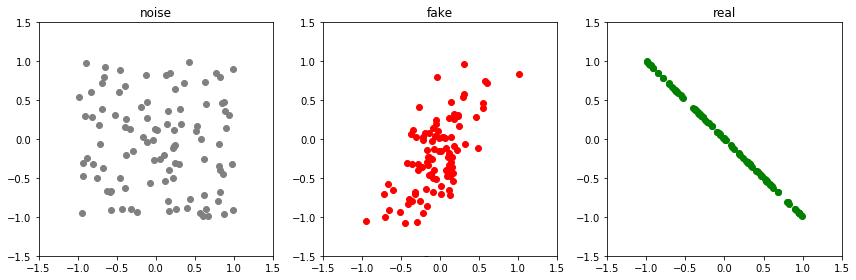

Epoch: 4650 G-error: 1.0393528938293457 D-error: 1.0557892322540283


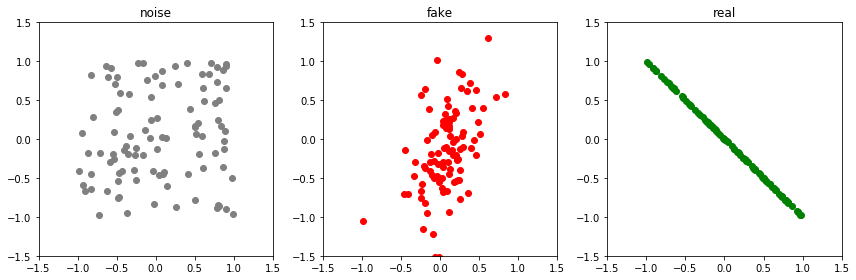

Epoch: 4700 G-error: 0.9896880984306335 D-error: 1.0817022323608398


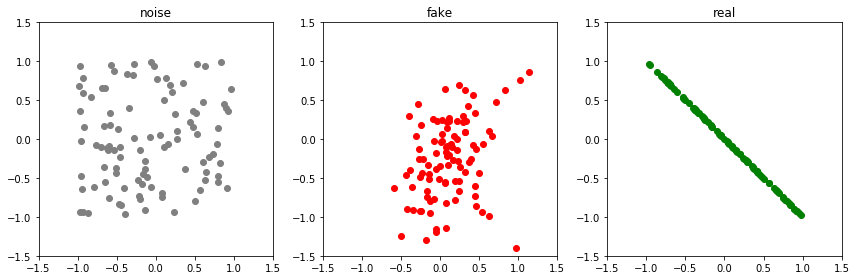

Epoch: 4750 G-error: 1.05154550075531 D-error: 1.092017412185669


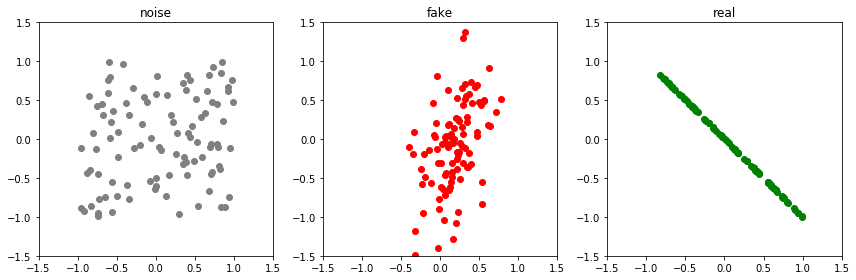

Epoch: 4800 G-error: 1.0538063049316406 D-error: 1.0365397930145264


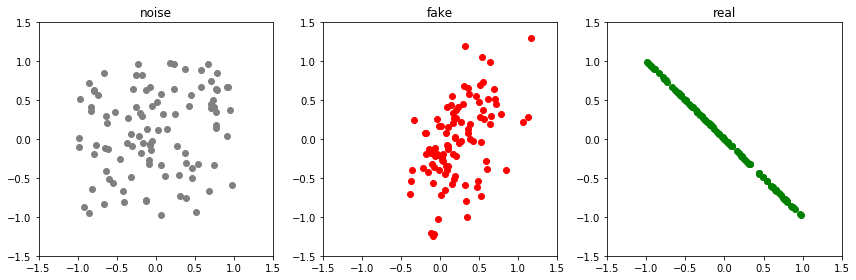

Epoch: 4850 G-error: 1.0777031183242798 D-error: 1.017525315284729


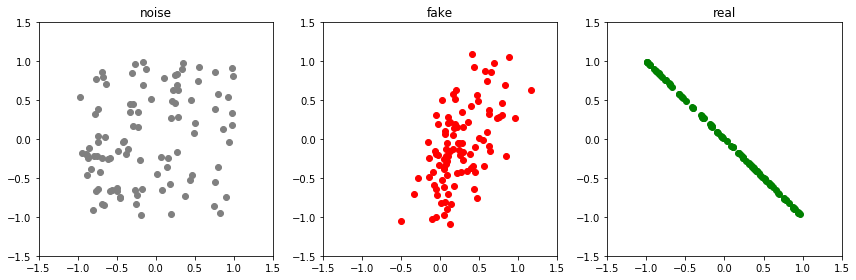

Epoch: 4900 G-error: 1.0961220264434814 D-error: 0.9491532444953918


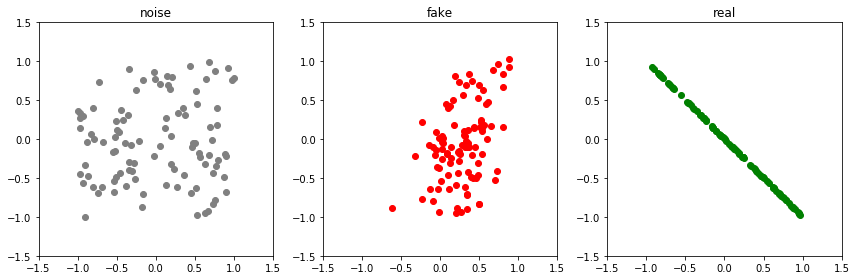

Epoch: 4950 G-error: 1.1455752849578857 D-error: 0.9855140447616577


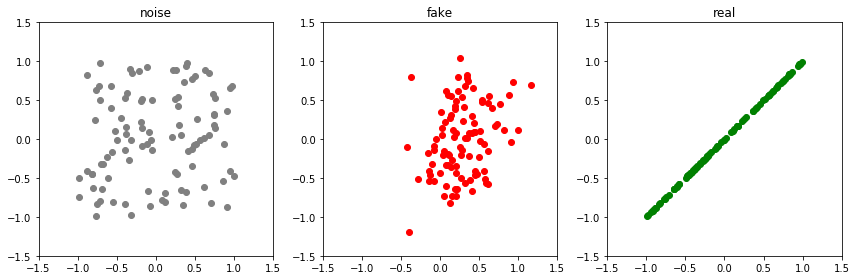

Epoch: 5000 G-error: 1.1262632608413696 D-error: 1.5988281965255737


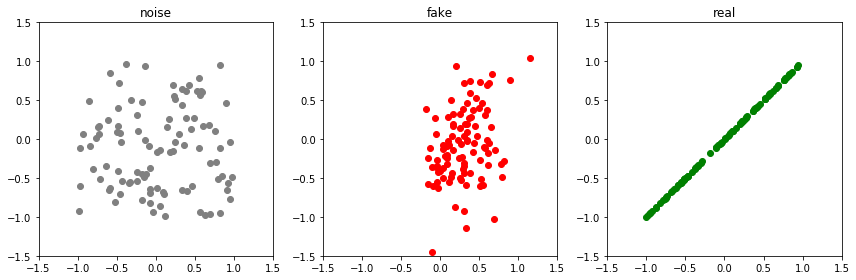

Epoch: 5050 G-error: 0.8172228932380676 D-error: 1.2444826364517212


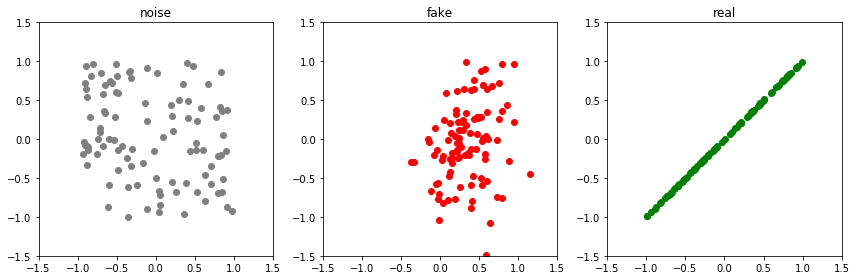

Epoch: 5100 G-error: 0.8725746273994446 D-error: 1.128877878189087


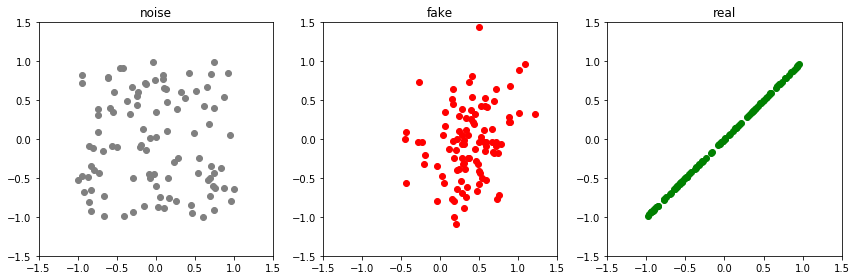

Epoch: 5150 G-error: 0.9426597356796265 D-error: 1.0355396270751953


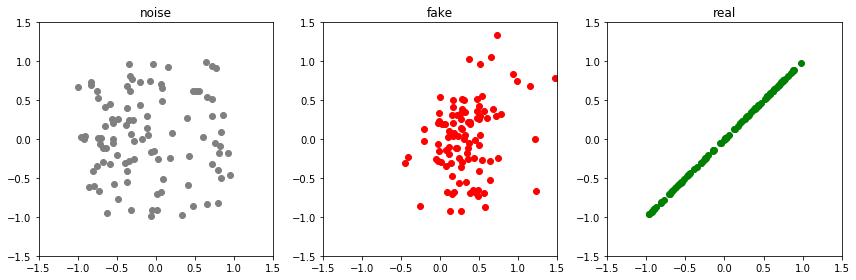

Epoch: 5200 G-error: 1.0024280548095703 D-error: 1.063899278640747


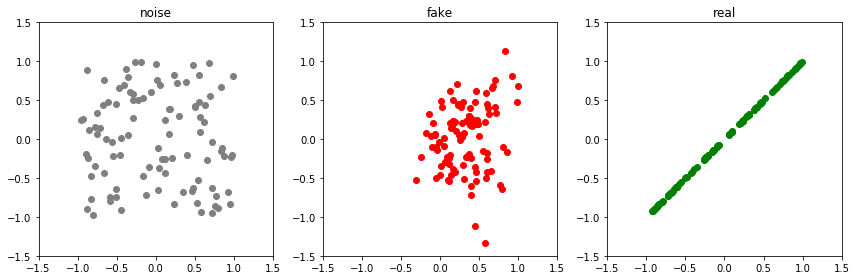

Epoch: 5250 G-error: 1.1158039569854736 D-error: 1.0235300064086914


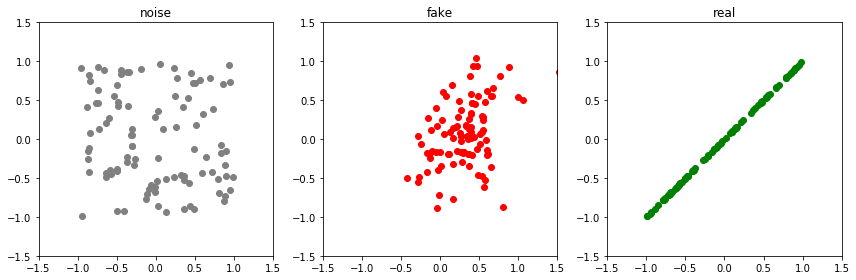

Epoch: 5300 G-error: 0.9725001454353333 D-error: 0.9999215602874756


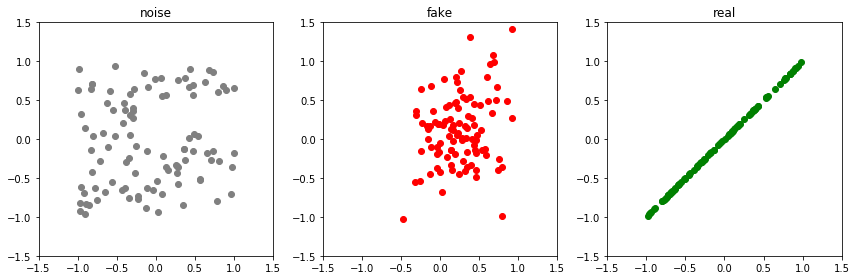

Epoch: 5350 G-error: 1.1566925048828125 D-error: 1.1278948783874512


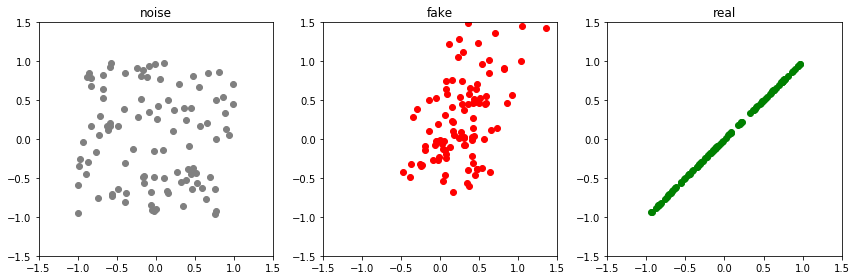

Epoch: 5400 G-error: 0.9336044192314148 D-error: 1.1415191888809204


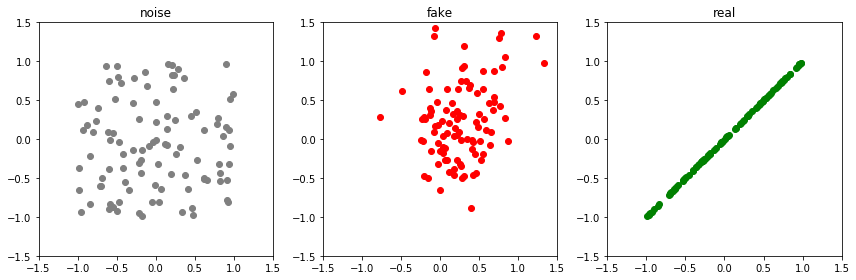

Epoch: 5450 G-error: 0.897274374961853 D-error: 1.191347360610962


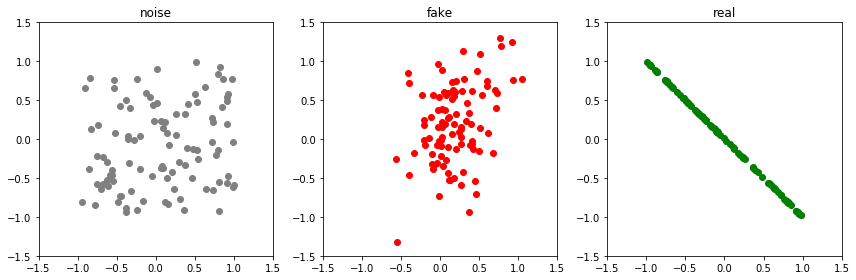

Epoch: 5500 G-error: 0.9420961141586304 D-error: 1.375213623046875


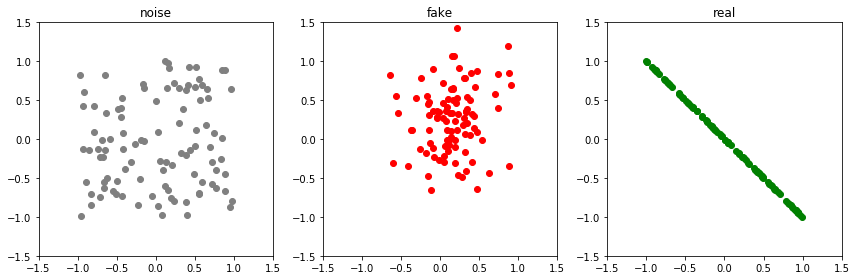

Epoch: 5550 G-error: 0.9775561690330505 D-error: 1.12453031539917


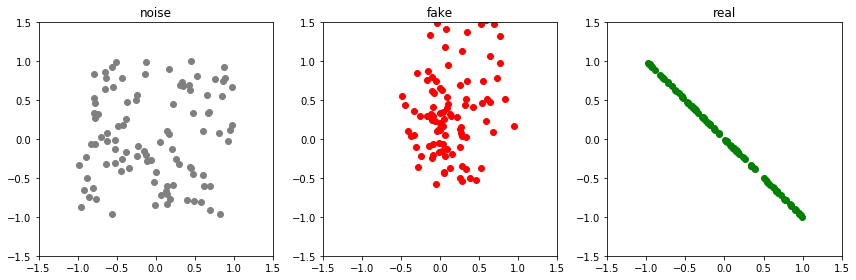

Epoch: 5600 G-error: 1.119075059890747 D-error: 0.9854753017425537


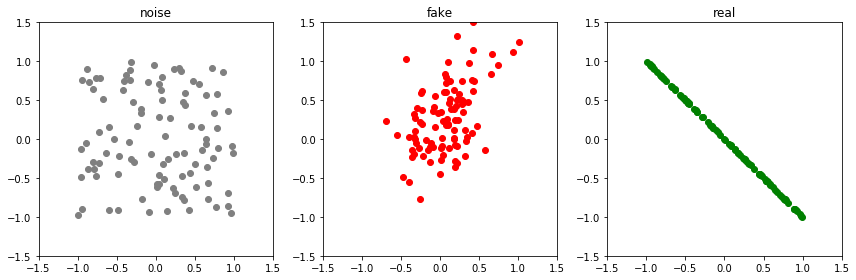

Epoch: 5650 G-error: 1.1575583219528198 D-error: 0.911359965801239


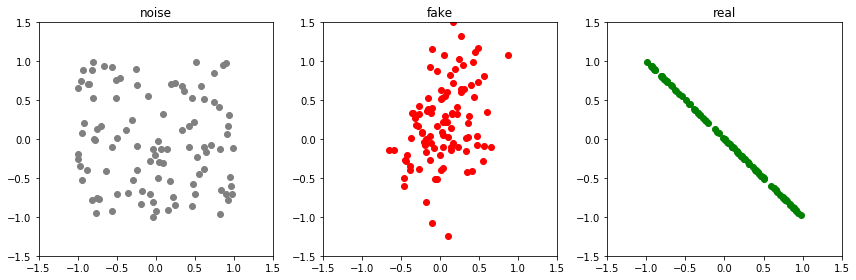

Epoch: 5700 G-error: 1.1267651319503784 D-error: 0.9432655572891235


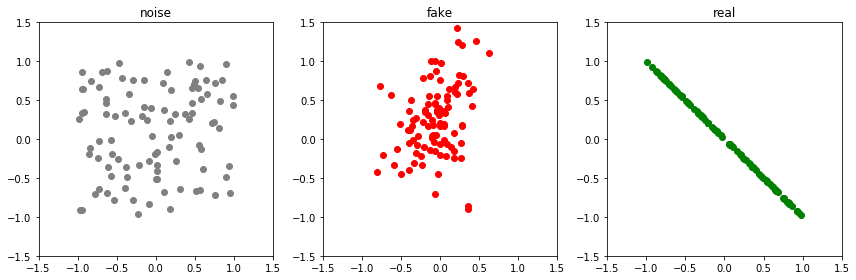

Epoch: 5750 G-error: 1.1616977453231812 D-error: 0.9528490304946899


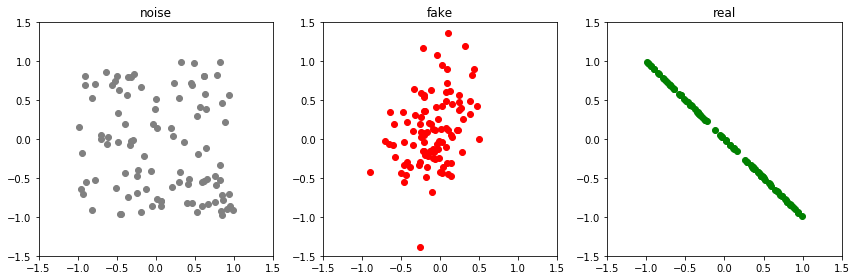

Epoch: 5800 G-error: 1.167292833328247 D-error: 0.949504017829895


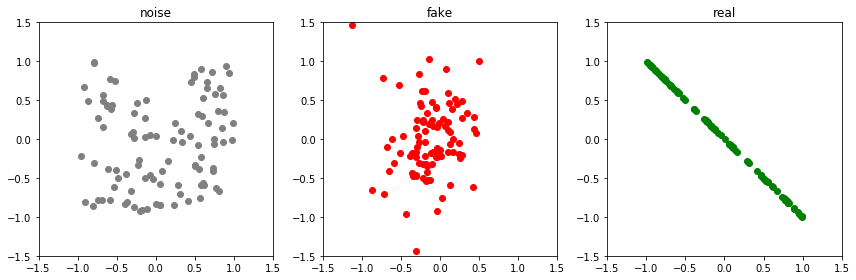

Epoch: 5850 G-error: 1.1494555473327637 D-error: 0.91569584608078


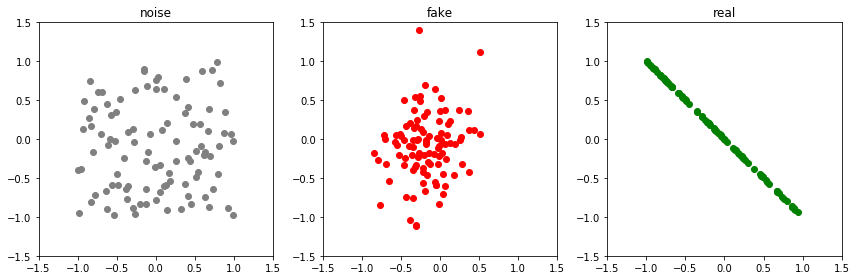

Epoch: 5900 G-error: 1.1718015670776367 D-error: 0.9912886023521423


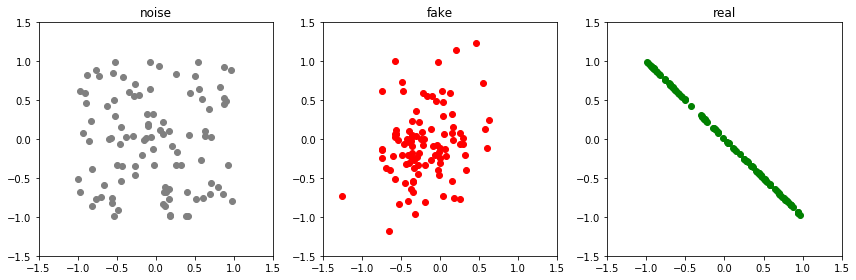

Epoch: 5950 G-error: 1.1837632656097412 D-error: 0.8849788308143616


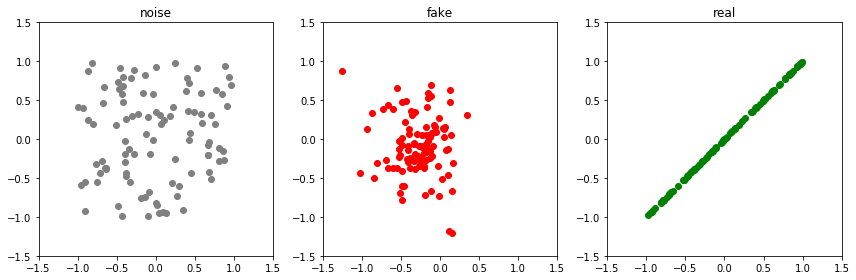

Epoch: 6000 G-error: 1.2256511449813843 D-error: 1.5212976932525635


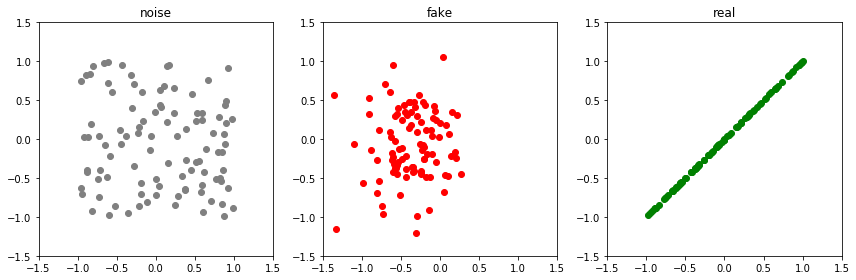

Epoch: 6050 G-error: 0.77783203125 D-error: 1.3413519859313965


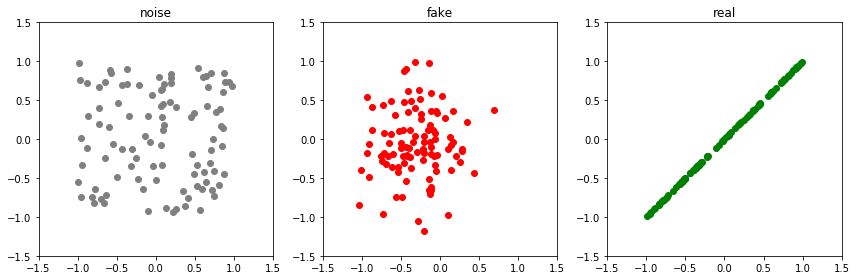

Epoch: 6100 G-error: 0.8522478342056274 D-error: 1.26199209690094


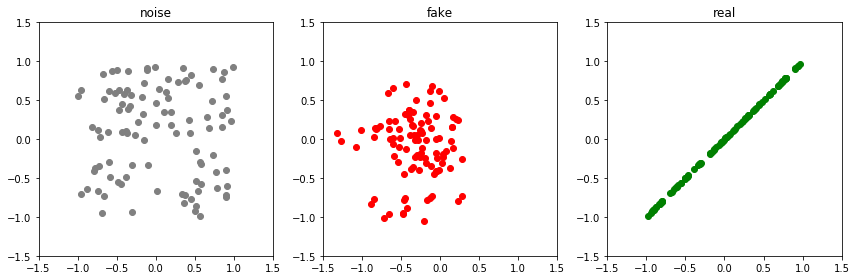

Epoch: 6150 G-error: 0.936848521232605 D-error: 1.129513144493103


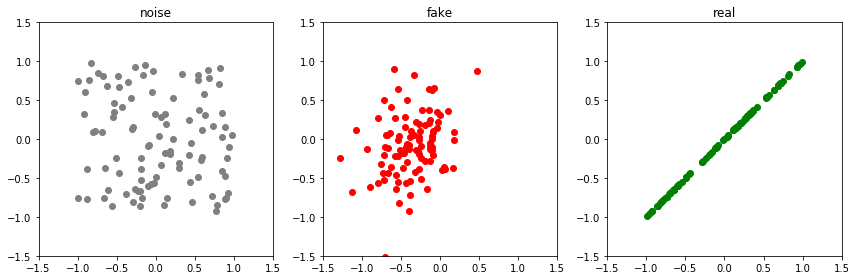

Epoch: 6200 G-error: 0.9992427825927734 D-error: 1.0824536085128784


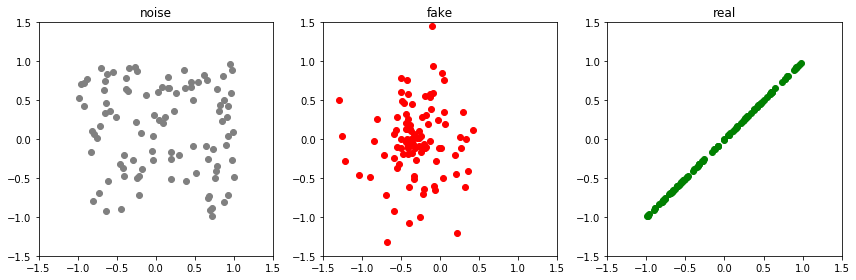

Epoch: 6250 G-error: 0.9869670867919922 D-error: 1.068184494972229


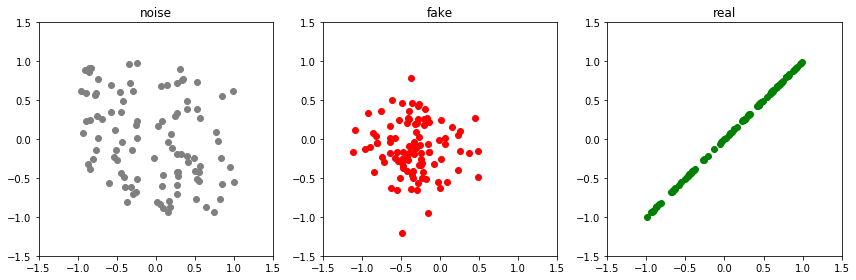

Epoch: 6300 G-error: 0.9992145299911499 D-error: 0.9682174921035767


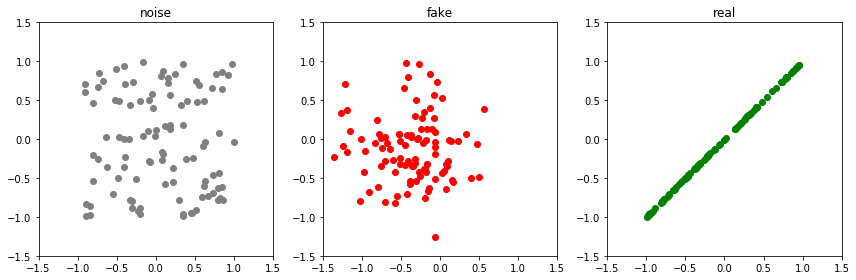

Epoch: 6350 G-error: 1.0763989686965942 D-error: 1.1145137548446655


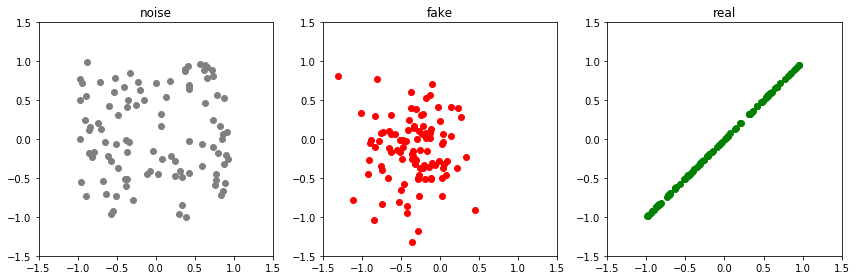

Epoch: 6400 G-error: 1.1004091501235962 D-error: 1.0635440349578857


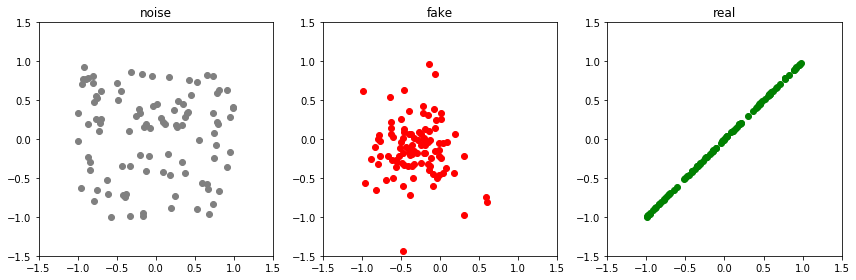

Epoch: 6450 G-error: 1.0639454126358032 D-error: 0.9824254512786865


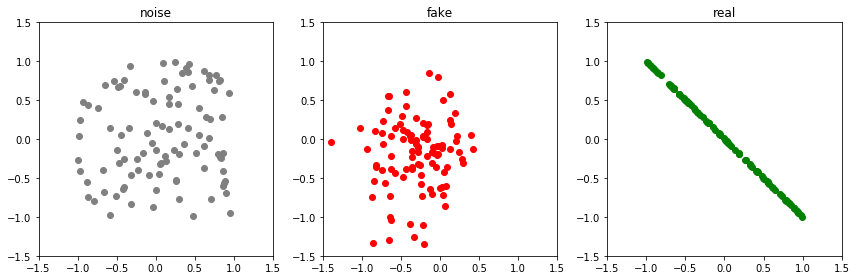

Epoch: 6500 G-error: 1.004653811454773 D-error: 1.3811315298080444


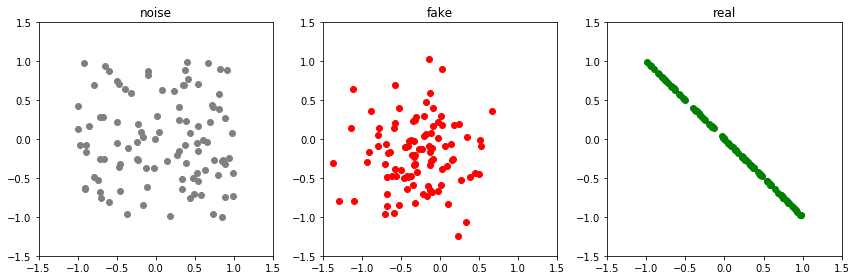

Epoch: 6550 G-error: 0.9985079765319824 D-error: 1.150132179260254


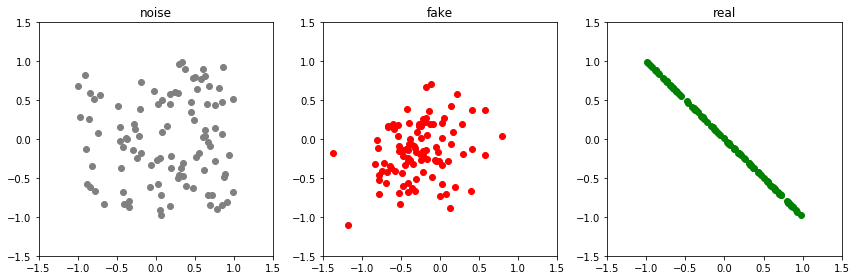

Epoch: 6600 G-error: 1.0957638025283813 D-error: 1.0019326210021973


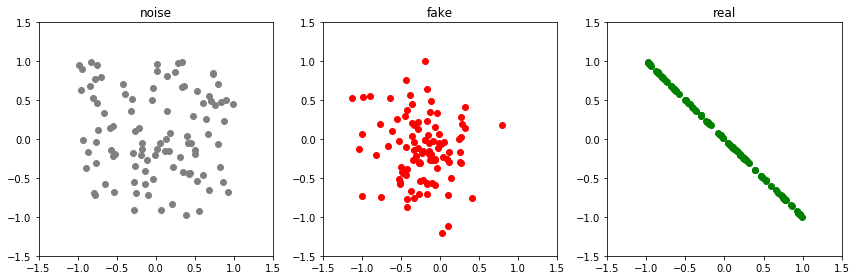

Epoch: 6650 G-error: 1.1818915605545044 D-error: 0.9858189821243286


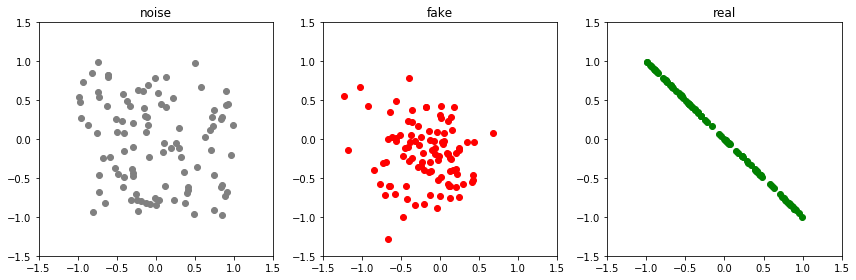

Epoch: 6700 G-error: 1.348747968673706 D-error: 0.9424676895141602


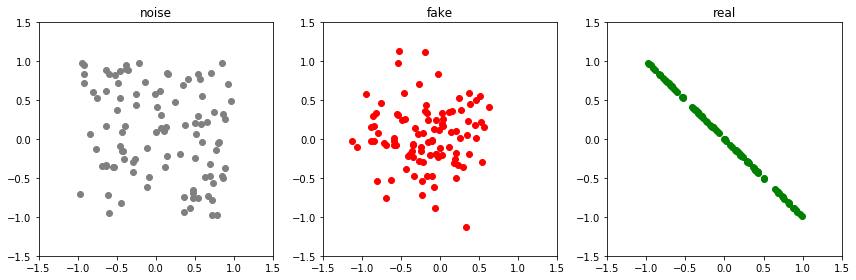

Epoch: 6750 G-error: 1.3034402132034302 D-error: 1.210540533065796


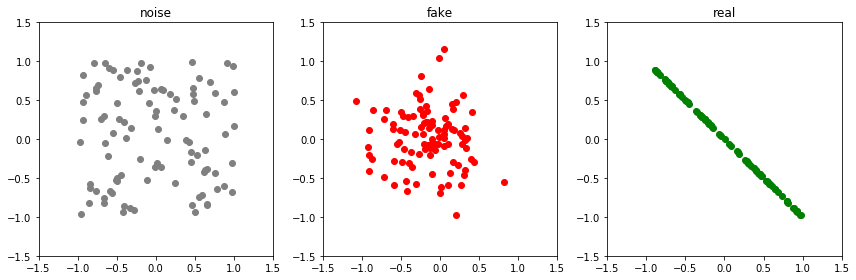

Epoch: 6800 G-error: 1.1667414903640747 D-error: 1.128864049911499


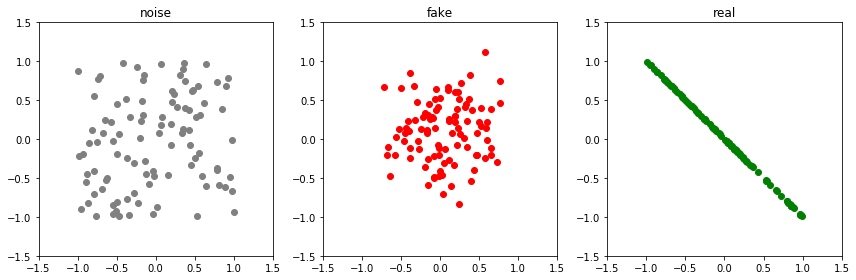

Epoch: 6850 G-error: 1.0229114294052124 D-error: 1.2993717193603516


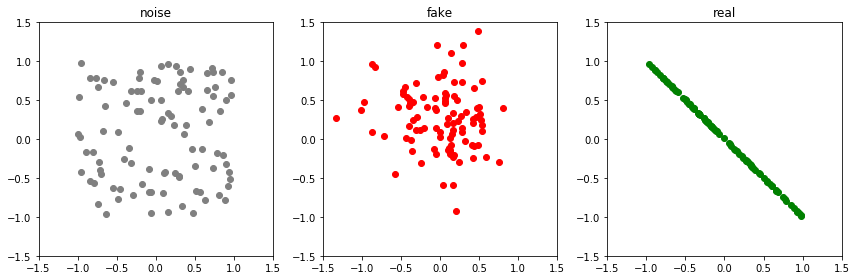

Epoch: 6900 G-error: 0.948535144329071 D-error: 1.2433807849884033


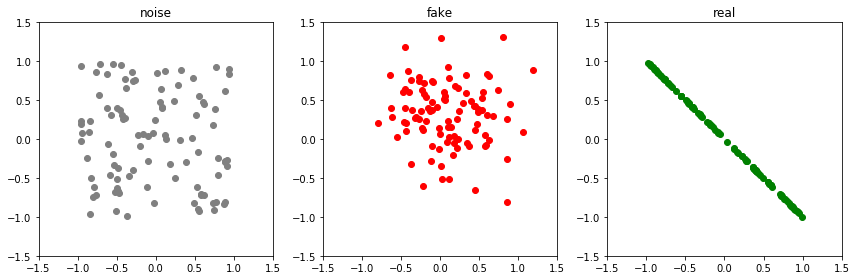

Epoch: 6950 G-error: 1.0356323719024658 D-error: 1.0537272691726685


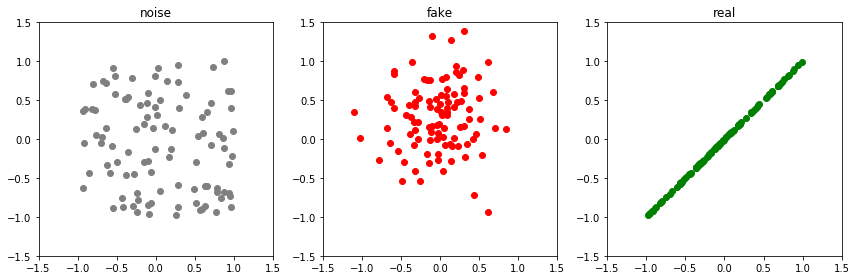

Epoch: 7000 G-error: 1.2216086387634277 D-error: 1.666788101196289


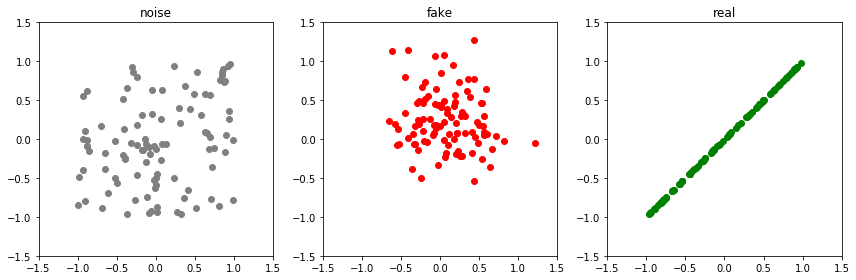

Epoch: 7050 G-error: 0.7385423183441162 D-error: 1.3050322532653809


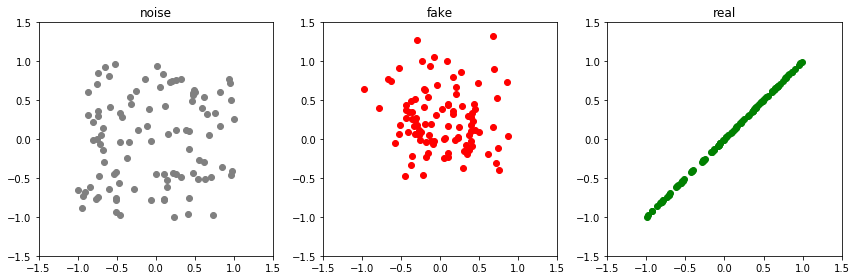

Epoch: 7100 G-error: 0.8159659504890442 D-error: 1.321208119392395


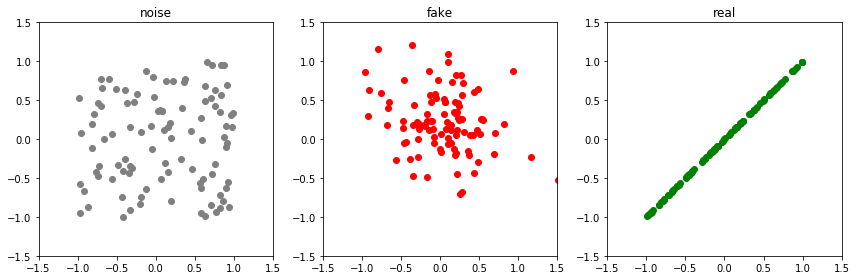

Epoch: 7150 G-error: 0.8797436356544495 D-error: 1.2518978118896484


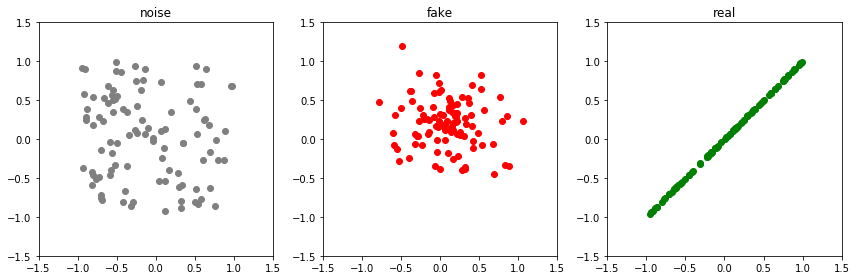

Epoch: 7200 G-error: 0.9572758674621582 D-error: 1.2101428508758545


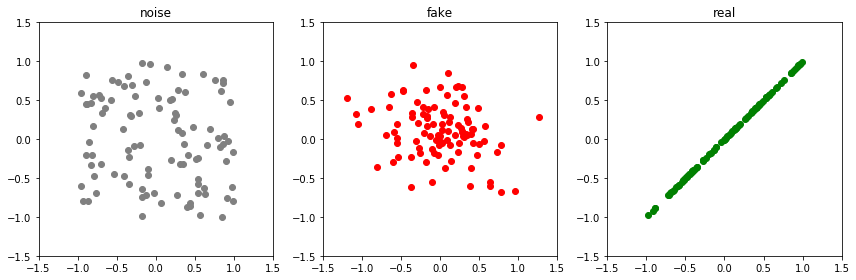

Epoch: 7250 G-error: 0.9454437494277954 D-error: 1.2489811182022095


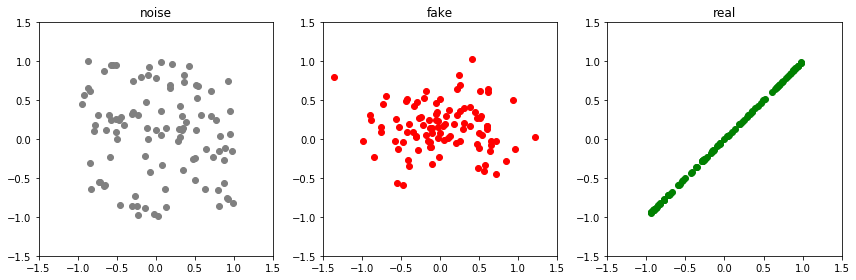

Epoch: 7300 G-error: 0.8737857341766357 D-error: 1.1231029033660889


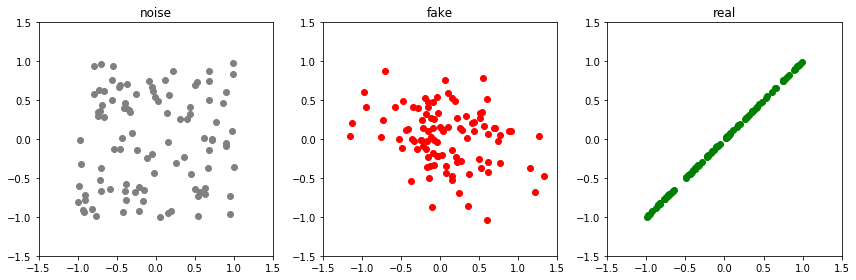

Epoch: 7350 G-error: 0.9402924180030823 D-error: 1.1395437717437744


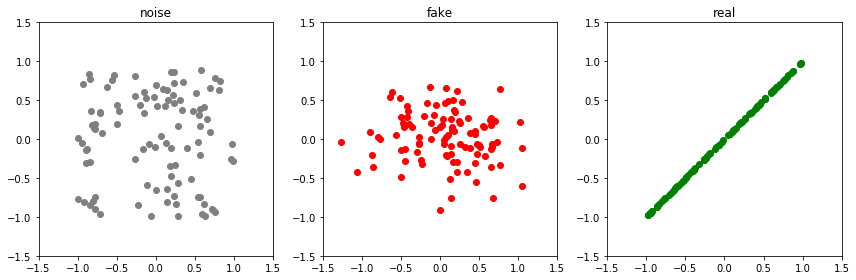

Epoch: 7400 G-error: 0.9456451535224915 D-error: 1.086219310760498


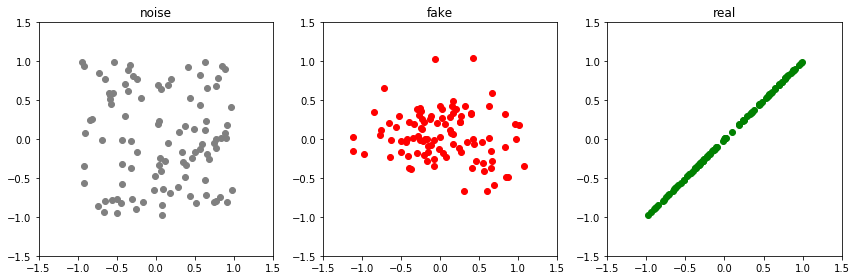

Epoch: 7450 G-error: 1.0022940635681152 D-error: 1.0864040851593018


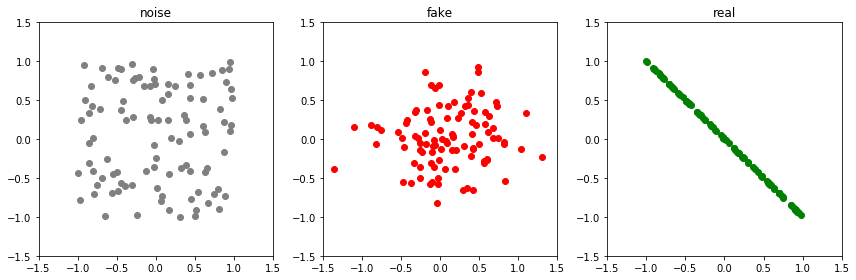

Epoch: 7500 G-error: 1.0341471433639526 D-error: 1.5844688415527344


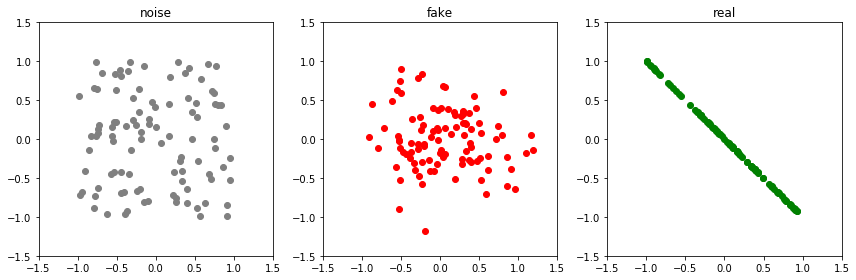

Epoch: 7550 G-error: 0.6565709710121155 D-error: 1.4252867698669434


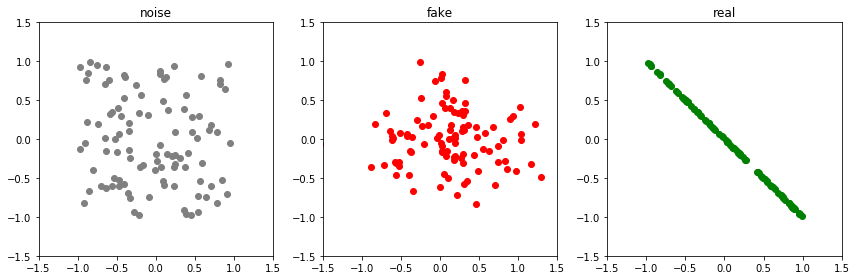

Epoch: 7600 G-error: 0.8213405609130859 D-error: 1.3675684928894043


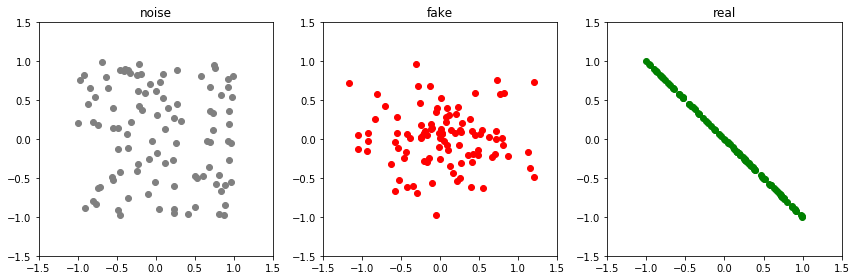

Epoch: 7650 G-error: 0.7675217390060425 D-error: 1.3177329301834106


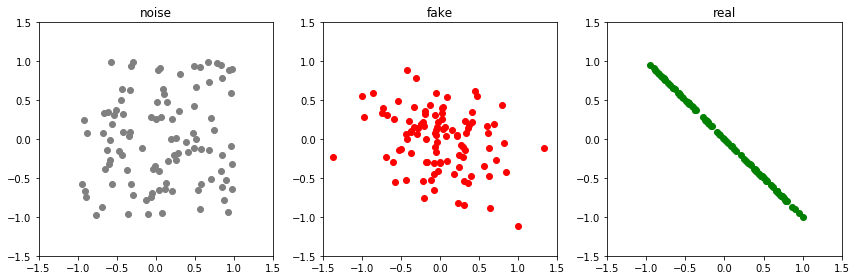

Epoch: 7700 G-error: 0.8606704473495483 D-error: 1.2282285690307617


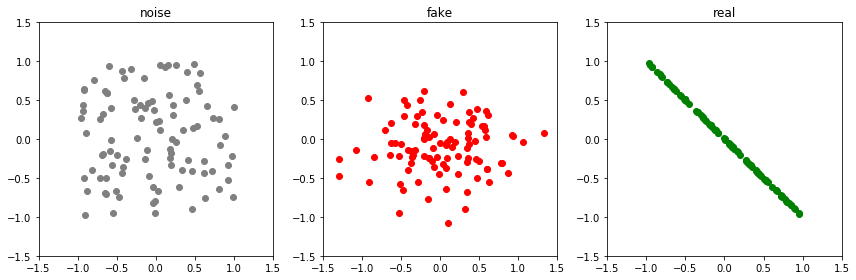

Epoch: 7750 G-error: 0.9085633754730225 D-error: 1.2357139587402344


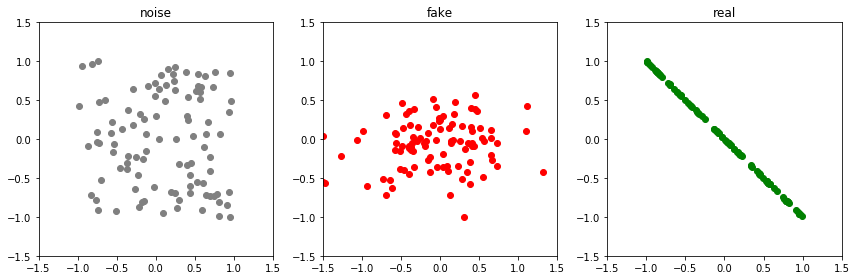

Epoch: 7800 G-error: 0.9107739329338074 D-error: 1.1279950141906738


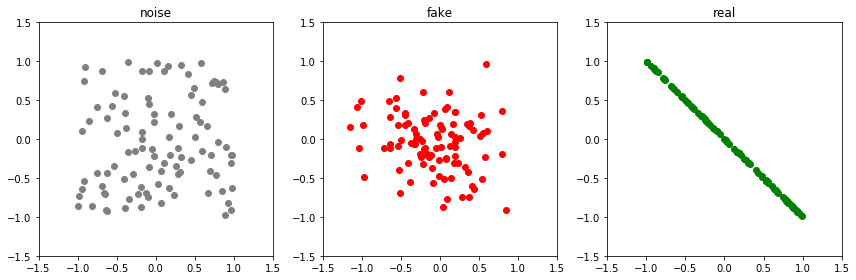

Epoch: 7850 G-error: 0.8993793725967407 D-error: 1.1168133020401


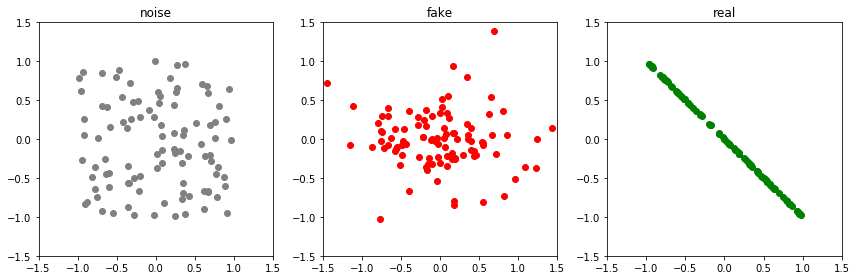

Epoch: 7900 G-error: 0.9359645843505859 D-error: 1.1029839515686035


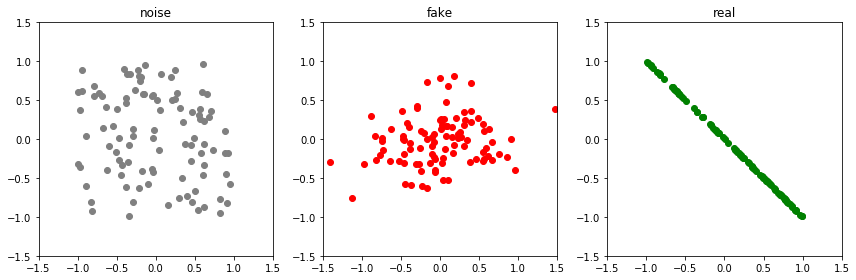

Epoch: 7950 G-error: 0.981732964515686 D-error: 0.9669522047042847


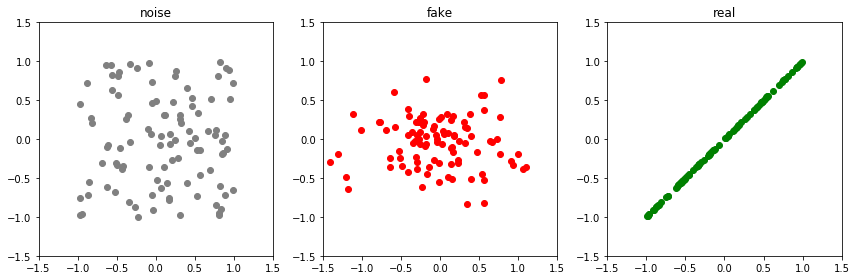

Epoch: 8000 G-error: 0.9776325821876526 D-error: 1.6984710693359375


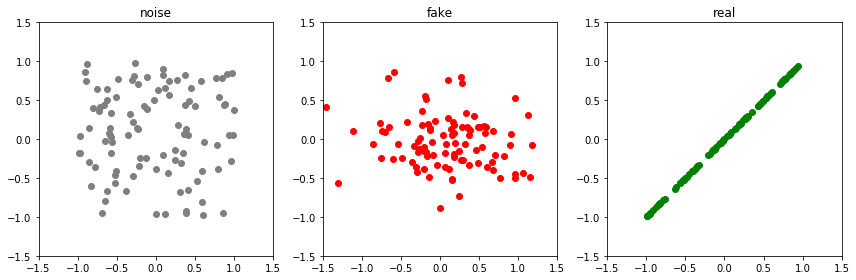

Epoch: 8050 G-error: 0.6781059503555298 D-error: 1.3728318214416504


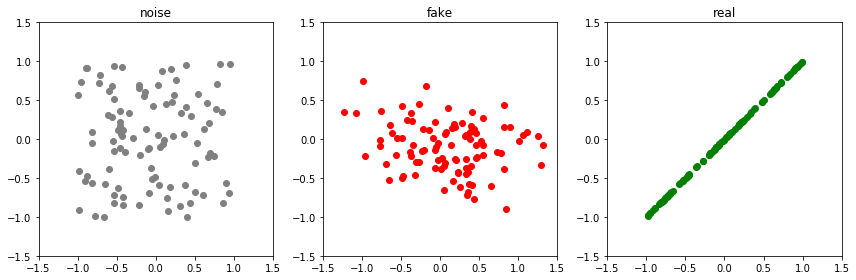

Epoch: 8100 G-error: 0.7848814129829407 D-error: 1.2114698886871338


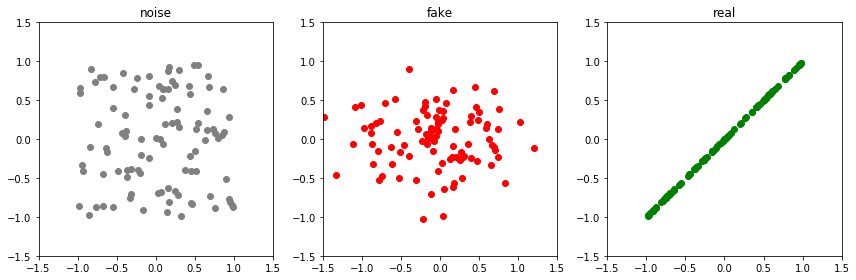

Epoch: 8150 G-error: 0.8278265595436096 D-error: 1.1285758018493652


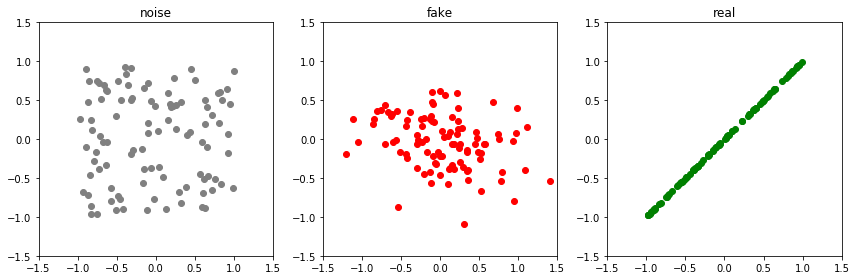

Epoch: 8200 G-error: 0.938821017742157 D-error: 1.08128023147583


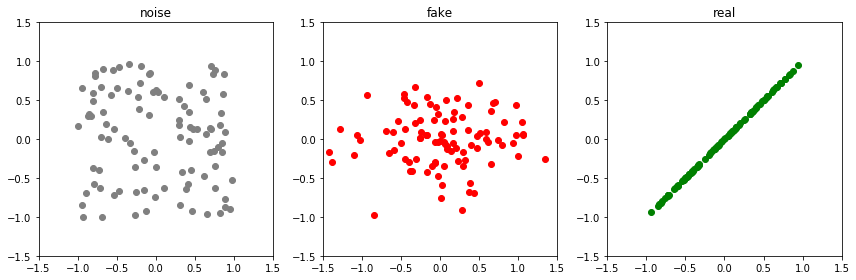

Epoch: 8250 G-error: 0.9251212477684021 D-error: 1.0625065565109253


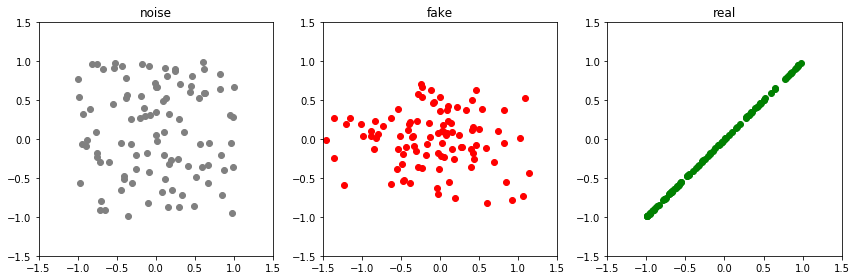

Epoch: 8300 G-error: 1.0281891822814941 D-error: 0.9548811316490173


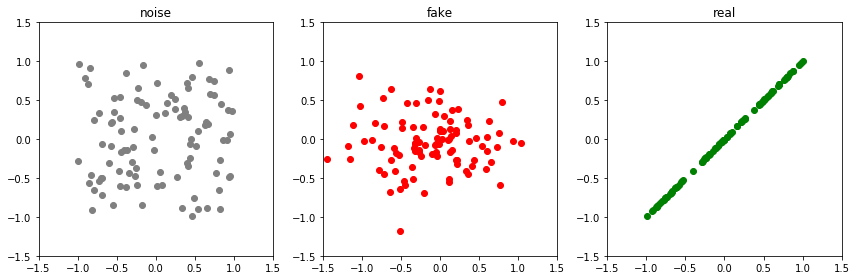

Epoch: 8350 G-error: 1.02848219871521 D-error: 0.9460729956626892


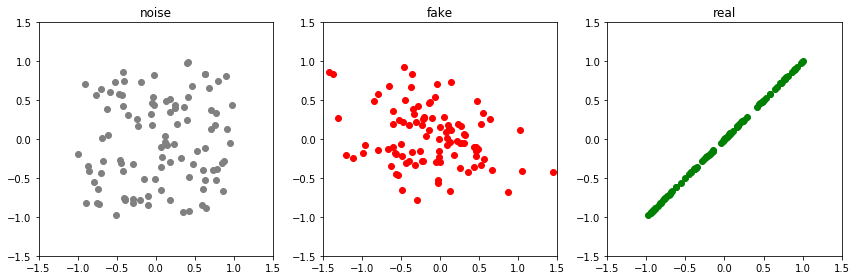

Epoch: 8400 G-error: 1.1049619913101196 D-error: 0.9090918302536011


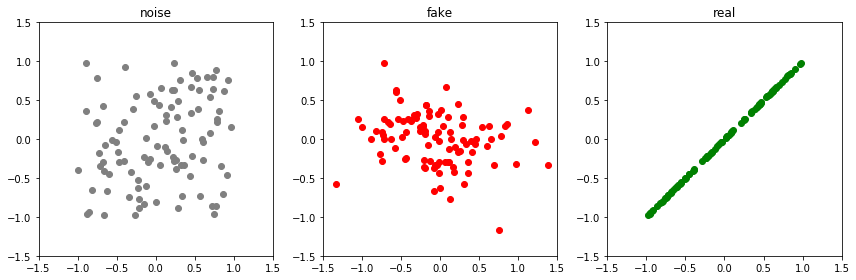

Epoch: 8450 G-error: 1.1965004205703735 D-error: 0.8044644594192505


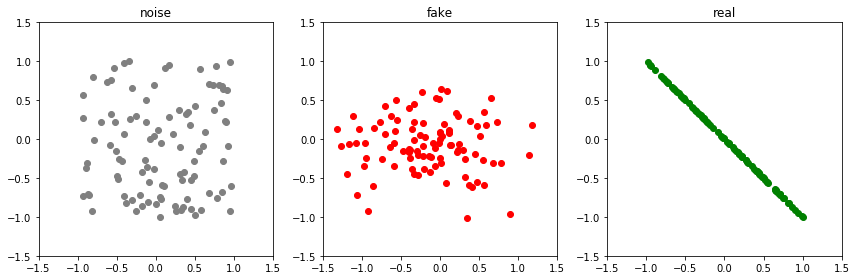

Epoch: 8500 G-error: 1.1755142211914062 D-error: 1.8589942455291748


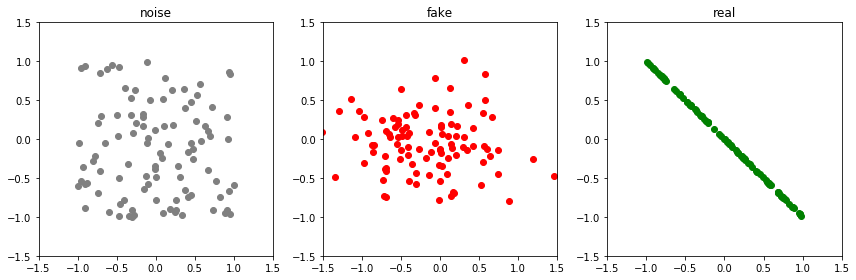

Epoch: 8550 G-error: 0.6303067207336426 D-error: 1.447001576423645


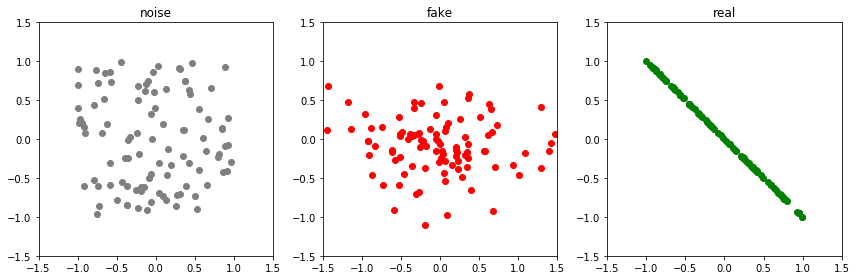

Epoch: 8600 G-error: 0.813687801361084 D-error: 1.2644598484039307


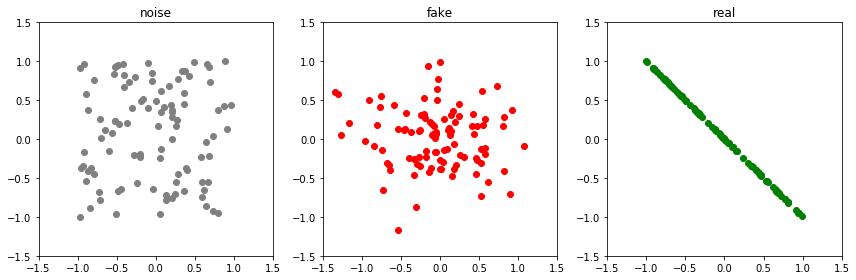

Epoch: 8650 G-error: 0.8757781982421875 D-error: 1.204984426498413


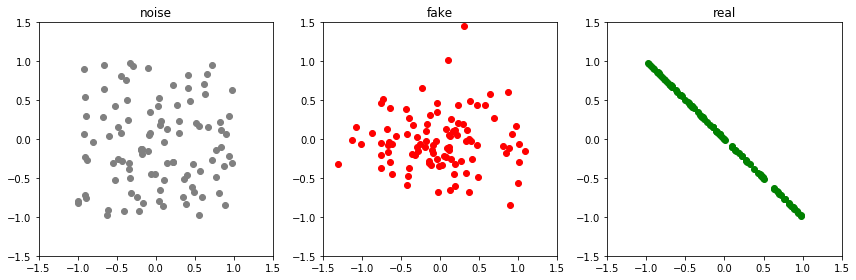

Epoch: 8700 G-error: 0.910768985748291 D-error: 1.0982553958892822


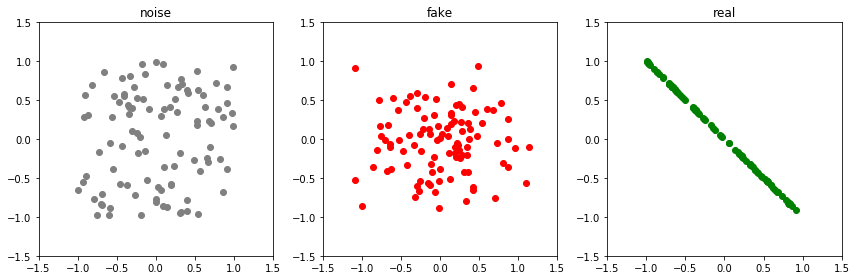

Epoch: 8750 G-error: 0.9326090216636658 D-error: 1.0427637100219727


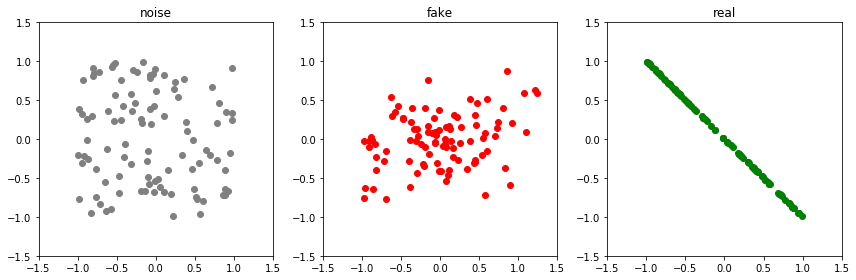

Epoch: 8800 G-error: 1.0274001359939575 D-error: 0.9600995182991028


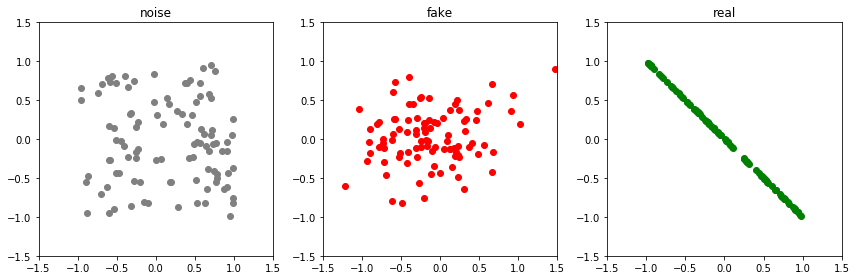

Epoch: 8850 G-error: 0.9990281462669373 D-error: 0.9583871364593506


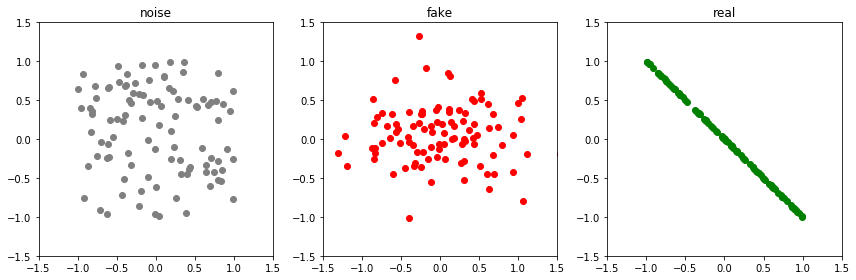

Epoch: 8900 G-error: 1.1380314826965332 D-error: 0.9592796564102173


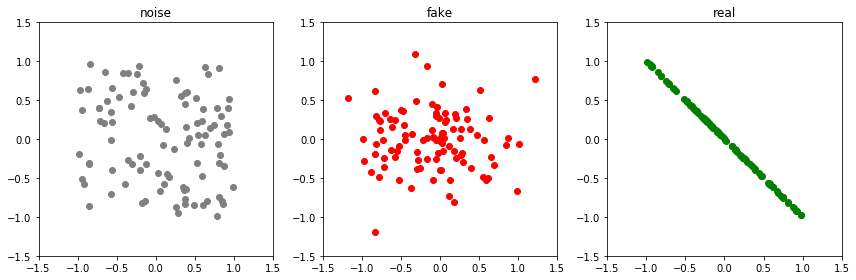

Epoch: 8950 G-error: 1.090712070465088 D-error: 1.0088709592819214


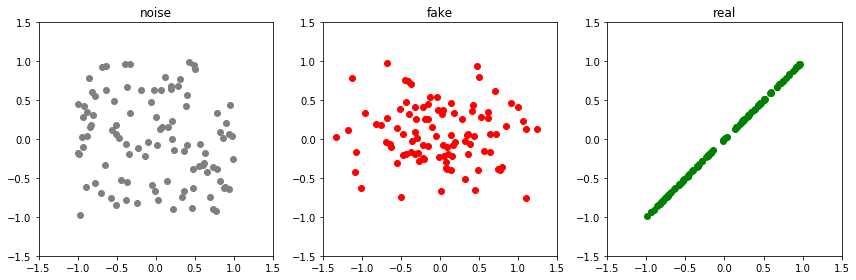

Epoch: 9000 G-error: 1.210294485092163 D-error: 1.672020673751831


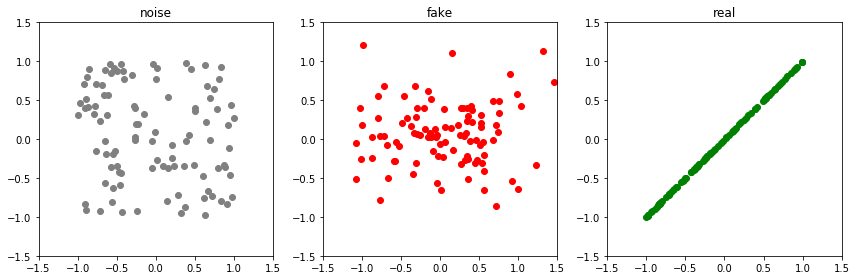

Epoch: 9050 G-error: 0.7661280035972595 D-error: 1.2586767673492432


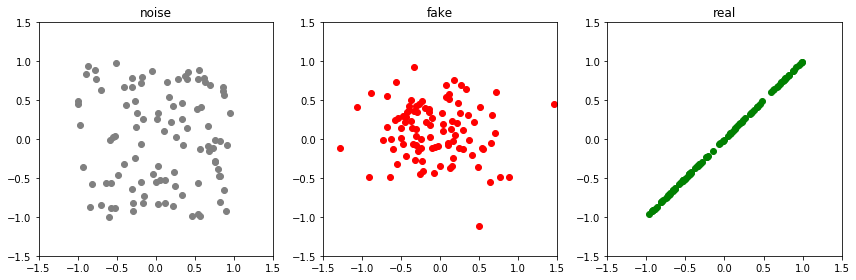

Epoch: 9100 G-error: 0.9268025755882263 D-error: 1.0529186725616455


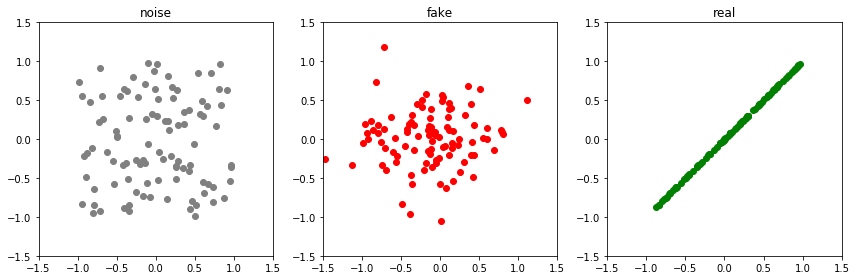

Epoch: 9150 G-error: 0.9927886724472046 D-error: 0.9757488965988159


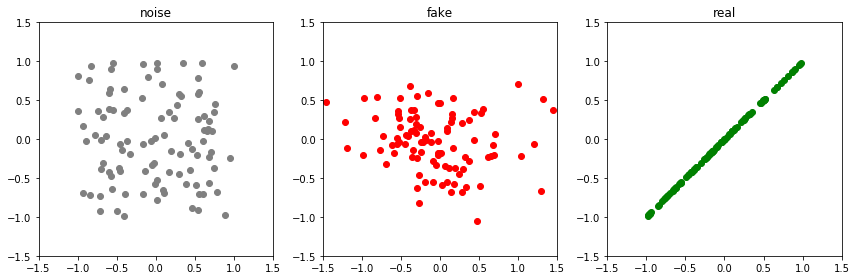

Epoch: 9200 G-error: 1.1151460409164429 D-error: 0.9487481117248535


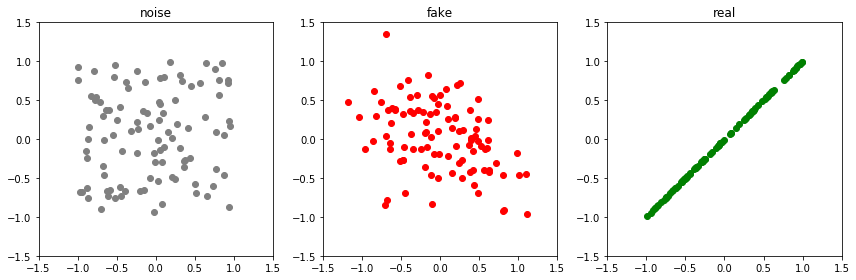

Epoch: 9250 G-error: 1.1305848360061646 D-error: 0.870991587638855


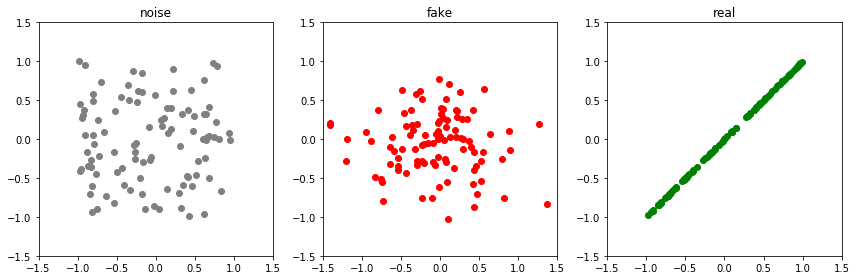

Epoch: 9300 G-error: 1.1122797727584839 D-error: 0.8493201732635498


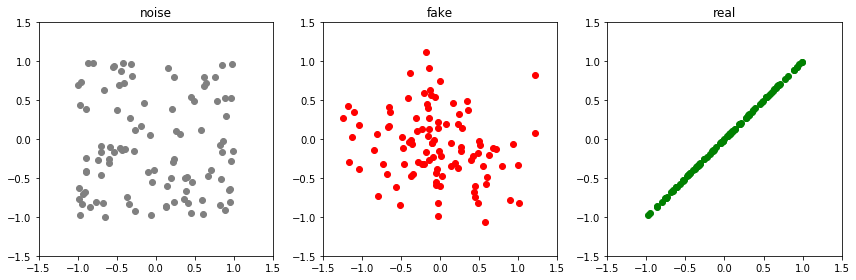

Epoch: 9350 G-error: 1.2369513511657715 D-error: 0.8523600101470947


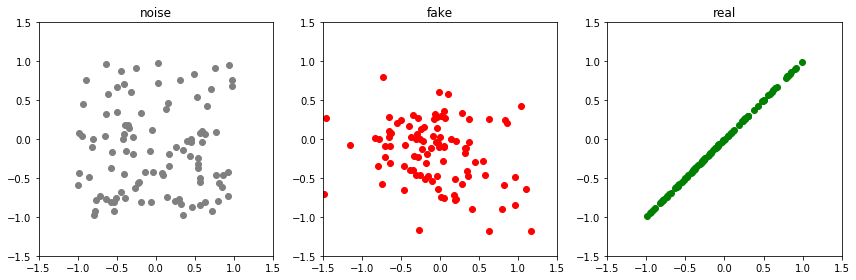

Epoch: 9400 G-error: 1.3011326789855957 D-error: 0.8325462341308594


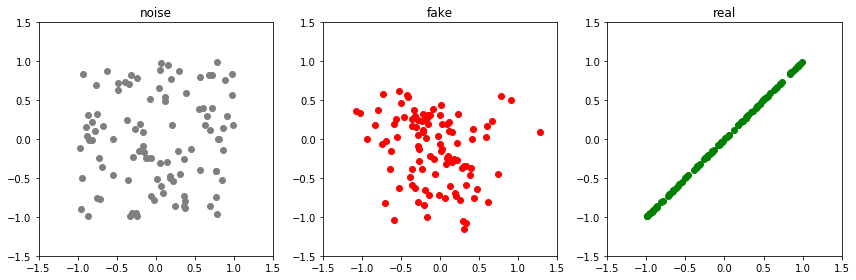

Epoch: 9450 G-error: 1.3123044967651367 D-error: 0.7512433528900146


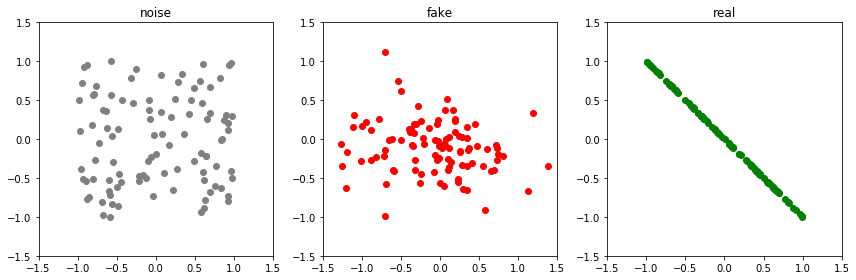

Epoch: 9500 G-error: 1.4124107360839844 D-error: 1.7502785921096802


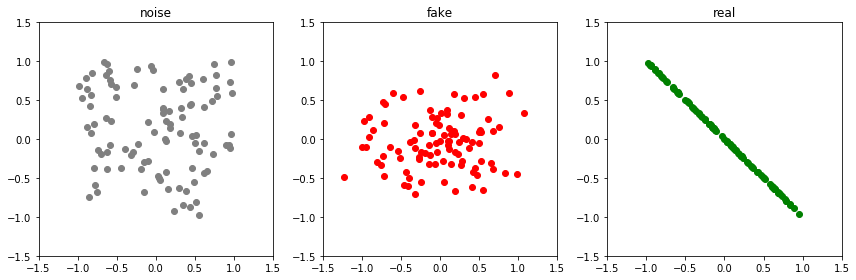

Epoch: 9550 G-error: 0.8207317590713501 D-error: 1.3746814727783203


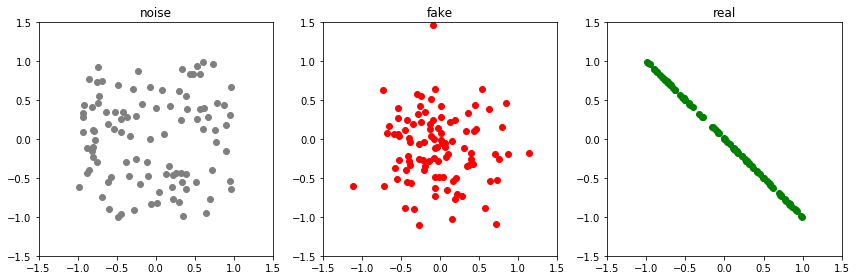

Epoch: 9600 G-error: 0.935738742351532 D-error: 1.109429121017456


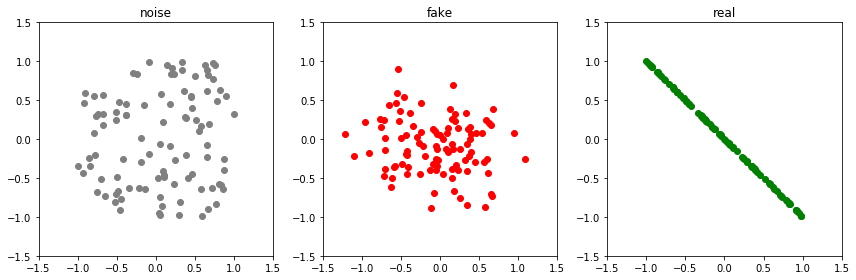

Epoch: 9650 G-error: 1.060559868812561 D-error: 1.0386700630187988


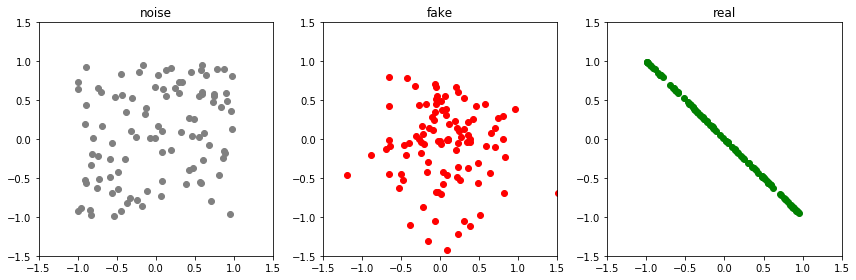

Epoch: 9700 G-error: 1.009385347366333 D-error: 1.0094056129455566


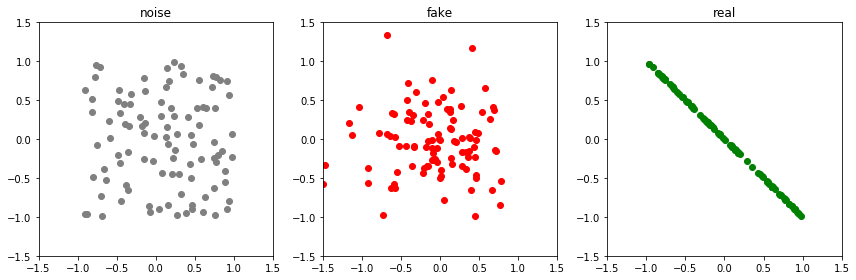

Epoch: 9750 G-error: 1.0874828100204468 D-error: 0.9873147010803223


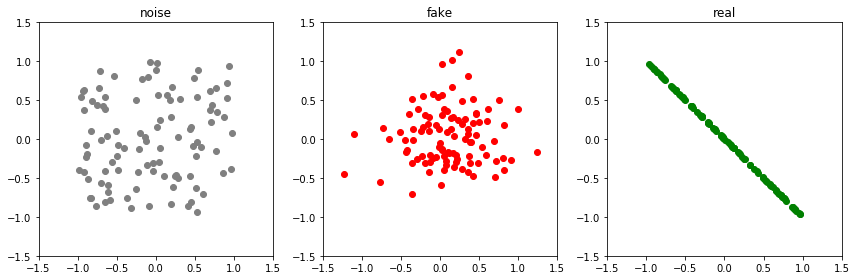

Epoch: 9800 G-error: 1.1844168901443481 D-error: 0.9699074625968933


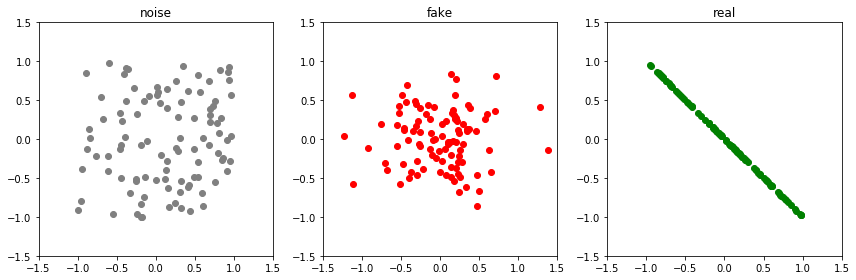

Epoch: 9850 G-error: 1.1520471572875977 D-error: 0.965069591999054


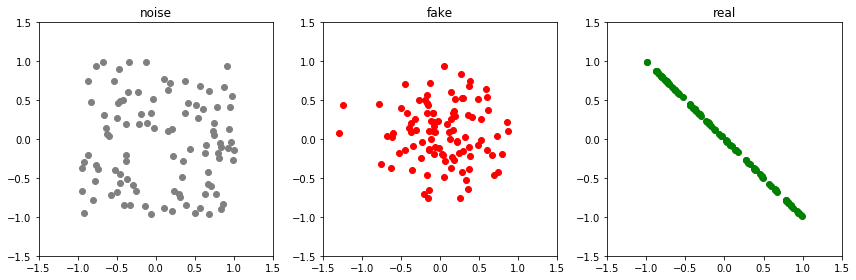

Epoch: 9900 G-error: 1.263787865638733 D-error: 0.8294153213500977


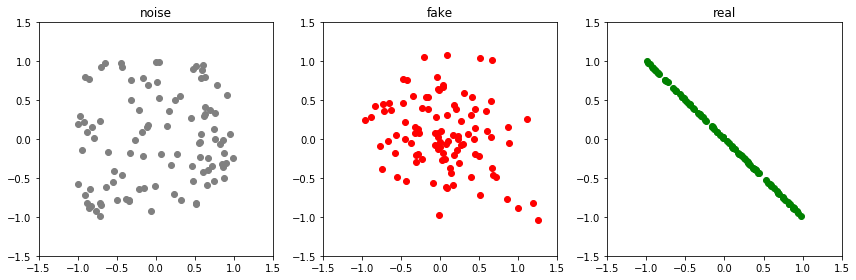

Epoch: 9950 G-error: 1.2756766080856323 D-error: 0.9538331031799316


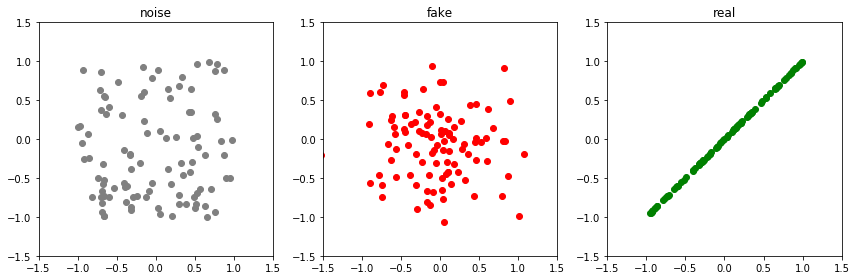

Epoch: 10000 G-error: 1.2460291385650635 D-error: 1.727827787399292


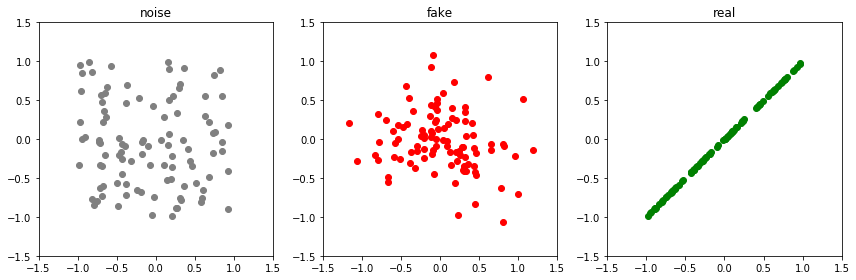

Epoch: 10050 G-error: 0.9371945261955261 D-error: 1.1439990997314453


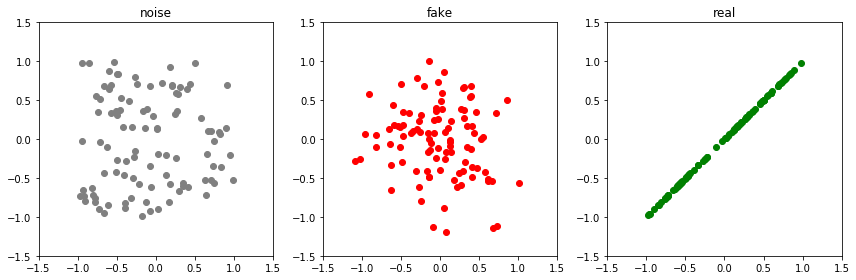

Epoch: 10100 G-error: 1.0674039125442505 D-error: 0.99582839012146


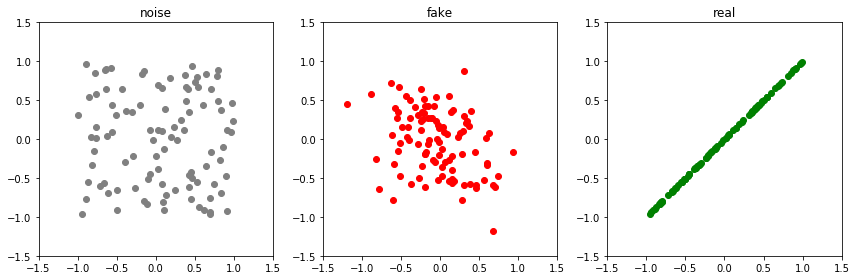

Epoch: 10150 G-error: 1.0745551586151123 D-error: 0.9374144077301025


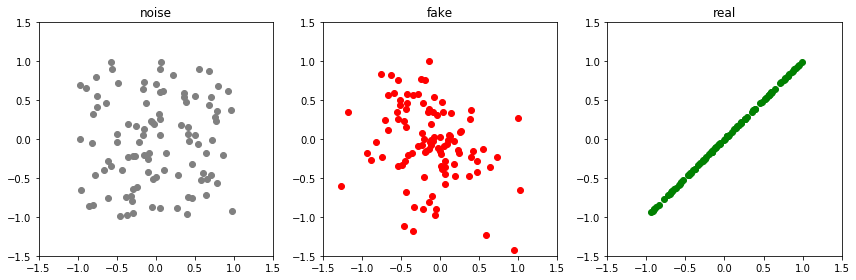

Epoch: 10200 G-error: 1.1796756982803345 D-error: 0.8769921064376831


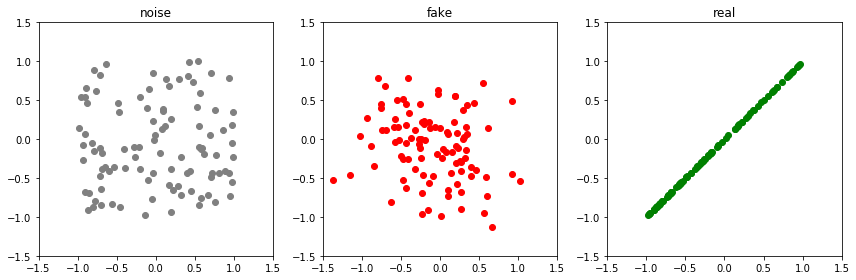

Epoch: 10250 G-error: 1.2880504131317139 D-error: 0.7735366225242615


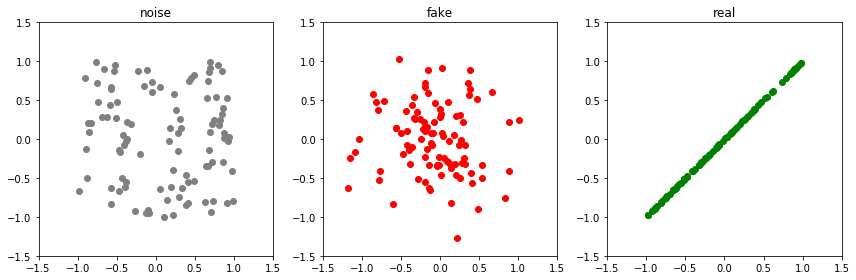

Epoch: 10300 G-error: 1.2858445644378662 D-error: 0.7815641164779663


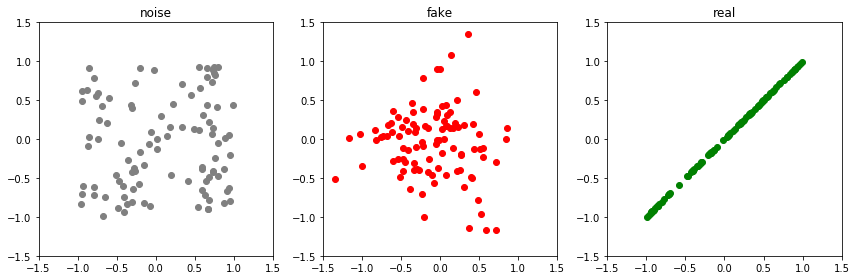

Epoch: 10350 G-error: 1.3092858791351318 D-error: 0.6958585977554321


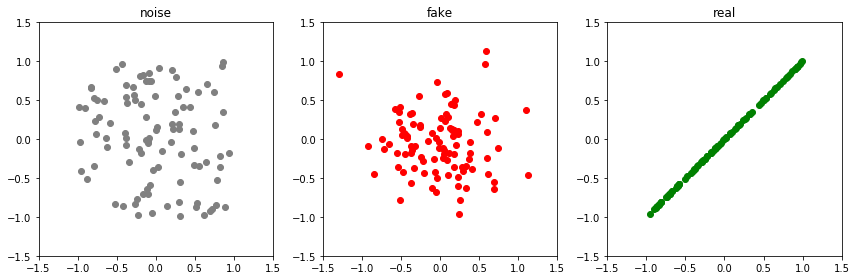

Epoch: 10400 G-error: 1.4127130508422852 D-error: 0.7557822465896606


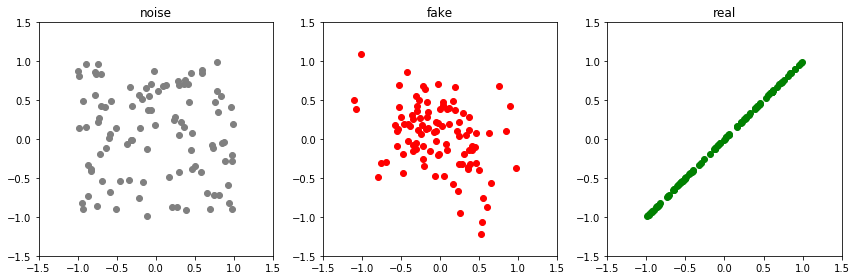

Epoch: 10450 G-error: 1.3891345262527466 D-error: 0.6363797187805176


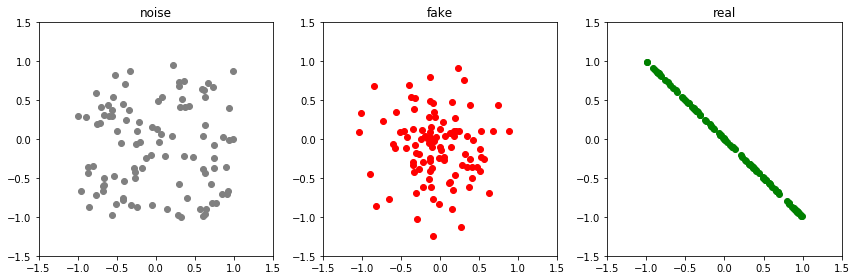

Epoch: 10500 G-error: 1.4770023822784424 D-error: 1.8481266498565674


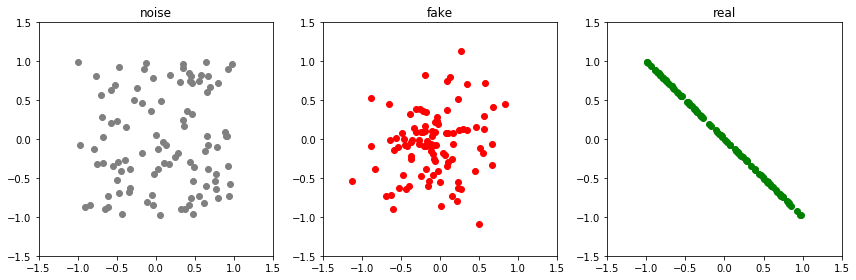

Epoch: 10550 G-error: 0.7497873902320862 D-error: 1.275630235671997


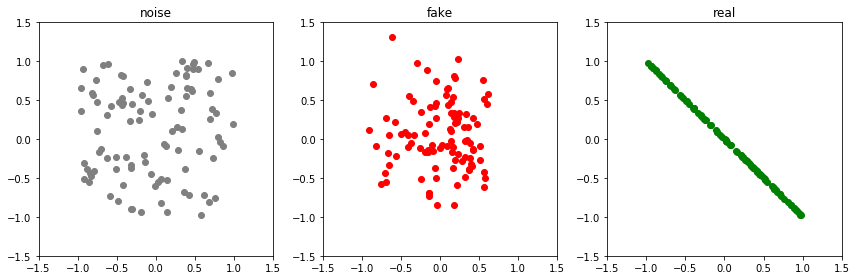

Epoch: 10600 G-error: 1.0535287857055664 D-error: 1.0872668027877808


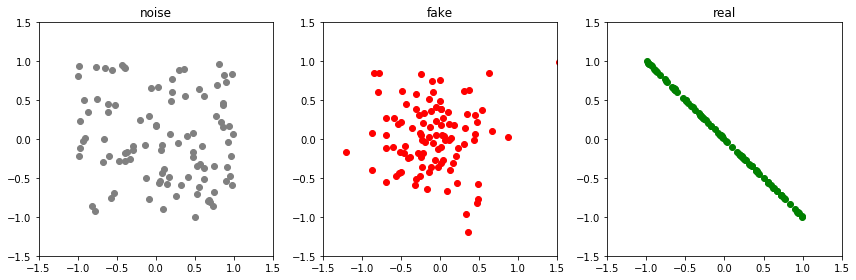

Epoch: 10650 G-error: 1.1234856843948364 D-error: 1.0272152423858643


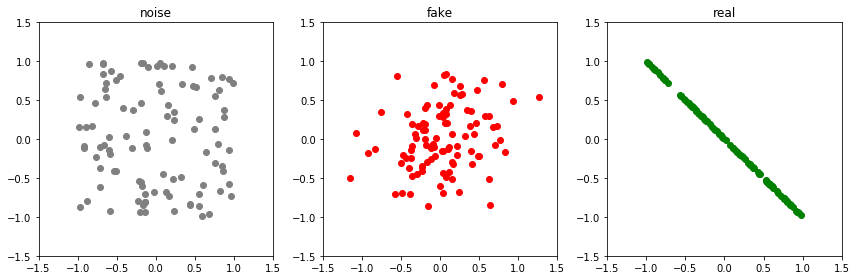

Epoch: 10700 G-error: 1.241109848022461 D-error: 0.893950343132019


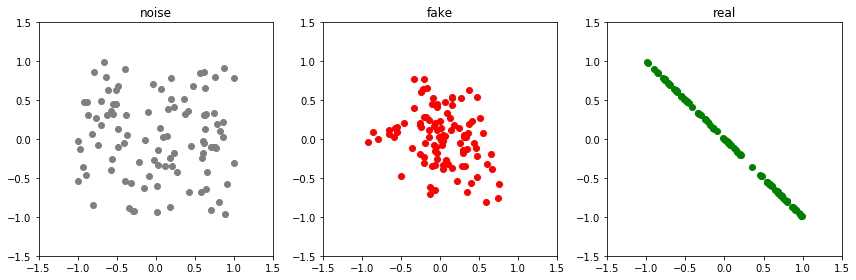

Epoch: 10750 G-error: 1.2728136777877808 D-error: 0.7964296340942383


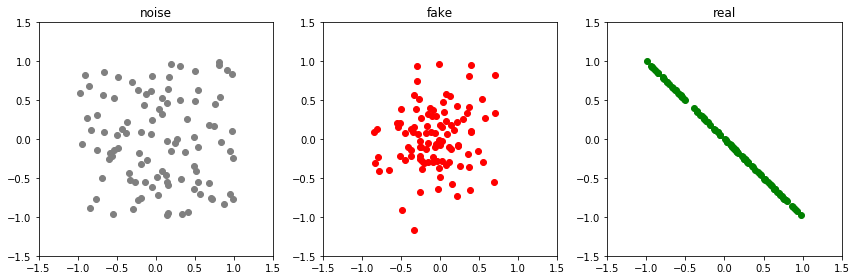

Epoch: 10800 G-error: 1.287747859954834 D-error: 0.8936482667922974


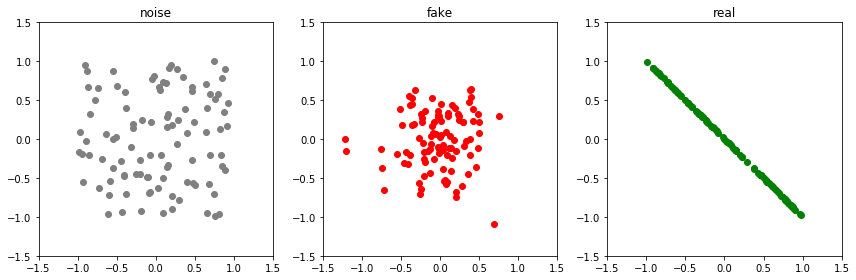

Epoch: 10850 G-error: 1.2144559621810913 D-error: 0.7800127267837524


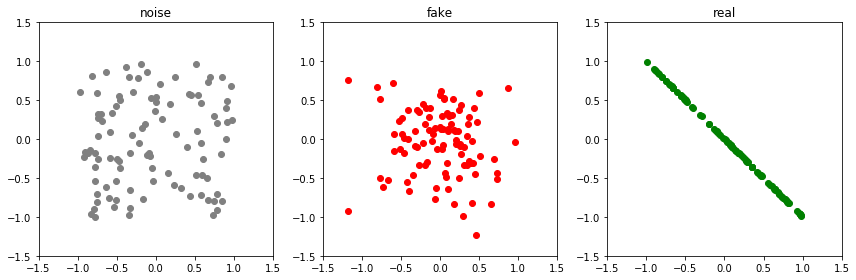

Epoch: 10900 G-error: 1.3790271282196045 D-error: 0.879116415977478


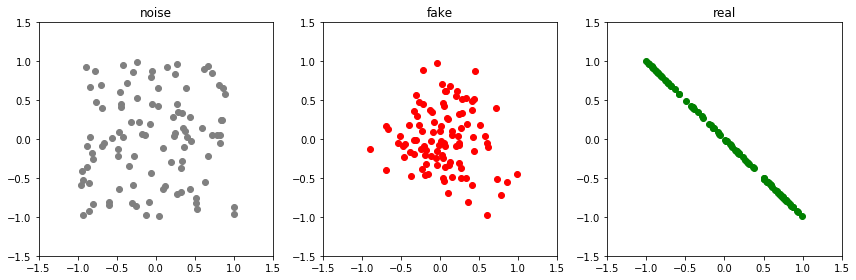

Epoch: 10950 G-error: 1.4118318557739258 D-error: 0.7183775305747986


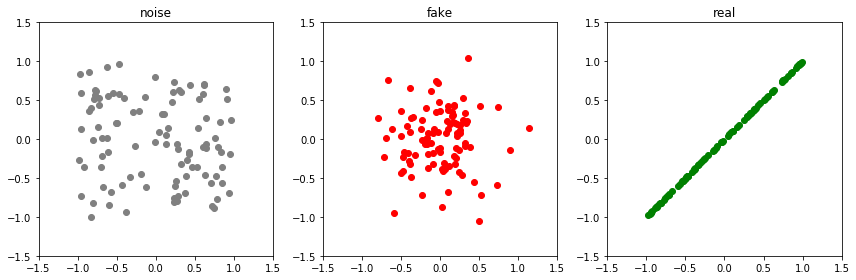

Epoch: 11000 G-error: 1.4227726459503174 D-error: 1.6399208307266235


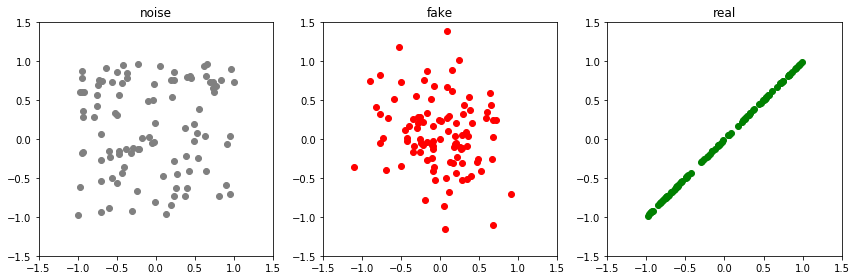

Epoch: 11050 G-error: 1.0313048362731934 D-error: 1.0364007949829102


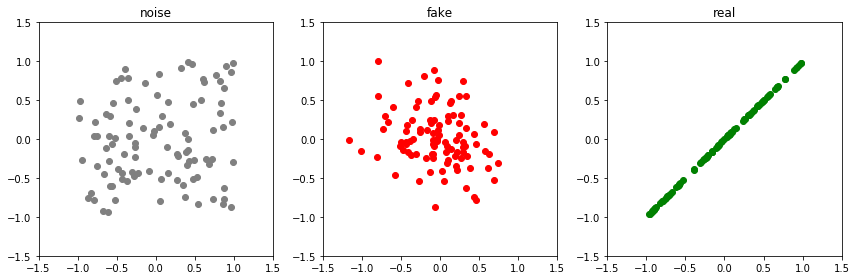

Epoch: 11100 G-error: 1.1506704092025757 D-error: 0.8996841907501221


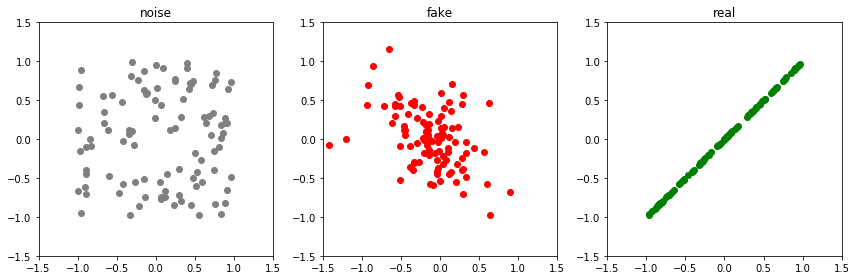

Epoch: 11150 G-error: 1.3021323680877686 D-error: 0.836716890335083


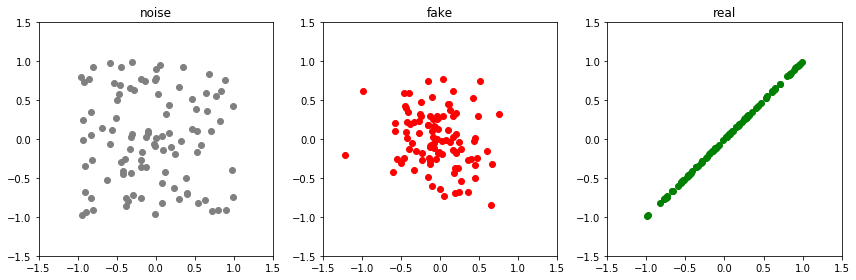

Epoch: 11200 G-error: 1.2880845069885254 D-error: 0.7831115126609802


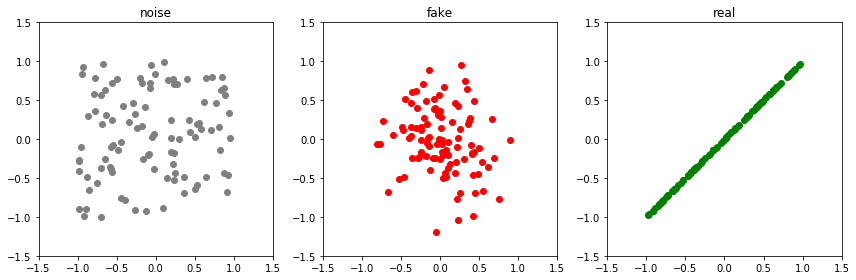

Epoch: 11250 G-error: 1.4561022520065308 D-error: 0.7018058896064758


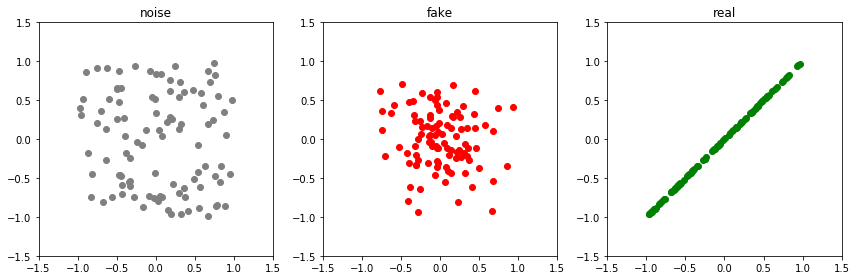

Epoch: 11300 G-error: 1.5772343873977661 D-error: 0.6849454641342163


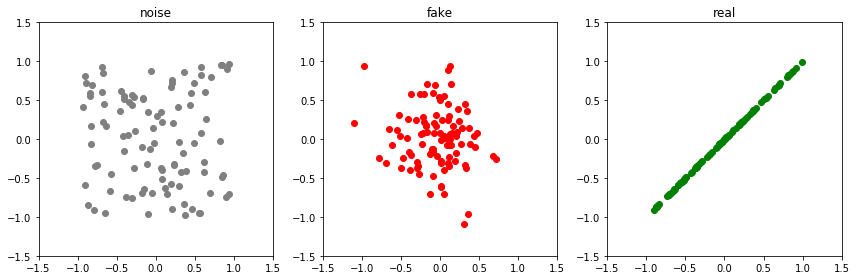

Epoch: 11350 G-error: 1.5525498390197754 D-error: 0.6969912052154541


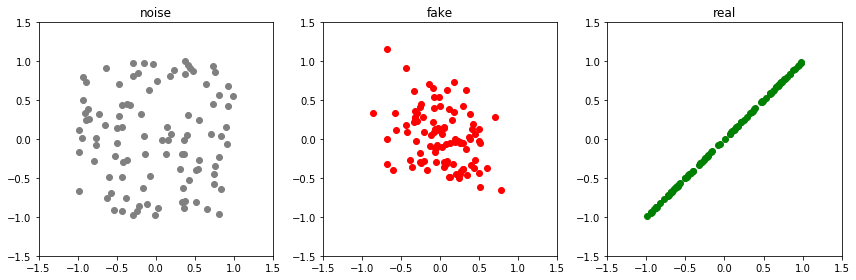

Epoch: 11400 G-error: 1.668636441230774 D-error: 0.6110638380050659


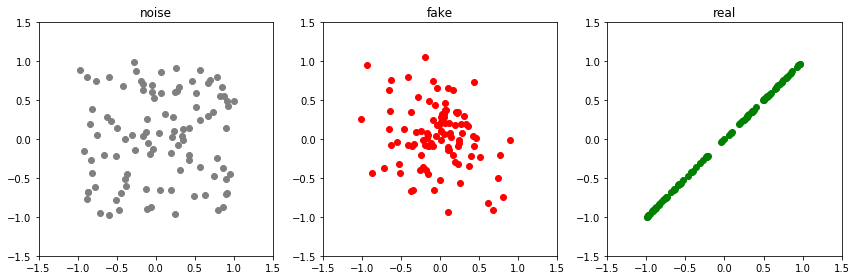

Epoch: 11450 G-error: 1.5726029872894287 D-error: 0.5672738552093506


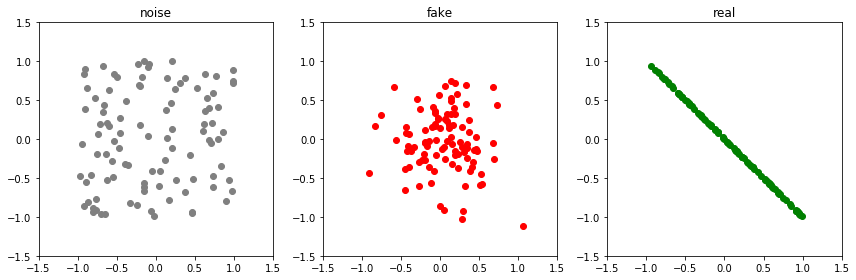

Epoch: 11500 G-error: 1.682474970817566 D-error: 1.841770887374878


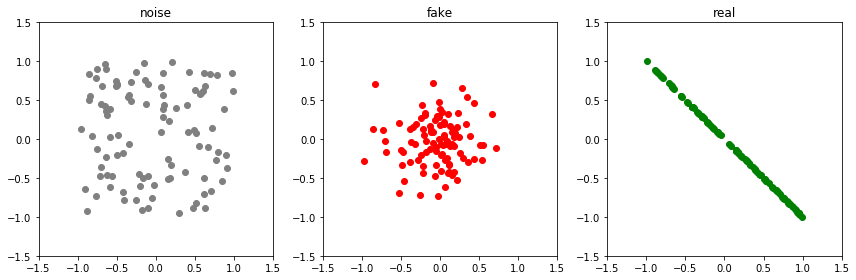

Epoch: 11550 G-error: 1.0027307271957397 D-error: 1.1706218719482422


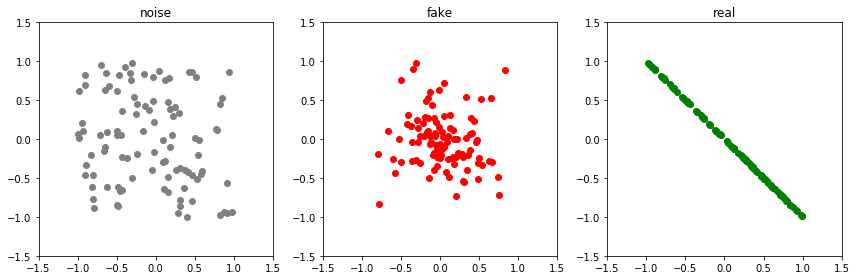

Epoch: 11600 G-error: 1.1078426837921143 D-error: 1.0017582178115845


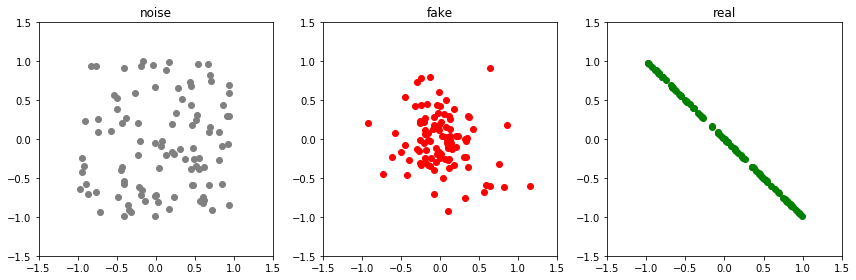

Epoch: 11650 G-error: 1.2150523662567139 D-error: 0.8722432851791382


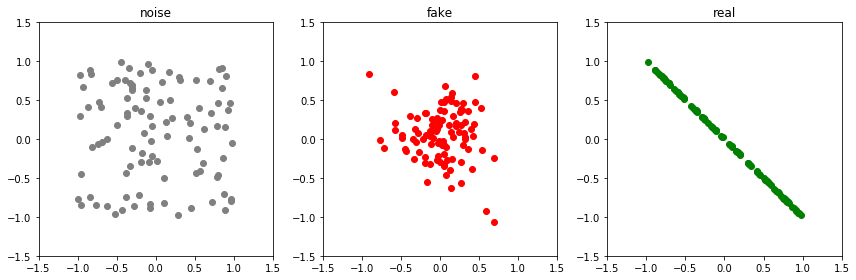

Epoch: 11700 G-error: 1.1589435338974 D-error: 0.838088870048523


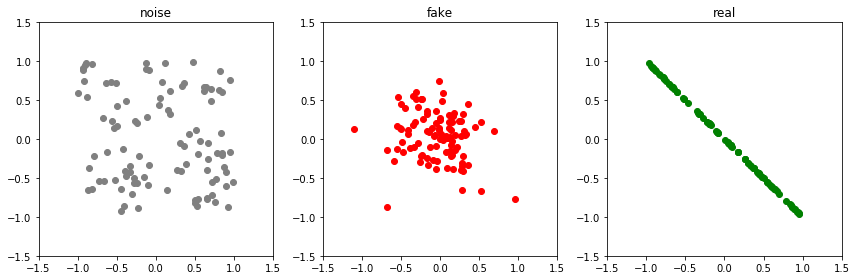

Epoch: 11750 G-error: 1.2877482175827026 D-error: 0.8701103925704956


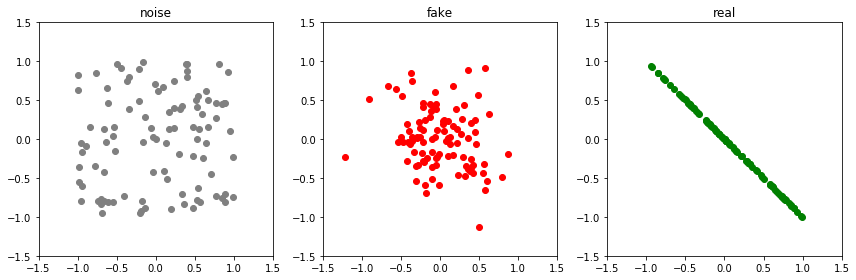

Epoch: 11800 G-error: 1.3021271228790283 D-error: 0.9001192450523376


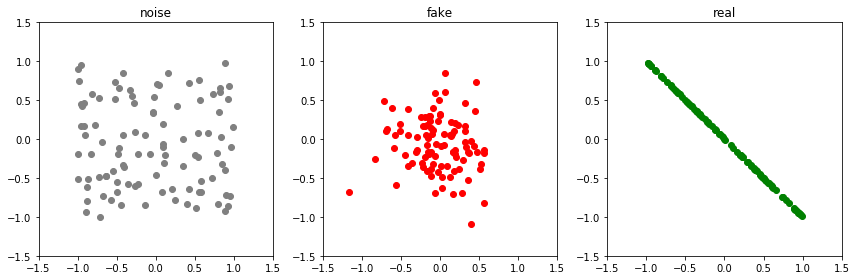

Epoch: 11850 G-error: 1.29404878616333 D-error: 0.7401485443115234


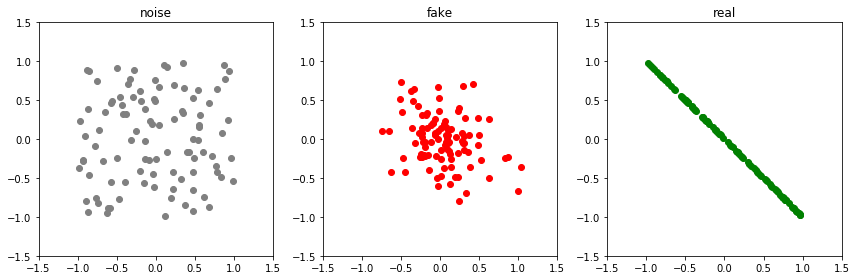

Epoch: 11900 G-error: 1.478744387626648 D-error: 0.7605688571929932


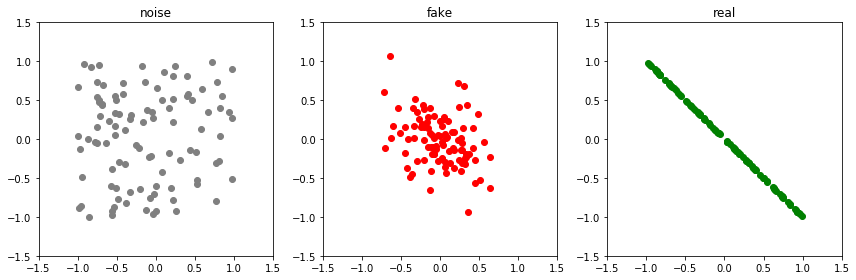

Epoch: 11950 G-error: 1.4016003608703613 D-error: 0.8190350532531738


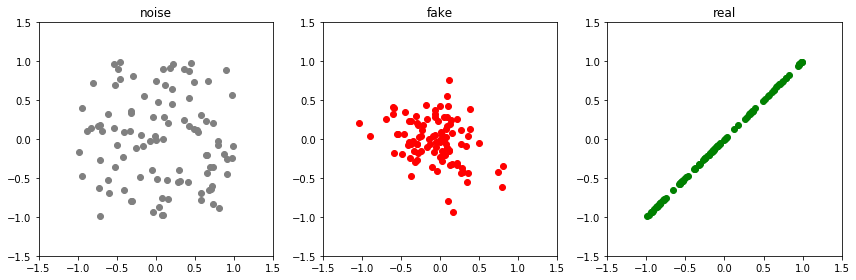

Epoch: 12000 G-error: 1.4649919271469116 D-error: 1.3161165714263916


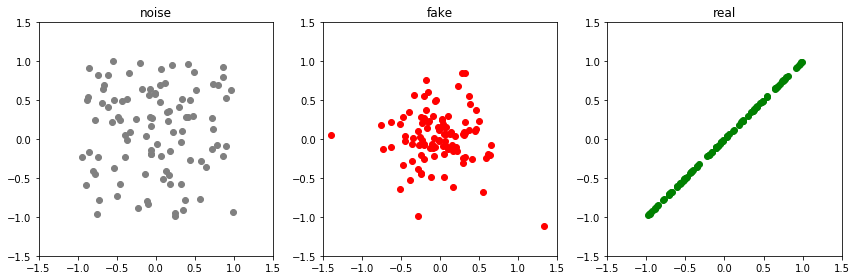

Epoch: 12050 G-error: 1.1844309568405151 D-error: 0.8806847929954529


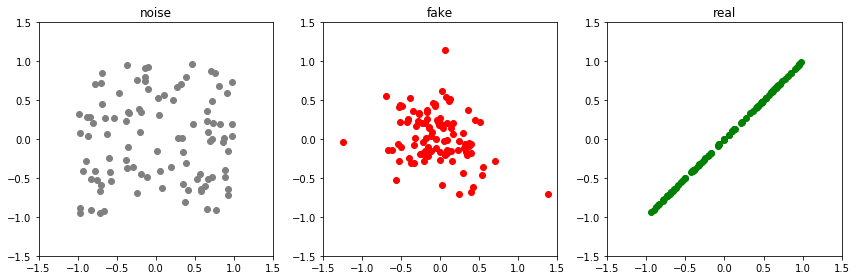

Epoch: 12100 G-error: 1.2841094732284546 D-error: 0.7660818099975586


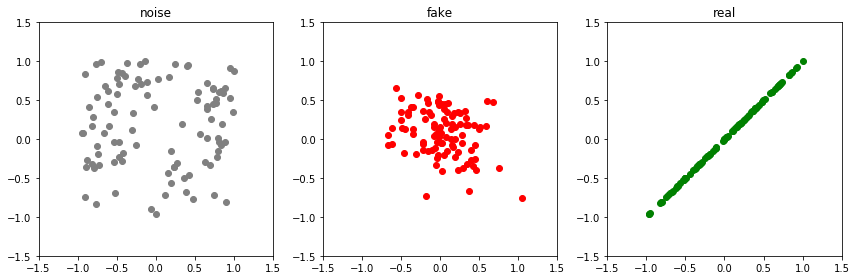

Epoch: 12150 G-error: 1.4409658908843994 D-error: 0.7568604946136475


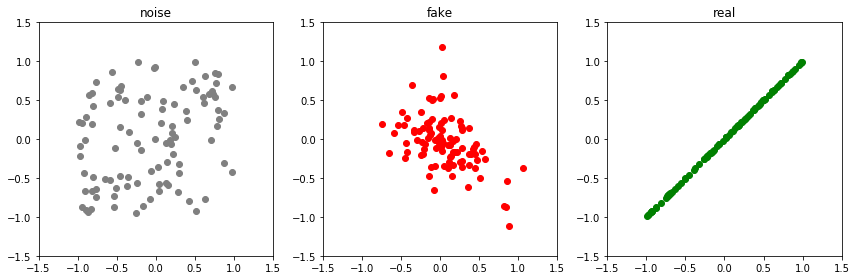

Epoch: 12200 G-error: 1.5633697509765625 D-error: 0.6436977386474609


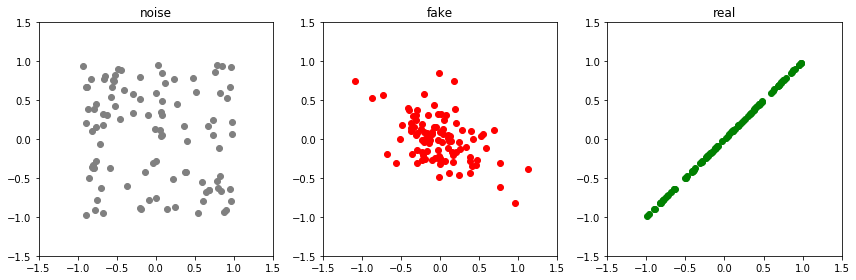

Epoch: 12250 G-error: 1.4458352327346802 D-error: 0.6371588706970215


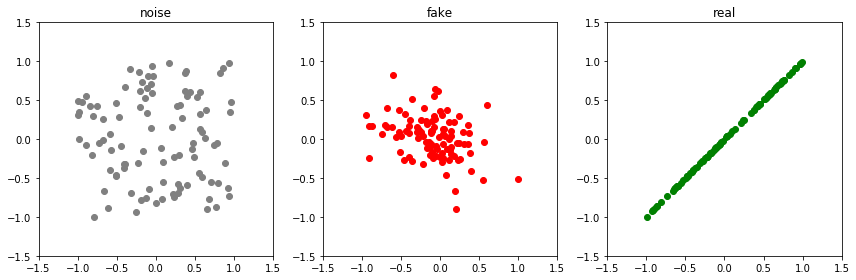

Epoch: 12300 G-error: 1.7722564935684204 D-error: 0.5693962574005127


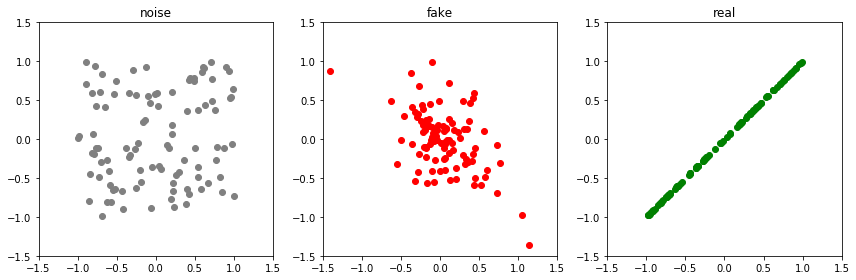

Epoch: 12350 G-error: 1.7231299877166748 D-error: 0.5565798282623291


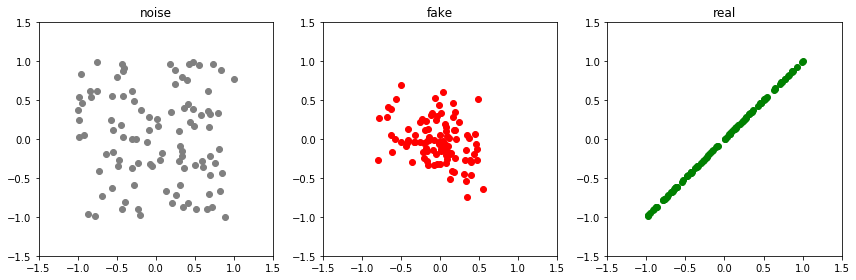

Epoch: 12400 G-error: 1.7600599527359009 D-error: 0.57752525806427


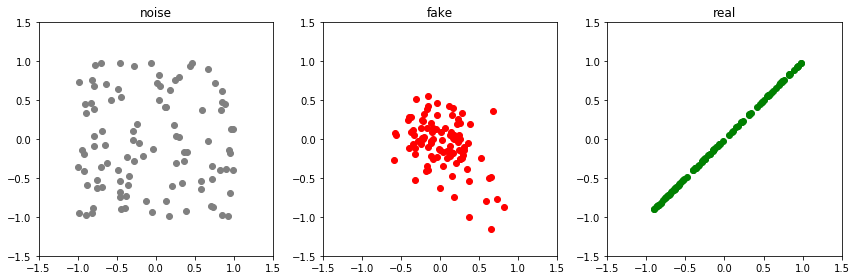

Epoch: 12450 G-error: 1.7987703084945679 D-error: 0.49042755365371704


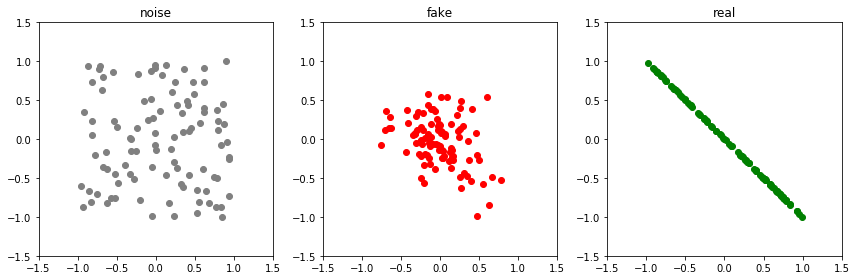

Epoch: 12500 G-error: 1.815451979637146 D-error: 1.8466910123825073


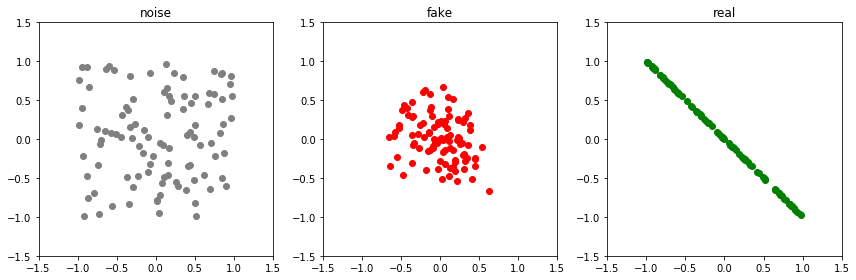

Epoch: 12550 G-error: 1.1886348724365234 D-error: 1.010801076889038


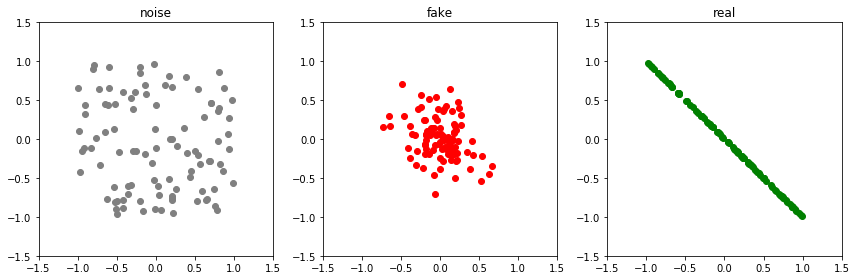

Epoch: 12600 G-error: 1.1702889204025269 D-error: 0.9731453061103821


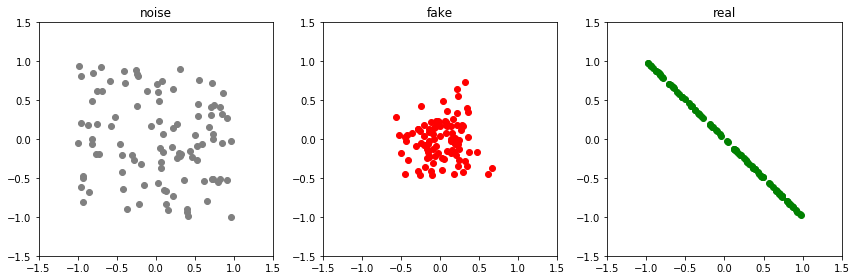

Epoch: 12650 G-error: 1.2036694288253784 D-error: 0.8159973621368408


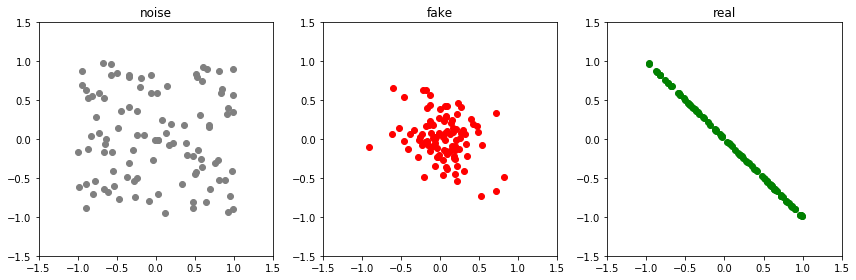

Epoch: 12700 G-error: 1.2843927145004272 D-error: 0.7513521909713745


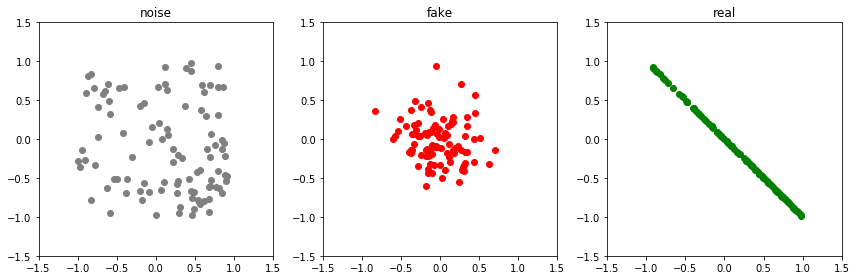

Epoch: 12750 G-error: 1.4325107336044312 D-error: 0.8051531314849854


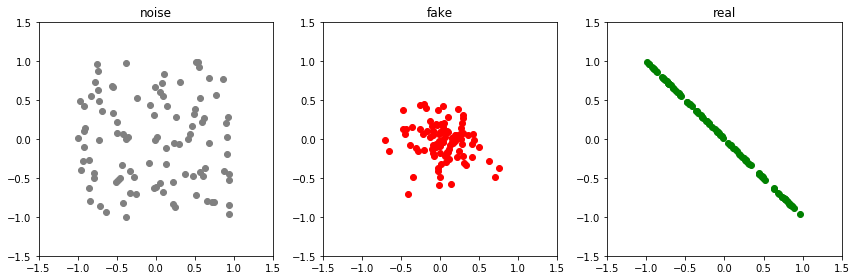

Epoch: 12800 G-error: 1.4914497137069702 D-error: 0.7205008268356323


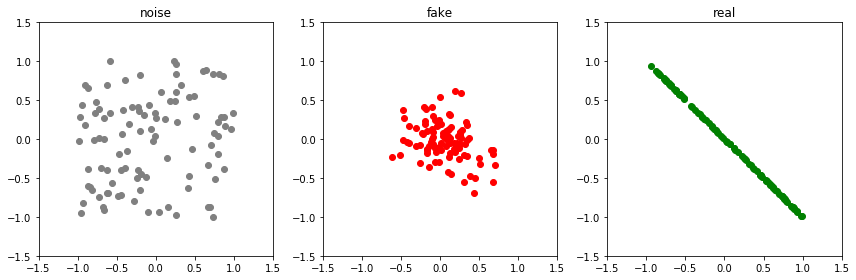

Epoch: 12850 G-error: 1.5512661933898926 D-error: 0.6692312359809875


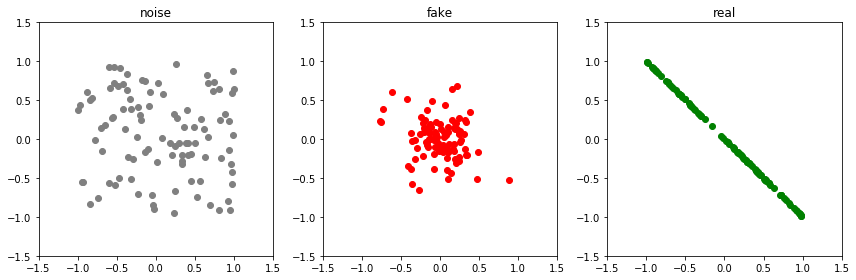

Epoch: 12900 G-error: 1.5007420778274536 D-error: 0.7118748426437378


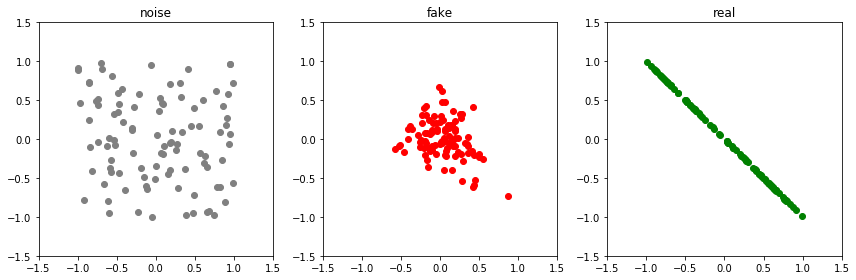

Epoch: 12950 G-error: 1.5021917819976807 D-error: 0.6524933576583862


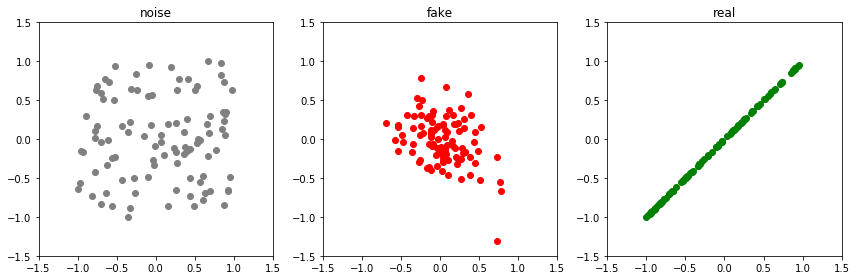

Epoch: 13000 G-error: 1.4968304634094238 D-error: 1.0598294734954834


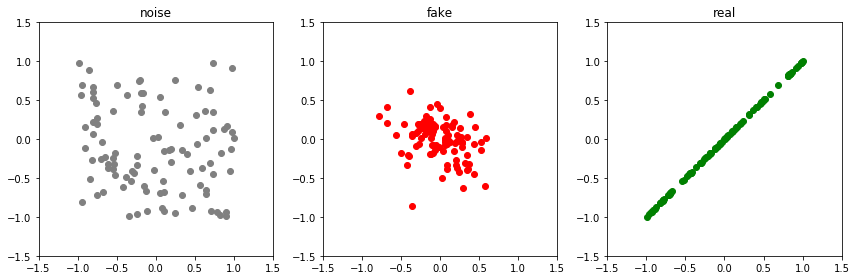

Epoch: 13050 G-error: 1.3008432388305664 D-error: 0.7875993251800537


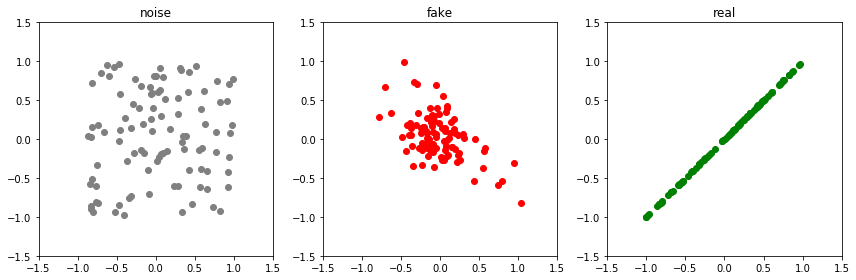

Epoch: 13100 G-error: 1.3894115686416626 D-error: 0.739607036113739


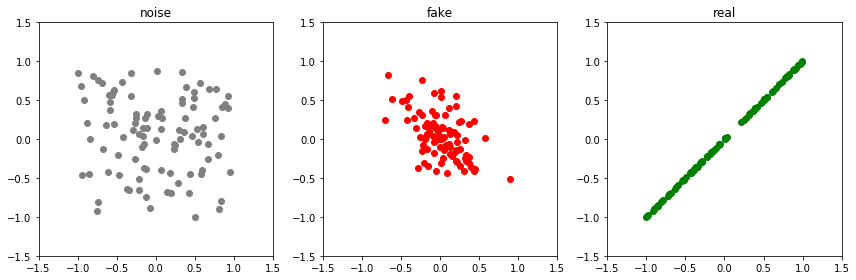

Epoch: 13150 G-error: 1.6332659721374512 D-error: 0.626323938369751


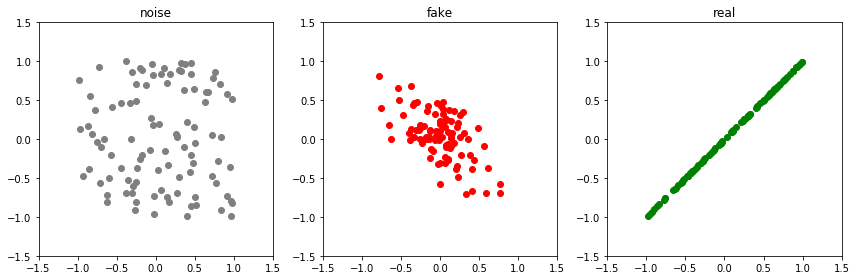

Epoch: 13200 G-error: 1.6659260988235474 D-error: 0.5614451169967651


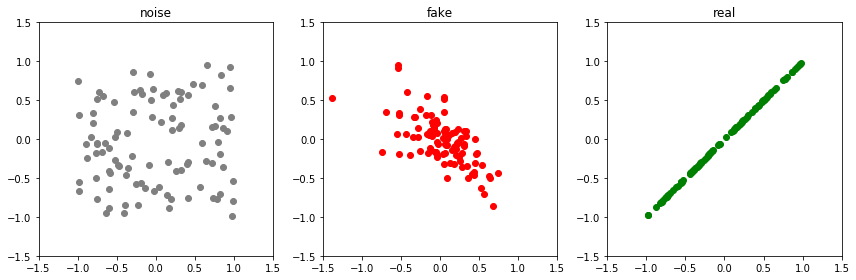

Epoch: 13250 G-error: 1.6946165561676025 D-error: 0.5398223996162415


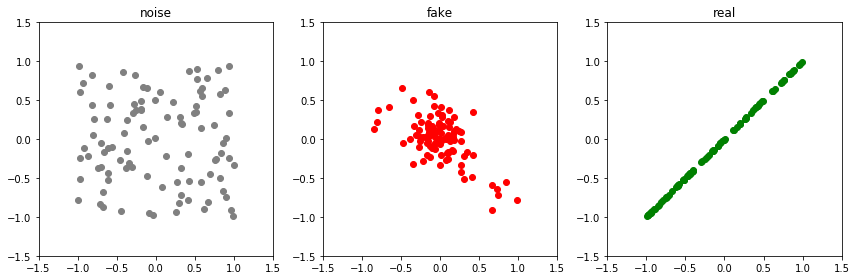

Epoch: 13300 G-error: 1.8276362419128418 D-error: 0.5184773206710815


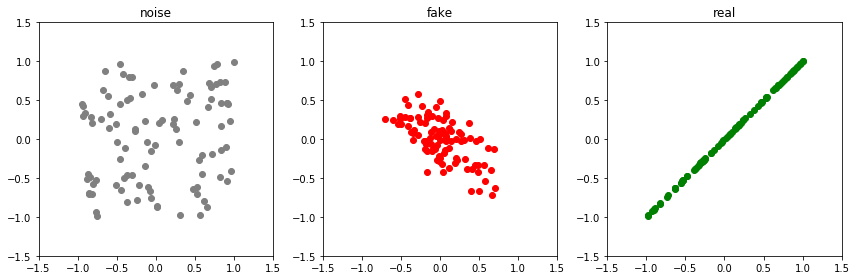

Epoch: 13350 G-error: 1.9248217344284058 D-error: 0.46583813428878784


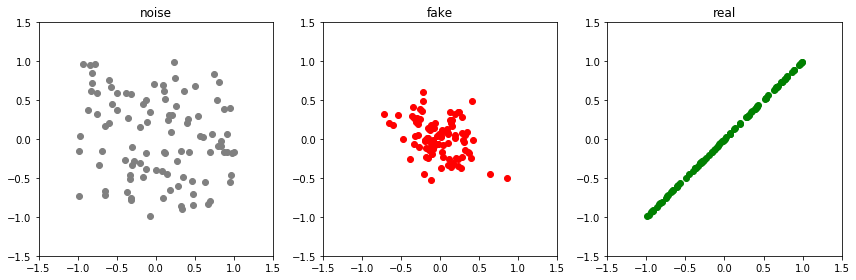

Epoch: 13400 G-error: 1.7419657707214355 D-error: 0.4983489513397217


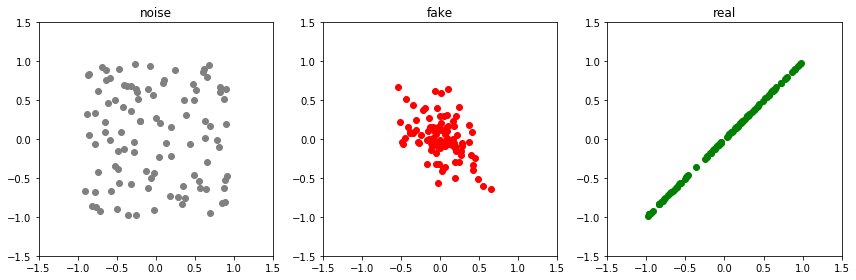

Epoch: 13450 G-error: 1.9796147346496582 D-error: 0.5033895373344421


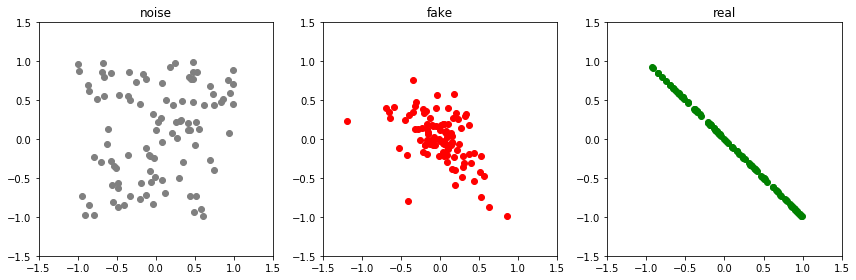

Epoch: 13500 G-error: 1.9857722520828247 D-error: 1.9150291681289673


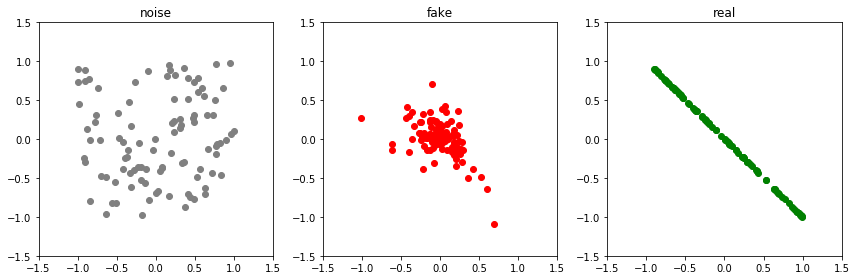

Epoch: 13550 G-error: 1.142386794090271 D-error: 1.020042896270752


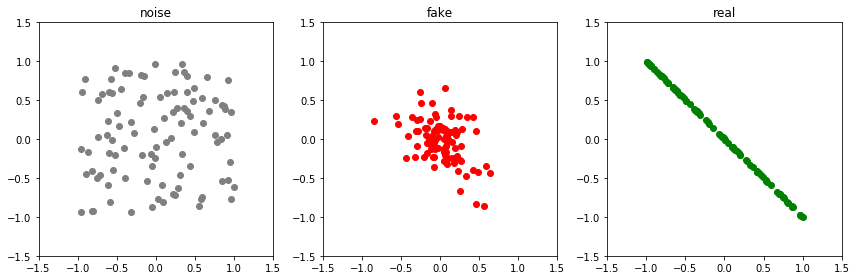

Epoch: 13600 G-error: 1.2042303085327148 D-error: 0.77934730052948


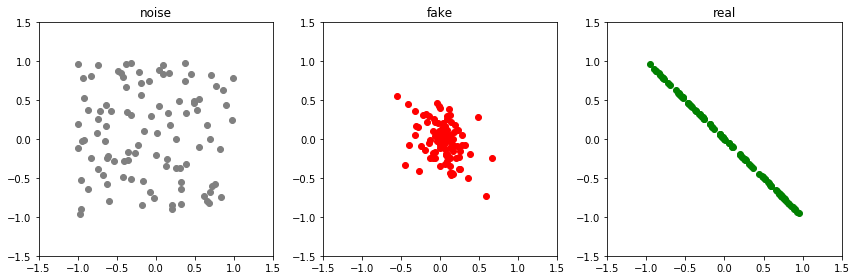

Epoch: 13650 G-error: 1.2581169605255127 D-error: 0.8168125152587891


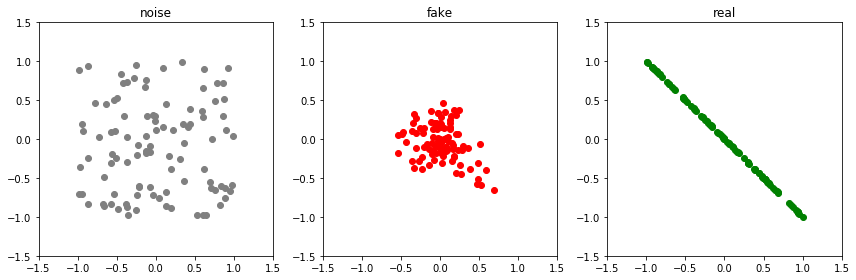

Epoch: 13700 G-error: 1.3706187009811401 D-error: 0.8282602429389954


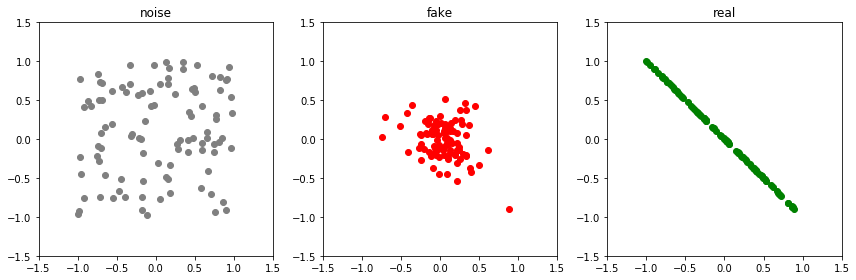

Epoch: 13750 G-error: 1.3220083713531494 D-error: 0.8670967817306519


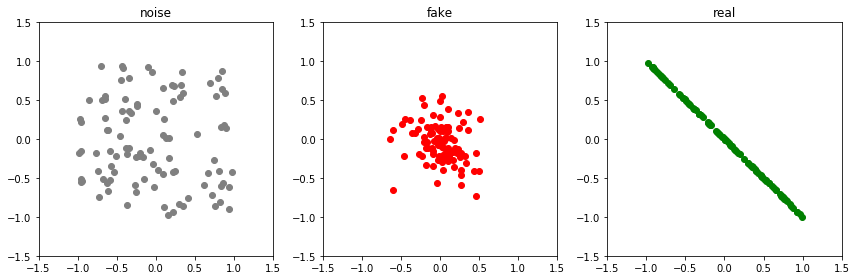

Epoch: 13800 G-error: 1.4843568801879883 D-error: 0.7945268750190735


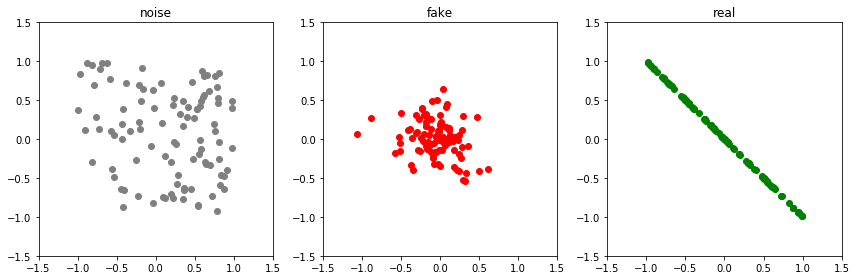

Epoch: 13850 G-error: 1.4561514854431152 D-error: 0.712009608745575


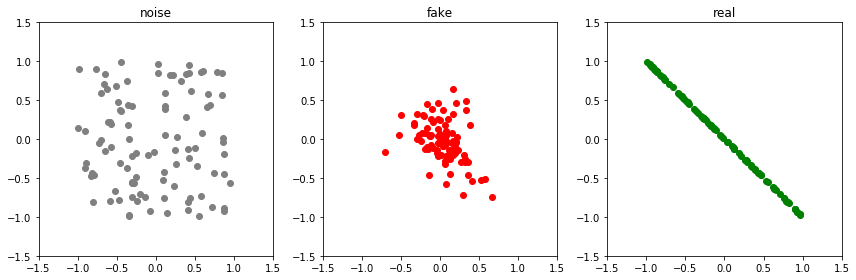

Epoch: 13900 G-error: 1.6115542650222778 D-error: 0.7354834079742432


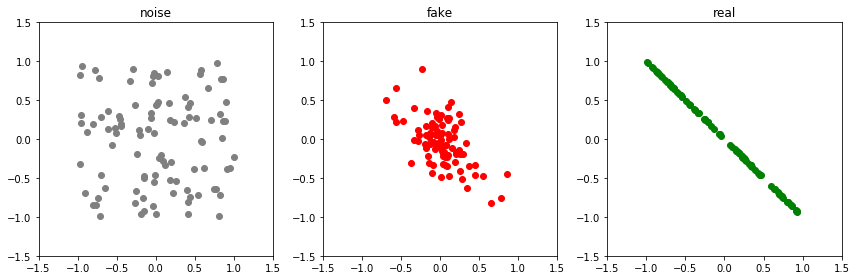

Epoch: 13950 G-error: 1.449023723602295 D-error: 0.791165828704834


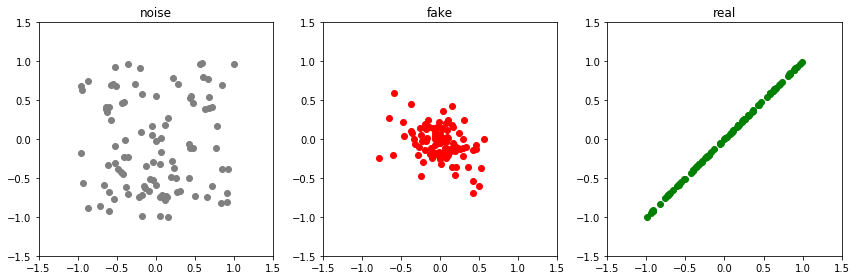

Epoch: 14000 G-error: 1.6404680013656616 D-error: 1.0524901151657104


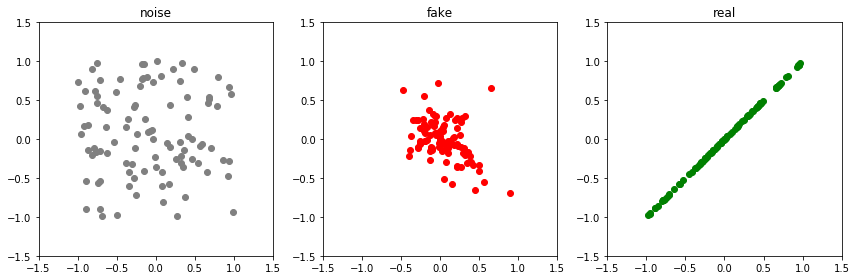

Epoch: 14050 G-error: 1.5775729417800903 D-error: 0.8054314851760864


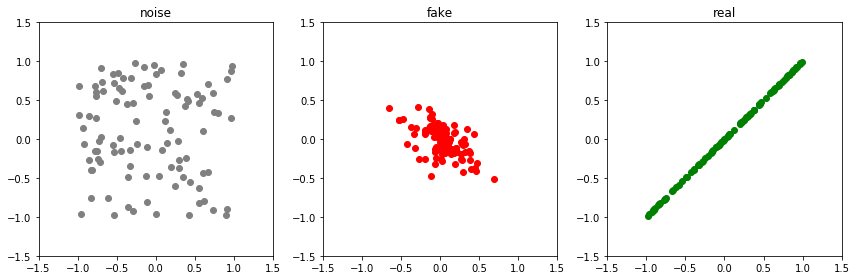

Epoch: 14100 G-error: 1.4915411472320557 D-error: 0.5867605805397034


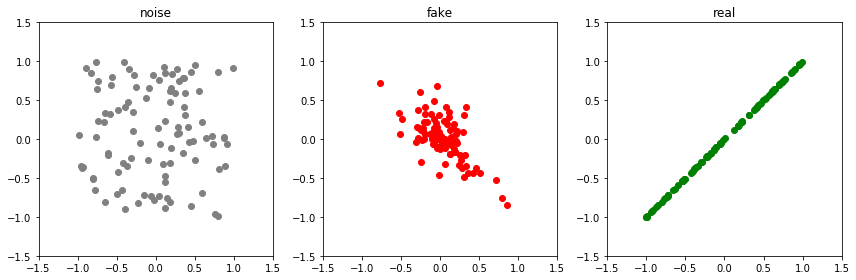

Epoch: 14150 G-error: 1.654497504234314 D-error: 0.5763490200042725


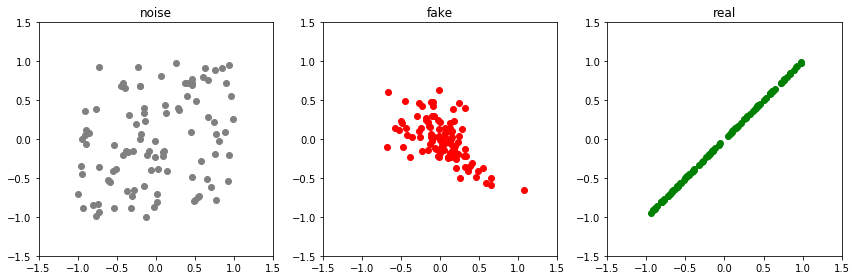

Epoch: 14200 G-error: 1.8030824661254883 D-error: 0.4645196199417114


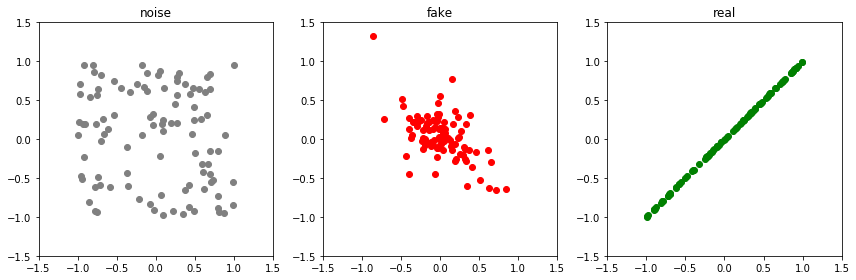

Epoch: 14250 G-error: 1.9114729166030884 D-error: 0.5242168307304382


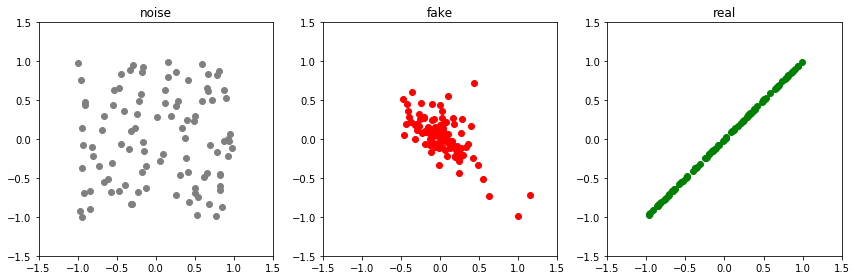

Epoch: 14300 G-error: 1.969902515411377 D-error: 0.472642719745636


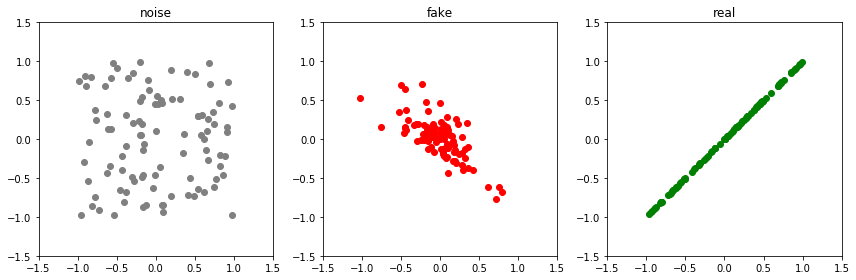

Epoch: 14350 G-error: 1.8923776149749756 D-error: 0.45726799964904785


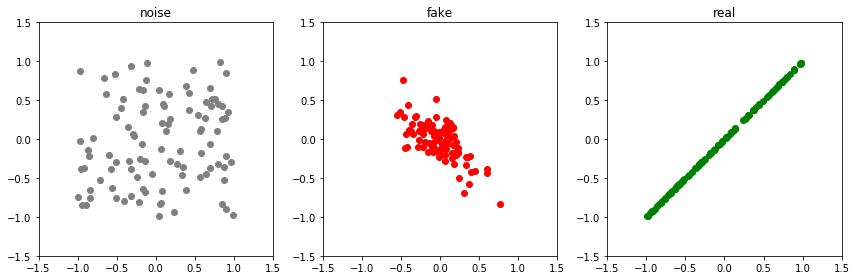

Epoch: 14400 G-error: 2.0026493072509766 D-error: 0.39194759726524353


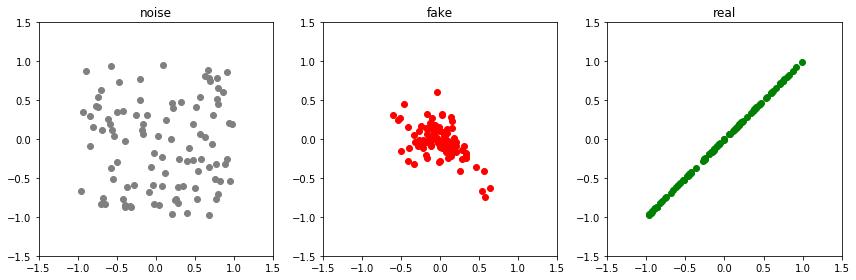

Epoch: 14450 G-error: 2.055081844329834 D-error: 0.49059802293777466


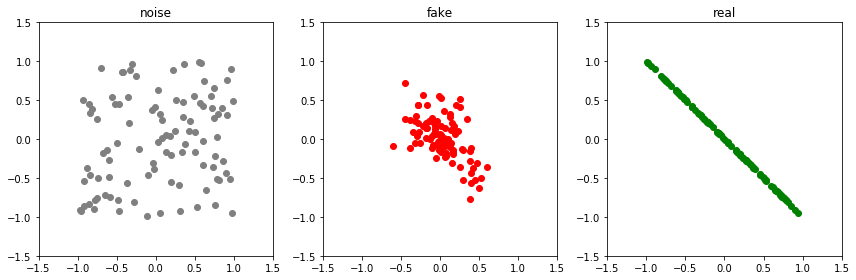

Epoch: 14500 G-error: 2.14626145362854 D-error: 2.0065805912017822


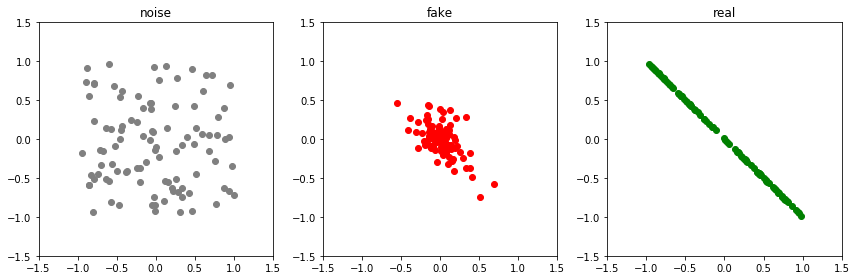

Epoch: 14550 G-error: 1.1588695049285889 D-error: 0.9609459638595581


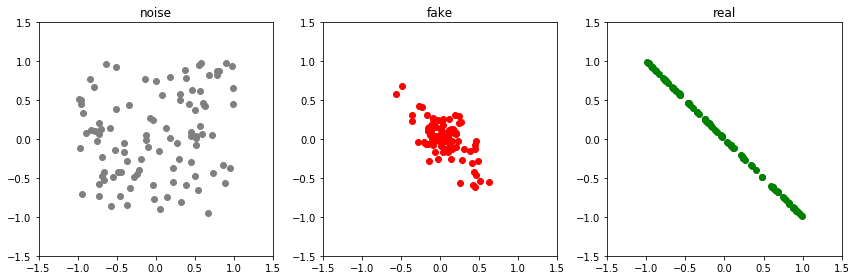

Epoch: 14600 G-error: 1.2159565687179565 D-error: 0.7906965613365173


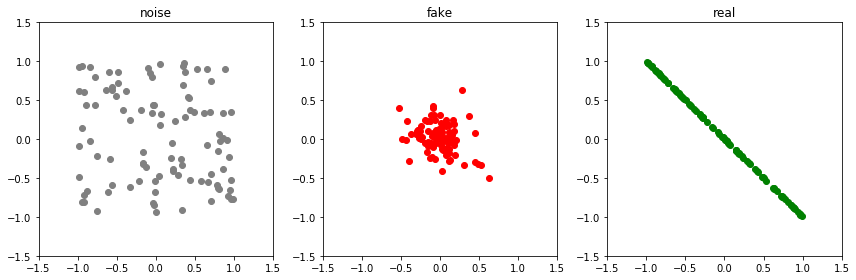

Epoch: 14650 G-error: 1.312771201133728 D-error: 0.7482760548591614


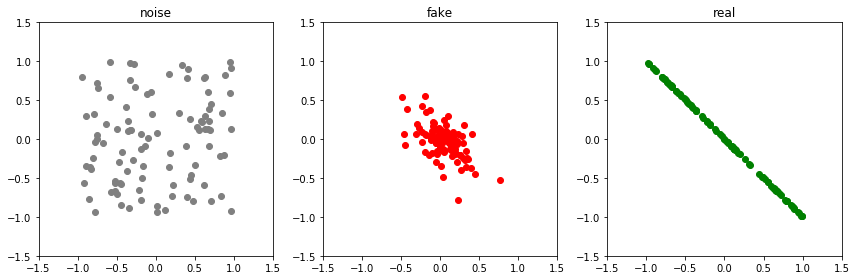

Epoch: 14700 G-error: 1.4435538053512573 D-error: 0.7557268738746643


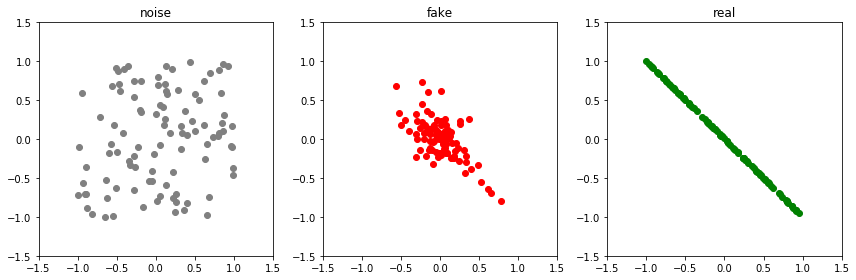

Epoch: 14750 G-error: 1.4447333812713623 D-error: 0.9145678281784058


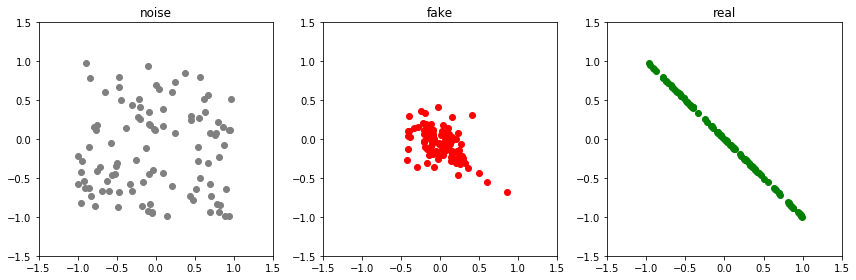

Epoch: 14800 G-error: 1.4641709327697754 D-error: 0.6974111795425415


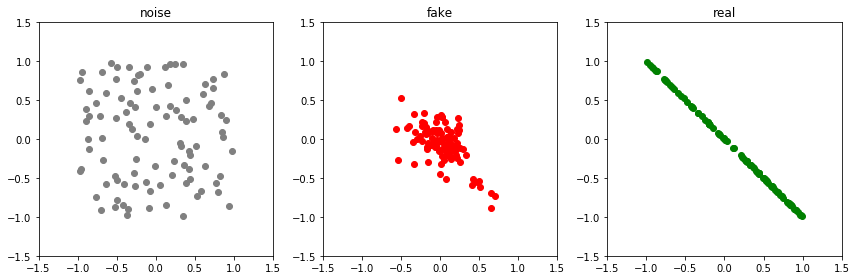

Epoch: 14850 G-error: 1.5577418804168701 D-error: 0.810307502746582


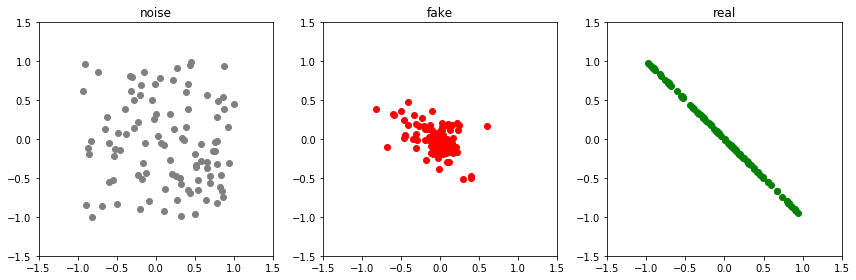

Epoch: 14900 G-error: 1.5733805894851685 D-error: 0.8366590738296509


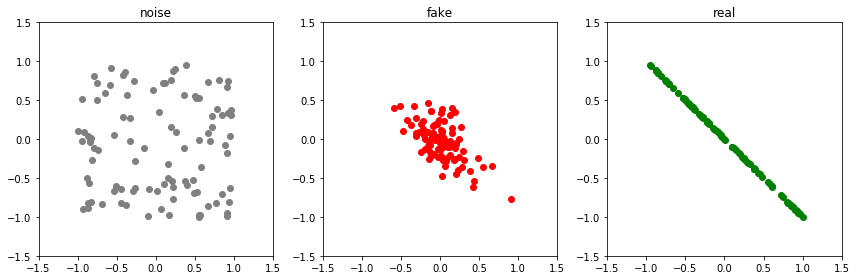

Epoch: 14950 G-error: 1.4363077878952026 D-error: 0.7352761626243591


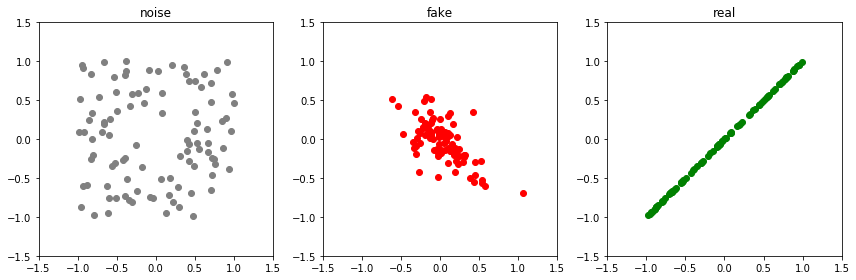

Epoch: 15000 G-error: 1.5005524158477783 D-error: 0.7715109586715698


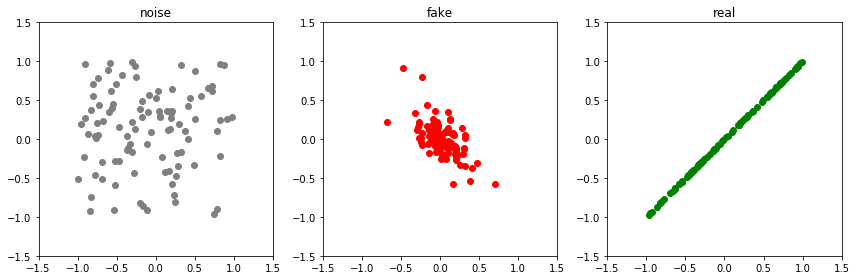

Epoch: 15050 G-error: 1.6702669858932495 D-error: 0.5865030884742737


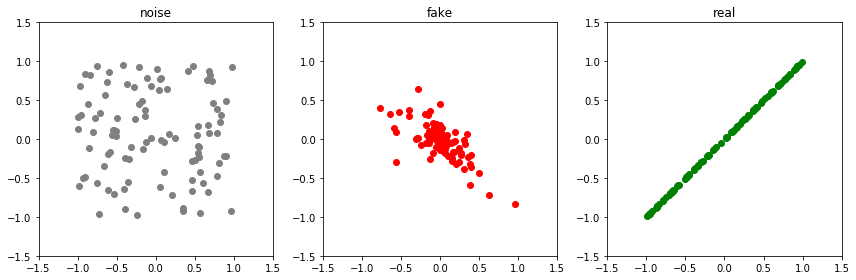

Epoch: 15100 G-error: 1.6316862106323242 D-error: 0.5058280229568481


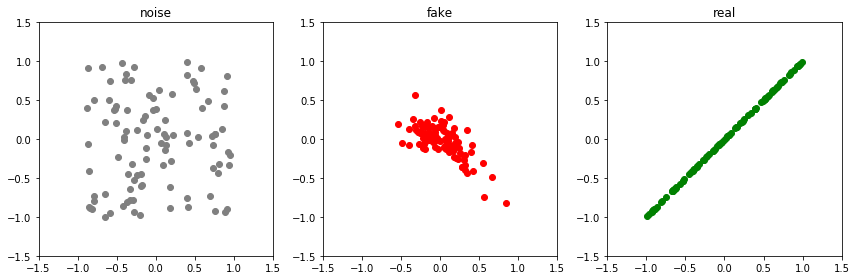

Epoch: 15150 G-error: 1.93662691116333 D-error: 0.44705986976623535


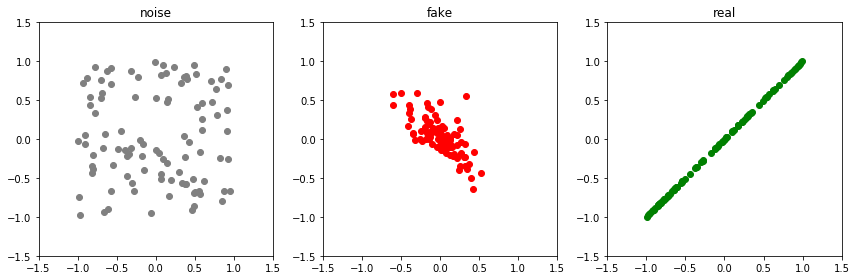

Epoch: 15200 G-error: 1.922249436378479 D-error: 0.4555201530456543


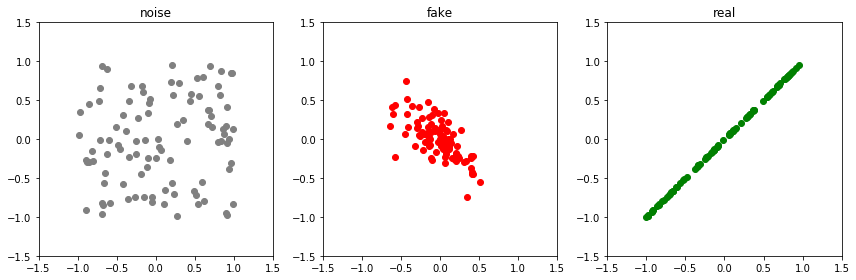

Epoch: 15250 G-error: 1.982432246208191 D-error: 0.42735370993614197


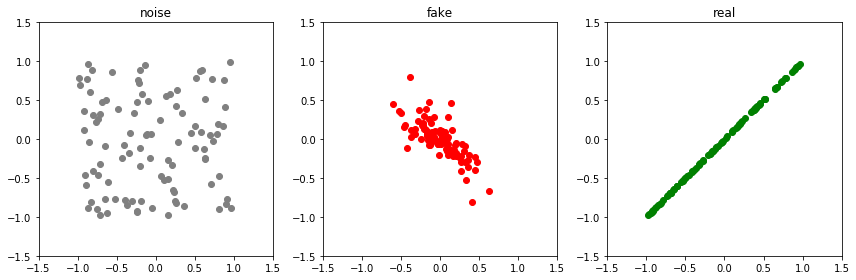

Epoch: 15300 G-error: 2.152883291244507 D-error: 0.375604510307312


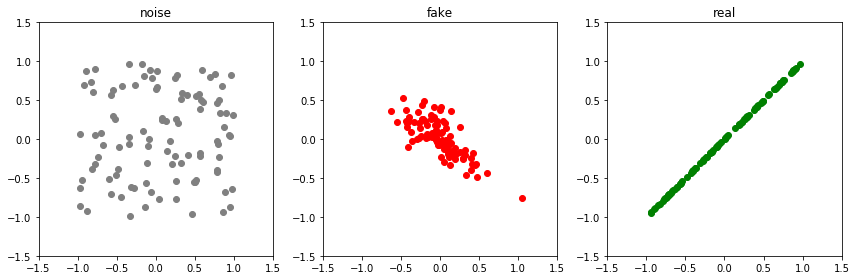

Epoch: 15350 G-error: 2.0447020530700684 D-error: 0.3340664803981781


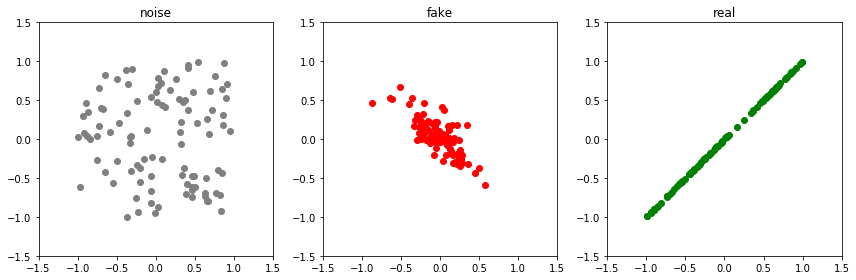

Epoch: 15400 G-error: 2.0803534984588623 D-error: 0.3602222800254822


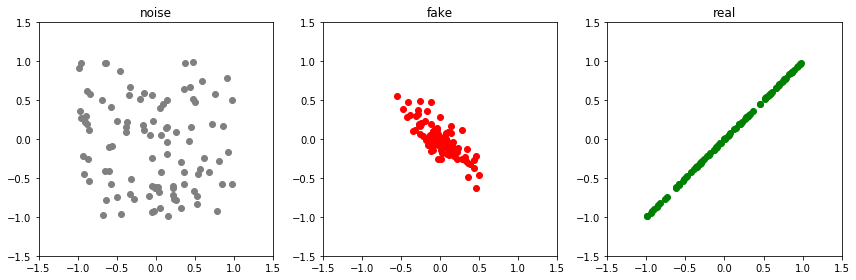

Epoch: 15450 G-error: 2.045311212539673 D-error: 0.39642858505249023


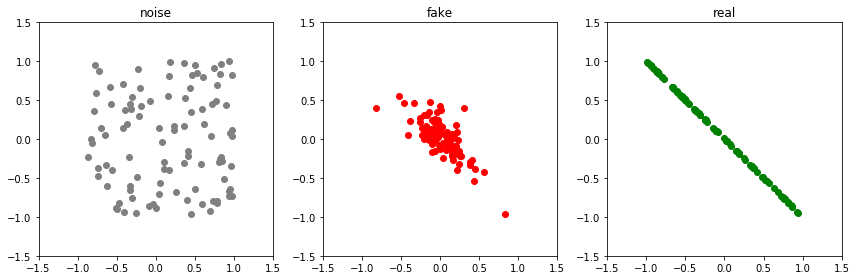

Epoch: 15500 G-error: 2.2778797149658203 D-error: 1.8653991222381592


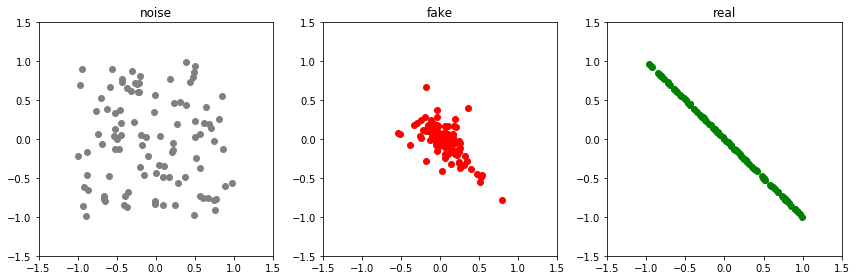

Epoch: 15550 G-error: 1.3368934392929077 D-error: 1.0288255214691162


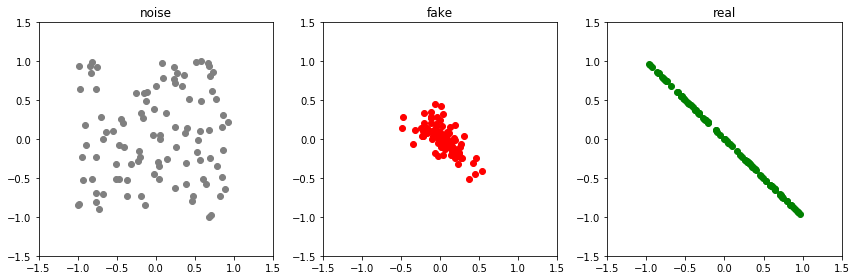

Epoch: 15600 G-error: 1.443528652191162 D-error: 0.8085470199584961


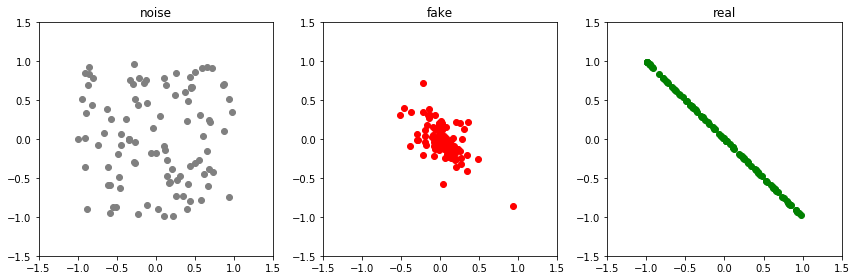

Epoch: 15650 G-error: 1.377991795539856 D-error: 0.7962254285812378


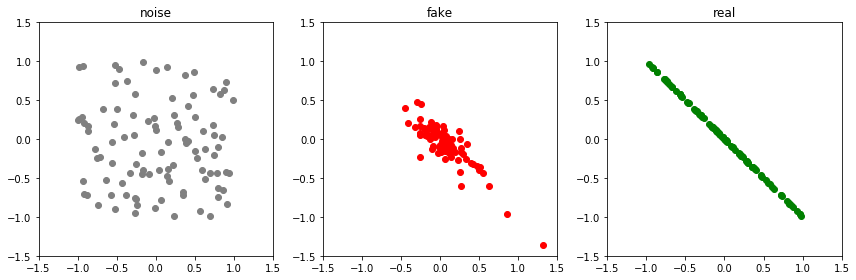

Epoch: 15700 G-error: 1.4234317541122437 D-error: 0.9646359086036682


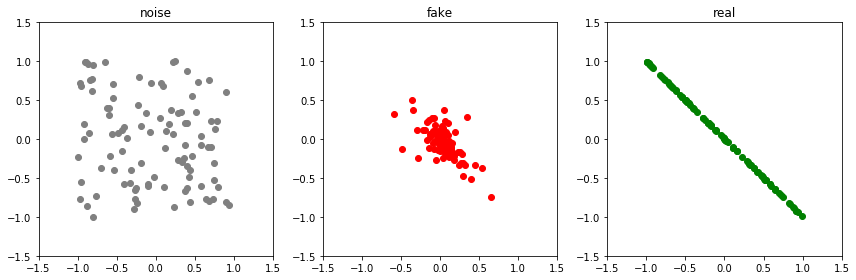

Epoch: 15750 G-error: 1.4200855493545532 D-error: 0.756544828414917


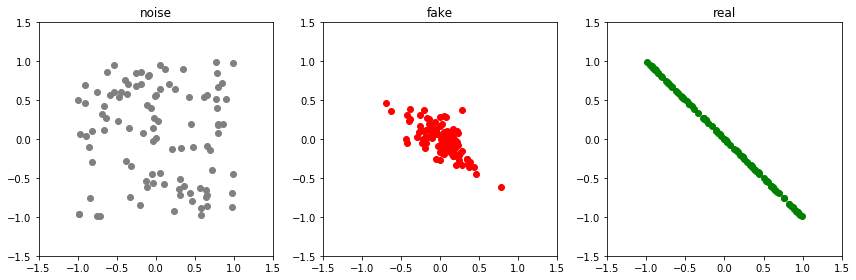

Epoch: 15800 G-error: 1.525072455406189 D-error: 0.7684305310249329


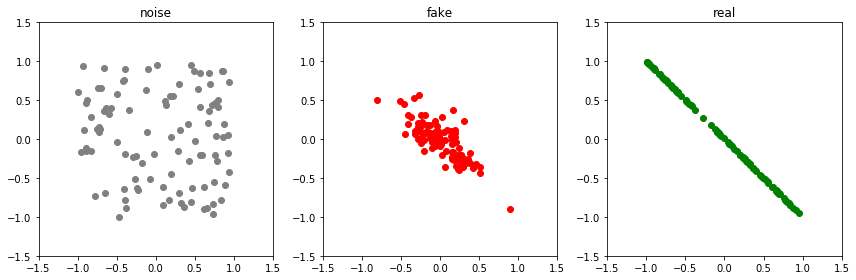

Epoch: 15850 G-error: 1.3997639417648315 D-error: 0.8069833517074585


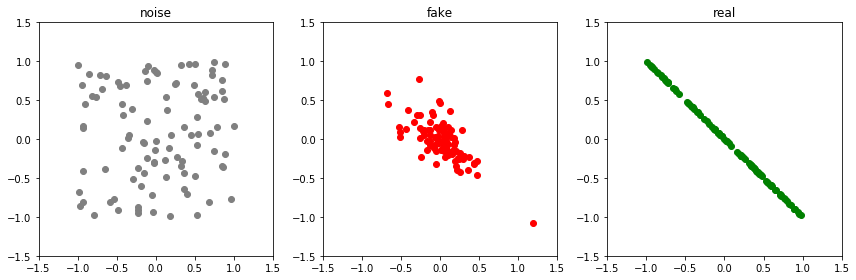

Epoch: 15900 G-error: 1.5353941917419434 D-error: 0.8273717164993286


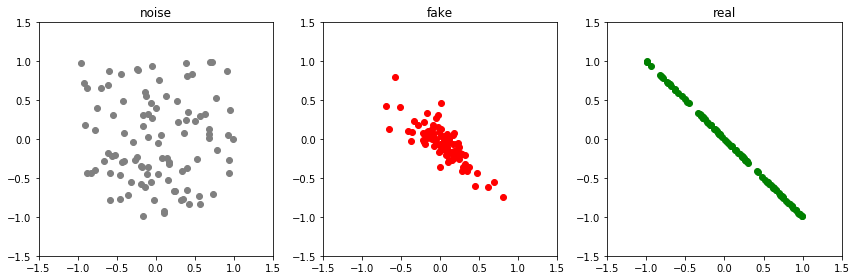

Epoch: 15950 G-error: 1.477543830871582 D-error: 0.8583197593688965


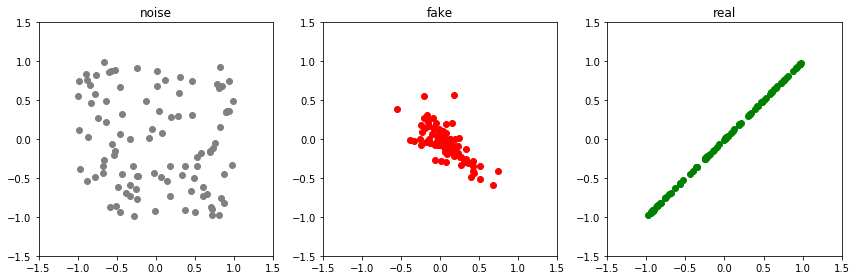

Epoch: 16000 G-error: 1.5668983459472656 D-error: 0.7522332668304443


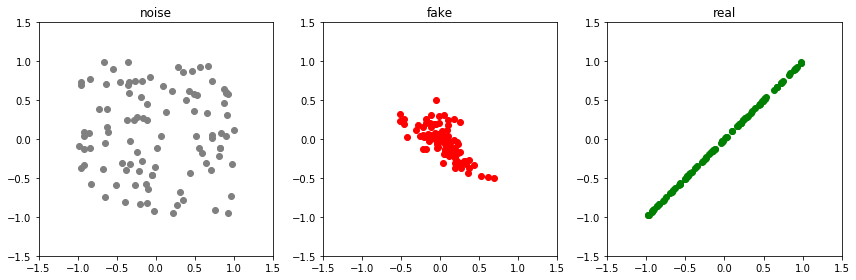

Epoch: 16050 G-error: 1.7483069896697998 D-error: 0.4888506233692169


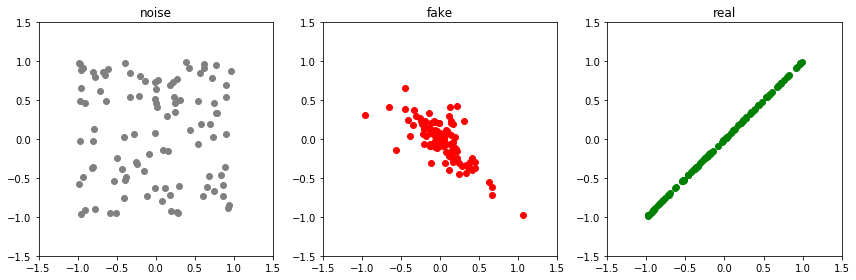

Epoch: 16100 G-error: 1.9179966449737549 D-error: 0.5252383351325989


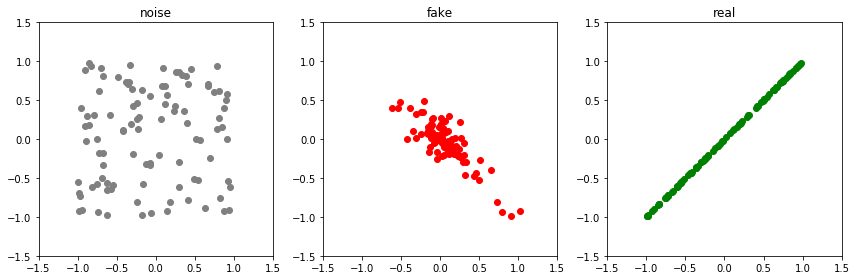

Epoch: 16150 G-error: 2.0087990760803223 D-error: 0.3775638937950134


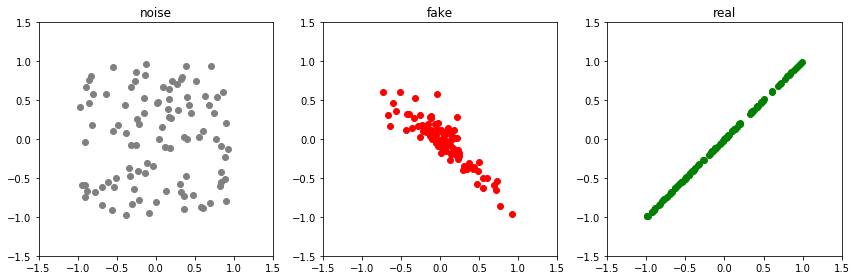

Epoch: 16200 G-error: 2.0400097370147705 D-error: 0.45940494537353516


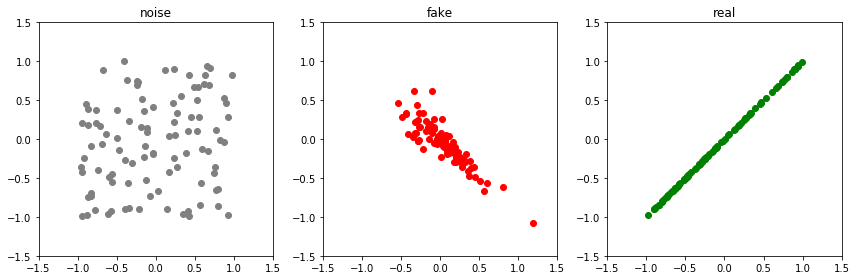

Epoch: 16250 G-error: 2.126676082611084 D-error: 0.33163130283355713


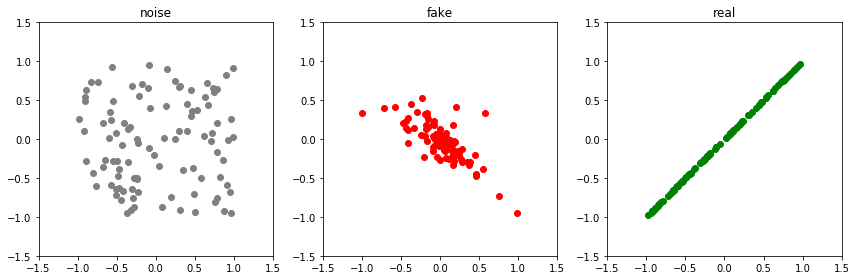

Epoch: 16300 G-error: 2.2400527000427246 D-error: 0.36769765615463257


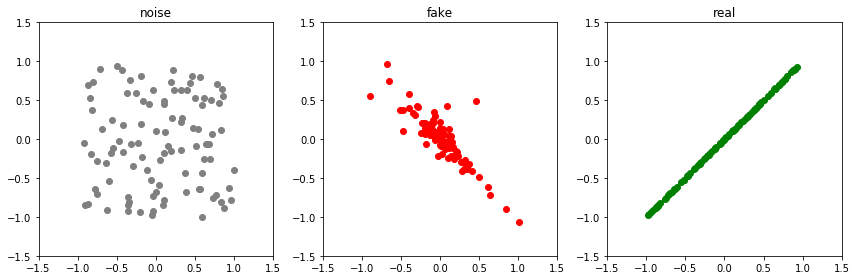

Epoch: 16350 G-error: 2.2186851501464844 D-error: 0.4180091619491577


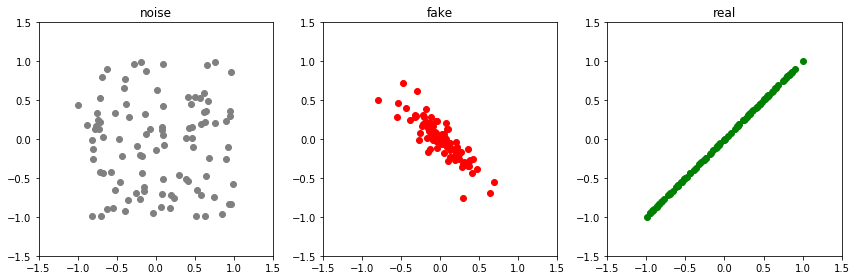

Epoch: 16400 G-error: 2.3452234268188477 D-error: 0.34444719552993774


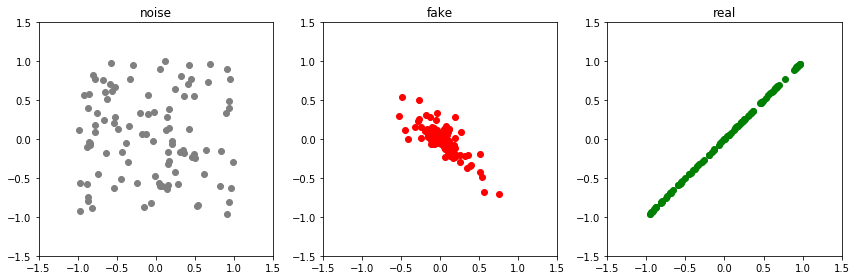

Epoch: 16450 G-error: 2.356562852859497 D-error: 0.3507842421531677


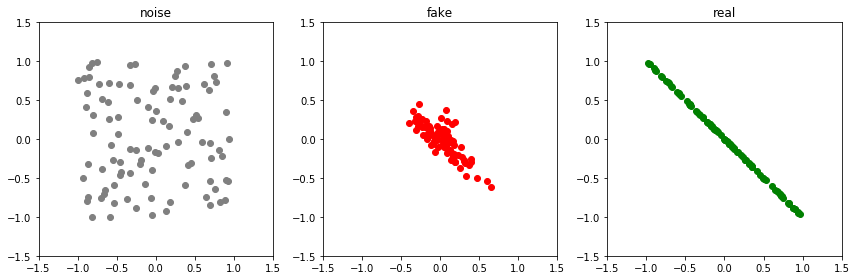

Epoch: 16500 G-error: 2.358339309692383 D-error: 2.3637335300445557


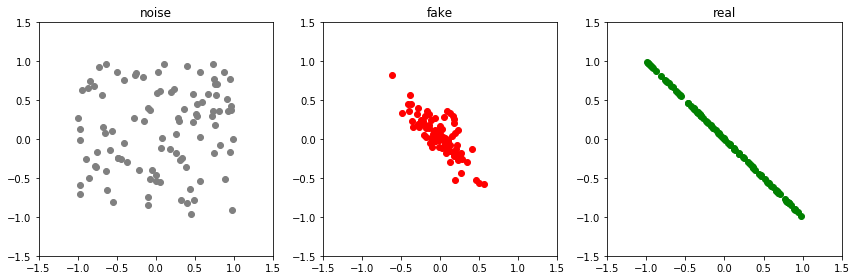

Epoch: 16550 G-error: 1.2164369821548462 D-error: 1.0164703130722046


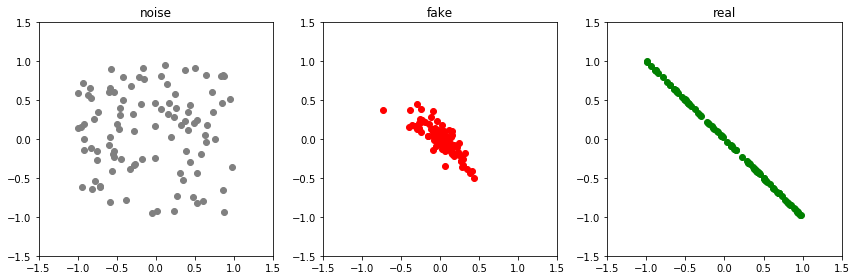

Epoch: 16600 G-error: 1.3406686782836914 D-error: 0.7934165000915527


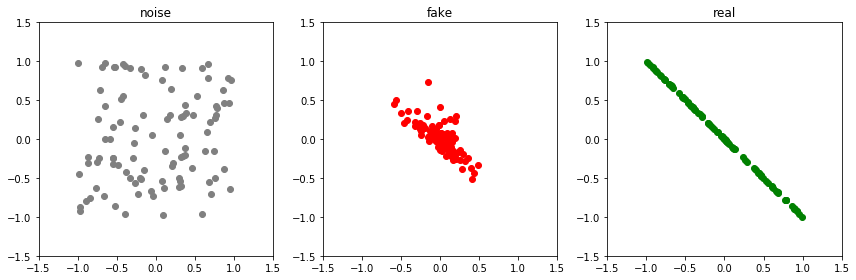

Epoch: 16650 G-error: 1.3908333778381348 D-error: 0.8175155520439148


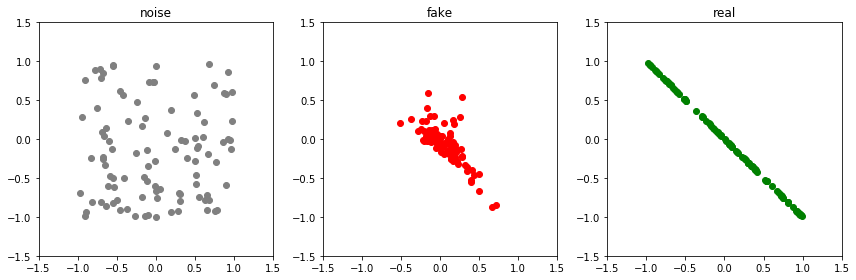

Epoch: 16700 G-error: 1.2900253534317017 D-error: 0.8933899402618408


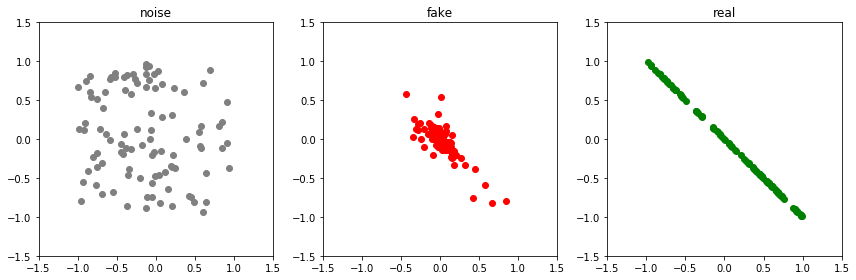

Epoch: 16750 G-error: 1.5075173377990723 D-error: 0.7419079542160034


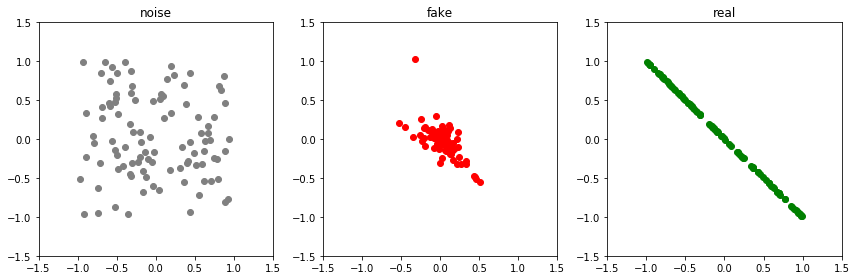

Epoch: 16800 G-error: 1.4608279466629028 D-error: 0.6787571907043457


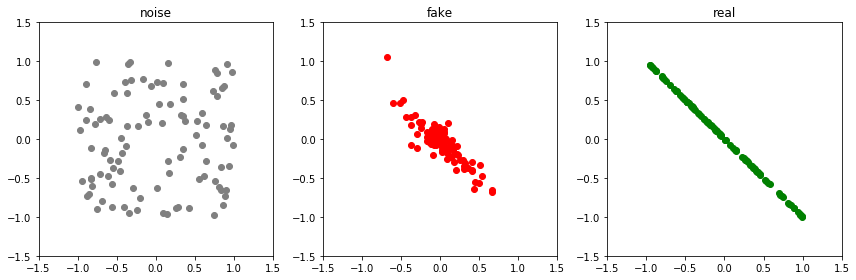

Epoch: 16850 G-error: 1.561019778251648 D-error: 0.9440411329269409


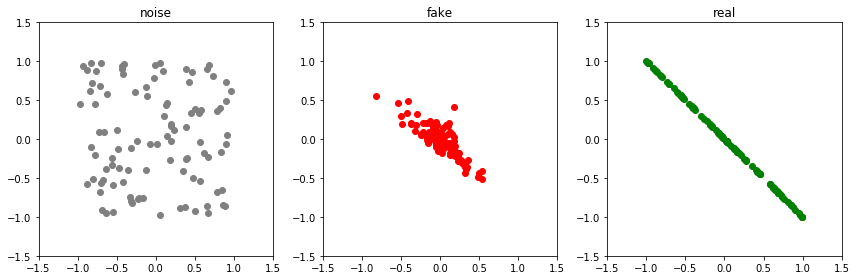

Epoch: 16900 G-error: 1.4316024780273438 D-error: 0.8605353832244873


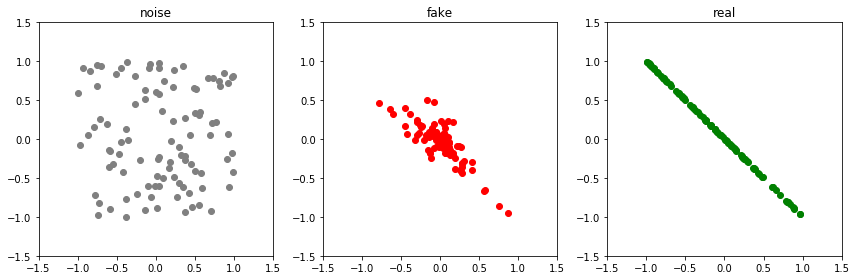

Epoch: 16950 G-error: 1.3801156282424927 D-error: 0.8913149833679199


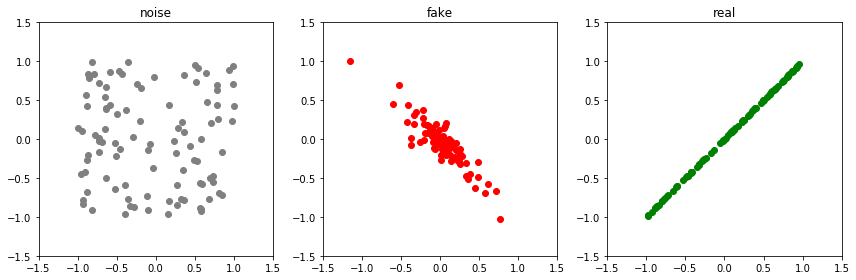

Epoch: 17000 G-error: 1.5072698593139648 D-error: 0.6180894374847412


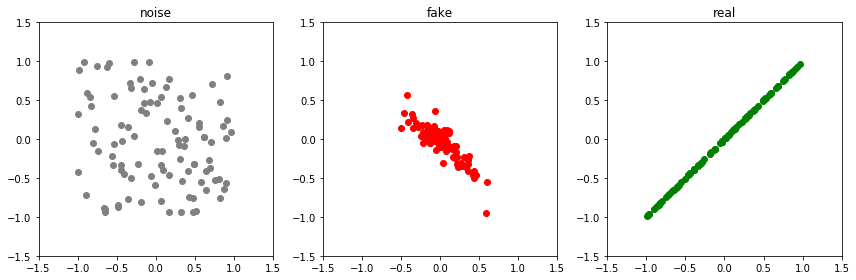

Epoch: 17050 G-error: 1.7510168552398682 D-error: 0.5143744945526123


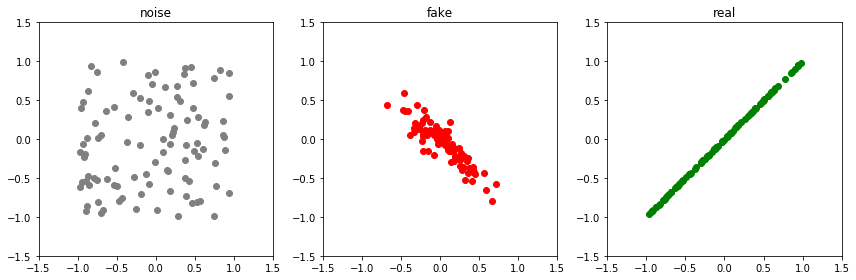

Epoch: 17100 G-error: 1.8977596759796143 D-error: 0.45121341943740845


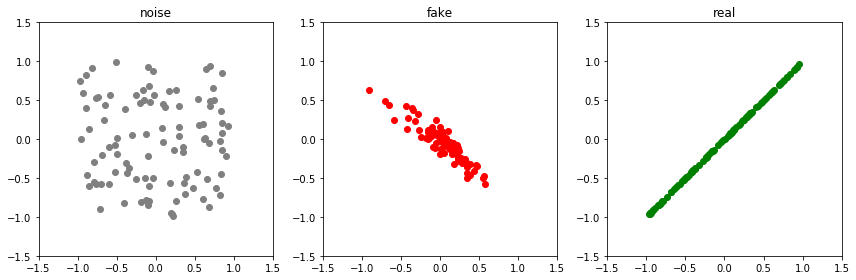

Epoch: 17150 G-error: 2.0946199893951416 D-error: 0.4050857424736023


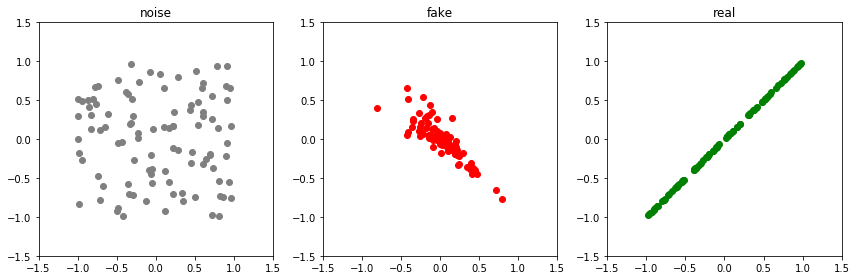

Epoch: 17200 G-error: 2.258784532546997 D-error: 0.3380405902862549


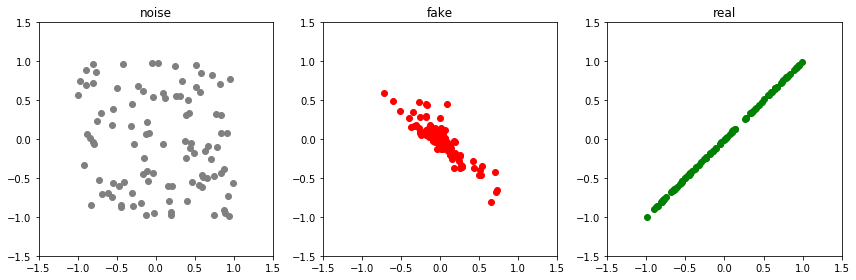

Epoch: 17250 G-error: 2.1438333988189697 D-error: 0.31862032413482666


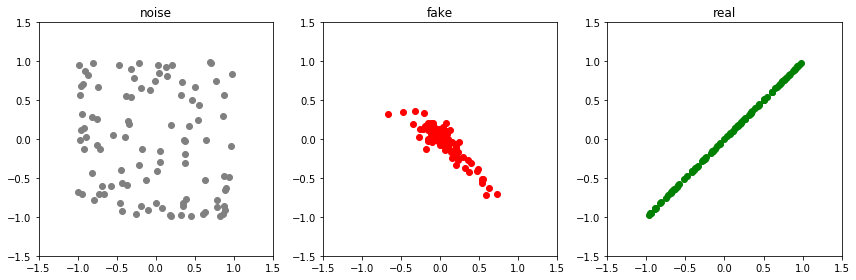

Epoch: 17300 G-error: 2.2940196990966797 D-error: 0.3028268814086914


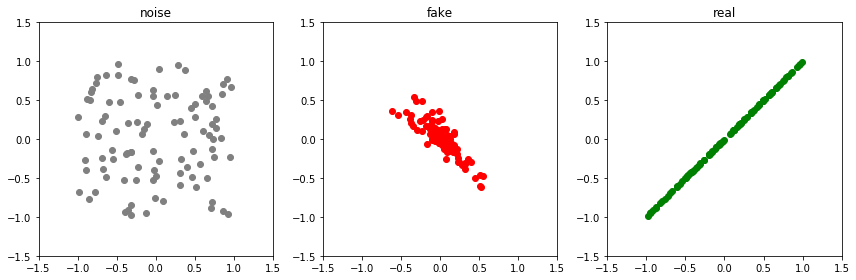

Epoch: 17350 G-error: 2.3077259063720703 D-error: 0.29419252276420593


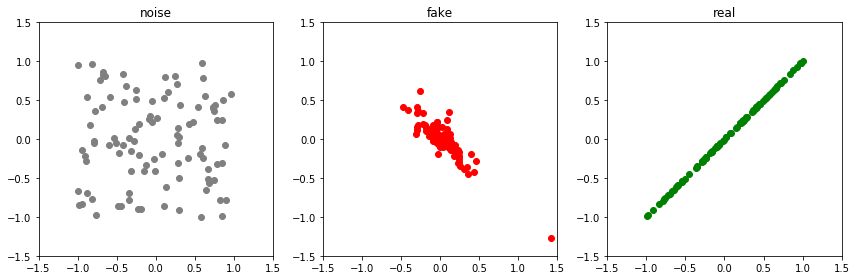

Epoch: 17400 G-error: 2.4848451614379883 D-error: 0.29710835218429565


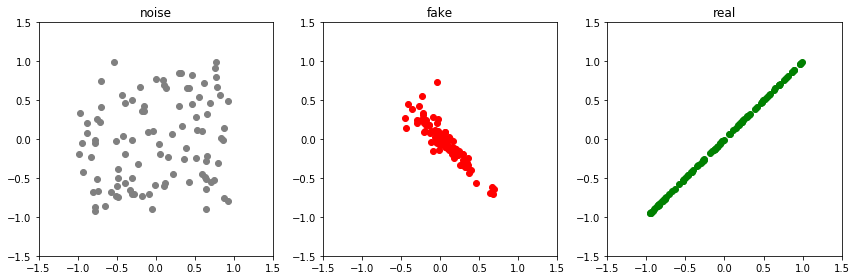

Epoch: 17450 G-error: 2.4142565727233887 D-error: 0.2754504084587097


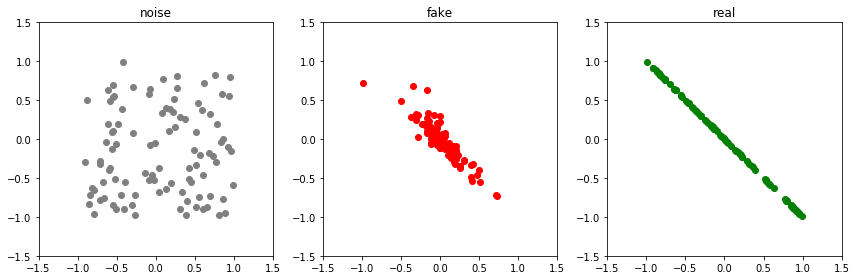

Epoch: 17500 G-error: 2.4617371559143066 D-error: 2.489748001098633


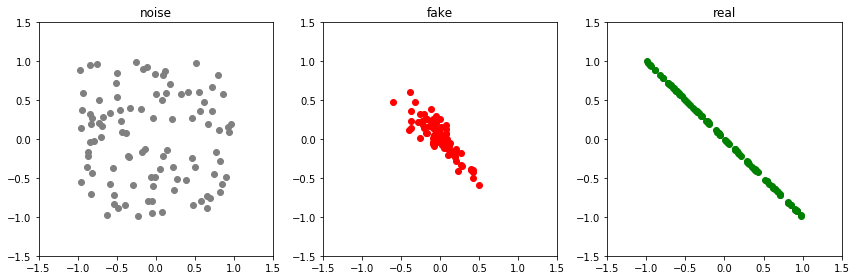

Epoch: 17550 G-error: 1.2345021963119507 D-error: 0.9509629011154175


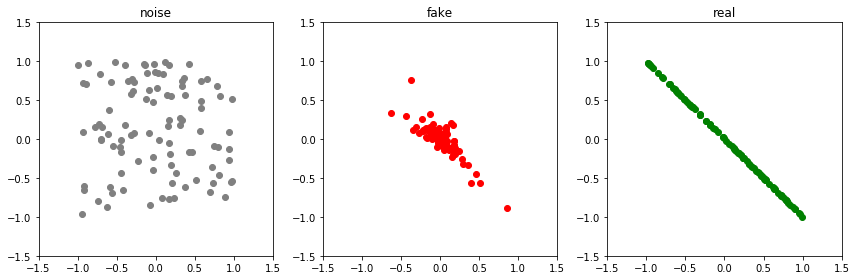

Epoch: 17600 G-error: 1.3127723932266235 D-error: 0.8620291948318481


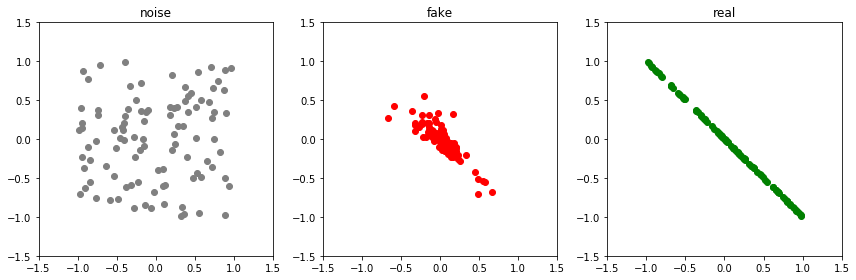

Epoch: 17650 G-error: 1.3662599325180054 D-error: 0.8765676021575928


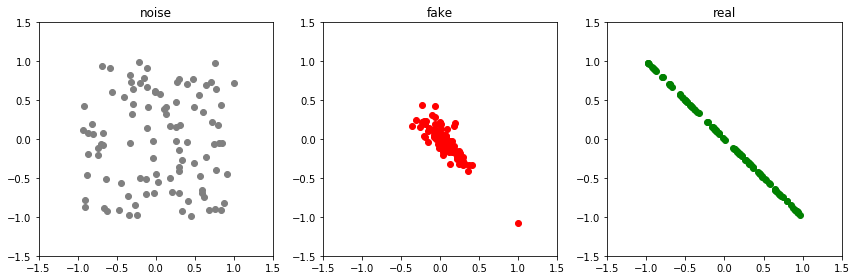

Epoch: 17700 G-error: 1.514981746673584 D-error: 0.7584962844848633


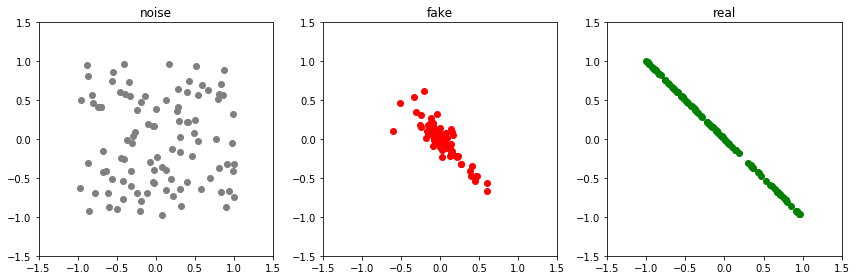

Epoch: 17750 G-error: 1.5127427577972412 D-error: 0.8041152358055115


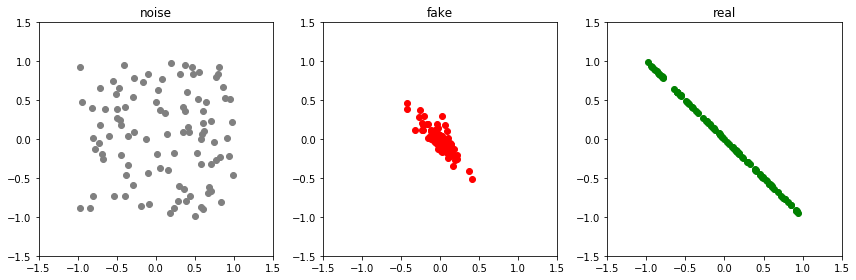

Epoch: 17800 G-error: 1.609810471534729 D-error: 0.9044773578643799


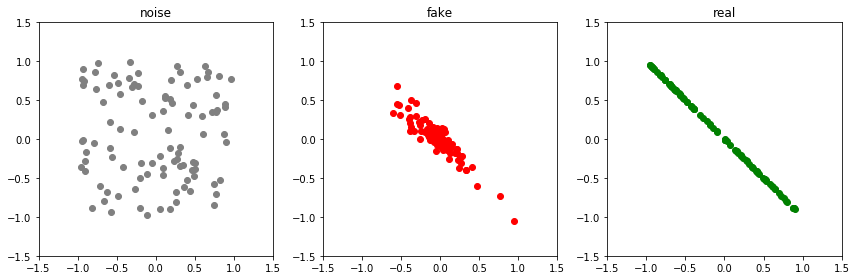

Epoch: 17850 G-error: 1.4831422567367554 D-error: 0.7541816234588623


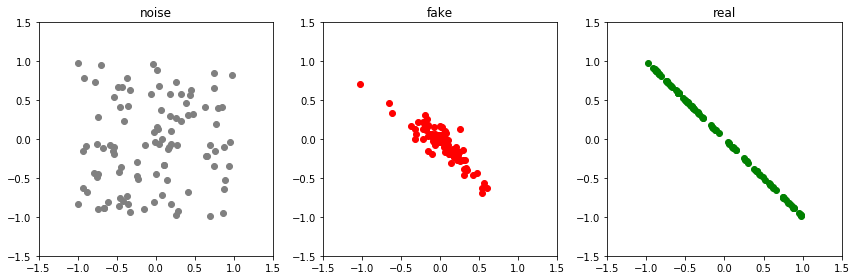

Epoch: 17900 G-error: 1.473440408706665 D-error: 0.7462586164474487


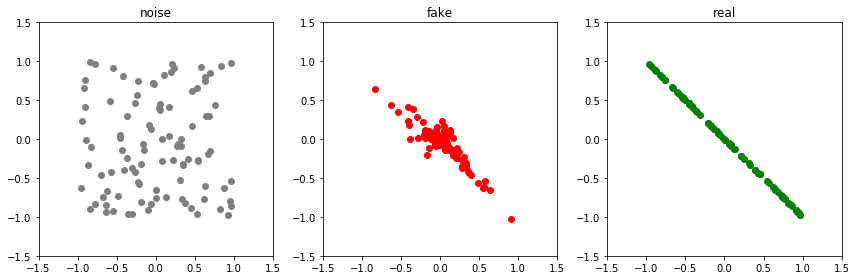

Epoch: 17950 G-error: 1.4749354124069214 D-error: 0.9186238050460815


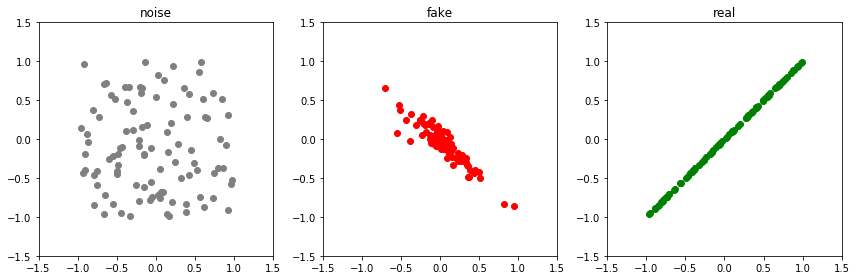

Epoch: 18000 G-error: 1.4707096815109253 D-error: 0.6065577268600464


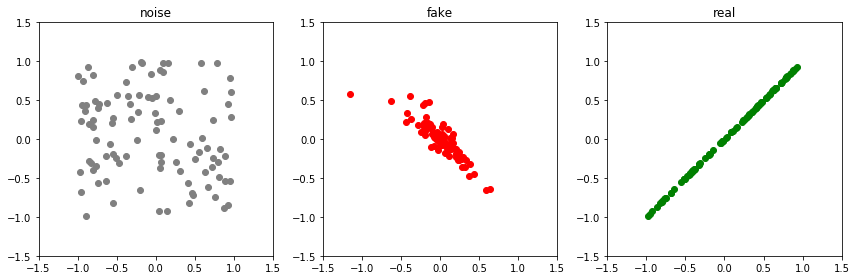

Epoch: 18050 G-error: 1.9791738986968994 D-error: 0.39347127079963684


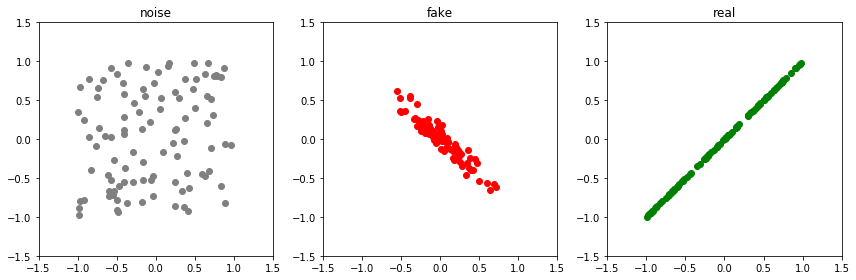

Epoch: 18100 G-error: 2.1057093143463135 D-error: 0.41586628556251526


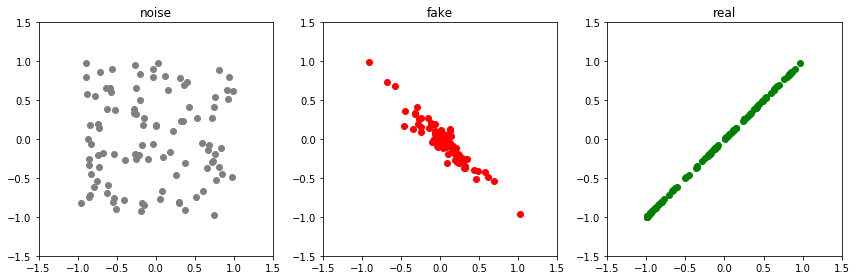

Epoch: 18150 G-error: 2.1255381107330322 D-error: 0.3866845369338989


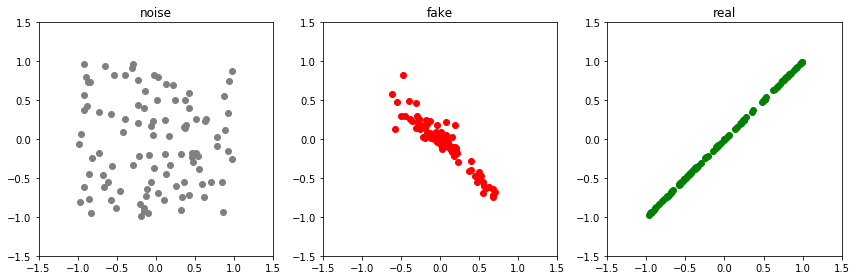

Epoch: 18200 G-error: 2.2699272632598877 D-error: 0.2928270697593689


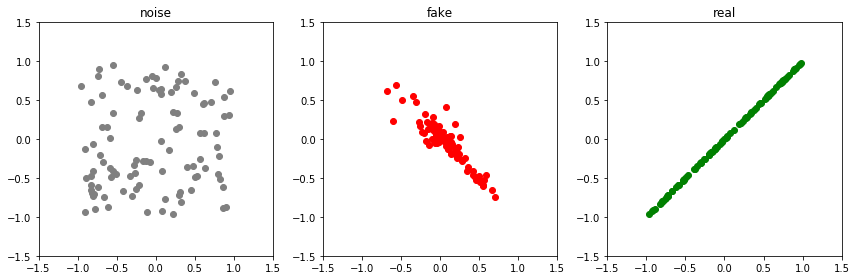

Epoch: 18250 G-error: 2.240656852722168 D-error: 0.3142297863960266


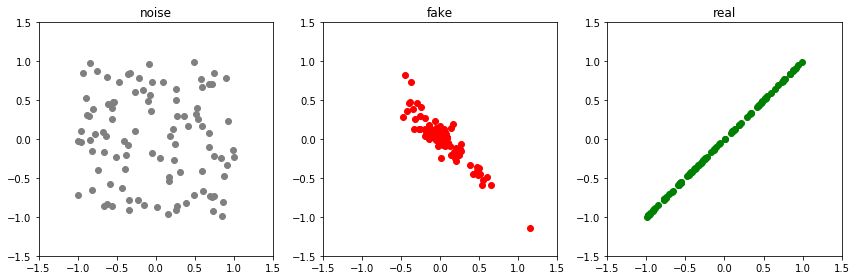

Epoch: 18300 G-error: 2.376922369003296 D-error: 0.2506985068321228


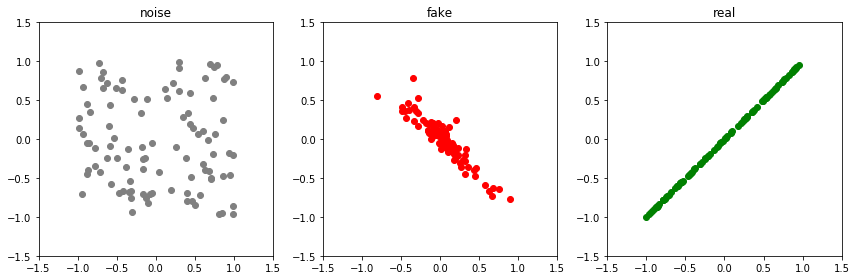

Epoch: 18350 G-error: 2.498832941055298 D-error: 0.2602824866771698


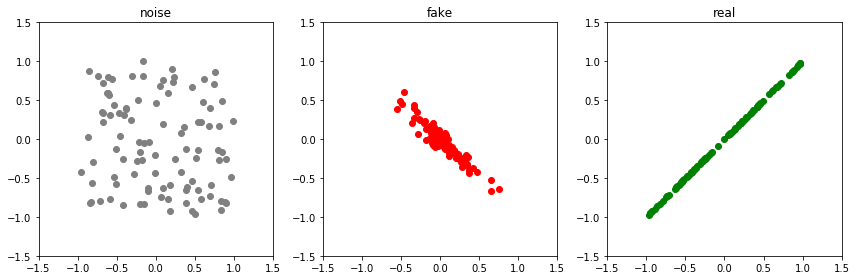

Epoch: 18400 G-error: 2.4741342067718506 D-error: 0.2517898976802826


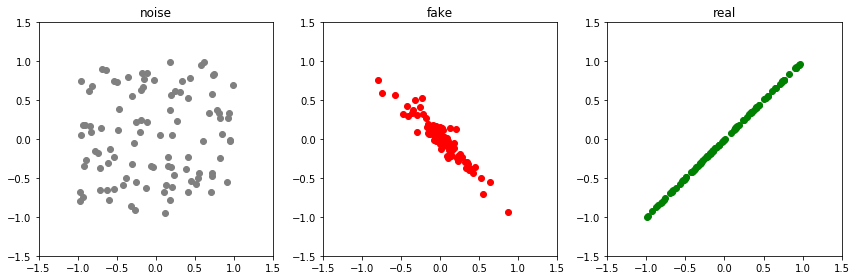

Epoch: 18450 G-error: 2.4623143672943115 D-error: 0.26535382866859436


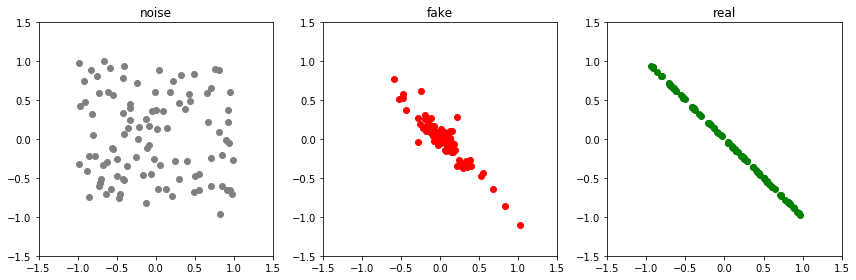

Epoch: 18500 G-error: 2.5769829750061035 D-error: 2.769303321838379


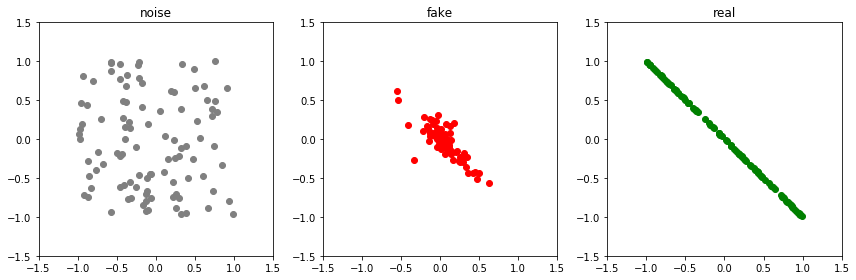

Epoch: 18550 G-error: 1.1923741102218628 D-error: 0.9869779944419861


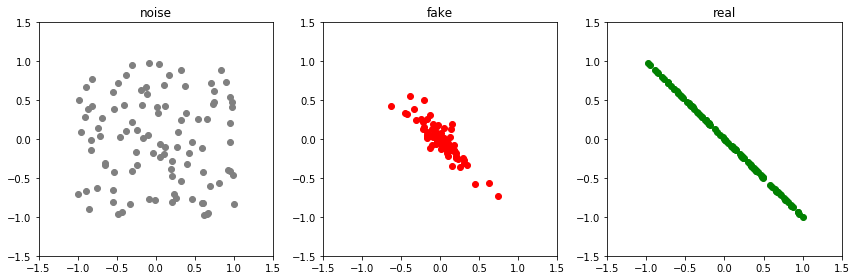

Epoch: 18600 G-error: 1.3316322565078735 D-error: 1.0112460851669312


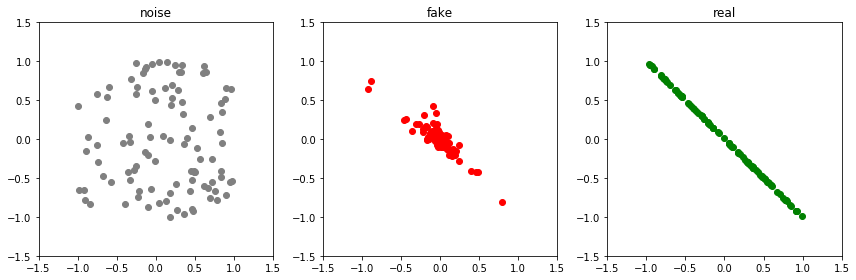

Epoch: 18650 G-error: 1.3796464204788208 D-error: 0.8322663307189941


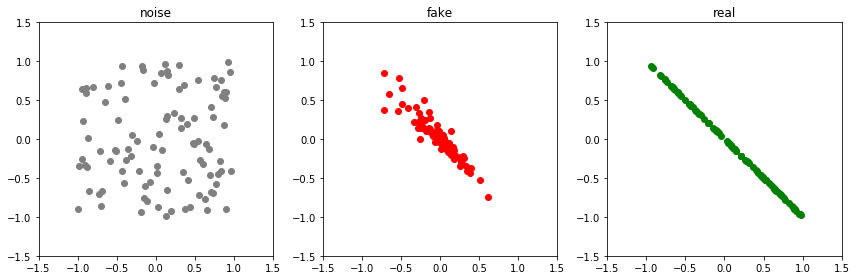

Epoch: 18700 G-error: 1.3711658716201782 D-error: 0.9079657196998596


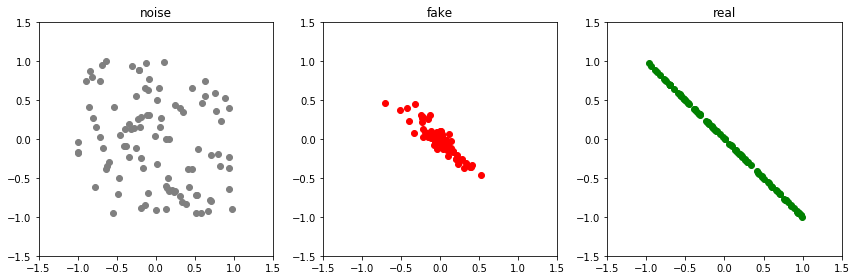

Epoch: 18750 G-error: 1.456358790397644 D-error: 0.7541217803955078


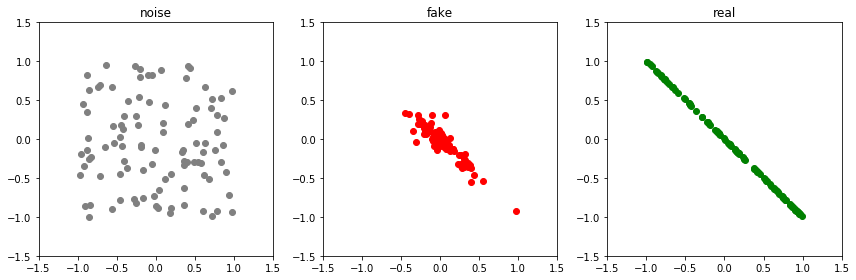

Epoch: 18800 G-error: 1.4125102758407593 D-error: 0.8114874958992004


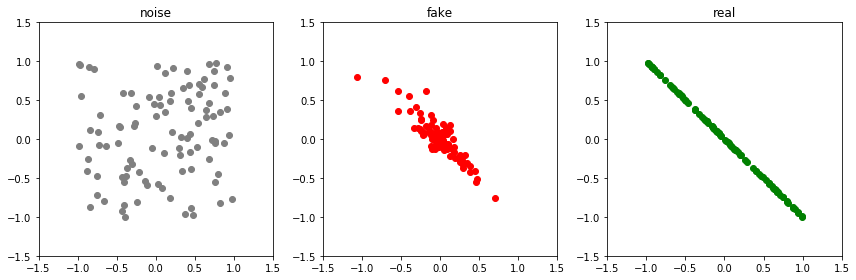

Epoch: 18850 G-error: 1.493588924407959 D-error: 0.9438185691833496


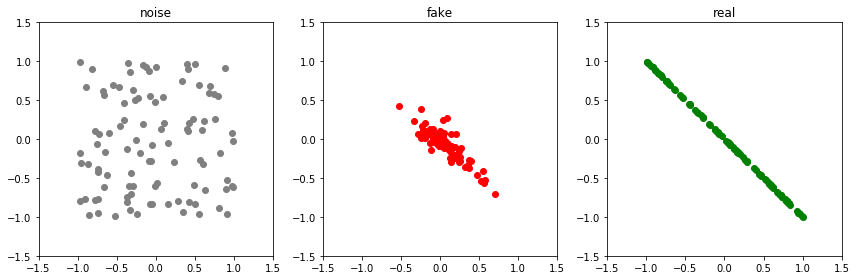

Epoch: 18900 G-error: 1.4322210550308228 D-error: 0.7836925983428955


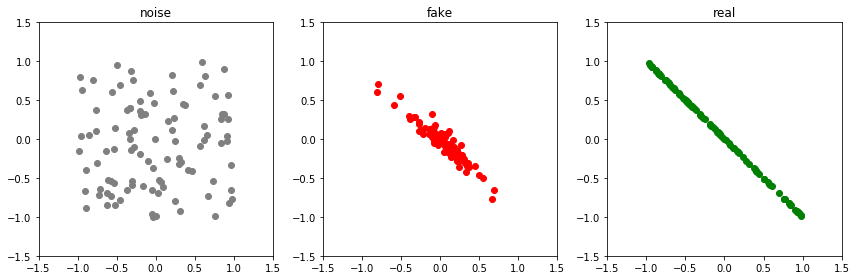

Epoch: 18950 G-error: 1.4219170808792114 D-error: 0.8461260795593262


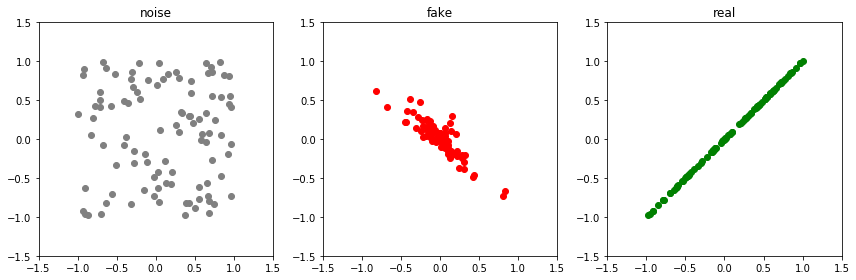

Epoch: 19000 G-error: 1.5632327795028687 D-error: 0.6504373550415039


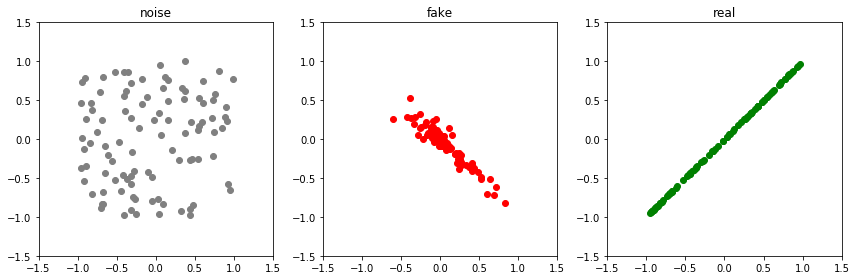

Epoch: 19050 G-error: 1.950369119644165 D-error: 0.3445238471031189


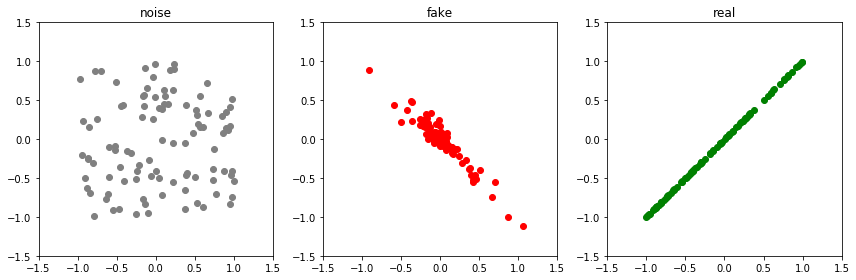

Epoch: 19100 G-error: 2.199153184890747 D-error: 0.37914034724235535


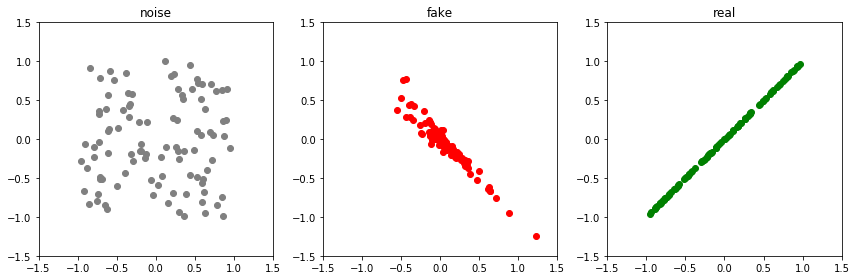

Epoch: 19150 G-error: 2.2487070560455322 D-error: 0.31718334555625916


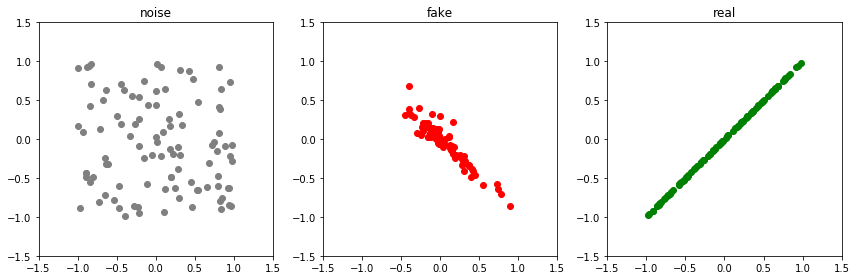

Epoch: 19200 G-error: 2.3498854637145996 D-error: 0.2892126142978668


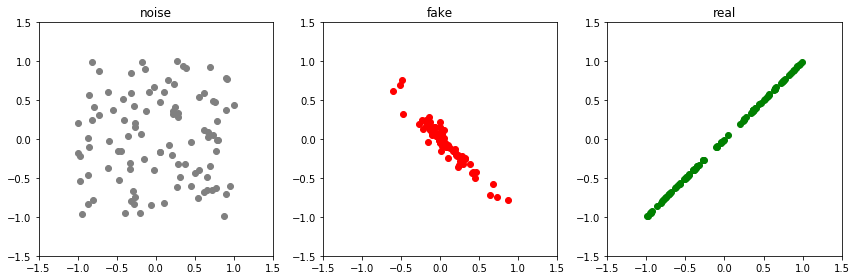

Epoch: 19250 G-error: 2.3687472343444824 D-error: 0.20531047880649567


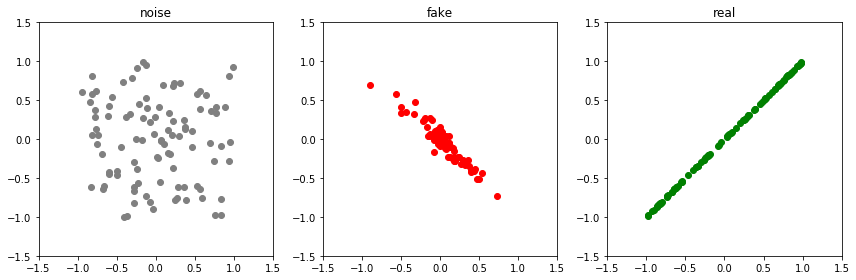

Epoch: 19300 G-error: 2.4314963817596436 D-error: 0.22883936762809753


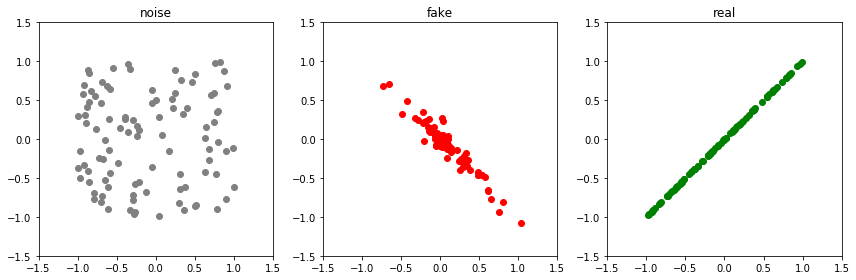

Epoch: 19350 G-error: 2.415583610534668 D-error: 0.2732579708099365


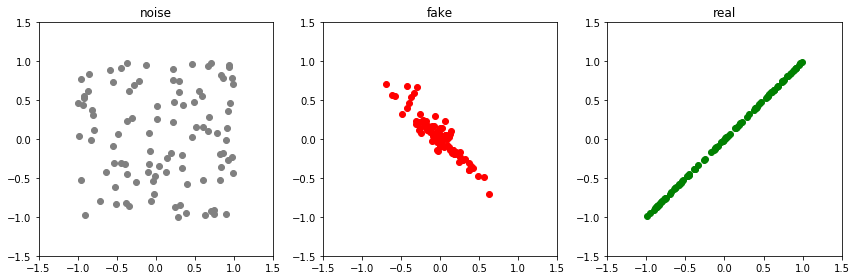

Epoch: 19400 G-error: 2.49005126953125 D-error: 0.26151594519615173


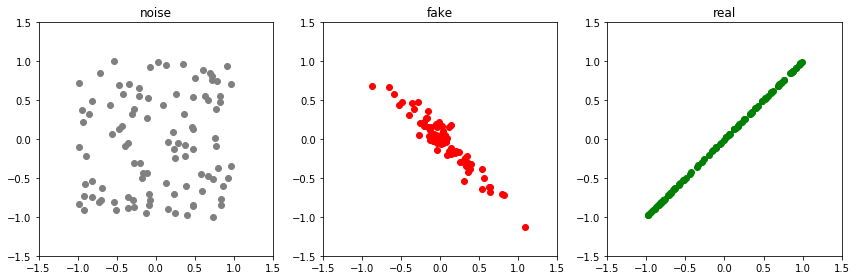

Epoch: 19450 G-error: 2.6238338947296143 D-error: 0.2612650990486145


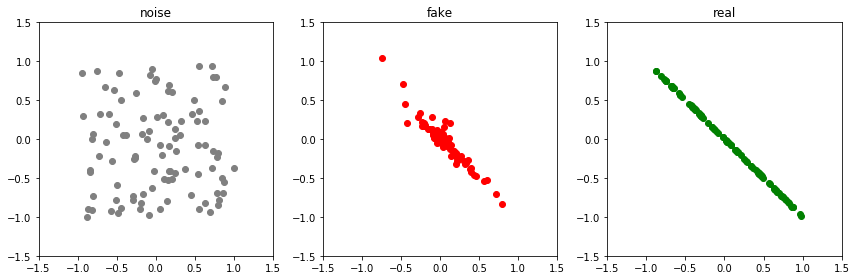

Epoch: 19500 G-error: 2.5749869346618652 D-error: 2.8759753704071045


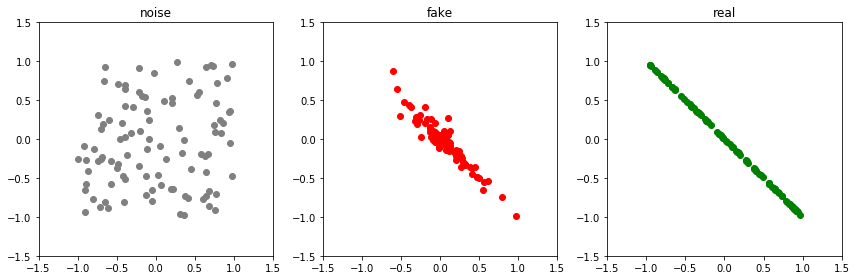

Epoch: 19550 G-error: 1.2041864395141602 D-error: 0.9923983812332153


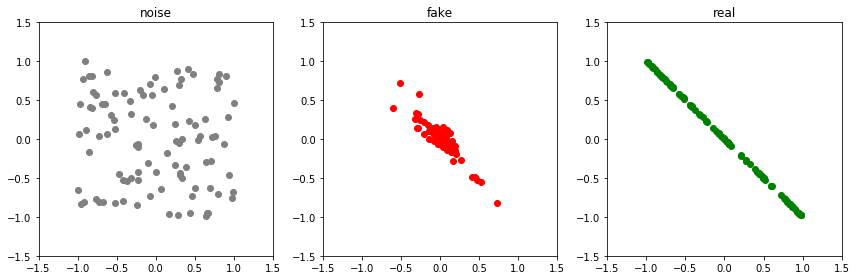

Epoch: 19600 G-error: 1.2918545007705688 D-error: 0.8831802606582642


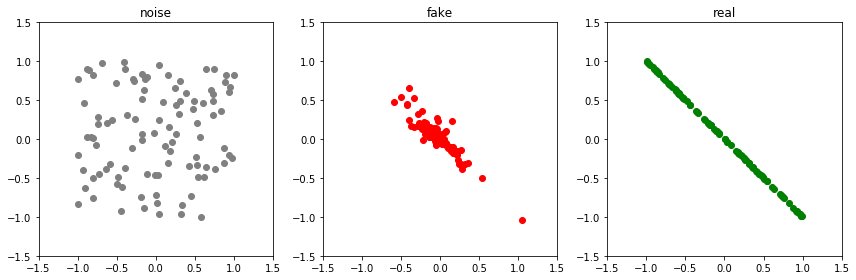

Epoch: 19650 G-error: 1.425624966621399 D-error: 0.839440643787384


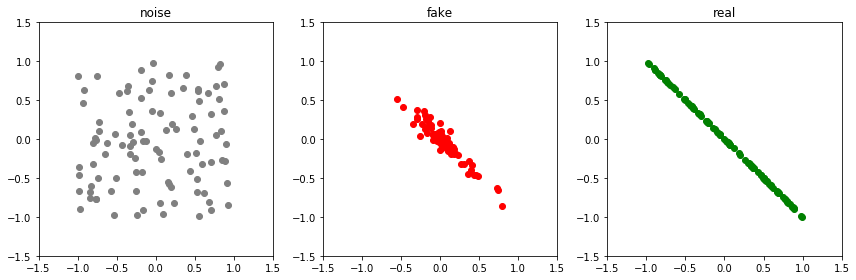

Epoch: 19700 G-error: 1.4364492893218994 D-error: 0.864507794380188


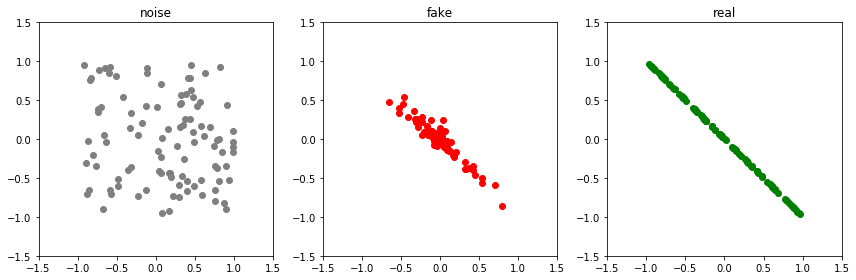

Epoch: 19750 G-error: 1.48992919921875 D-error: 0.8588983416557312


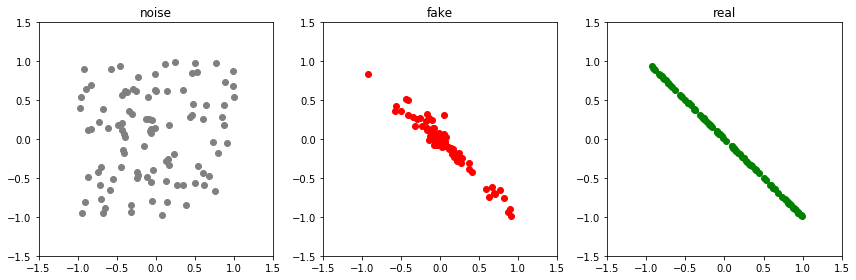

Epoch: 19800 G-error: 1.317774772644043 D-error: 0.9320722818374634


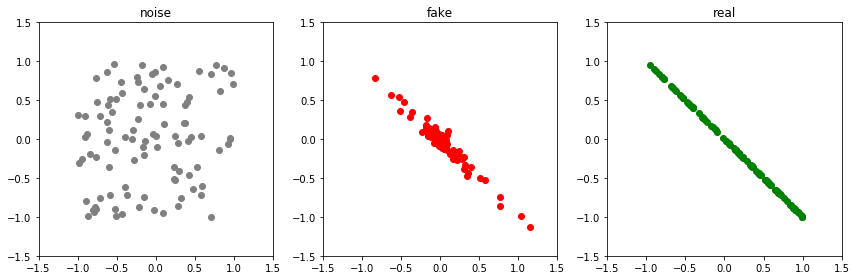

Epoch: 19850 G-error: 1.3894505500793457 D-error: 0.9177722930908203


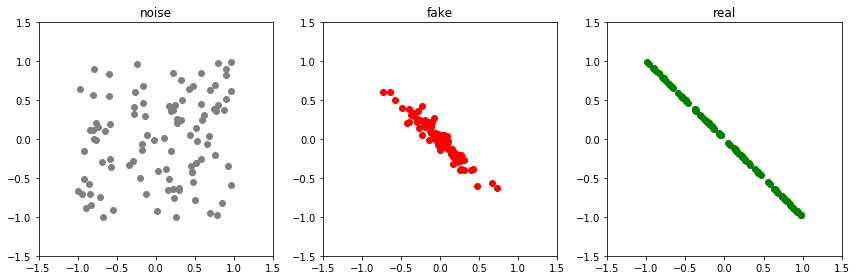

Epoch: 19900 G-error: 1.357237696647644 D-error: 0.8332465887069702


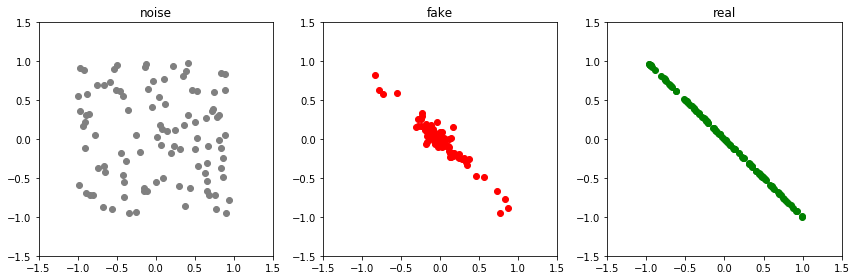

Epoch: 19950 G-error: 1.4168591499328613 D-error: 0.9373105764389038


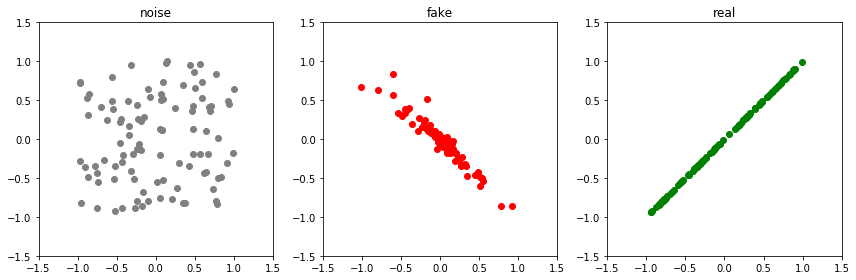

Epoch: 20000 G-error: 1.4281861782073975 D-error: 0.5201796889305115


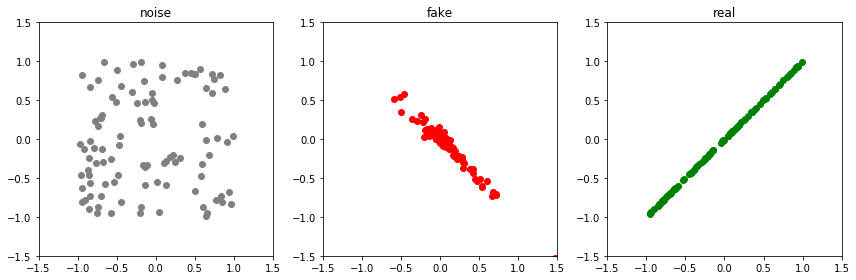

Epoch: 20050 G-error: 2.07918381690979 D-error: 0.41955792903900146


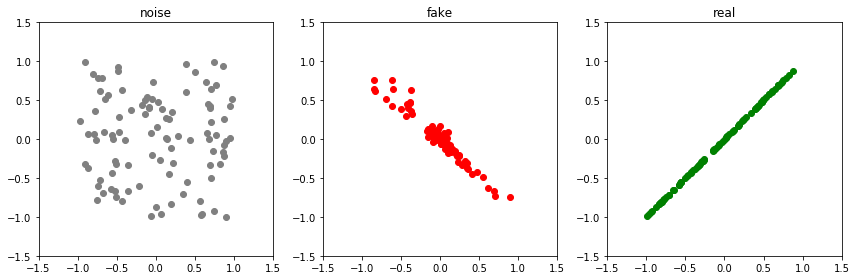

Epoch: 20100 G-error: 2.1600186824798584 D-error: 0.38470131158828735


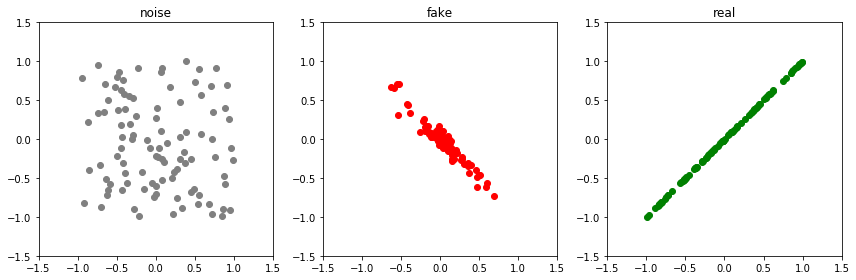

Epoch: 20150 G-error: 2.295381784439087 D-error: 0.3574088215827942


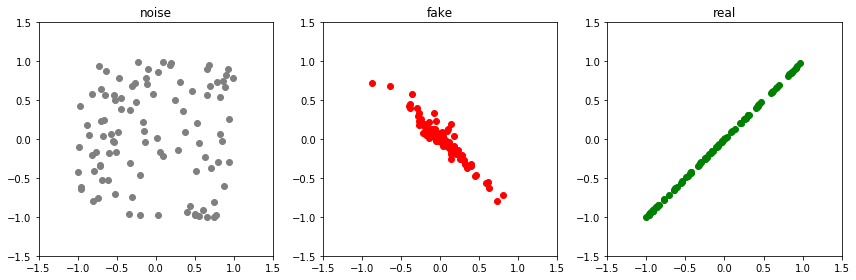

Epoch: 20200 G-error: 2.304506540298462 D-error: 0.3122667670249939


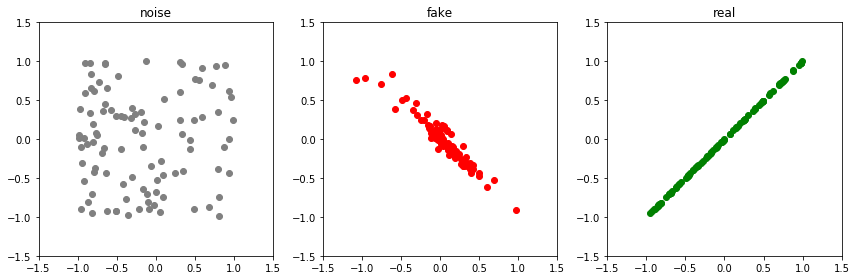

Epoch: 20250 G-error: 2.4351634979248047 D-error: 0.2478242814540863


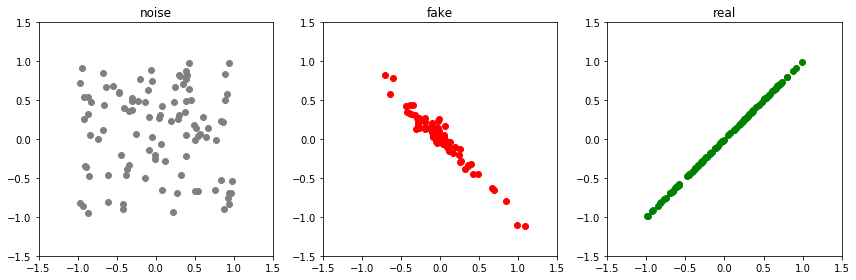

Epoch: 20300 G-error: 2.5315170288085938 D-error: 0.21867117285728455


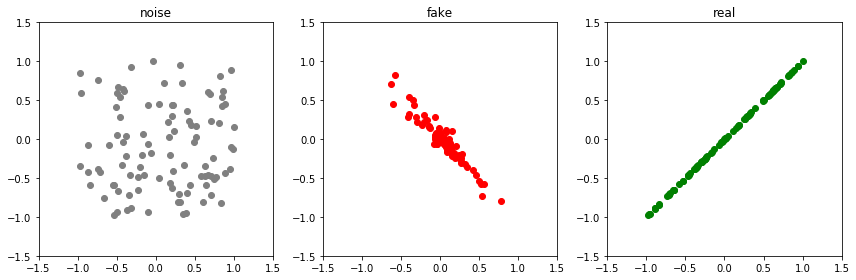

Epoch: 20350 G-error: 2.6010777950286865 D-error: 0.283469021320343


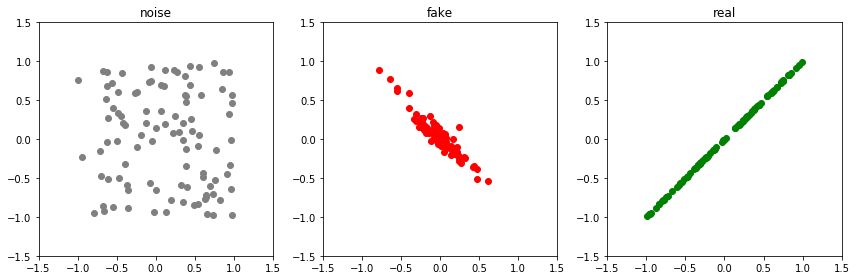

Epoch: 20400 G-error: 2.643601179122925 D-error: 0.2108231484889984


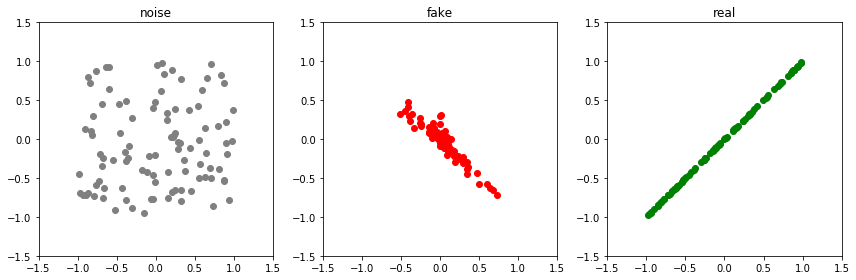

Epoch: 20450 G-error: 2.648879051208496 D-error: 0.23583339154720306


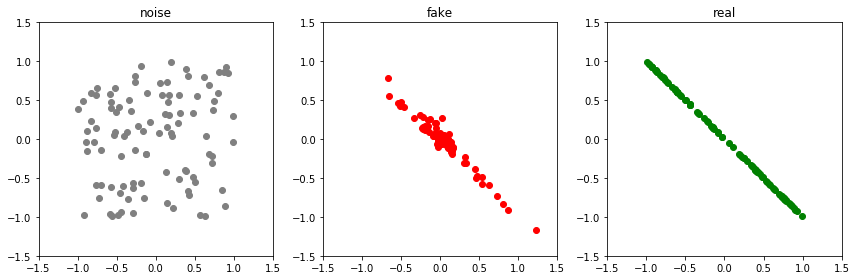

Epoch: 20500 G-error: 2.6099777221679688 D-error: 3.0247528553009033


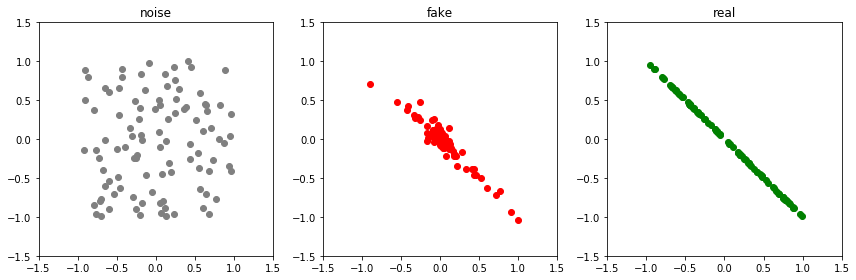

Epoch: 20550 G-error: 1.1899833679199219 D-error: 1.0037389993667603


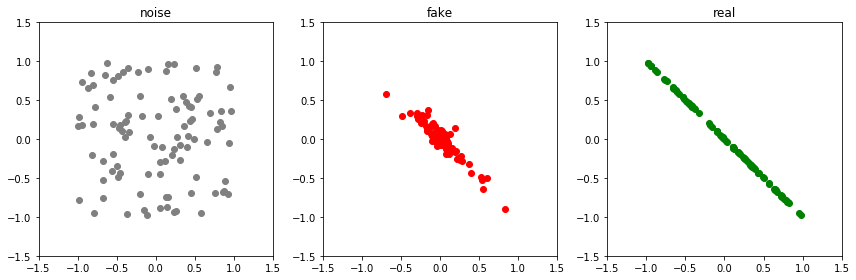

Epoch: 20600 G-error: 1.3368045091629028 D-error: 0.9780585765838623


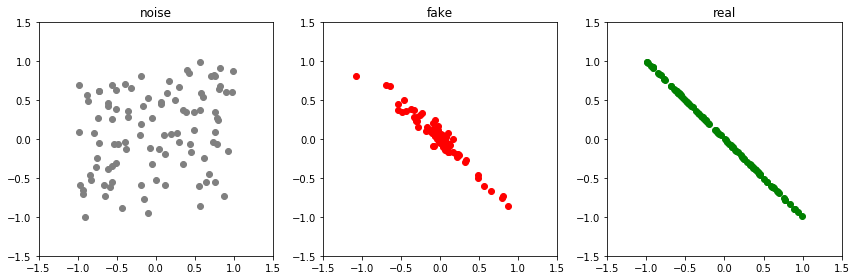

Epoch: 20650 G-error: 1.331514835357666 D-error: 1.0059809684753418


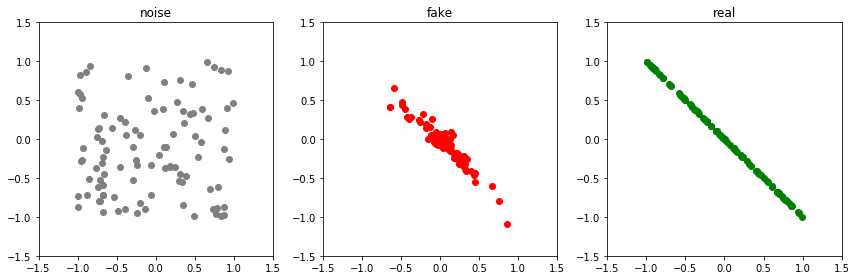

Epoch: 20700 G-error: 1.4786007404327393 D-error: 0.9373620748519897


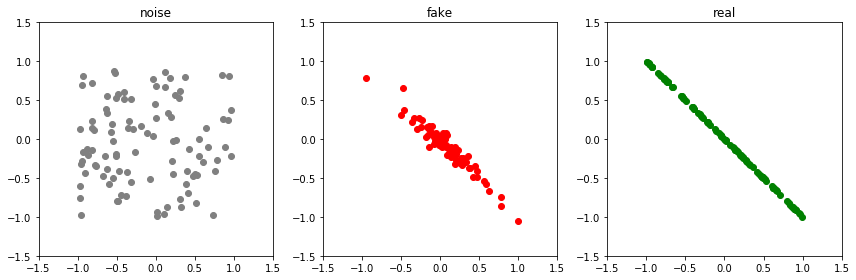

Epoch: 20750 G-error: 1.4831546545028687 D-error: 0.9485074281692505


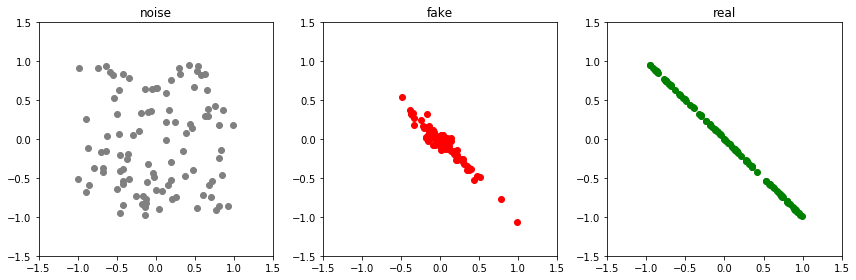

Epoch: 20800 G-error: 1.384445309638977 D-error: 0.8818321824073792


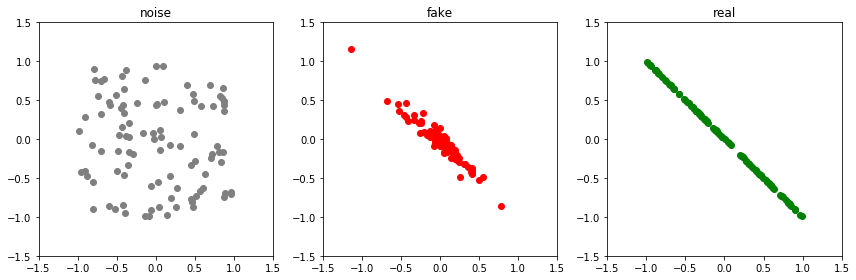

Epoch: 20850 G-error: 1.4272315502166748 D-error: 0.8539190292358398


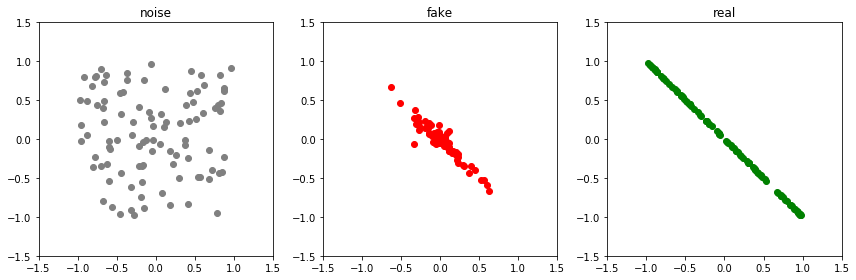

Epoch: 20900 G-error: 1.4770640134811401 D-error: 0.7869045734405518


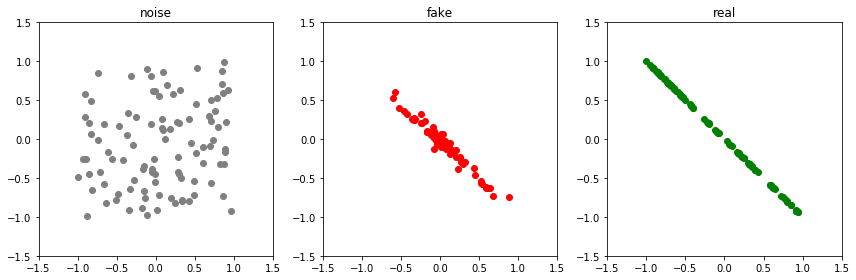

Epoch: 20950 G-error: 1.5274296998977661 D-error: 0.8209916353225708


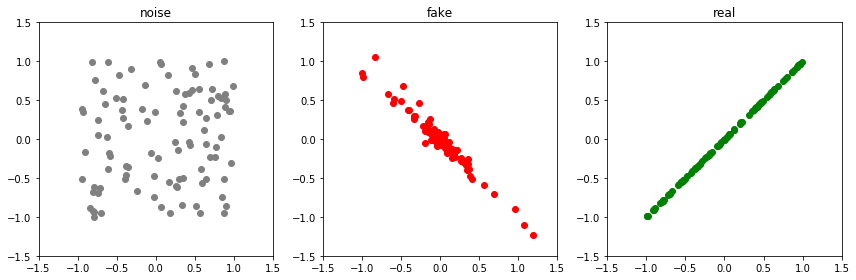

Epoch: 21000 G-error: 1.3381458520889282 D-error: 0.6378220319747925


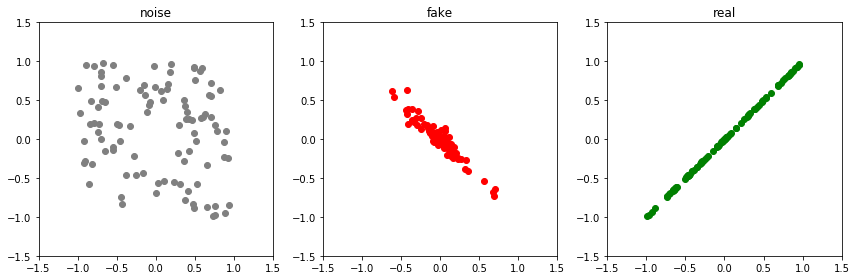

Epoch: 21050 G-error: 2.0947649478912354 D-error: 0.5063081383705139


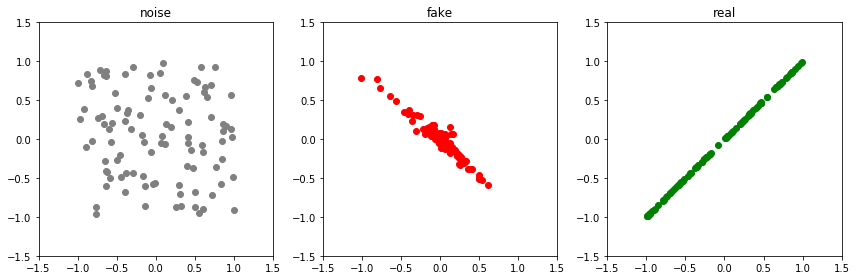

Epoch: 21100 G-error: 2.140266180038452 D-error: 0.2940649390220642


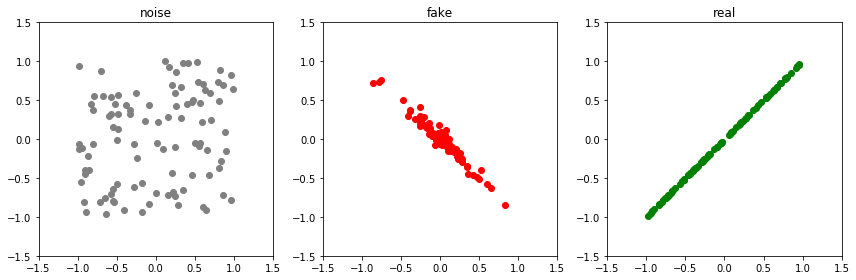

Epoch: 21150 G-error: 2.300511360168457 D-error: 0.28290483355522156


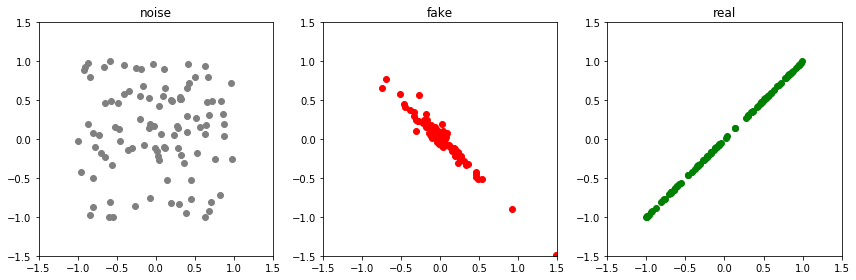

Epoch: 21200 G-error: 2.419771432876587 D-error: 0.24569031596183777


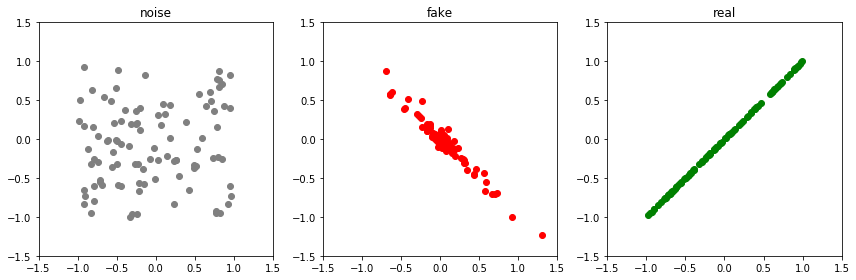

Epoch: 21250 G-error: 2.401137113571167 D-error: 0.2662307024002075


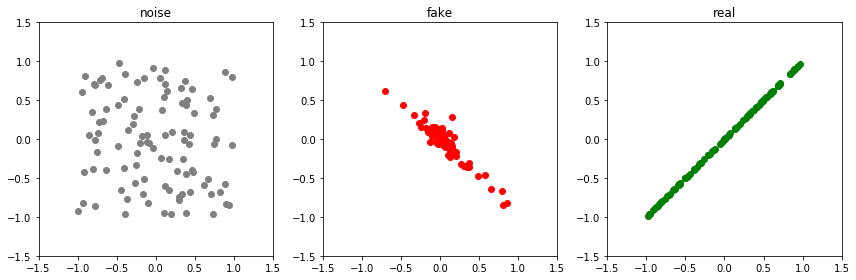

Epoch: 21300 G-error: 2.481227159500122 D-error: 0.27105358242988586


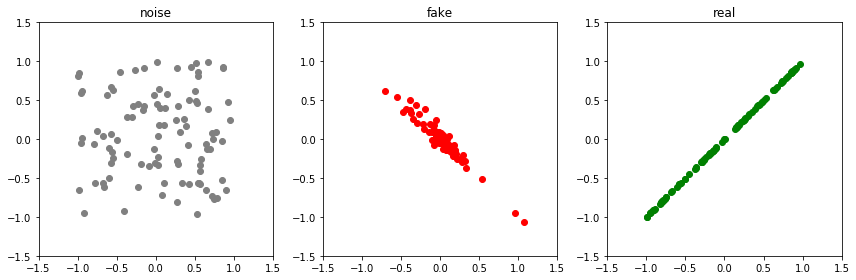

Epoch: 21350 G-error: 2.5905890464782715 D-error: 0.18873560428619385


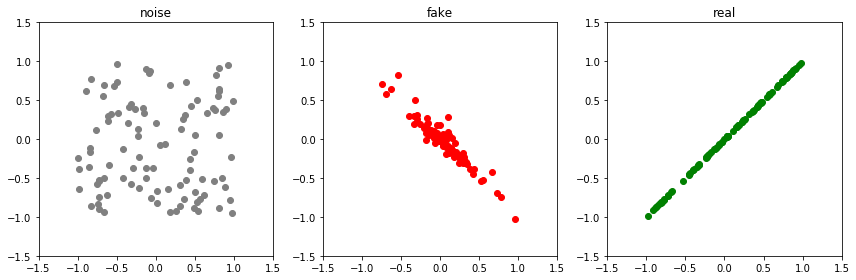

Epoch: 21400 G-error: 2.7734193801879883 D-error: 0.29157233238220215


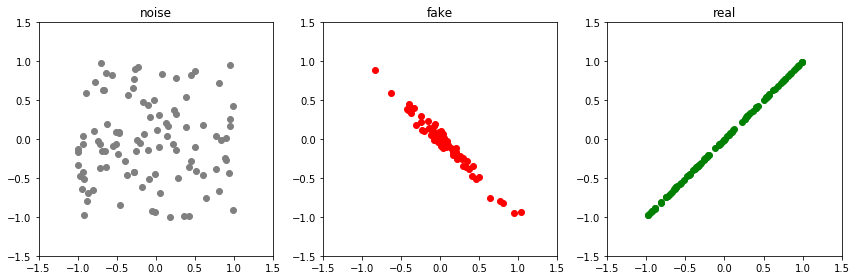

Epoch: 21450 G-error: 2.5487945079803467 D-error: 0.23269431293010712


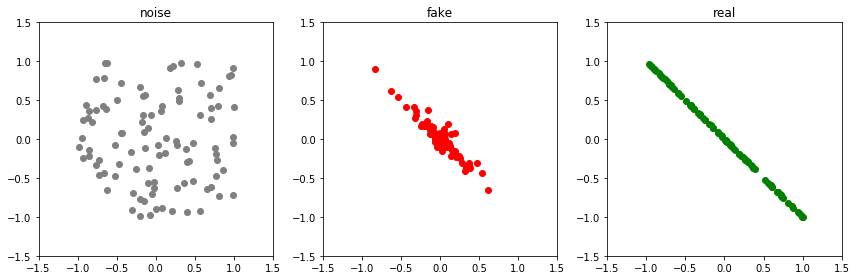

Epoch: 21500 G-error: 2.8009438514709473 D-error: 3.122378349304199


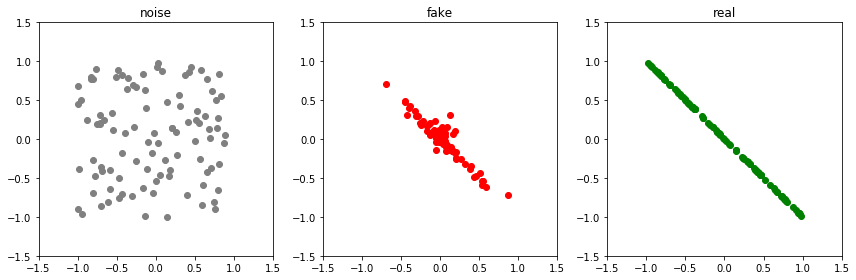

Epoch: 21550 G-error: 1.1627064943313599 D-error: 1.0170600414276123


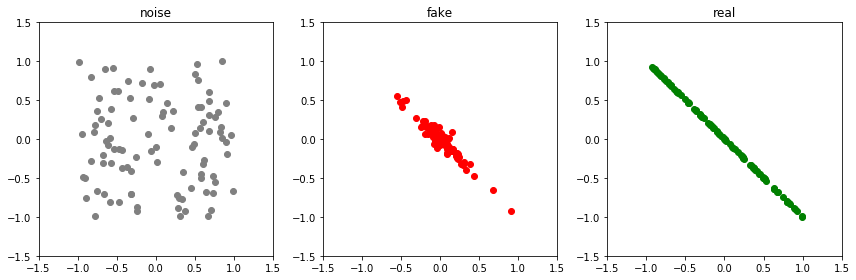

Epoch: 21600 G-error: 1.3140803575515747 D-error: 0.9423846006393433


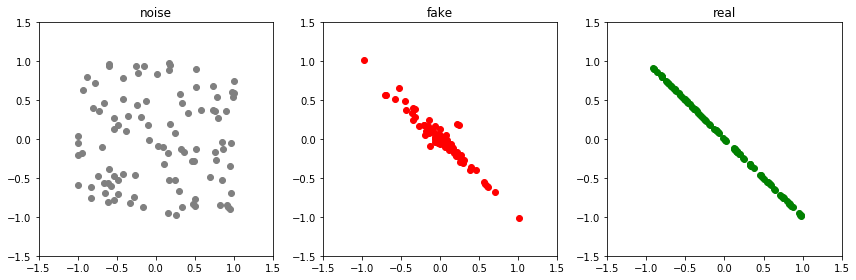

Epoch: 21650 G-error: 1.382522702217102 D-error: 1.0374616384506226


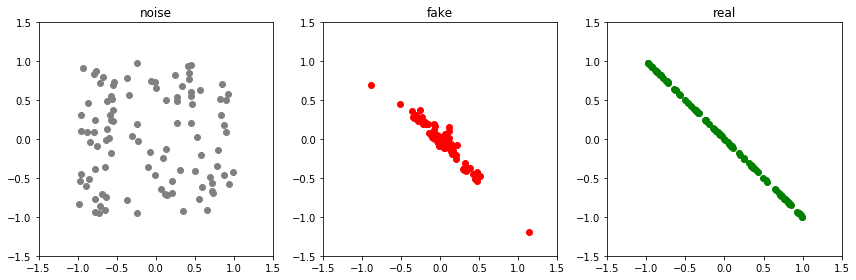

Epoch: 21700 G-error: 1.420944333076477 D-error: 0.873096764087677


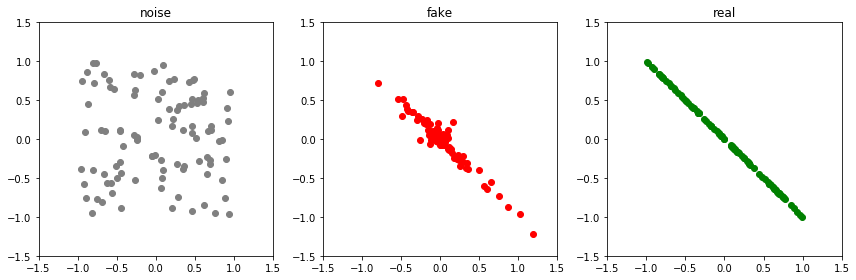

Epoch: 21750 G-error: 1.513279676437378 D-error: 1.0100610256195068


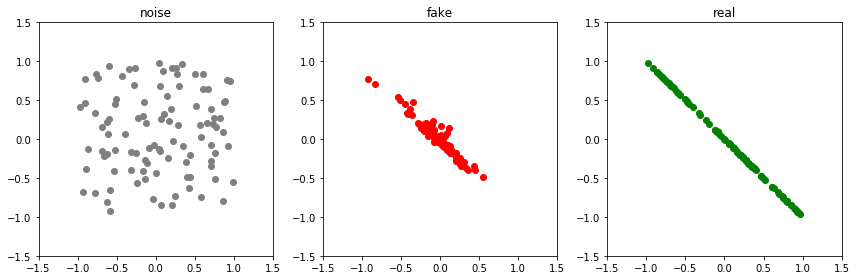

Epoch: 21800 G-error: 1.4131814241409302 D-error: 0.9971159100532532


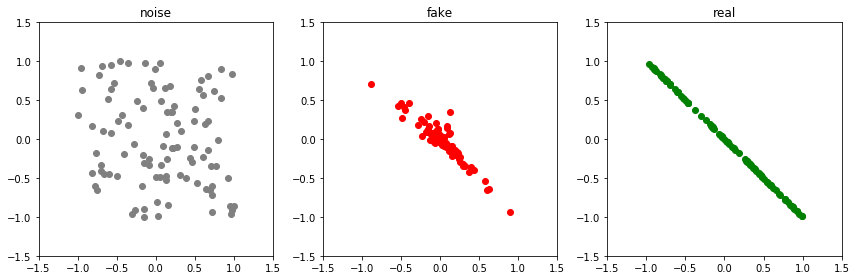

Epoch: 21850 G-error: 1.3908188343048096 D-error: 0.8426898717880249


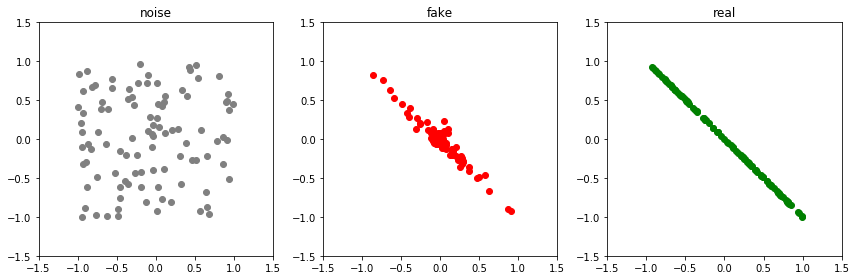

Epoch: 21900 G-error: 1.4161202907562256 D-error: 0.8800272941589355


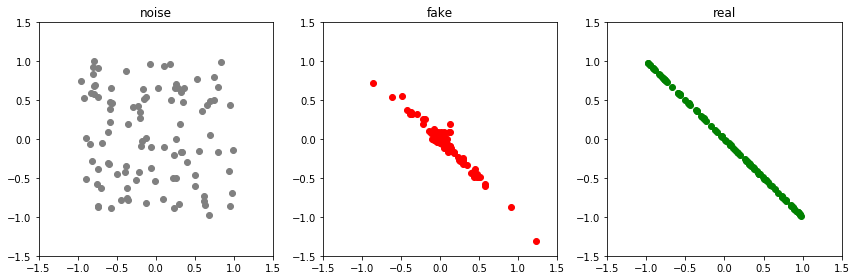

Epoch: 21950 G-error: 1.3350836038589478 D-error: 0.8669964075088501


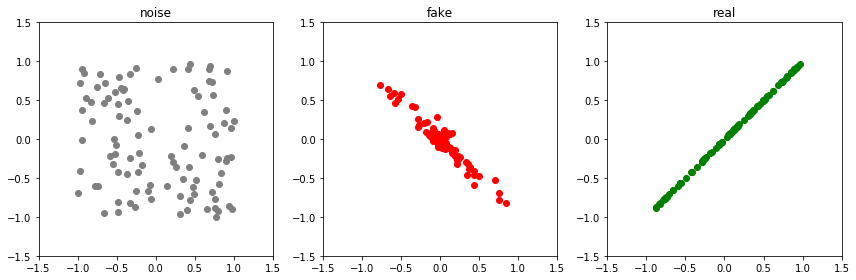

Epoch: 22000 G-error: 1.4064656496047974 D-error: 0.6138936281204224


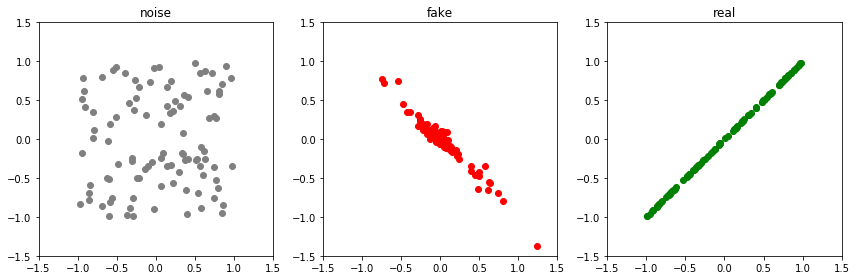

Epoch: 22050 G-error: 2.3533623218536377 D-error: 0.36775702238082886


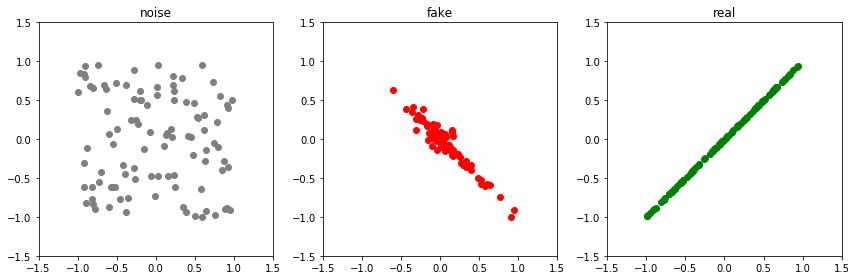

Epoch: 22100 G-error: 2.145034074783325 D-error: 0.41918665170669556


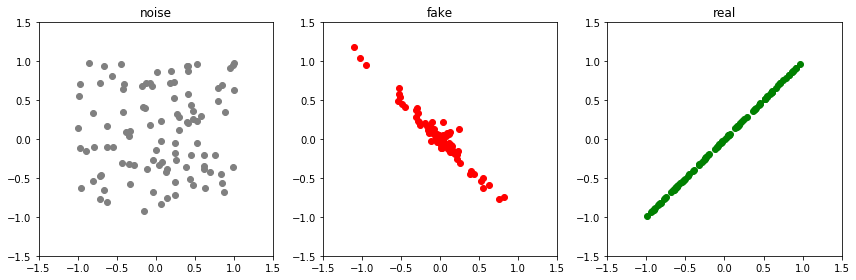

Epoch: 22150 G-error: 2.2249536514282227 D-error: 0.3403456211090088


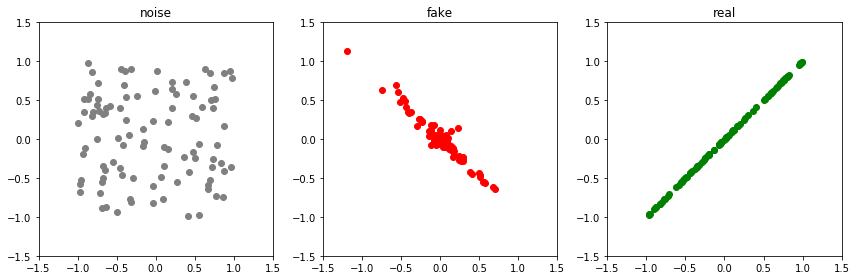

Epoch: 22200 G-error: 2.3763062953948975 D-error: 0.34901919960975647


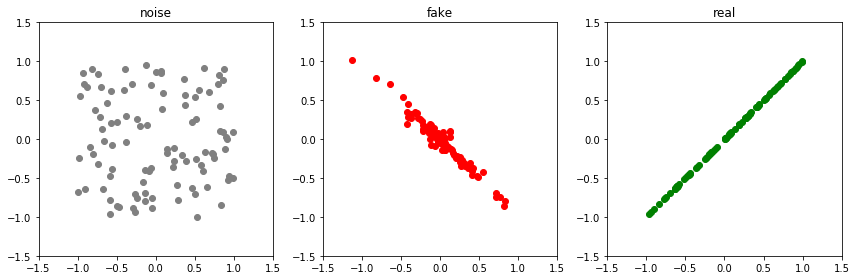

Epoch: 22250 G-error: 2.476677179336548 D-error: 0.2970643937587738


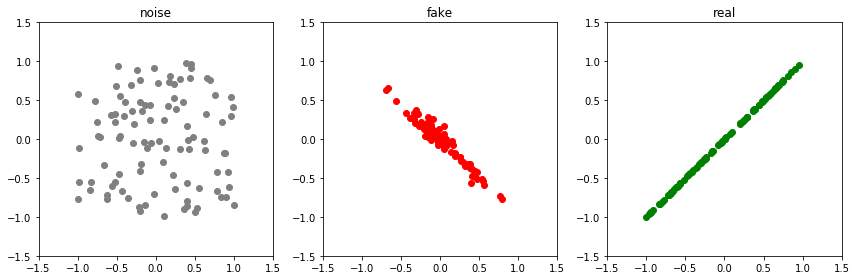

Epoch: 22300 G-error: 2.5274317264556885 D-error: 0.23551881313323975


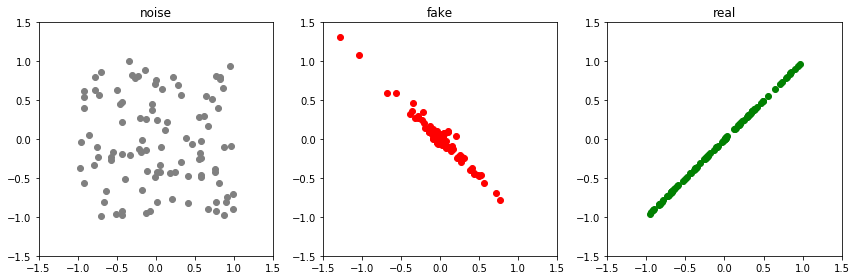

Epoch: 22350 G-error: 2.671363592147827 D-error: 0.3439595103263855


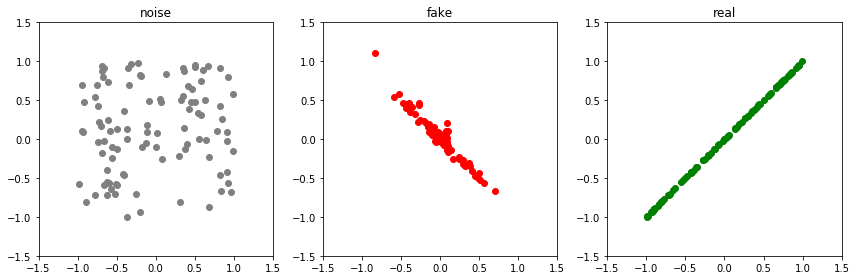

Epoch: 22400 G-error: 2.6778881549835205 D-error: 0.23836533725261688


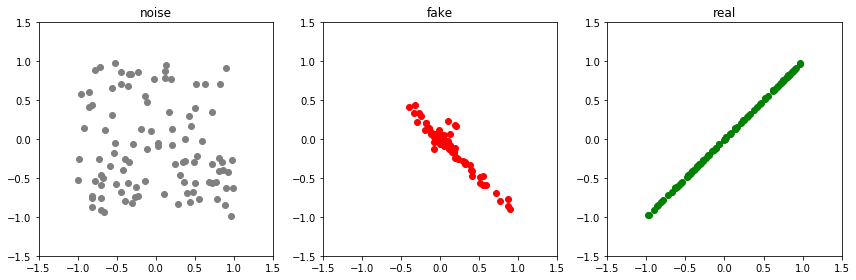

Epoch: 22450 G-error: 2.6578433513641357 D-error: 0.3227108418941498


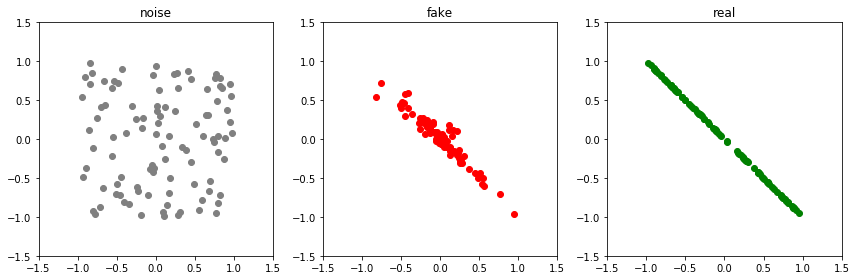

Epoch: 22500 G-error: 2.896549940109253 D-error: 3.2505757808685303


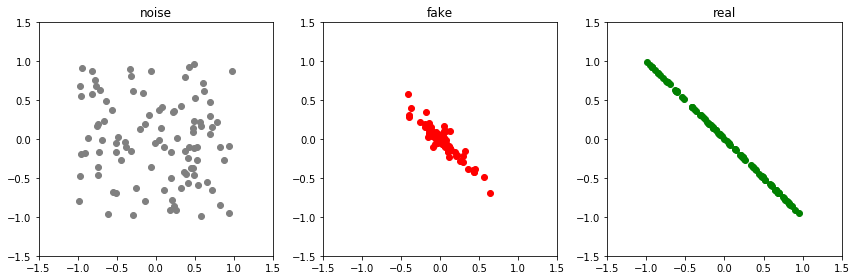

Epoch: 22550 G-error: 1.1097279787063599 D-error: 0.9642888307571411


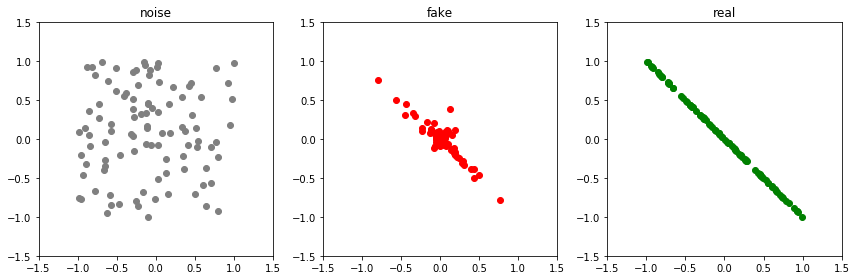

Epoch: 22600 G-error: 1.2249895334243774 D-error: 0.9990944862365723


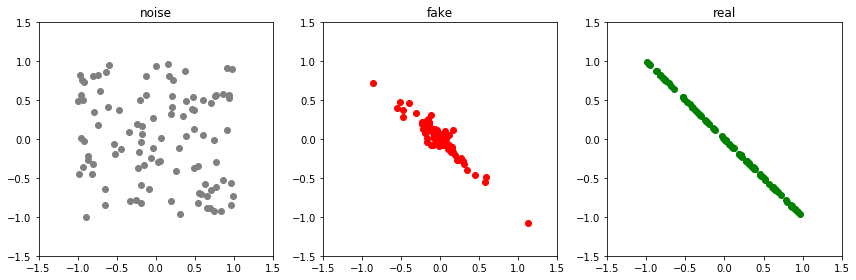

Epoch: 22650 G-error: 1.3516780138015747 D-error: 0.8722172379493713


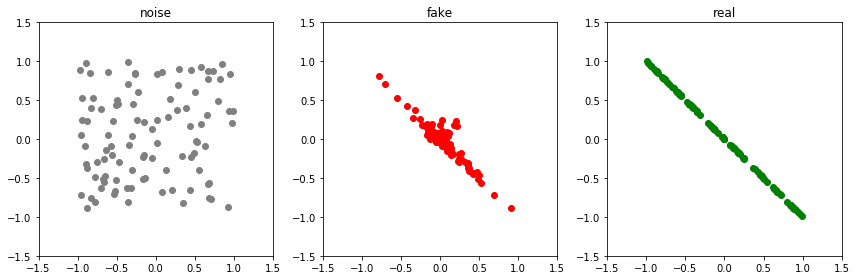

Epoch: 22700 G-error: 1.3327112197875977 D-error: 0.9497154355049133


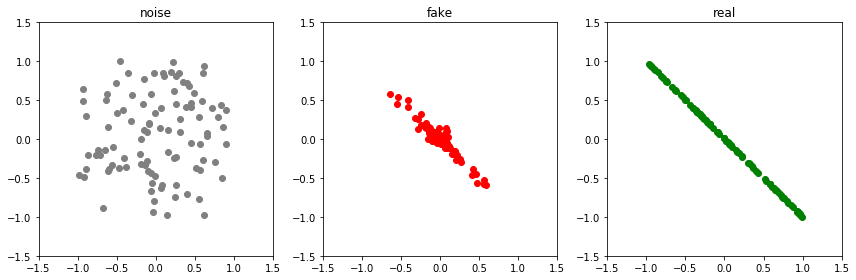

Epoch: 22750 G-error: 1.3693891763687134 D-error: 0.8763424158096313


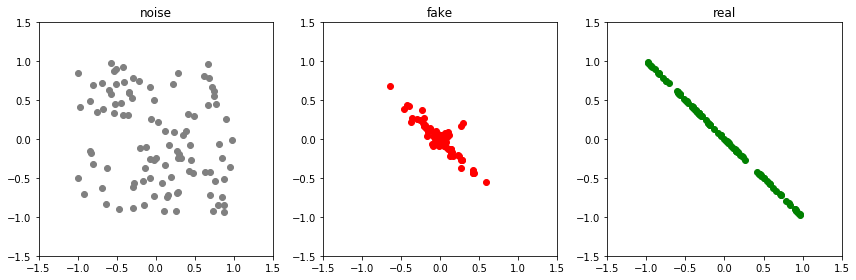

Epoch: 22800 G-error: 1.4464164972305298 D-error: 0.9018021821975708


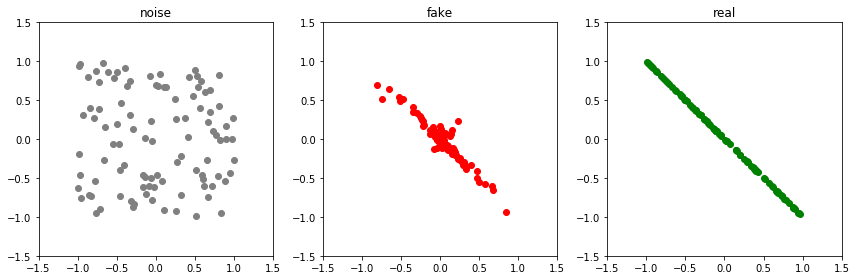

Epoch: 22850 G-error: 1.3728342056274414 D-error: 0.9636825919151306


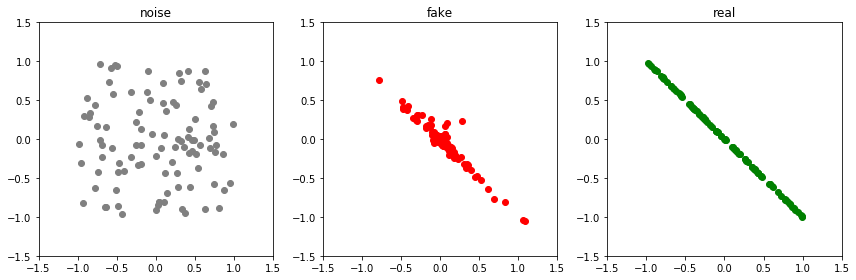

Epoch: 22900 G-error: 1.486498236656189 D-error: 0.9648423790931702


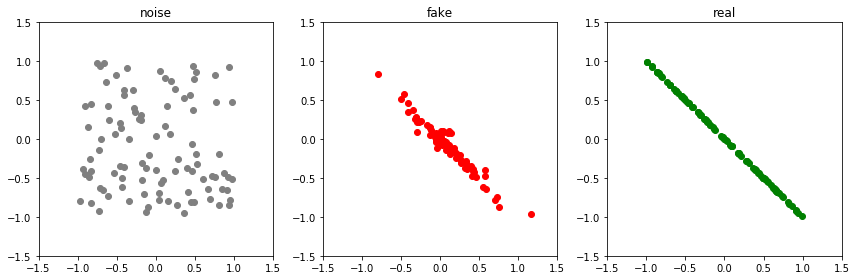

Epoch: 22950 G-error: 1.4888583421707153 D-error: 0.8740295767784119


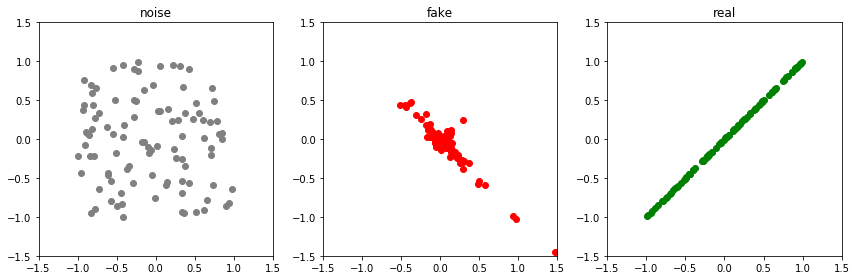

Epoch: 23000 G-error: 1.4148473739624023 D-error: 0.6818361878395081


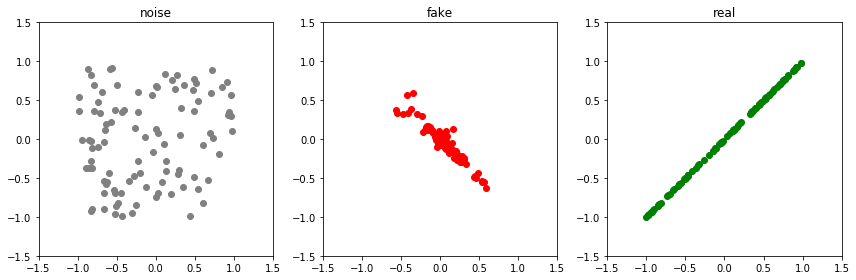

Epoch: 23050 G-error: 2.2682383060455322 D-error: 0.4000123143196106


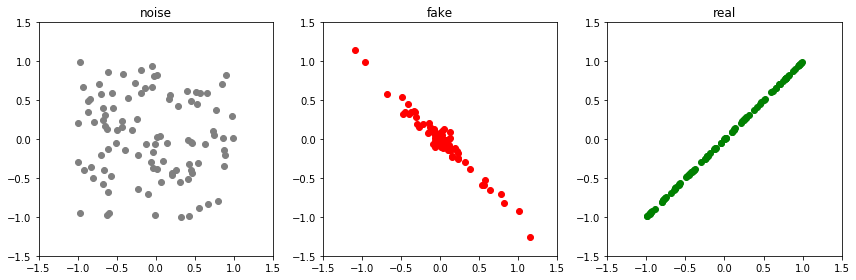

Epoch: 23100 G-error: 2.2090728282928467 D-error: 0.3450748026371002


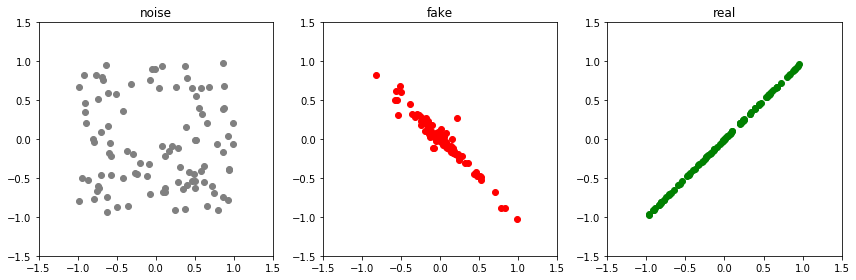

Epoch: 23150 G-error: 2.281970262527466 D-error: 0.3973383903503418


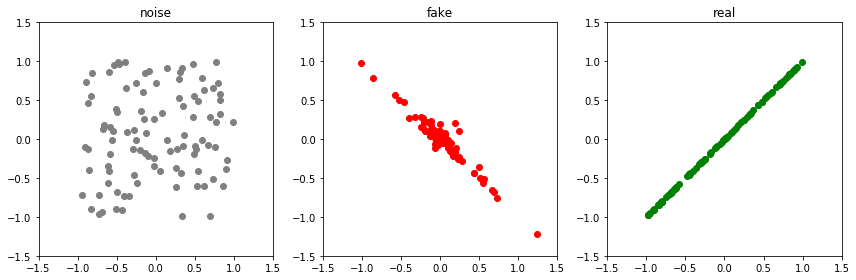

Epoch: 23200 G-error: 2.3363118171691895 D-error: 0.29480957984924316


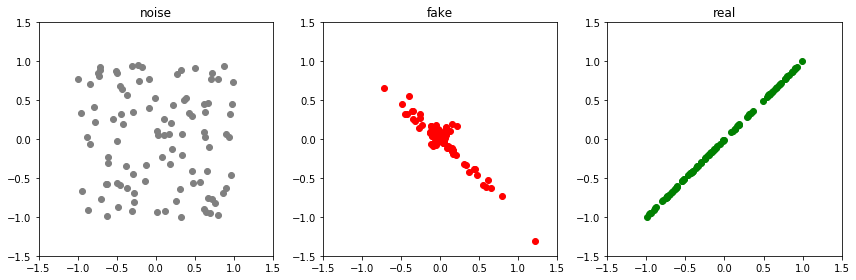

Epoch: 23250 G-error: 2.366898536682129 D-error: 0.2715546488761902


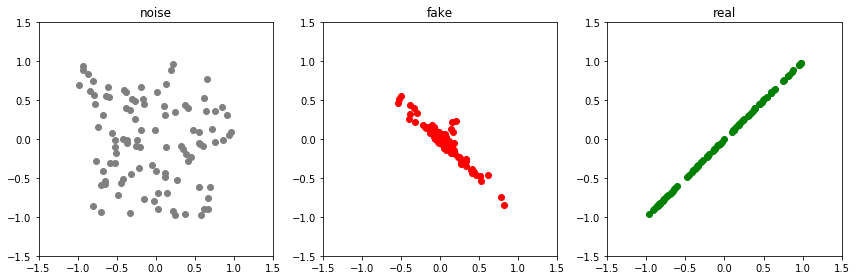

Epoch: 23300 G-error: 2.5487101078033447 D-error: 0.266818106174469


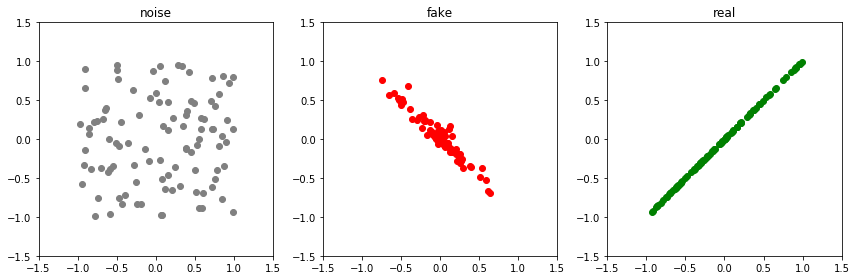

Epoch: 23350 G-error: 2.6710891723632812 D-error: 0.37919458746910095


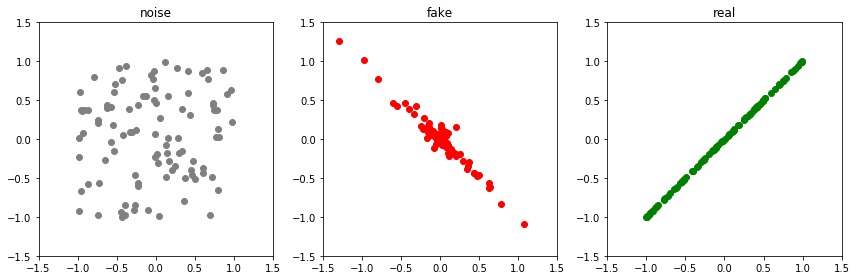

Epoch: 23400 G-error: 2.6532747745513916 D-error: 0.2934095561504364


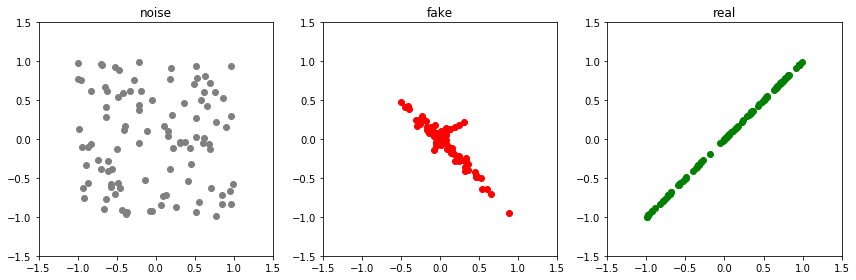

Epoch: 23450 G-error: 2.779507637023926 D-error: 0.34232425689697266


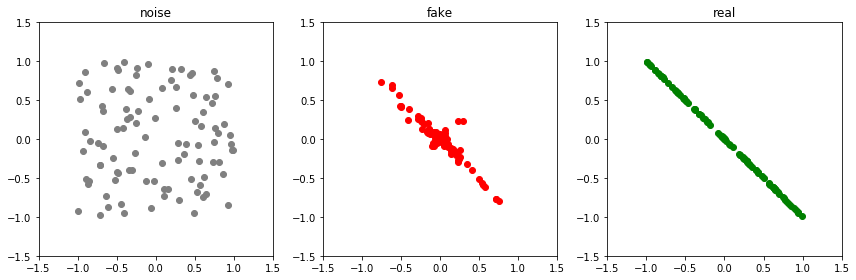

Epoch: 23500 G-error: 2.826228380203247 D-error: 3.2795865535736084


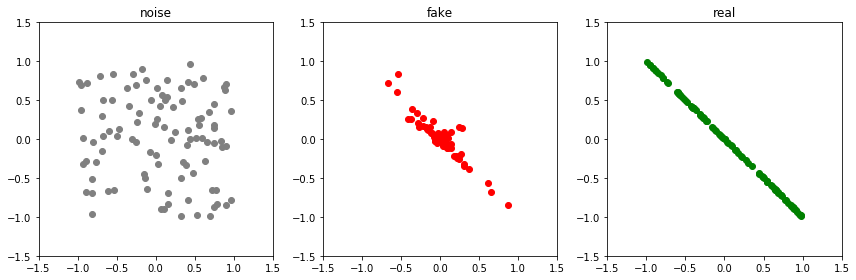

Epoch: 23550 G-error: 1.1429566144943237 D-error: 0.9331475496292114


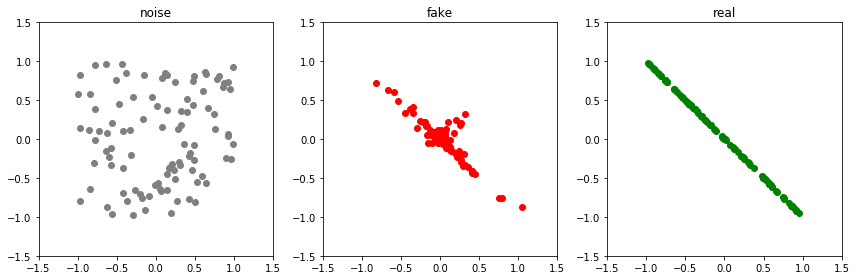

Epoch: 23600 G-error: 1.2753322124481201 D-error: 0.8934130668640137


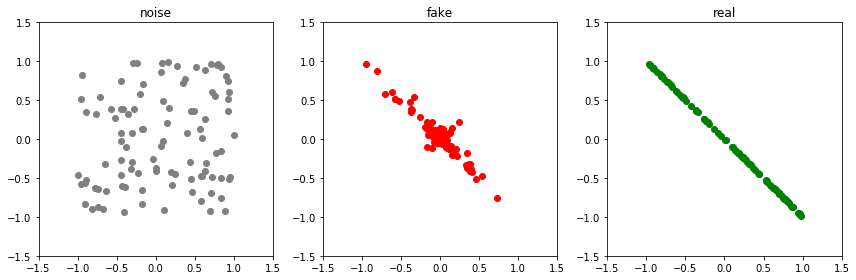

Epoch: 23650 G-error: 1.3940041065216064 D-error: 0.8551722168922424


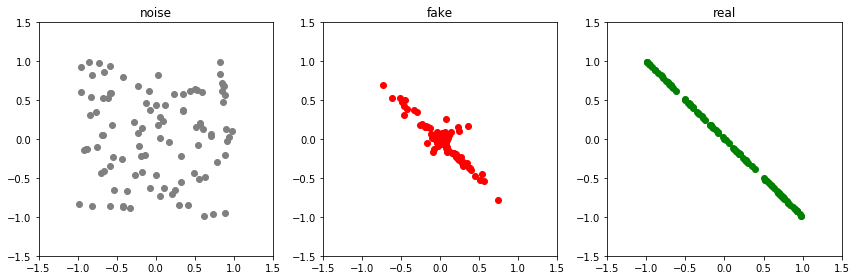

Epoch: 23700 G-error: 1.469282627105713 D-error: 0.8743319511413574


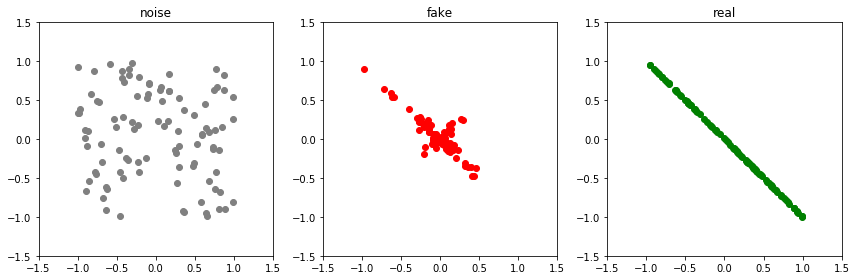

Epoch: 23750 G-error: 1.5447866916656494 D-error: 0.9213477969169617


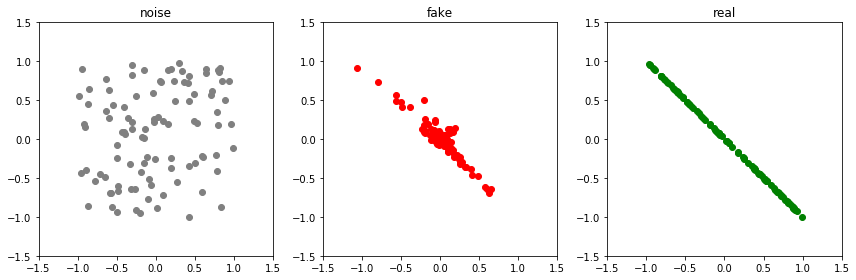

Epoch: 23800 G-error: 1.493544340133667 D-error: 0.8583862781524658


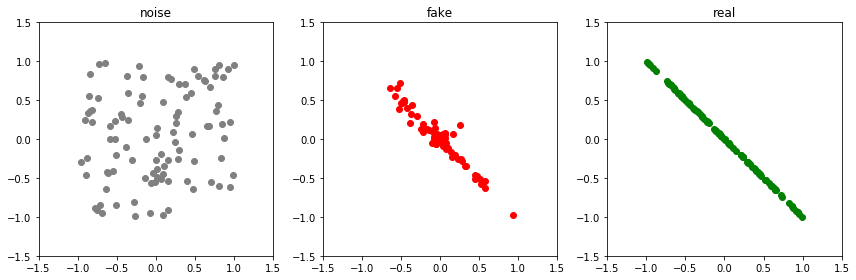

Epoch: 23850 G-error: 1.4990712404251099 D-error: 0.9760923385620117


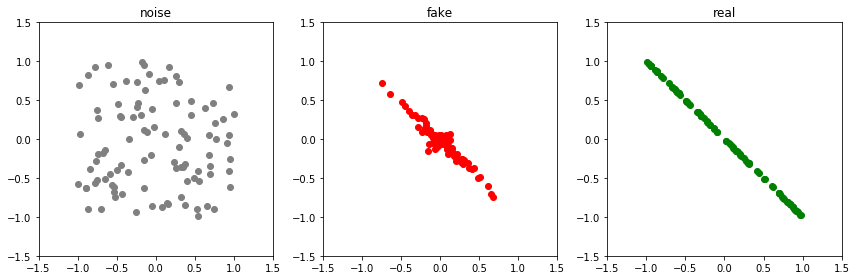

Epoch: 23900 G-error: 1.4937890768051147 D-error: 0.8490862846374512


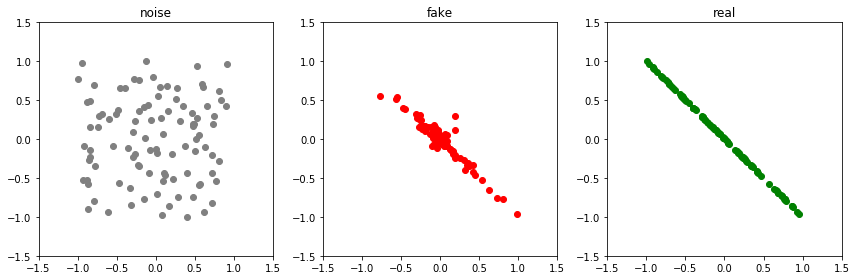

Epoch: 23950 G-error: 1.3771291971206665 D-error: 0.9182208776473999


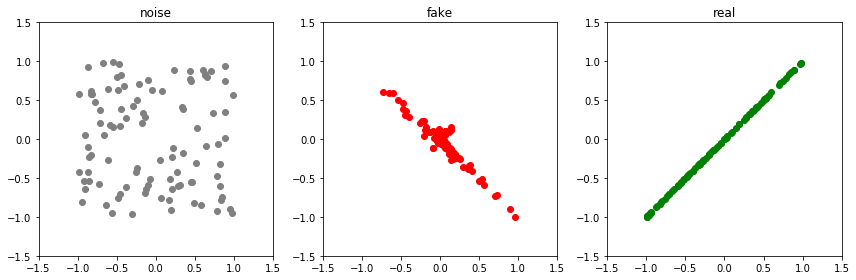

Epoch: 24000 G-error: 1.4254772663116455 D-error: 0.6341285705566406


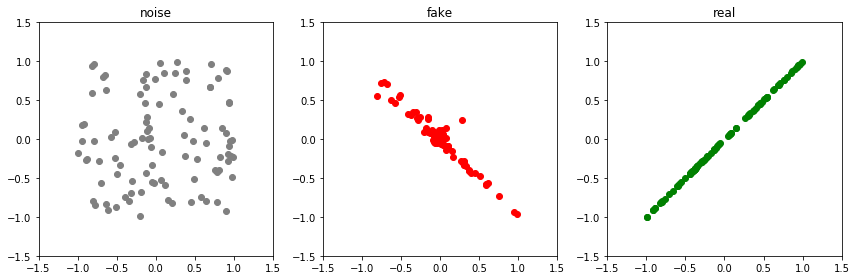

Epoch: 24050 G-error: 2.195431709289551 D-error: 0.4166536331176758


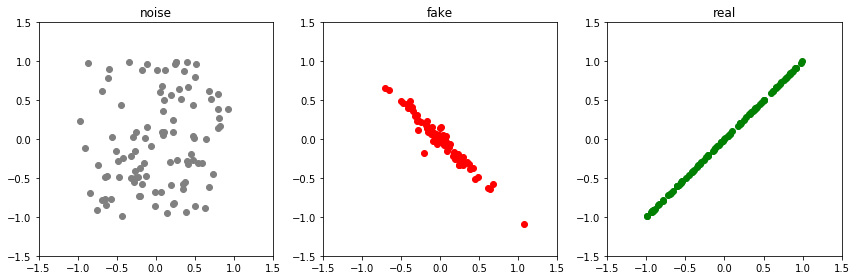

Epoch: 24100 G-error: 2.054194688796997 D-error: 0.4086807370185852


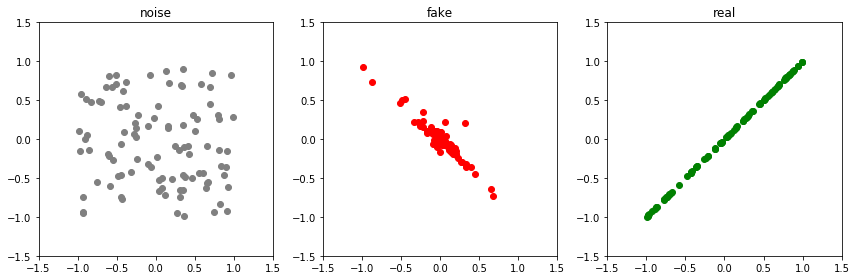

Epoch: 24150 G-error: 2.1925575733184814 D-error: 0.35279786586761475


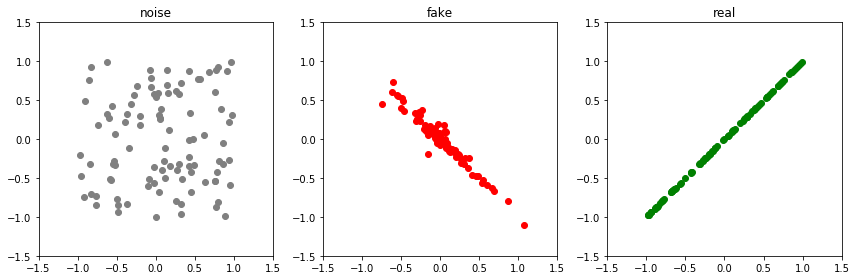

Epoch: 24200 G-error: 2.3742830753326416 D-error: 0.28210026025772095


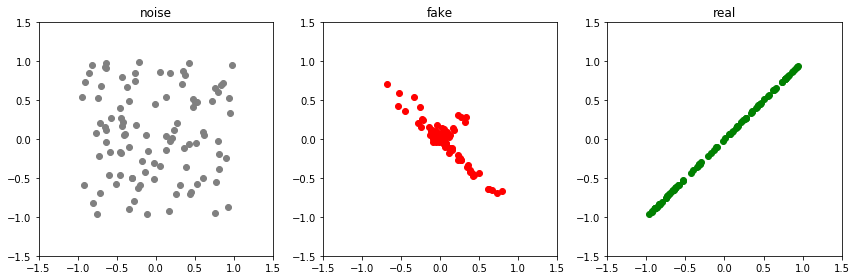

Epoch: 24250 G-error: 2.4077506065368652 D-error: 0.3266758918762207


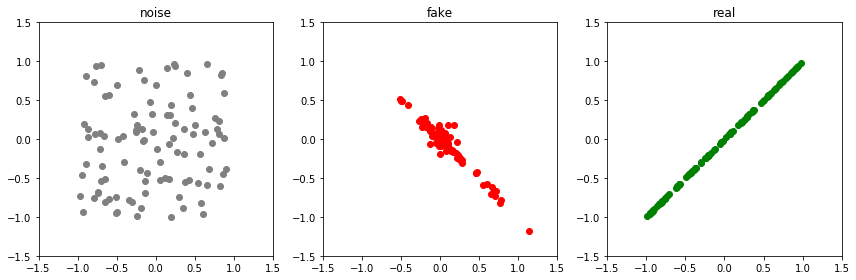

Epoch: 24300 G-error: 2.594055414199829 D-error: 0.2627568244934082


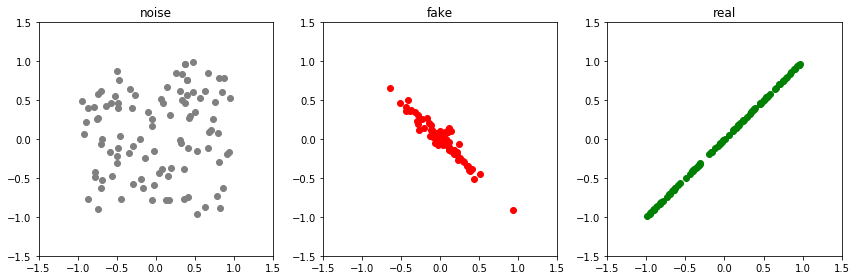

Epoch: 24350 G-error: 2.4689829349517822 D-error: 0.2751694917678833


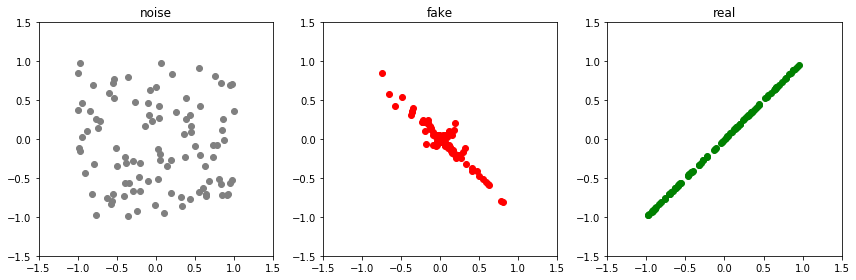

Epoch: 24400 G-error: 2.5466179847717285 D-error: 0.29166993498802185


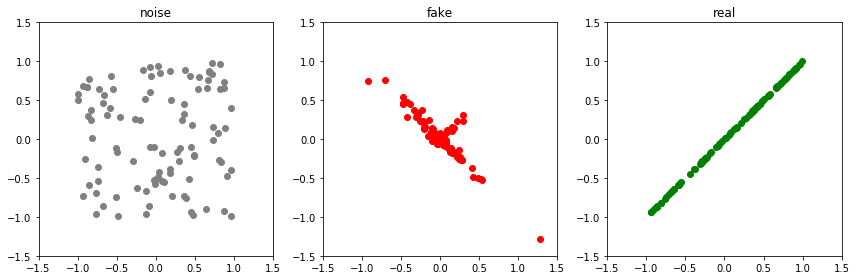

Epoch: 24450 G-error: 2.682049512863159 D-error: 0.32540494203567505


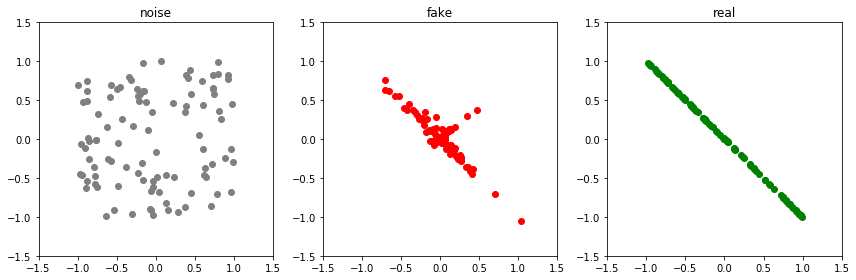

Epoch: 24500 G-error: 2.7494614124298096 D-error: 3.4305899143218994


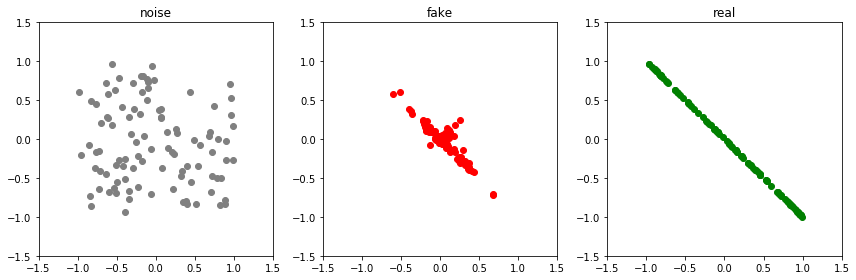

Epoch: 24550 G-error: 1.1825777292251587 D-error: 0.9652689099311829


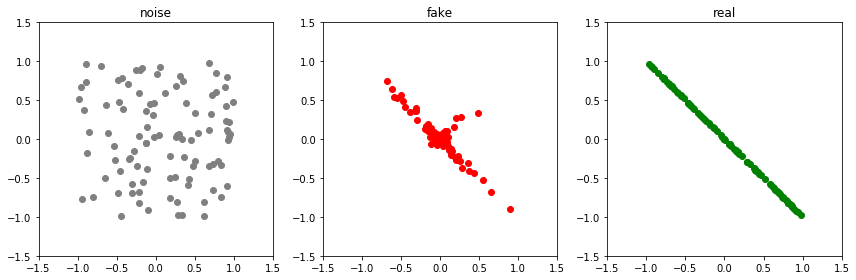

Epoch: 24600 G-error: 1.3094772100448608 D-error: 0.8698256611824036


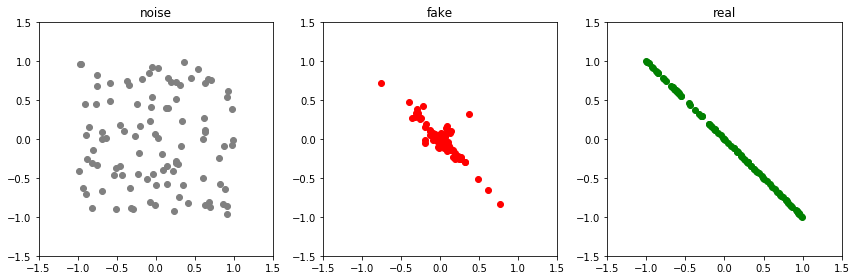

Epoch: 24650 G-error: 1.3085914850234985 D-error: 0.8026340007781982


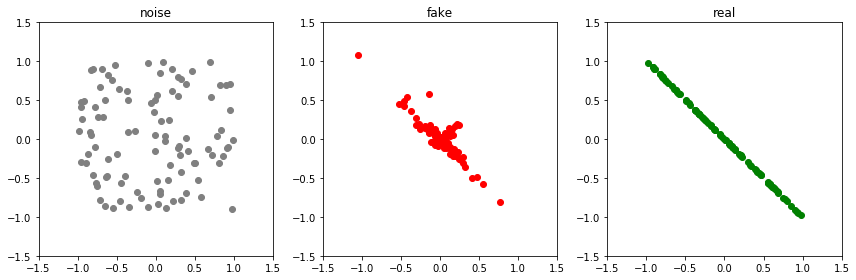

Epoch: 24700 G-error: 1.481094241142273 D-error: 0.9025547504425049


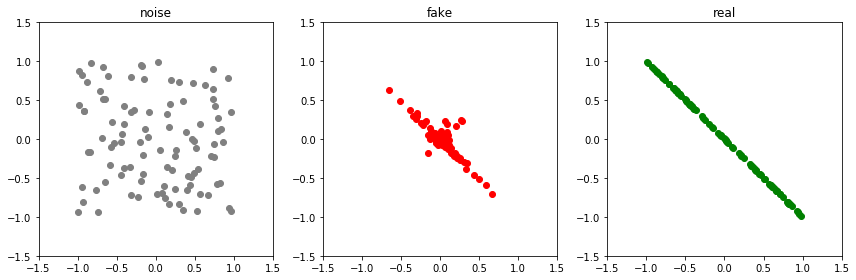

Epoch: 24750 G-error: 1.4277825355529785 D-error: 0.7930251955986023


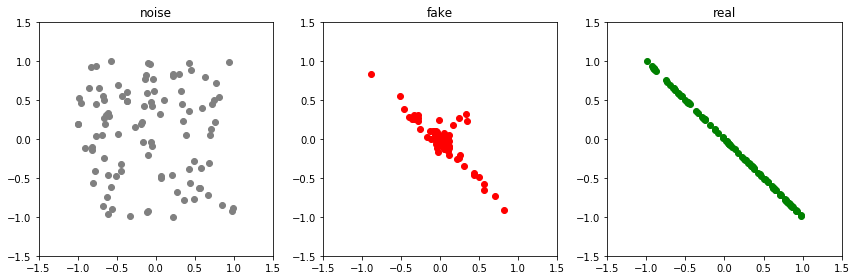

Epoch: 24800 G-error: 1.5422730445861816 D-error: 0.828175961971283


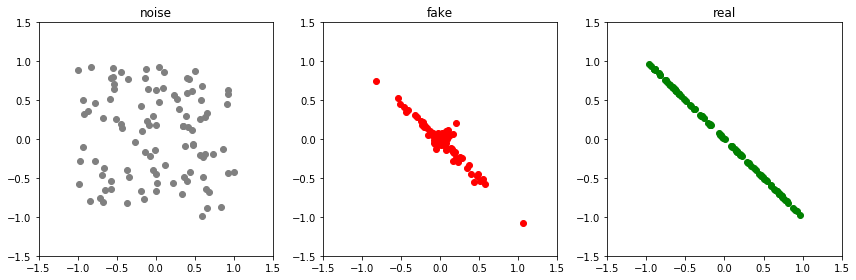

Epoch: 24850 G-error: 1.4298127889633179 D-error: 0.8034020662307739


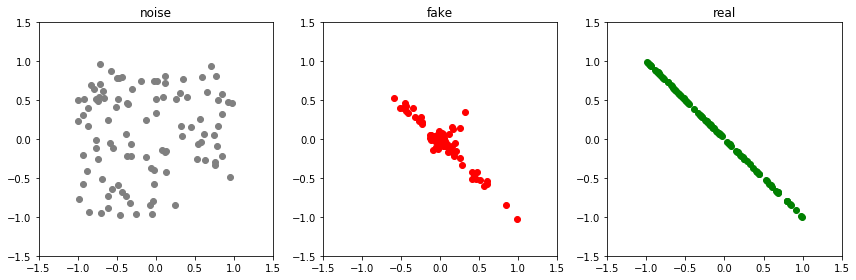

Epoch: 24900 G-error: 1.3945083618164062 D-error: 0.8719061613082886


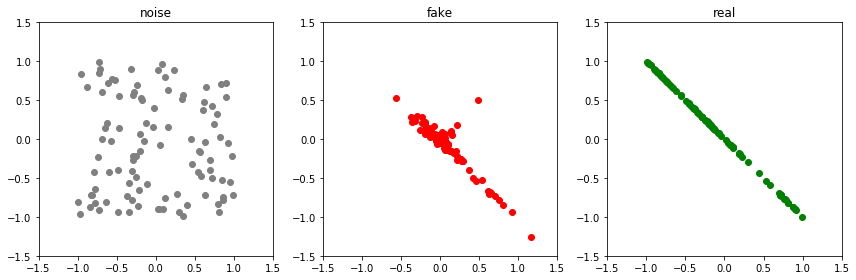

Epoch: 24950 G-error: 1.36753511428833 D-error: 0.9333071112632751


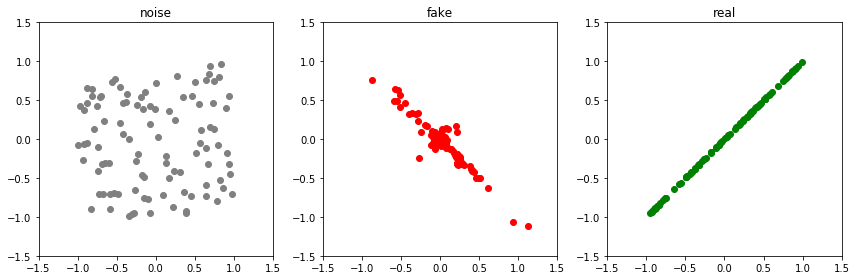

Epoch: 25000 G-error: 1.3452463150024414 D-error: 0.7389944195747375


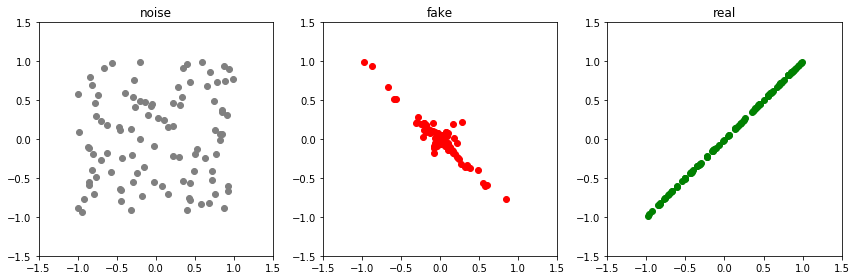

Epoch: 25050 G-error: 1.9975908994674683 D-error: 0.4214067757129669


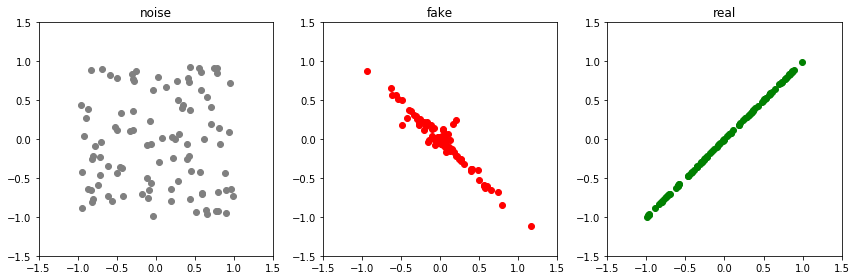

Epoch: 25100 G-error: 2.1330699920654297 D-error: 0.4047163128852844


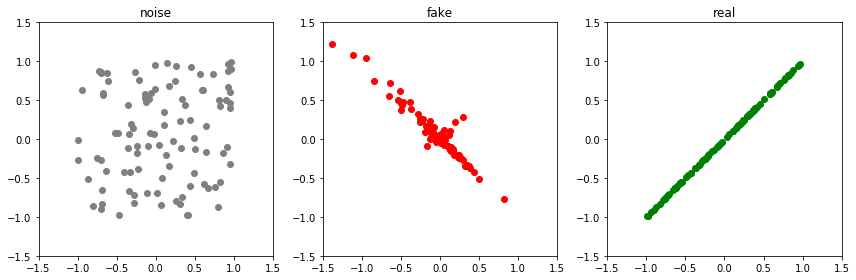

Epoch: 25150 G-error: 2.193524122238159 D-error: 0.33692222833633423


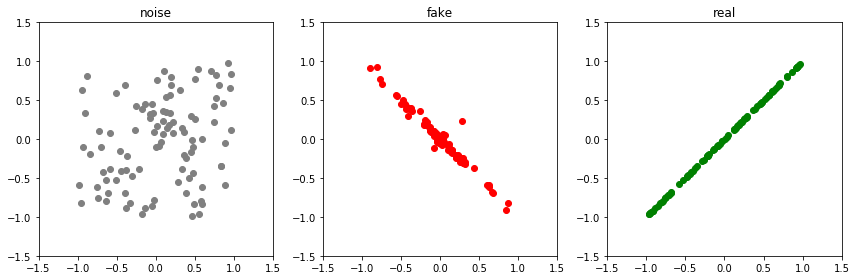

Epoch: 25200 G-error: 2.2223029136657715 D-error: 0.3729706406593323


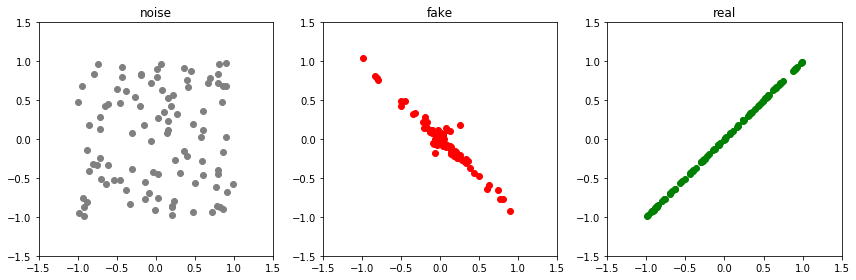

Epoch: 25250 G-error: 2.3785643577575684 D-error: 0.33142146468162537


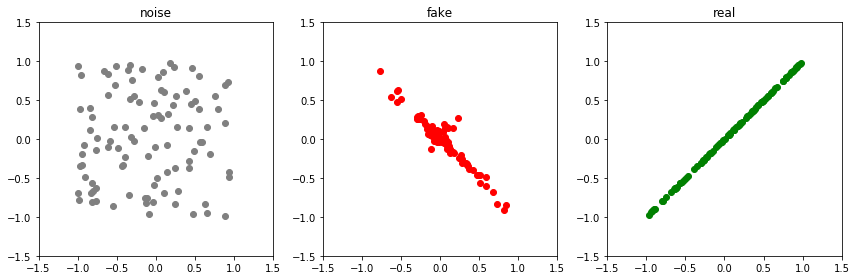

Epoch: 25300 G-error: 2.361088752746582 D-error: 0.3300248980522156


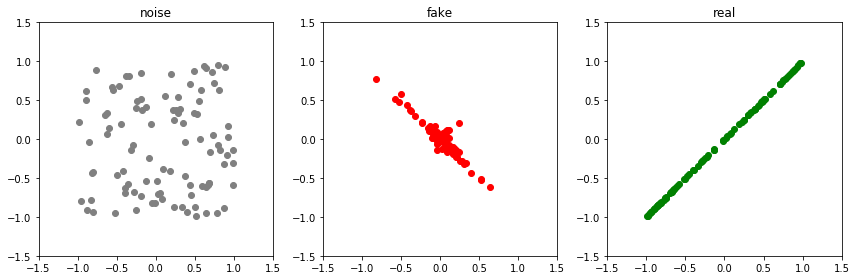

Epoch: 25350 G-error: 2.389418363571167 D-error: 0.2453565001487732


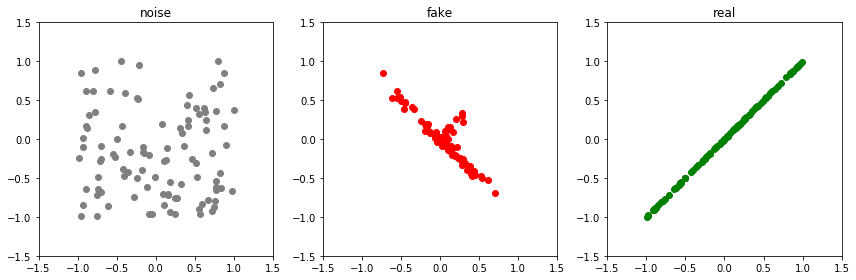

Epoch: 25400 G-error: 2.573945999145508 D-error: 0.37334948778152466


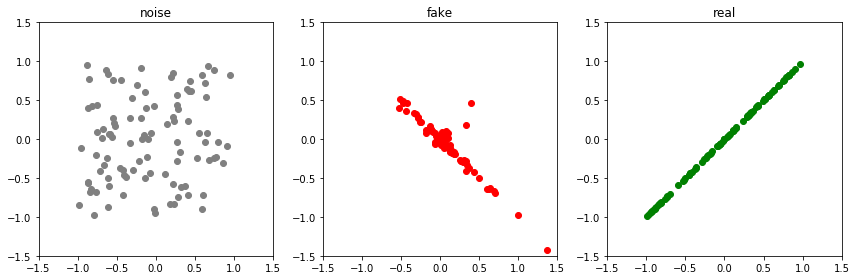

Epoch: 25450 G-error: 2.482107400894165 D-error: 0.38988059759140015


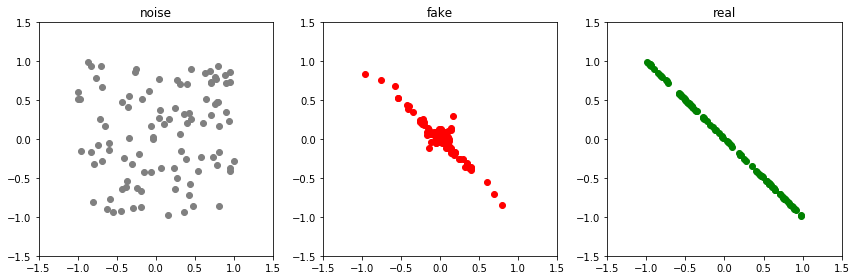

Epoch: 25500 G-error: 2.4530158042907715 D-error: 3.4087390899658203


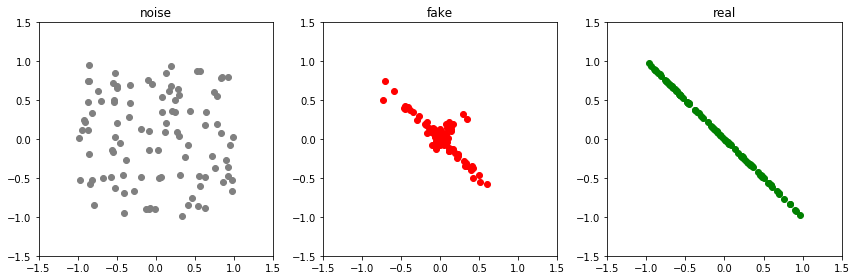

Epoch: 25550 G-error: 1.1577621698379517 D-error: 1.078918695449829


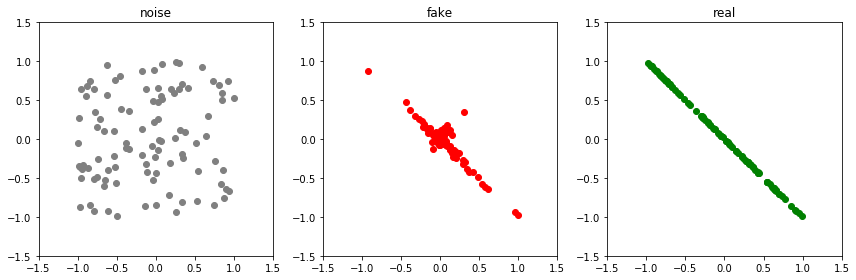

Epoch: 25600 G-error: 1.3071272373199463 D-error: 1.0312505960464478


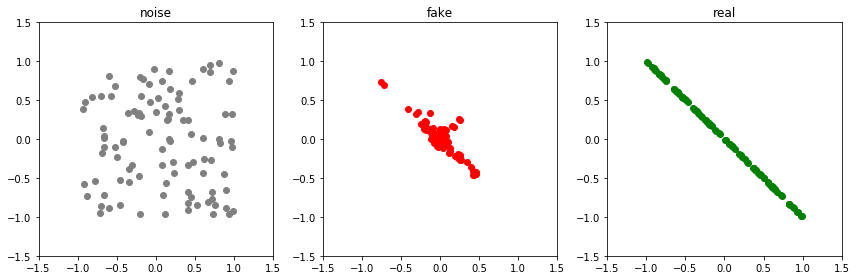

Epoch: 25650 G-error: 1.2660967111587524 D-error: 0.7811683416366577


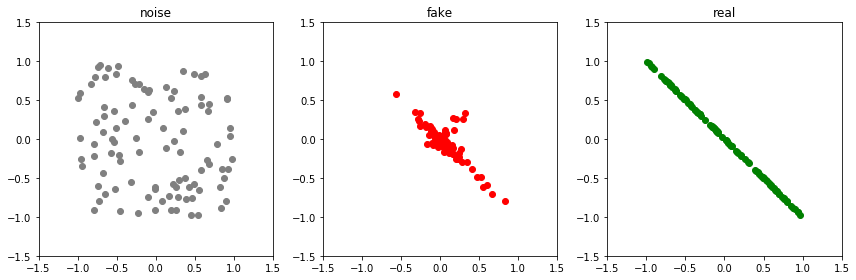

Epoch: 25700 G-error: 1.4581493139266968 D-error: 0.844412088394165


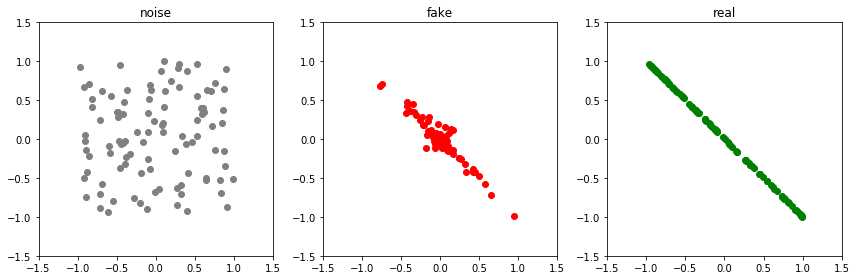

Epoch: 25750 G-error: 1.394866943359375 D-error: 0.7935929298400879


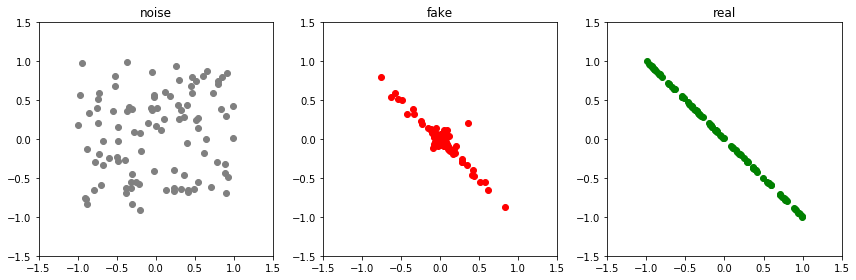

Epoch: 25800 G-error: 1.5015865564346313 D-error: 0.9284545183181763


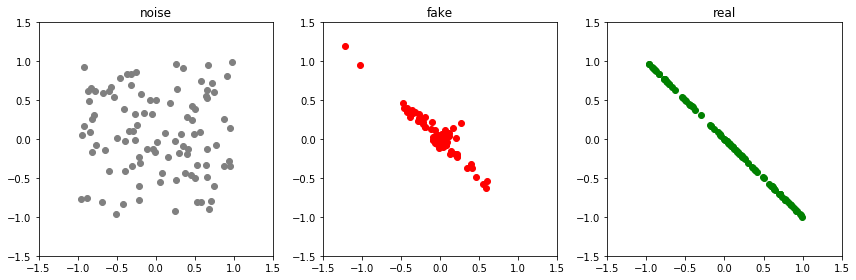

Epoch: 25850 G-error: 1.4393147230148315 D-error: 0.9079059362411499


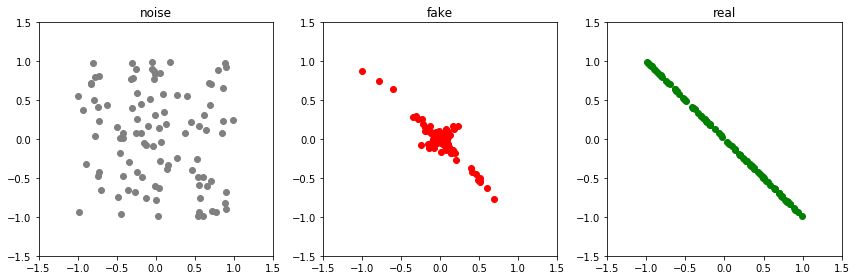

Epoch: 25900 G-error: 1.4607220888137817 D-error: 0.7788730263710022


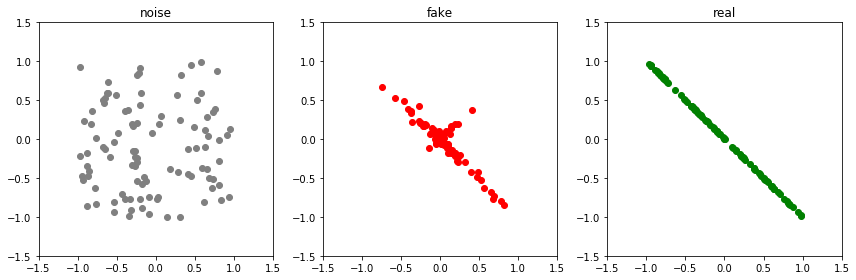

Epoch: 25950 G-error: 1.5384013652801514 D-error: 0.878196120262146


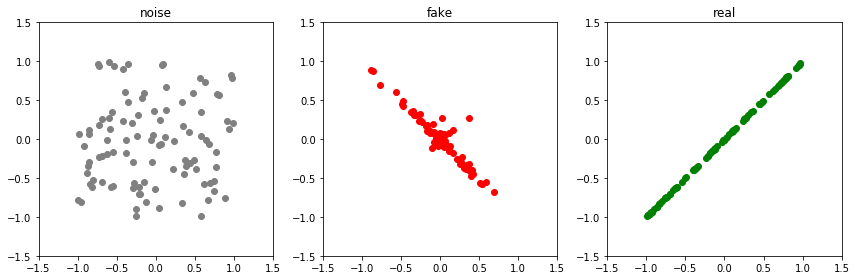

Epoch: 26000 G-error: 1.384912133216858 D-error: 0.7988691329956055


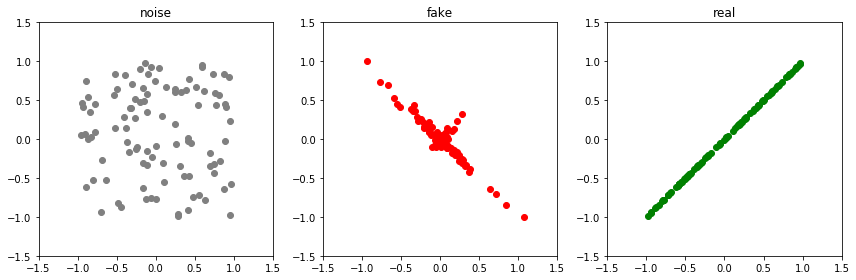

Epoch: 26050 G-error: 1.8630610704421997 D-error: 0.4780508577823639


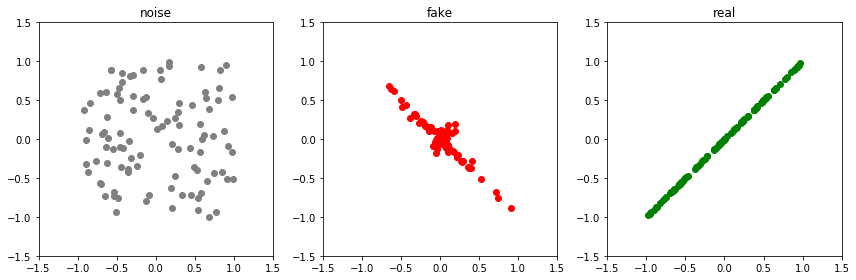

Epoch: 26100 G-error: 2.0013580322265625 D-error: 0.46512097120285034


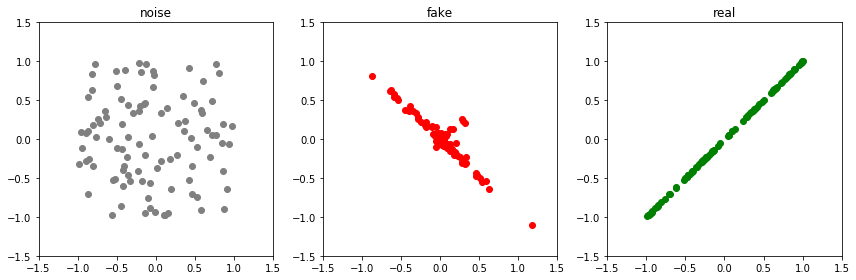

Epoch: 26150 G-error: 2.0740163326263428 D-error: 0.31895846128463745


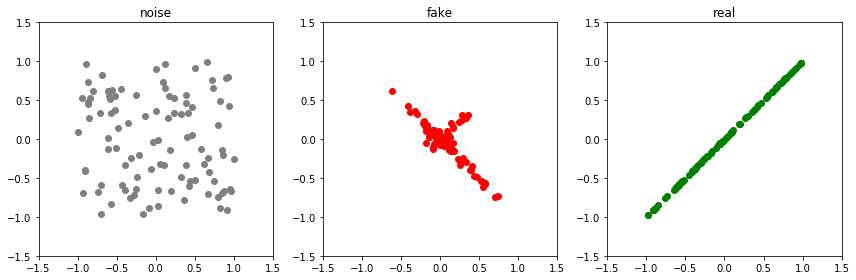

Epoch: 26200 G-error: 2.151942729949951 D-error: 0.4748919606208801


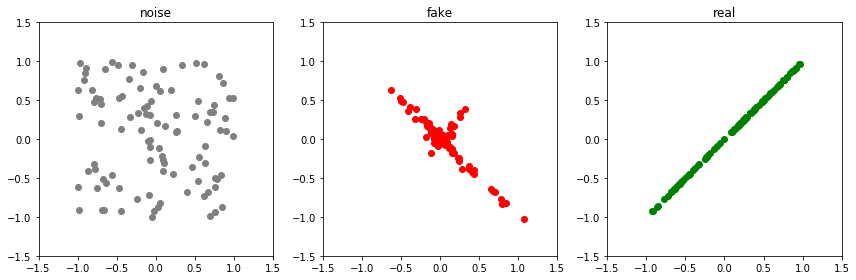

Epoch: 26250 G-error: 2.327789545059204 D-error: 0.34218156337738037


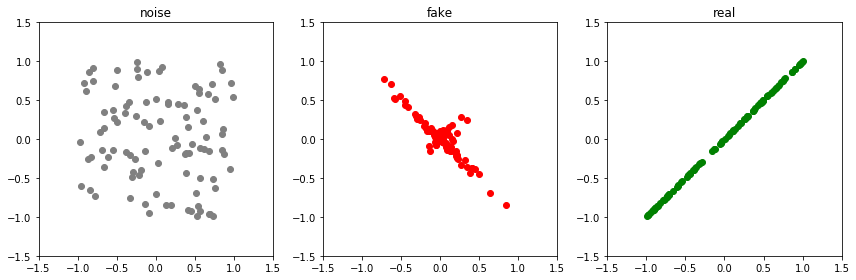

Epoch: 26300 G-error: 2.315500497817993 D-error: 0.3379562497138977


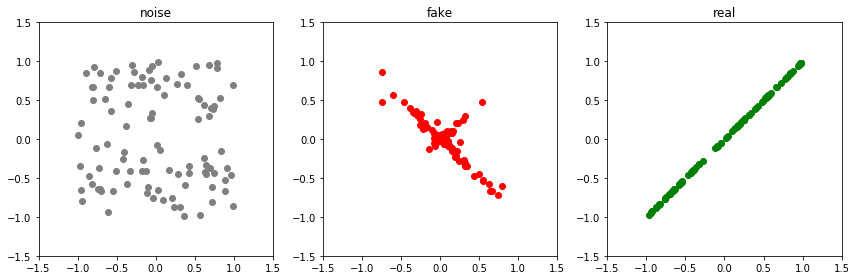

Epoch: 26350 G-error: 2.386293888092041 D-error: 0.3877306878566742


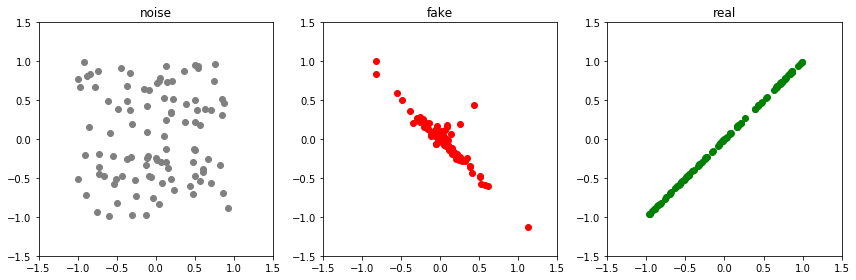

Epoch: 26400 G-error: 2.578936815261841 D-error: 0.383343368768692


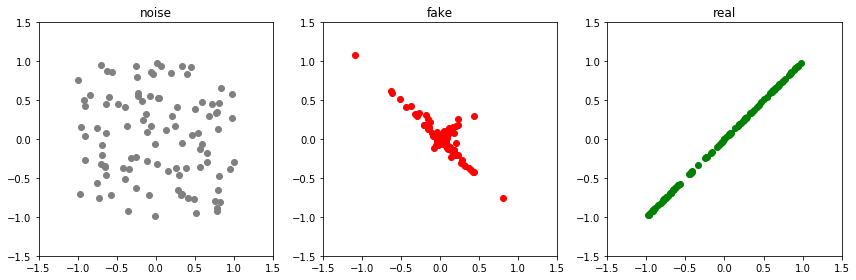

Epoch: 26450 G-error: 2.455028772354126 D-error: 0.36665672063827515


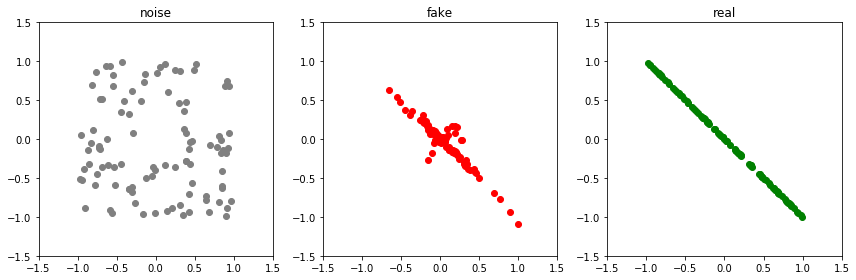

Epoch: 26500 G-error: 2.5578360557556152 D-error: 3.3074138164520264


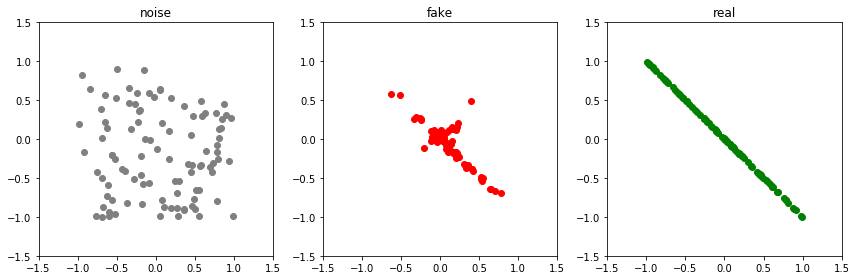

Epoch: 26550 G-error: 1.1089715957641602 D-error: 1.0755765438079834


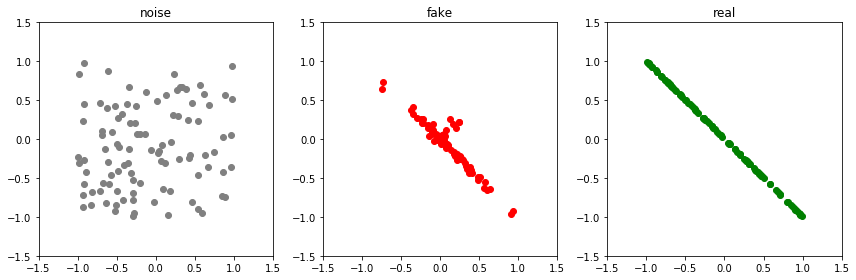

Epoch: 26600 G-error: 1.2422881126403809 D-error: 0.8281610012054443


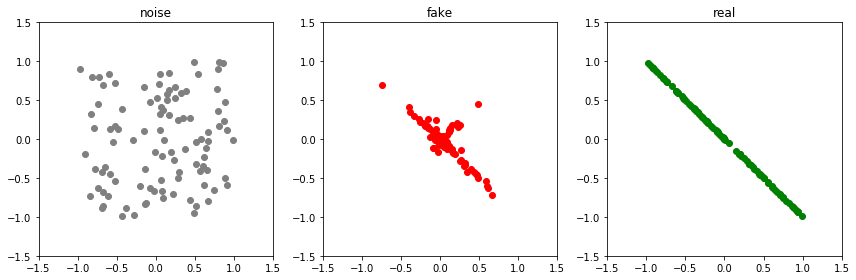

Epoch: 26650 G-error: 1.370231032371521 D-error: 0.9049367904663086


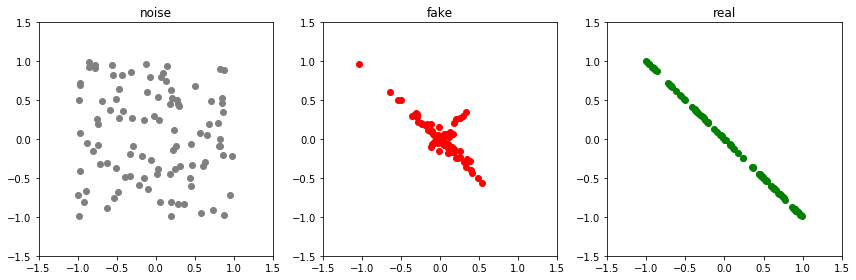

Epoch: 26700 G-error: 1.4710594415664673 D-error: 0.8088315725326538


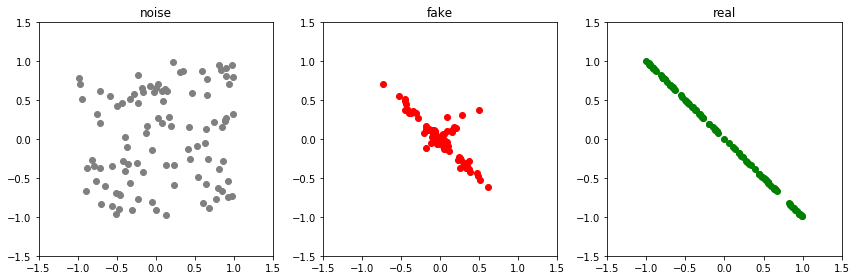

Epoch: 26750 G-error: 1.5144141912460327 D-error: 0.7152456045150757


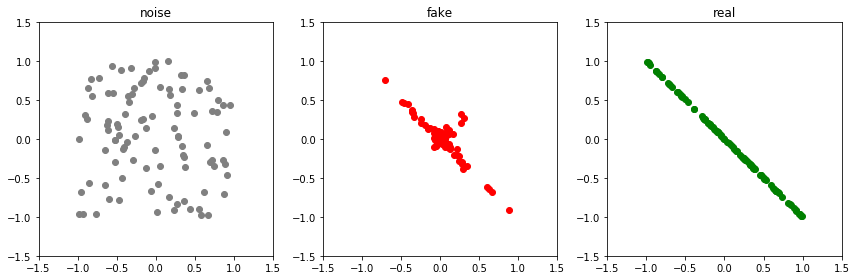

Epoch: 26800 G-error: 1.5118521451950073 D-error: 1.0152568817138672


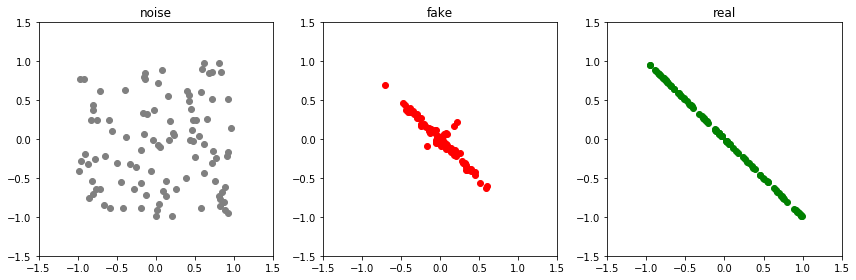

Epoch: 26850 G-error: 1.5189002752304077 D-error: 0.9660249948501587


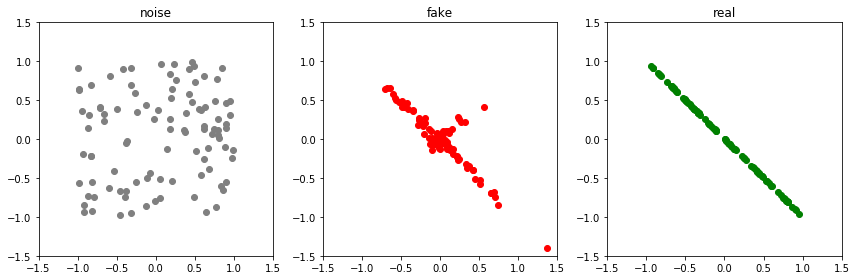

Epoch: 26900 G-error: 1.4068413972854614 D-error: 0.9995195865631104


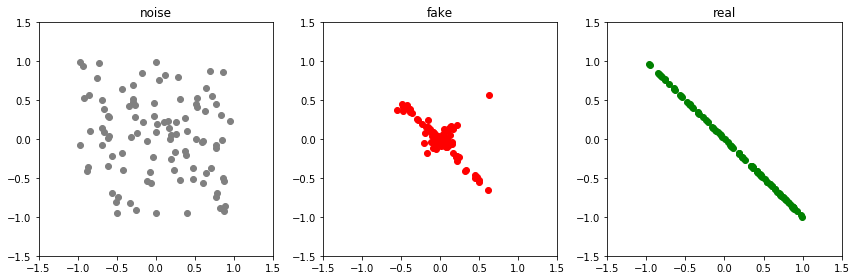

Epoch: 26950 G-error: 1.4878610372543335 D-error: 0.7867323160171509


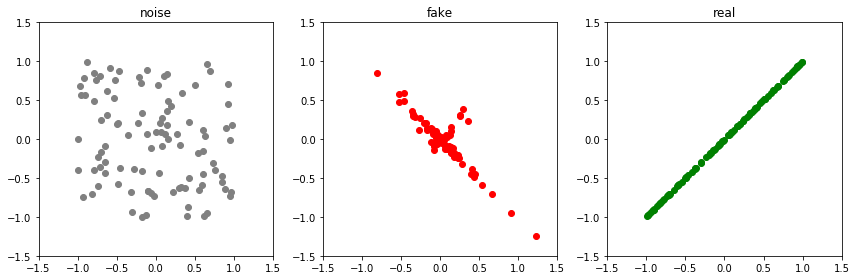

Epoch: 27000 G-error: 1.4520076513290405 D-error: 0.863466739654541


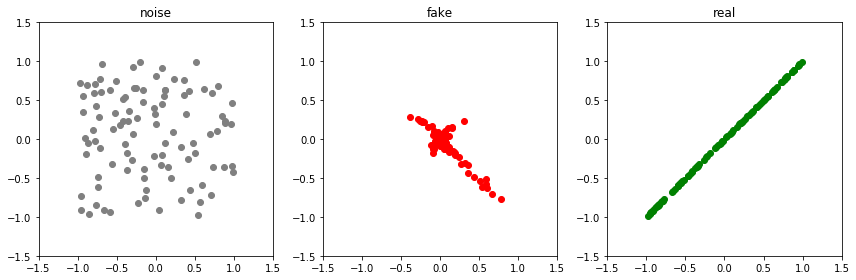

Epoch: 27050 G-error: 1.955305814743042 D-error: 0.4595358967781067


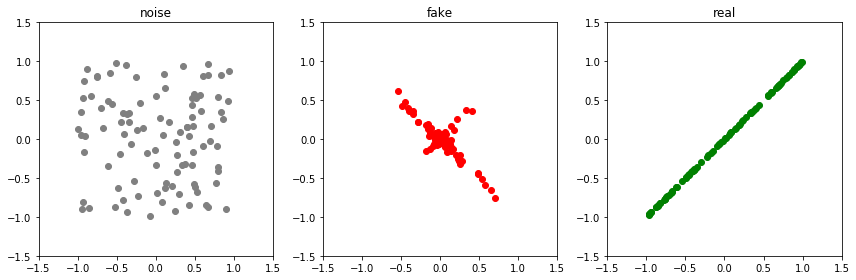

Epoch: 27100 G-error: 1.9183415174484253 D-error: 0.4311017394065857


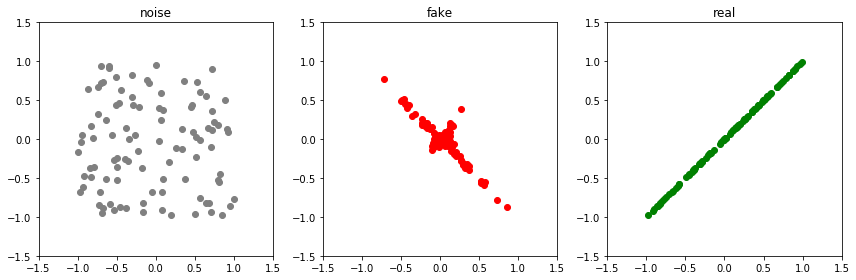

Epoch: 27150 G-error: 2.0421876907348633 D-error: 0.4529891610145569


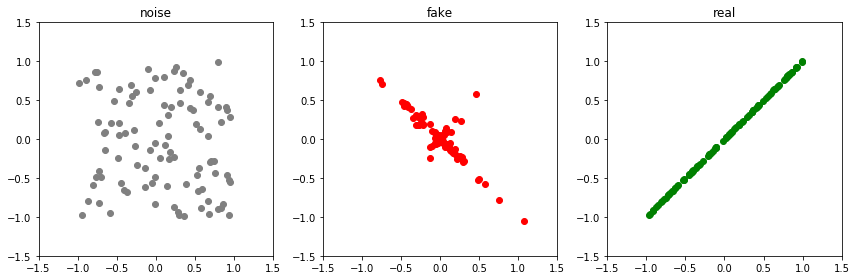

Epoch: 27200 G-error: 2.1469509601593018 D-error: 0.3827374577522278


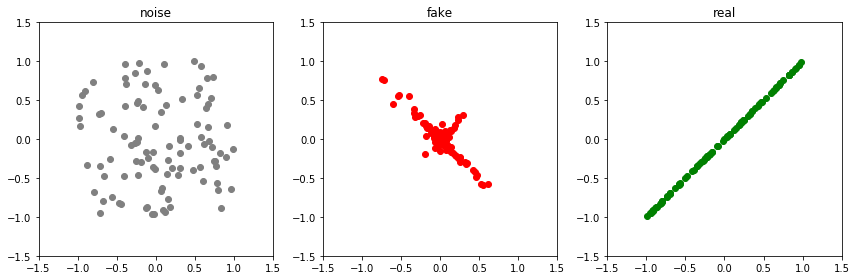

Epoch: 27250 G-error: 2.156177520751953 D-error: 0.3871110677719116


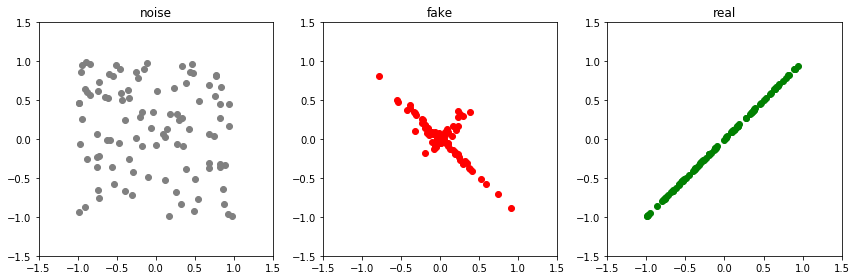

Epoch: 27300 G-error: 2.4075703620910645 D-error: 0.42393651604652405


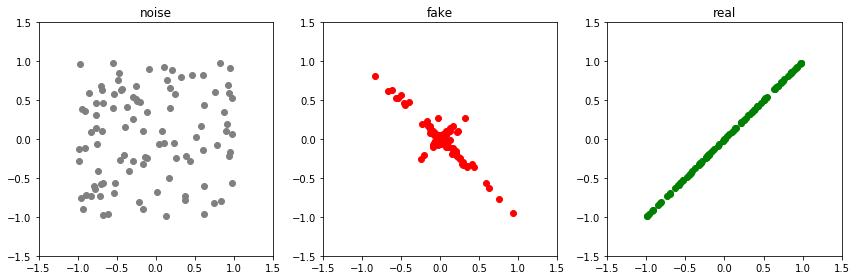

Epoch: 27350 G-error: 2.3691115379333496 D-error: 0.39892682433128357


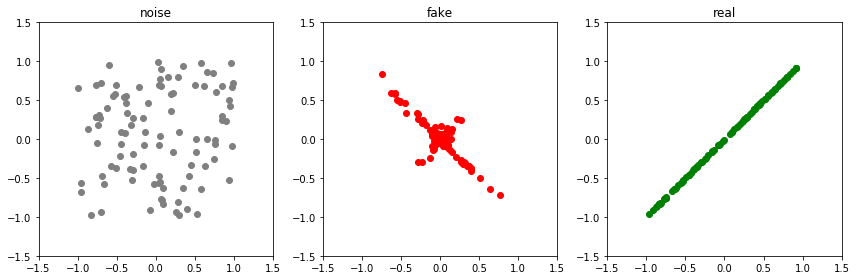

Epoch: 27400 G-error: 2.363115072250366 D-error: 0.30412548780441284


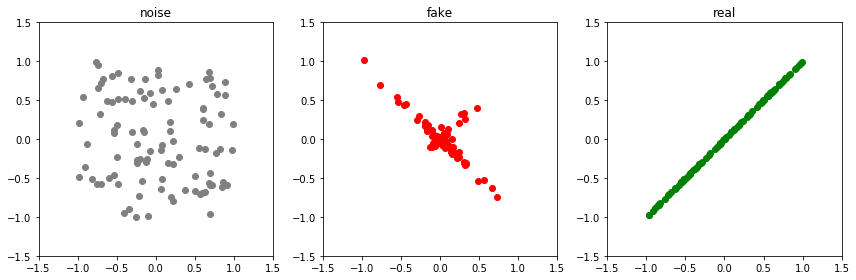

Epoch: 27450 G-error: 2.4630837440490723 D-error: 0.4205635190010071


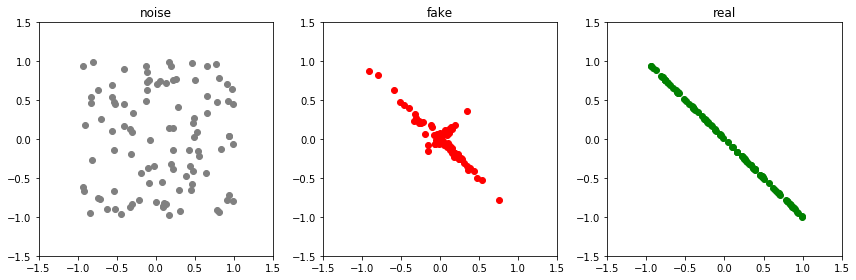

Epoch: 27500 G-error: 2.4425978660583496 D-error: 3.446762800216675


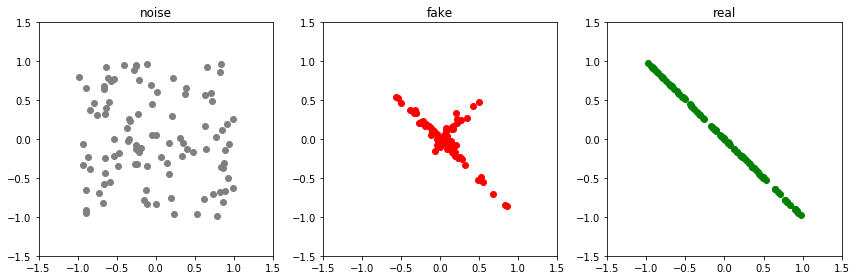

Epoch: 27550 G-error: 1.1497418880462646 D-error: 1.097435712814331


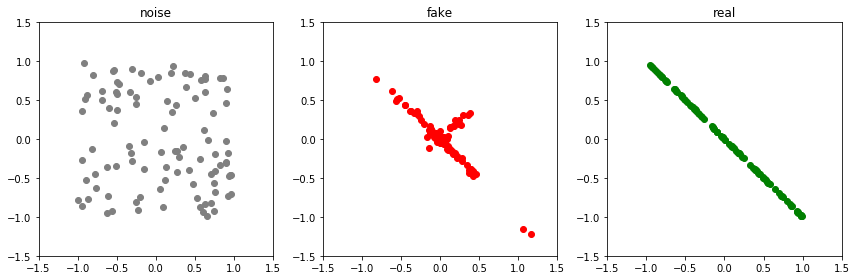

Epoch: 27600 G-error: 1.2259302139282227 D-error: 0.934890627861023


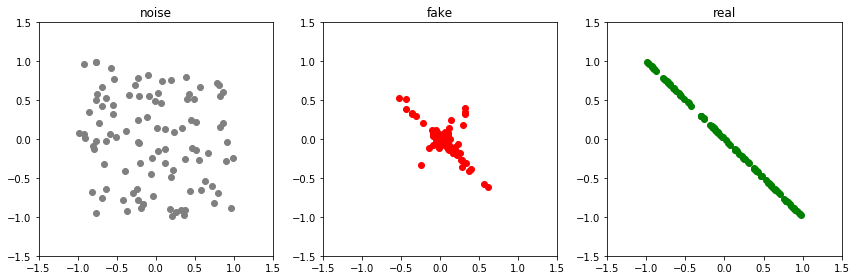

Epoch: 27650 G-error: 1.3074183464050293 D-error: 0.8594721555709839


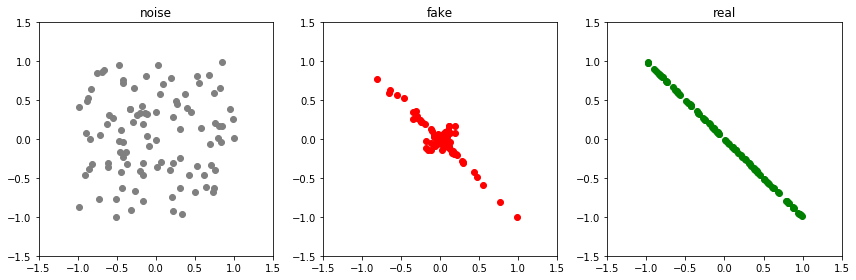

Epoch: 27700 G-error: 1.4533299207687378 D-error: 0.9464080333709717


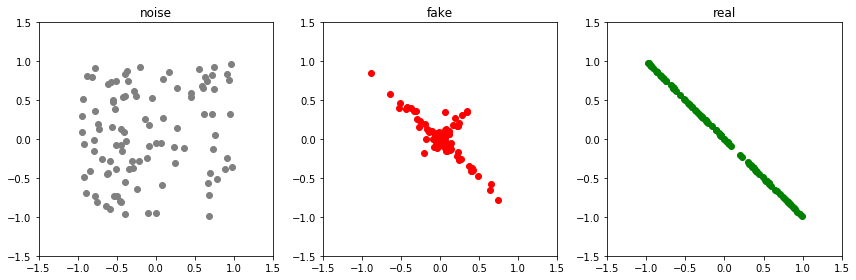

Epoch: 27750 G-error: 1.5228739976882935 D-error: 0.8335857391357422


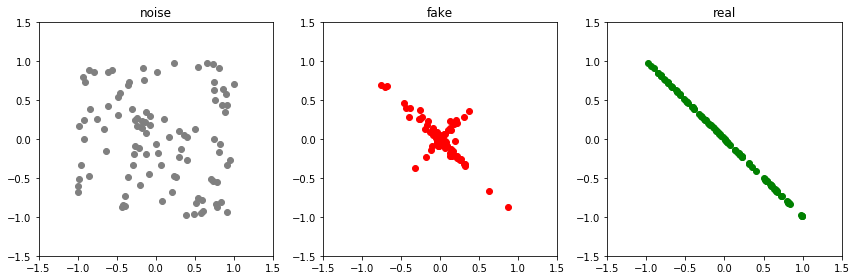

Epoch: 27800 G-error: 1.596961259841919 D-error: 0.8424912095069885


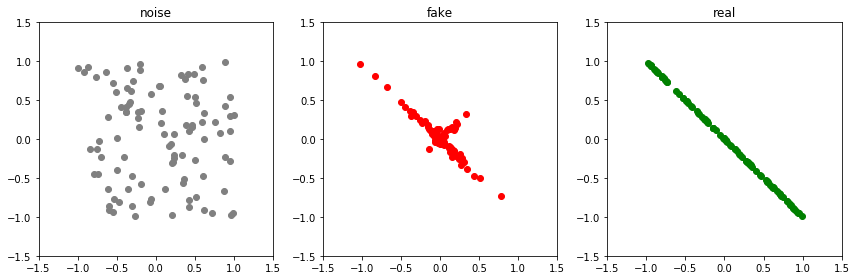

Epoch: 27850 G-error: 1.4529248476028442 D-error: 0.8342156410217285


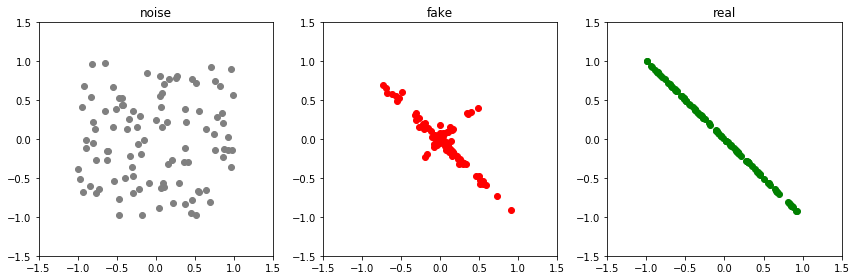

Epoch: 27900 G-error: 1.350805640220642 D-error: 1.0464116334915161


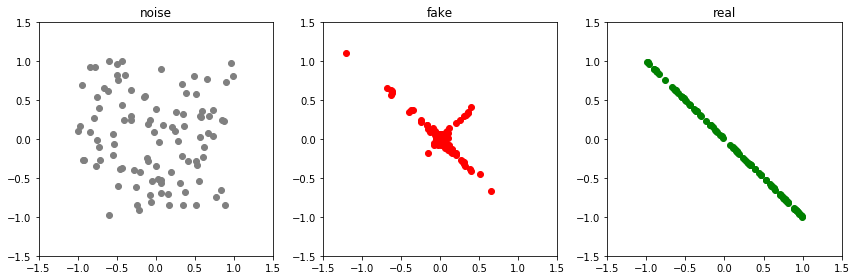

Epoch: 27950 G-error: 1.5647621154785156 D-error: 0.799565851688385


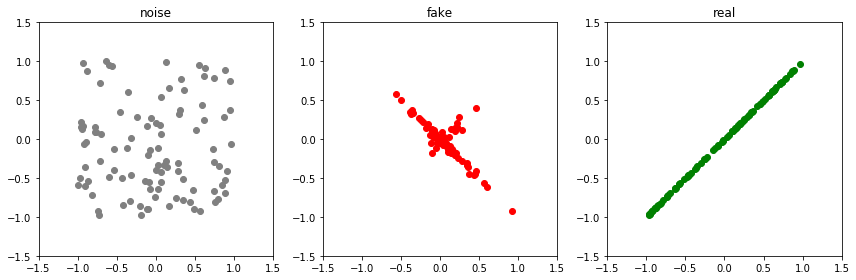

Epoch: 28000 G-error: 1.5153597593307495 D-error: 0.8765385746955872


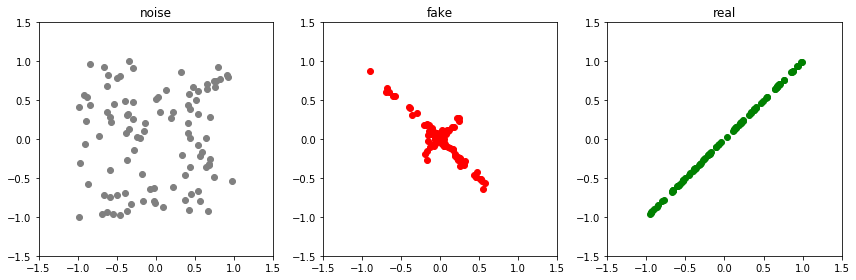

Epoch: 28050 G-error: 1.7112438678741455 D-error: 0.5217850208282471


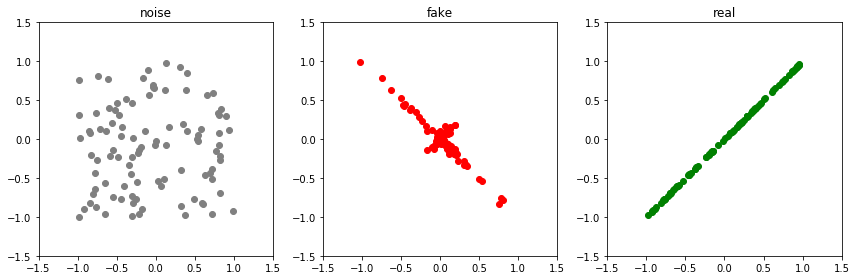

Epoch: 28100 G-error: 1.8848984241485596 D-error: 0.4354940354824066


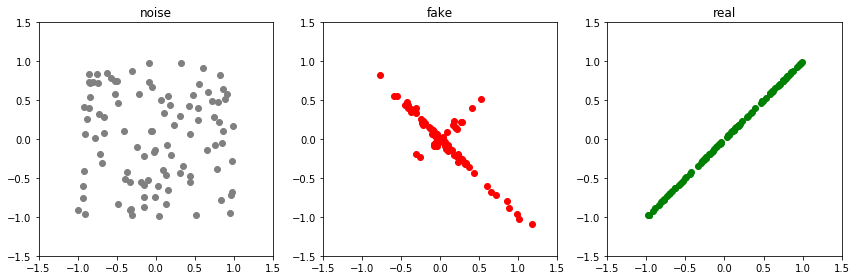

Epoch: 28150 G-error: 2.1061949729919434 D-error: 0.5439412593841553


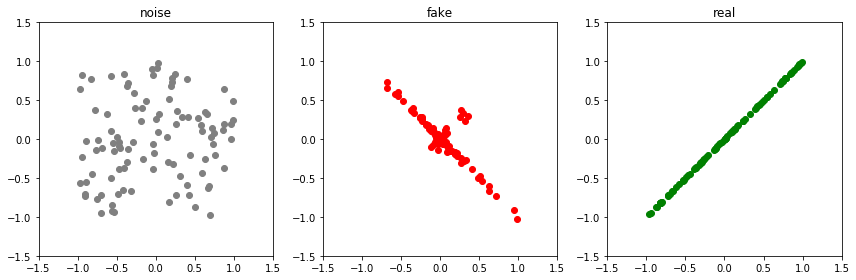

Epoch: 28200 G-error: 2.1234264373779297 D-error: 0.4747929573059082


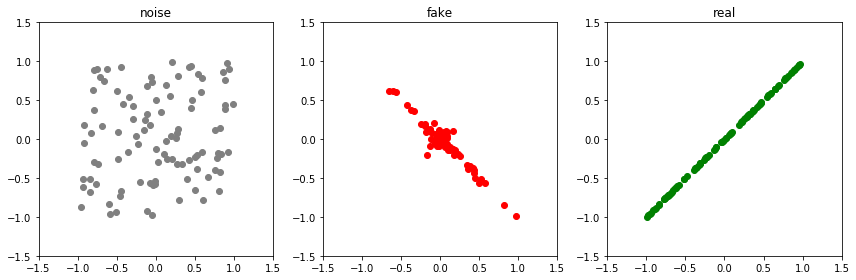

Epoch: 28250 G-error: 2.2882347106933594 D-error: 0.3620525598526001


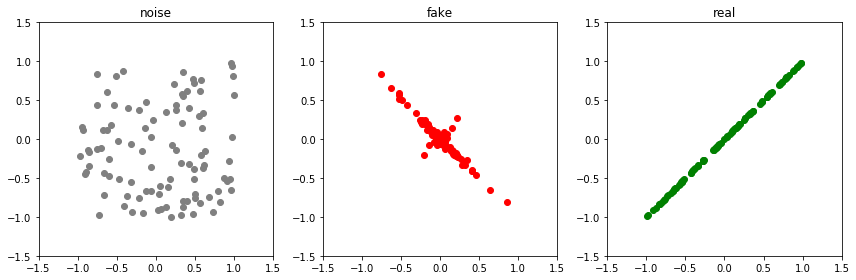

Epoch: 28300 G-error: 2.3255374431610107 D-error: 0.38626718521118164


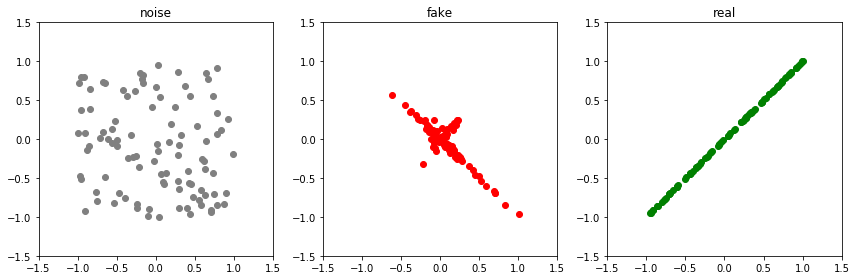

Epoch: 28350 G-error: 2.413412094116211 D-error: 0.3628600239753723


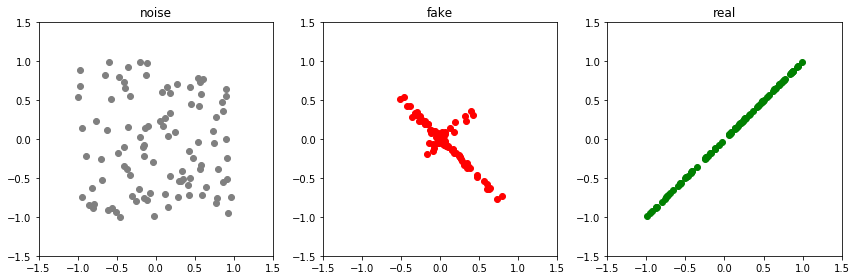

Epoch: 28400 G-error: 2.4386987686157227 D-error: 0.3318106532096863


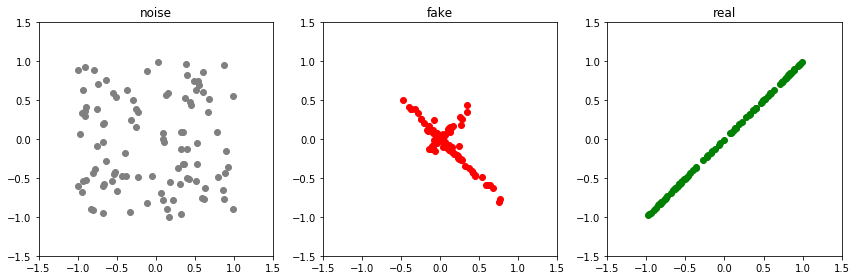

Epoch: 28450 G-error: 2.5716261863708496 D-error: 0.3392217755317688


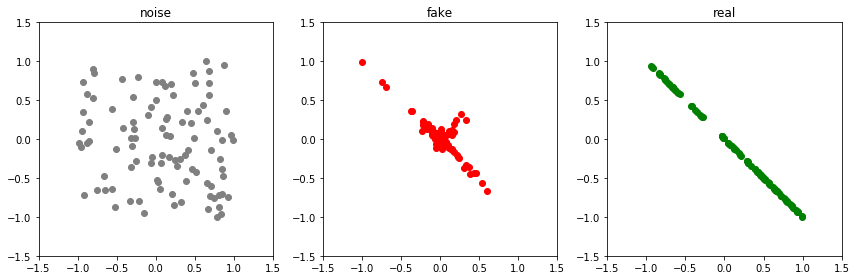

Epoch: 28500 G-error: 2.44175386428833 D-error: 3.5726733207702637


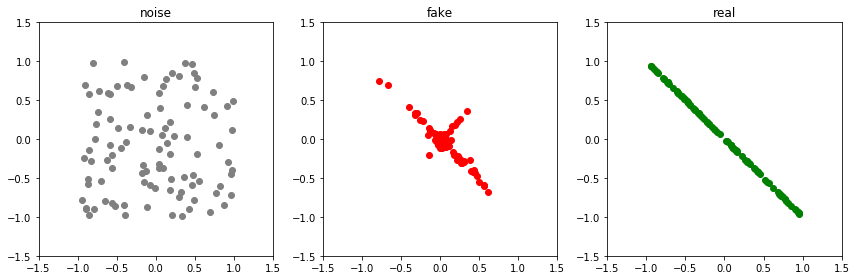

Epoch: 28550 G-error: 1.136397361755371 D-error: 1.0112473964691162


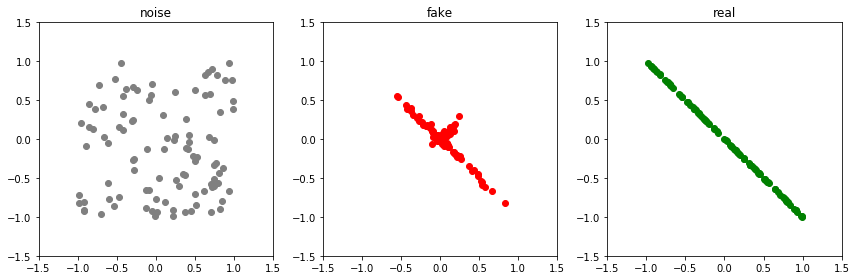

Epoch: 28600 G-error: 1.2712074518203735 D-error: 1.002089023590088


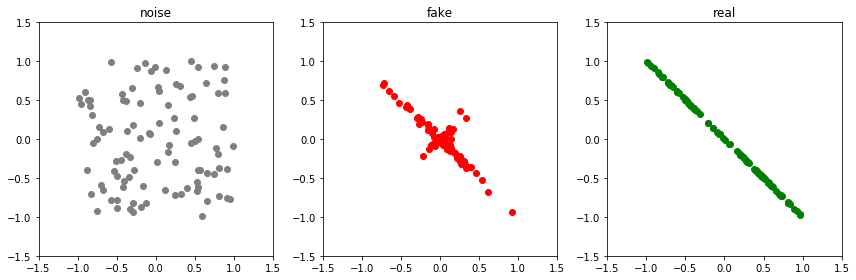

Epoch: 28650 G-error: 1.4154919385910034 D-error: 0.9263449907302856


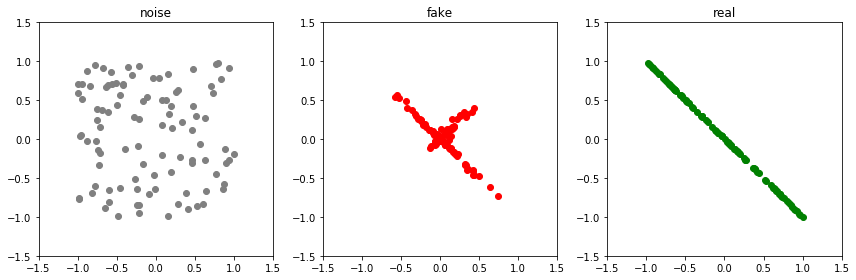

Epoch: 28700 G-error: 1.4359962940216064 D-error: 0.920286238193512


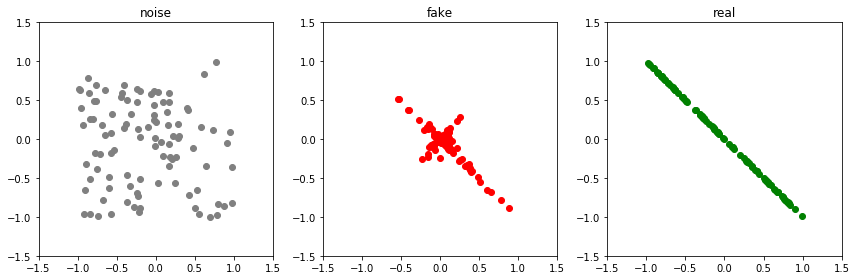

Epoch: 28750 G-error: 1.452608585357666 D-error: 0.9039716720581055


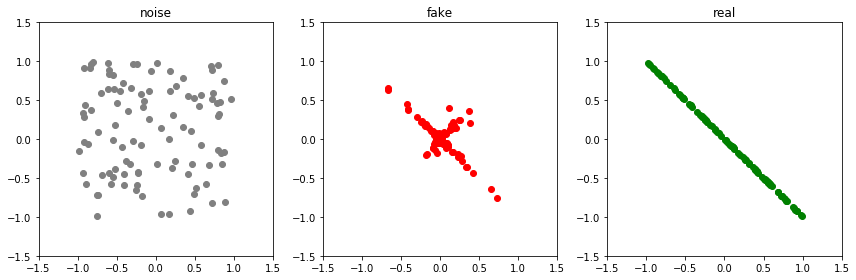

Epoch: 28800 G-error: 1.5502383708953857 D-error: 0.7897055149078369


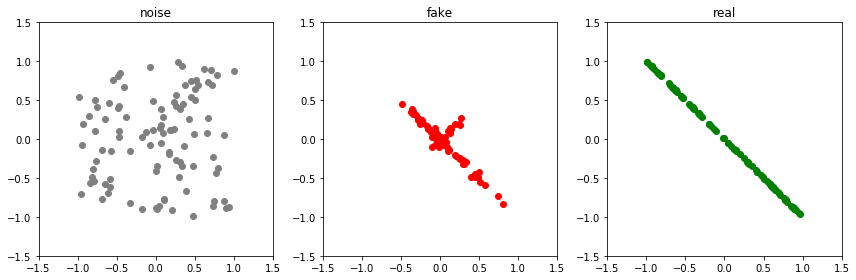

Epoch: 28850 G-error: 1.5718737840652466 D-error: 0.7332656979560852


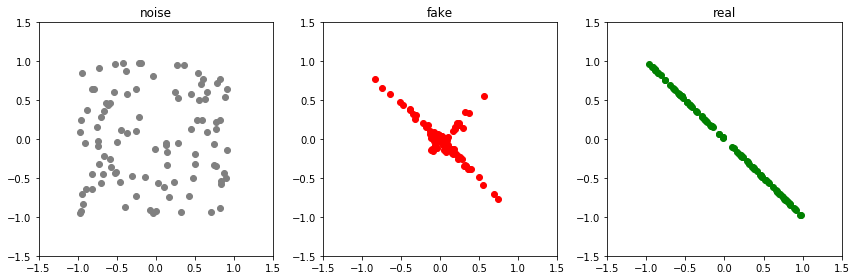

Epoch: 28900 G-error: 1.460514783859253 D-error: 0.7812739610671997


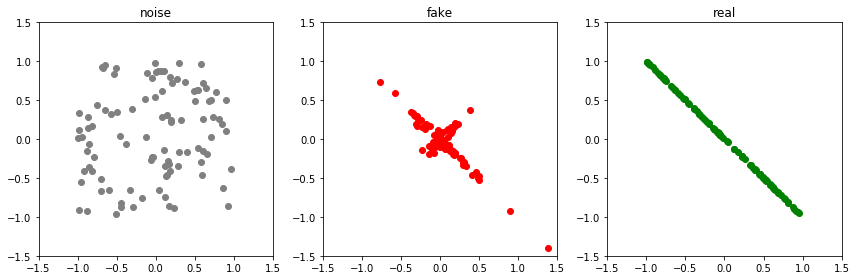

Epoch: 28950 G-error: 1.5291922092437744 D-error: 0.8499859571456909


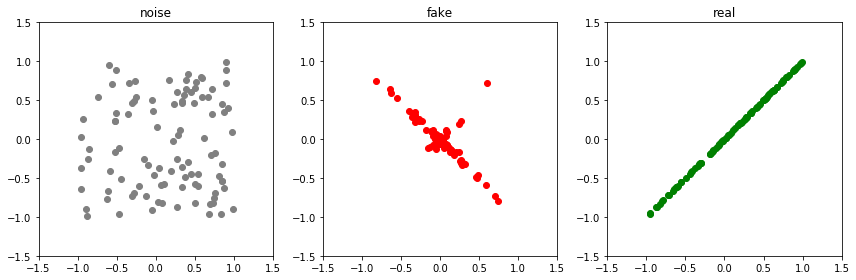

Epoch: 29000 G-error: 1.3998013734817505 D-error: 1.2577145099639893


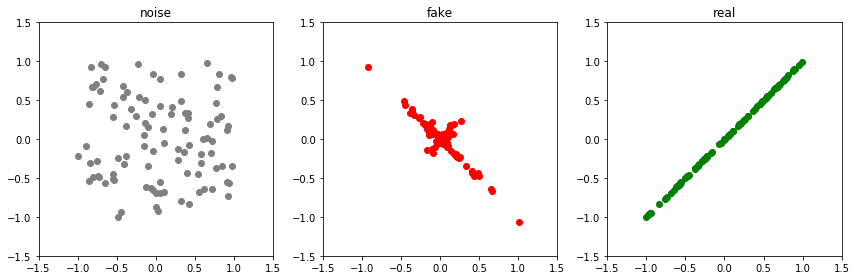

Epoch: 29050 G-error: 1.6148879528045654 D-error: 0.5701785087585449


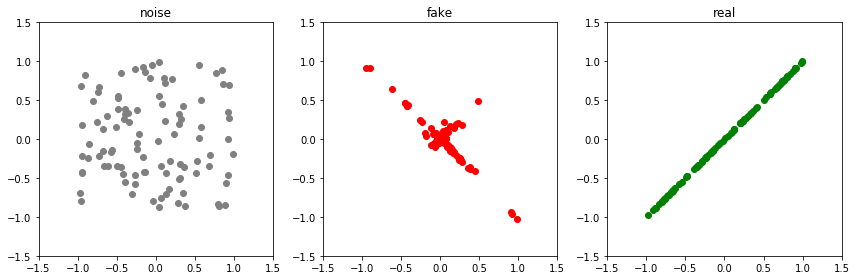

Epoch: 29100 G-error: 1.877769947052002 D-error: 0.4694473445415497


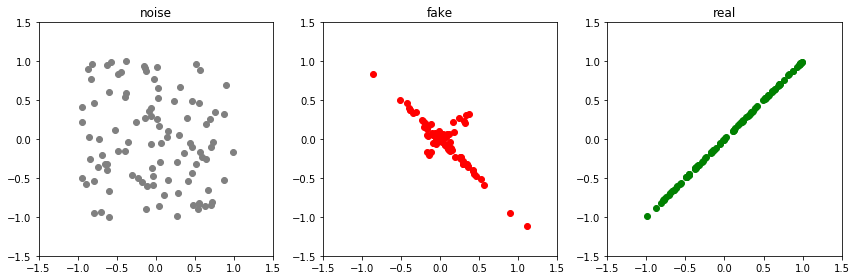

Epoch: 29150 G-error: 2.09000301361084 D-error: 0.42951881885528564


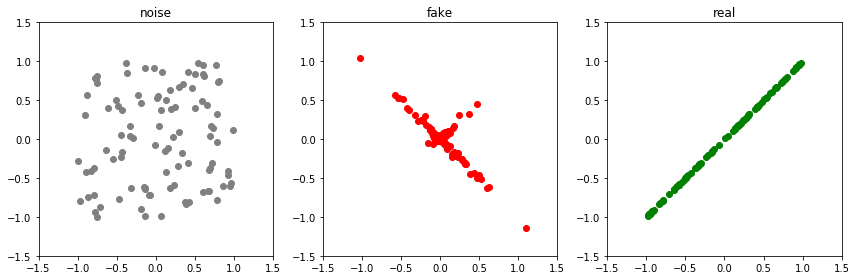

Epoch: 29200 G-error: 2.0880579948425293 D-error: 0.3813696503639221


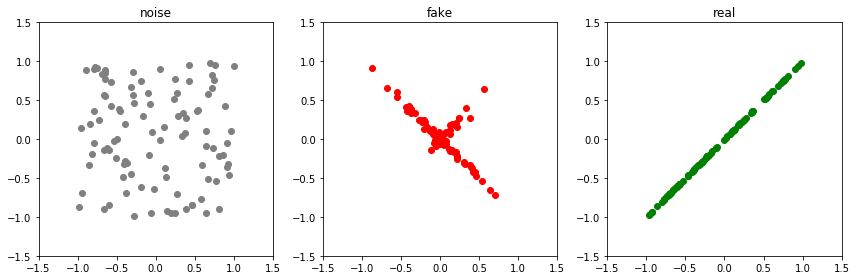

Epoch: 29250 G-error: 2.059242010116577 D-error: 0.43783318996429443


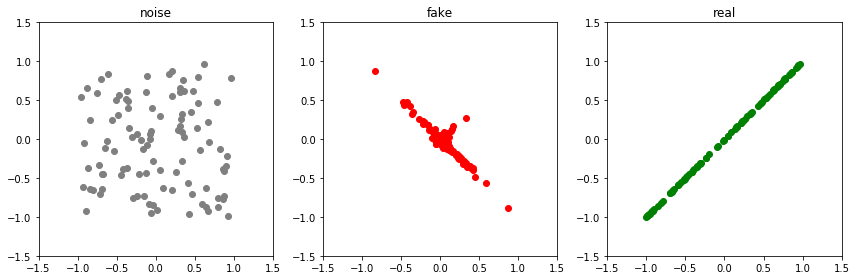

Epoch: 29300 G-error: 2.292684316635132 D-error: 0.30529677867889404


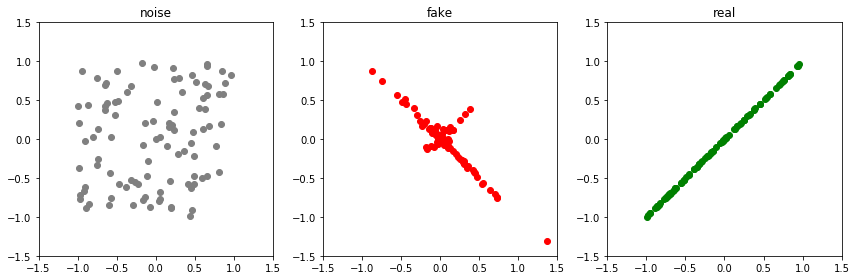

Epoch: 29350 G-error: 2.2457611560821533 D-error: 0.41739630699157715


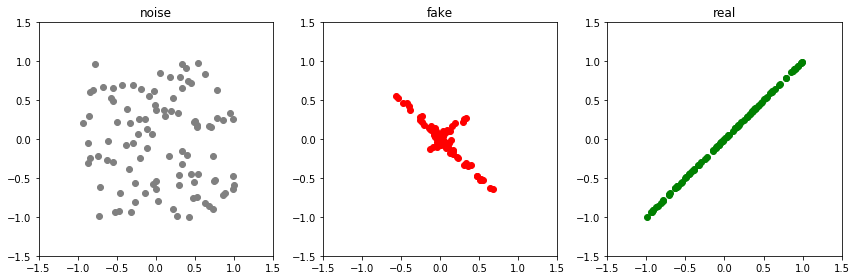

Epoch: 29400 G-error: 2.412219762802124 D-error: 0.4158232510089874


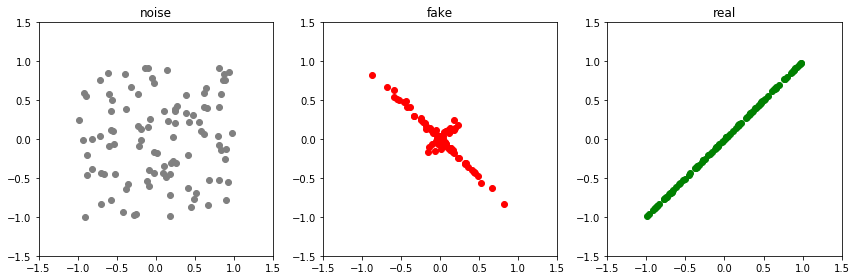

Epoch: 29450 G-error: 2.346263885498047 D-error: 0.3848647475242615


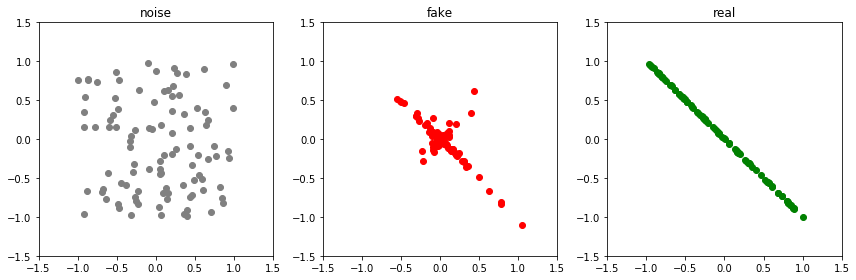

Epoch: 29500 G-error: 2.393892765045166 D-error: 3.4431004524230957


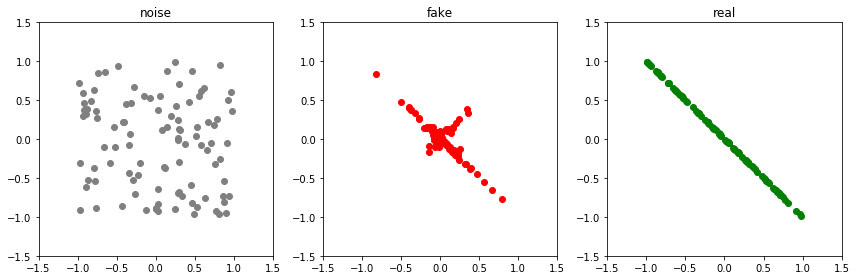

Epoch: 29550 G-error: 1.019345760345459 D-error: 1.0843216180801392


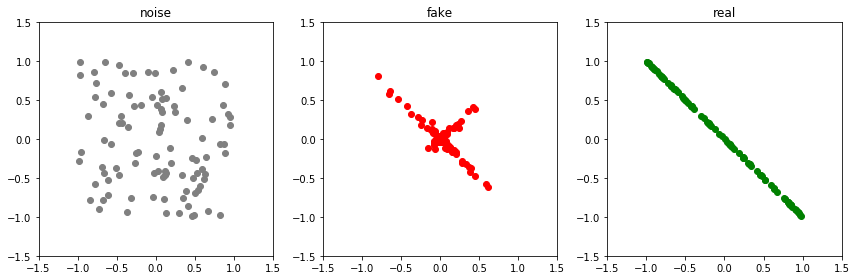

Epoch: 29600 G-error: 1.312900185585022 D-error: 0.793117880821228


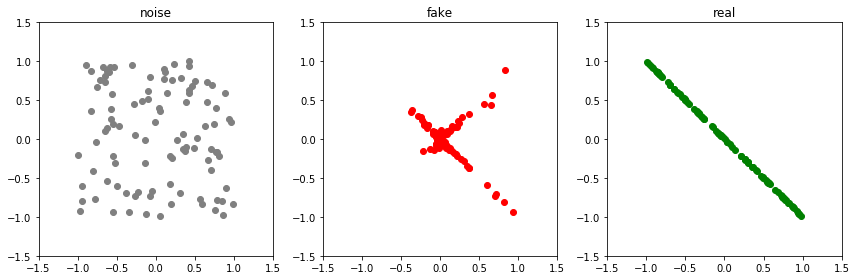

Epoch: 29650 G-error: 1.3218858242034912 D-error: 0.9175219535827637


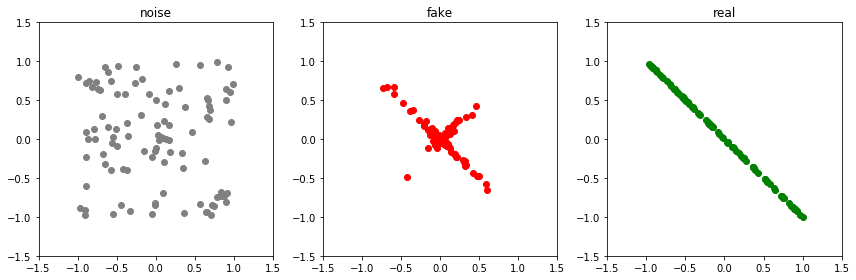

Epoch: 29700 G-error: 1.4448601007461548 D-error: 0.9189344048500061


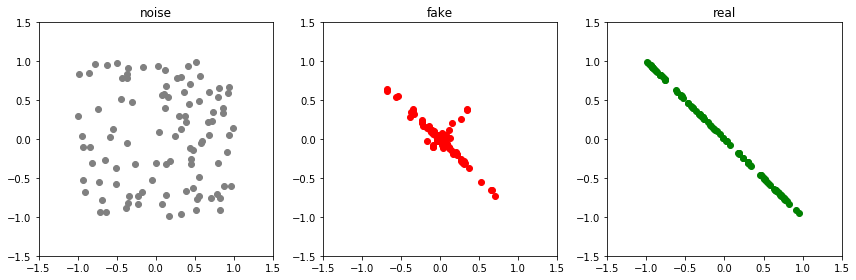

Epoch: 29750 G-error: 1.4937934875488281 D-error: 0.7978184223175049


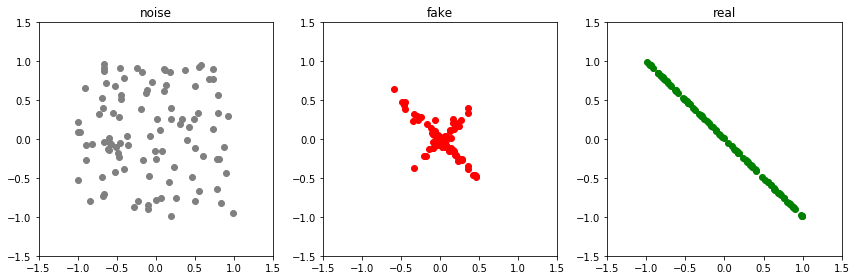

Epoch: 29800 G-error: 1.571962594985962 D-error: 0.8264917135238647


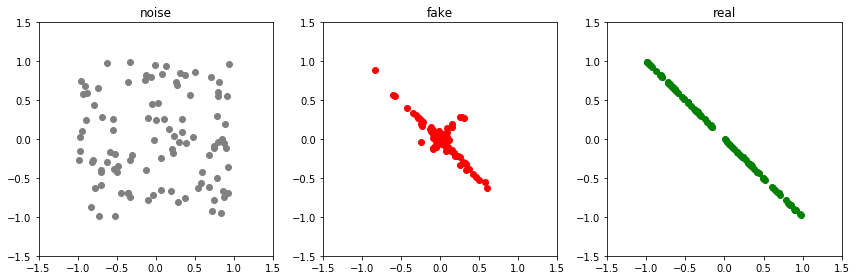

Epoch: 29850 G-error: 1.5749341249465942 D-error: 0.7599211931228638


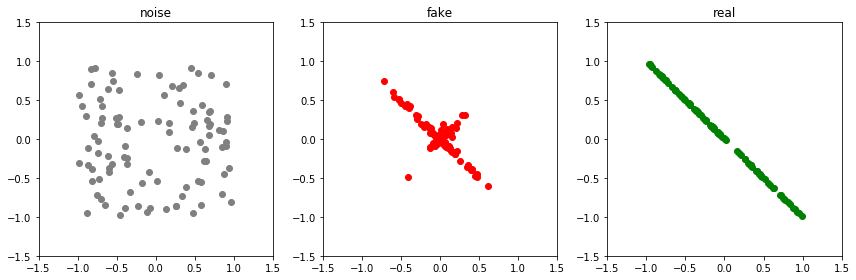

Epoch: 29900 G-error: 1.393609881401062 D-error: 0.963834285736084


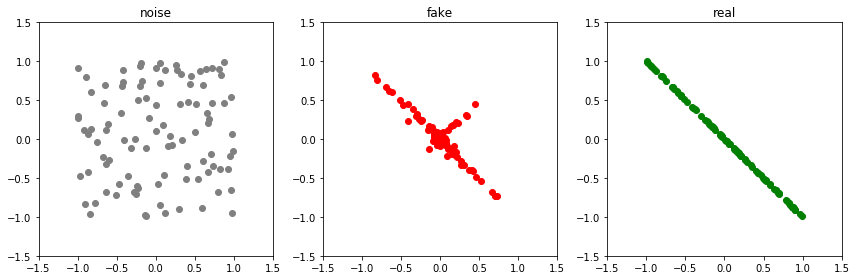

Epoch: 29950 G-error: 1.4620344638824463 D-error: 0.9384555220603943


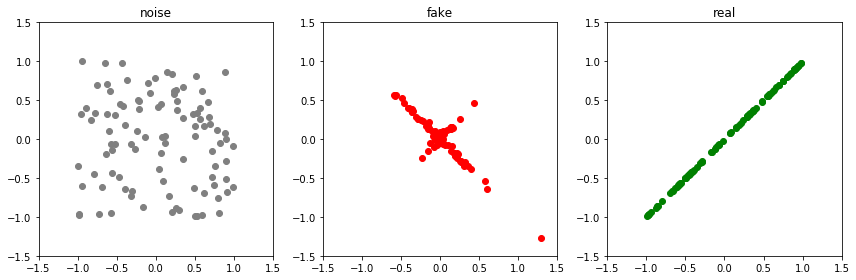

Epoch: 30000 G-error: 1.3531296253204346 D-error: 1.1356998682022095


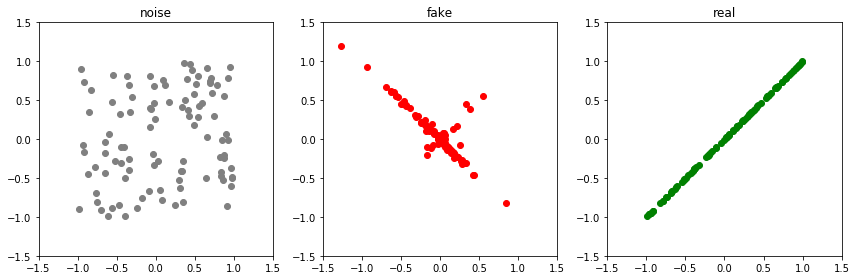

Epoch: 30050 G-error: 1.6877152919769287 D-error: 0.6901134252548218


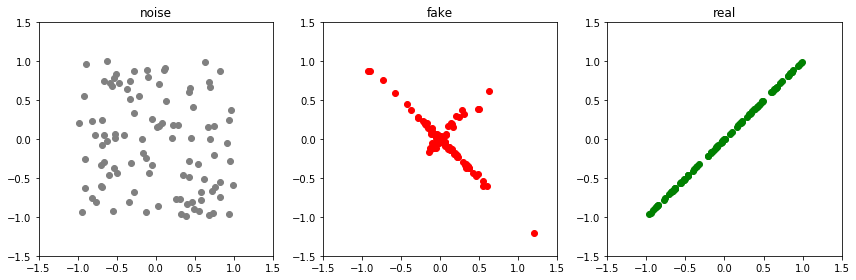

Epoch: 30100 G-error: 1.8397985696792603 D-error: 0.6029000282287598


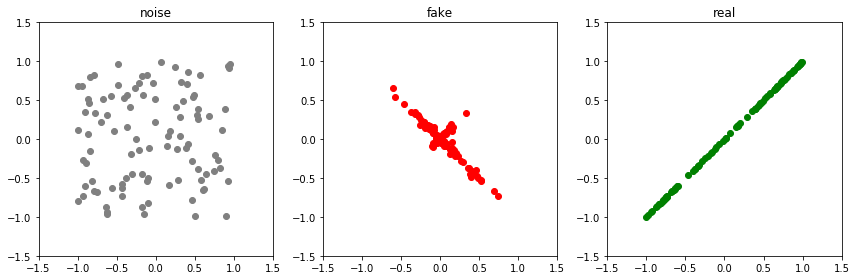

Epoch: 30150 G-error: 1.9358947277069092 D-error: 0.37773120403289795


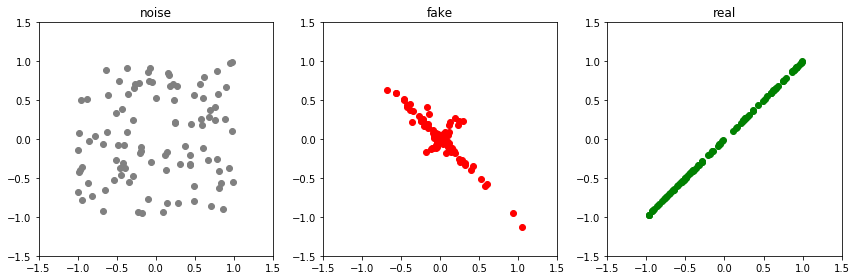

Epoch: 30200 G-error: 2.176112651824951 D-error: 0.3754462003707886


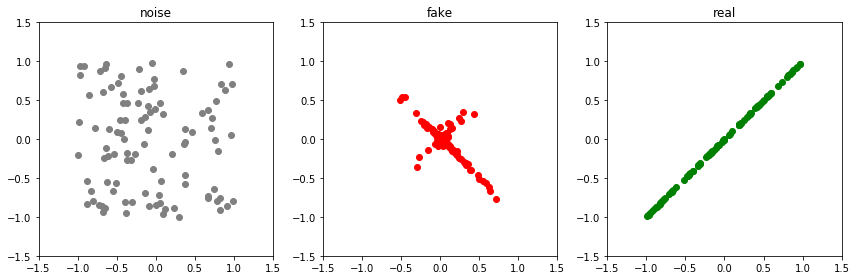

Epoch: 30250 G-error: 2.0709009170532227 D-error: 0.48343318700790405


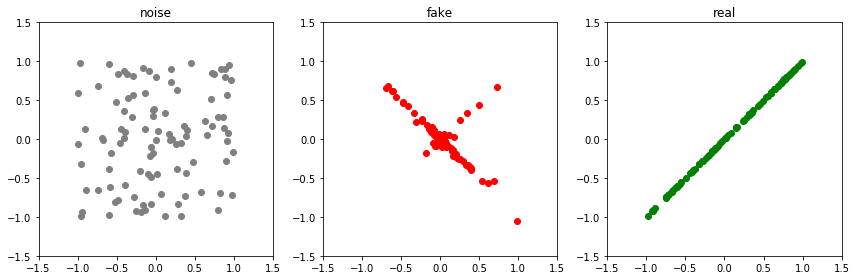

Epoch: 30300 G-error: 2.081742286682129 D-error: 0.41289424896240234


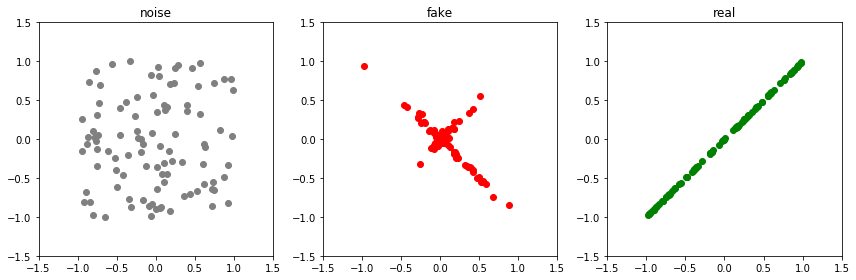

Epoch: 30350 G-error: 2.2777695655822754 D-error: 0.4511389136314392


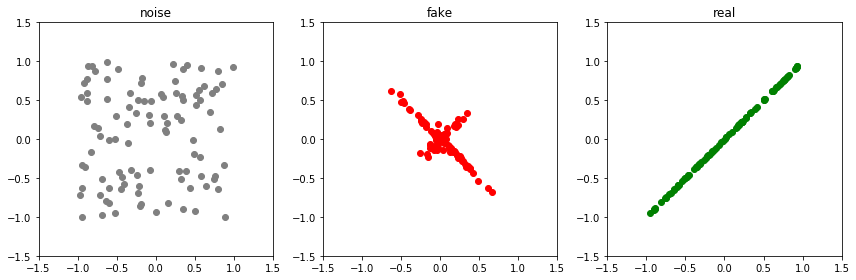

Epoch: 30400 G-error: 2.2543160915374756 D-error: 0.40360045433044434


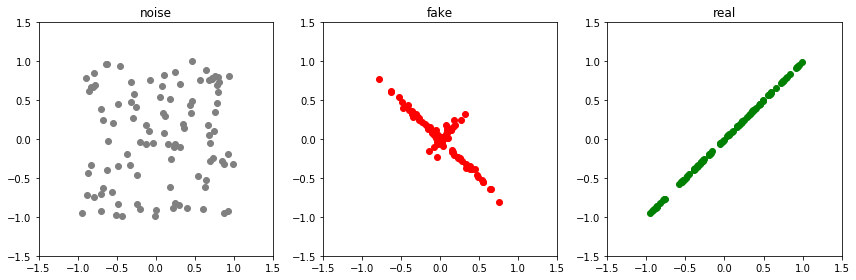

Epoch: 30450 G-error: 2.202683448791504 D-error: 0.374856173992157


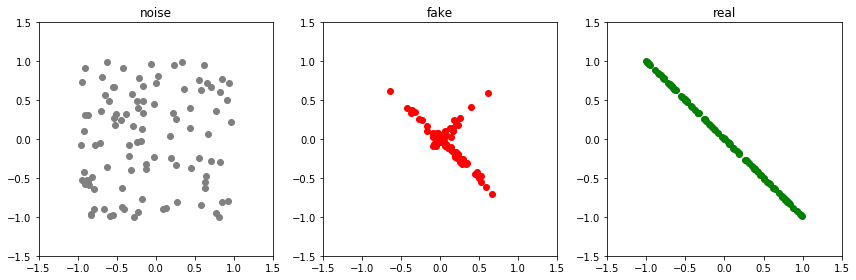

Epoch: 30500 G-error: 2.3507566452026367 D-error: 3.5512871742248535


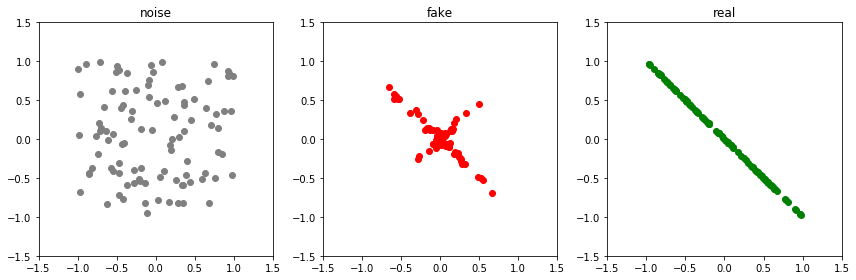

Epoch: 30550 G-error: 1.0032362937927246 D-error: 1.0922095775604248


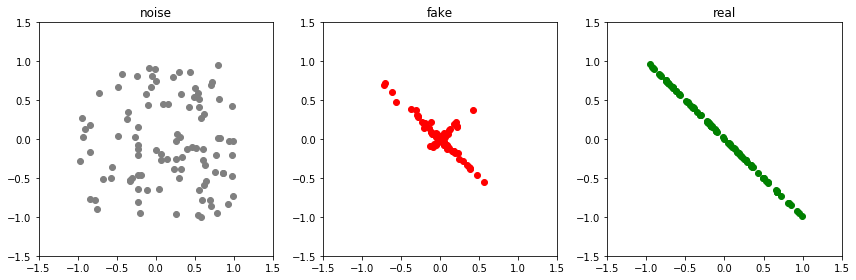

Epoch: 30600 G-error: 1.3233026266098022 D-error: 1.0049026012420654


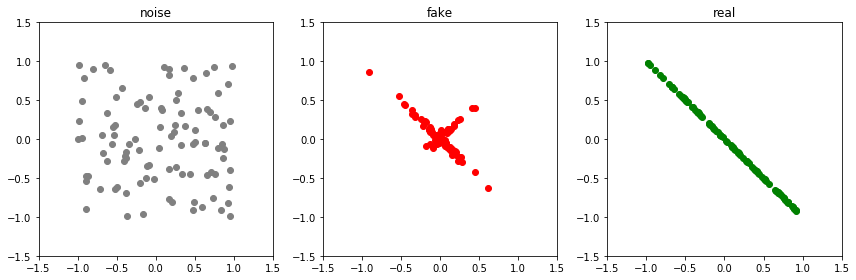

Epoch: 30650 G-error: 1.3952152729034424 D-error: 0.8523964285850525


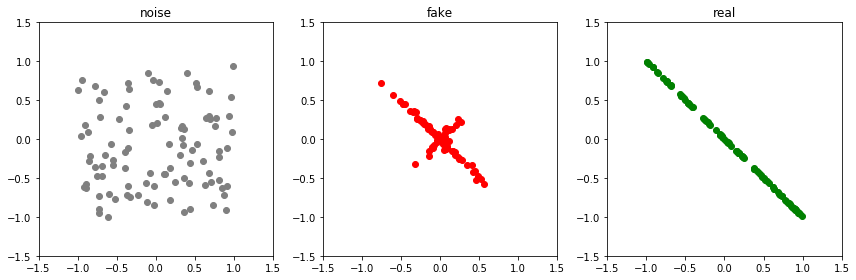

Epoch: 30700 G-error: 1.4322351217269897 D-error: 0.927273154258728


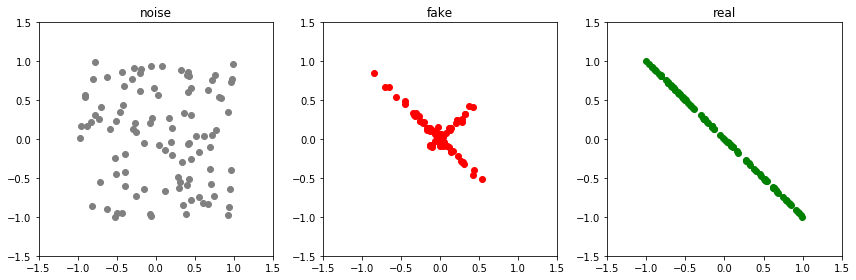

Epoch: 30750 G-error: 1.480721116065979 D-error: 0.7968562245368958


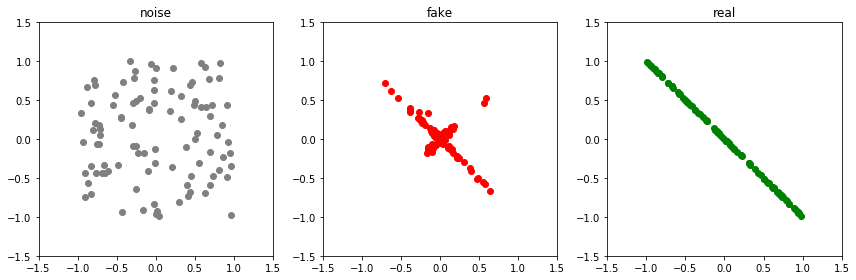

Epoch: 30800 G-error: 1.4622578620910645 D-error: 0.89176344871521


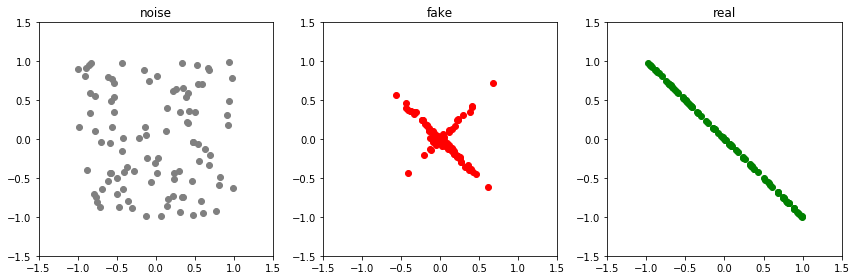

Epoch: 30850 G-error: 1.5829403400421143 D-error: 0.8954133987426758


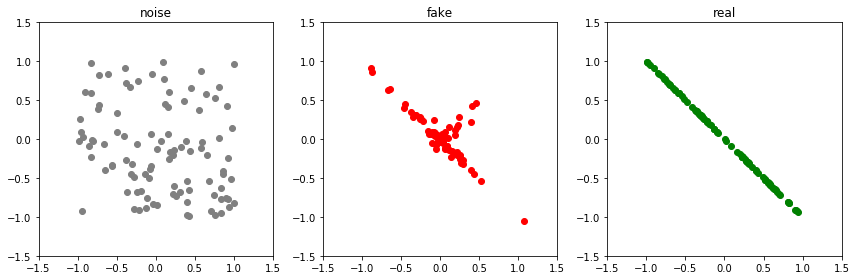

Epoch: 30900 G-error: 1.4728223085403442 D-error: 0.8110101222991943


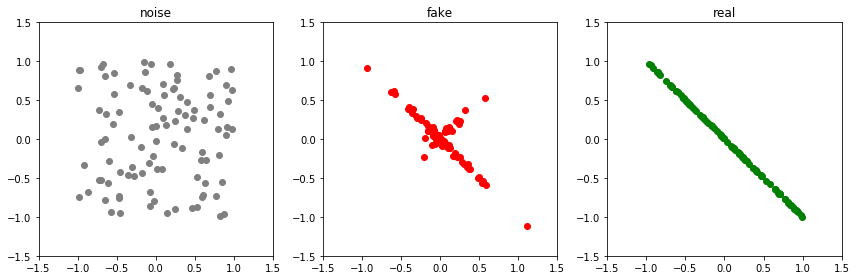

Epoch: 30950 G-error: 1.649977207183838 D-error: 0.8882224559783936


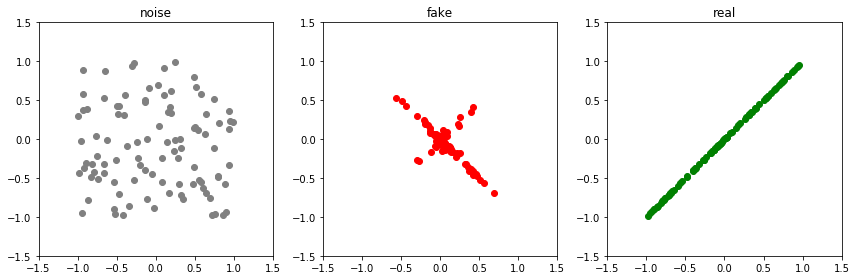

Epoch: 31000 G-error: 1.5746418237686157 D-error: 1.332207202911377


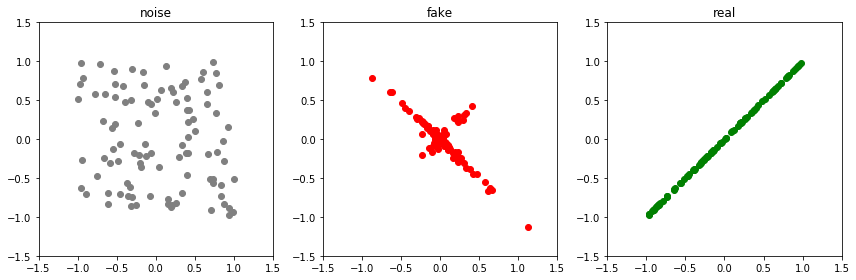

Epoch: 31050 G-error: 1.7097837924957275 D-error: 0.6574512720108032


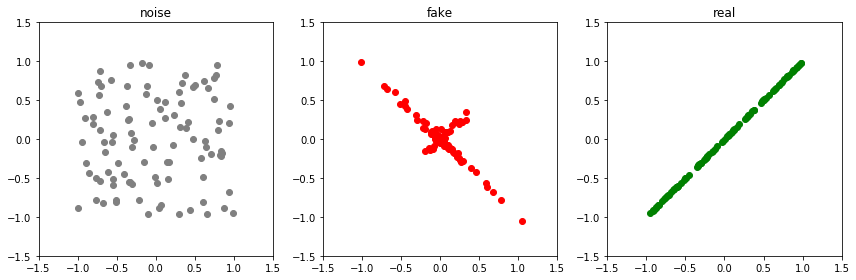

Epoch: 31100 G-error: 1.7231959104537964 D-error: 0.49167686700820923


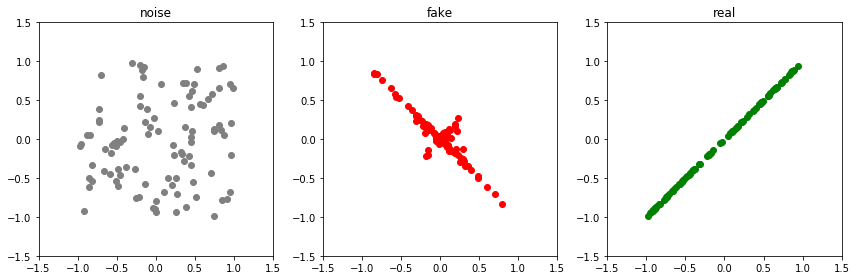

Epoch: 31150 G-error: 1.8580540418624878 D-error: 0.37905681133270264


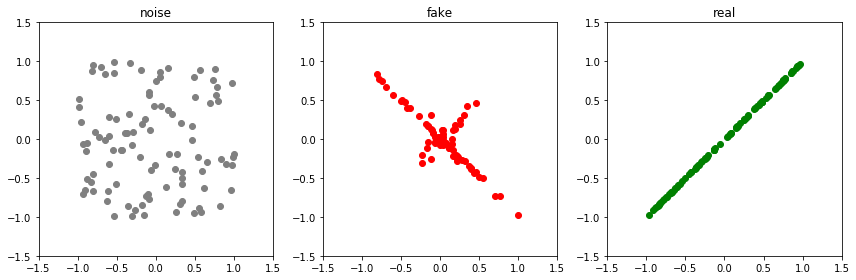

Epoch: 31200 G-error: 2.0393130779266357 D-error: 0.4738866984844208


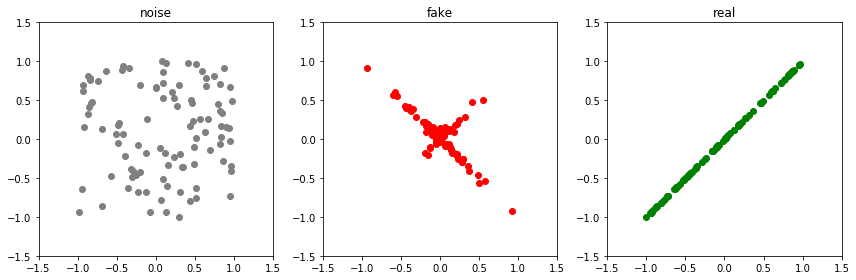

Epoch: 31250 G-error: 2.094296932220459 D-error: 0.5116549730300903


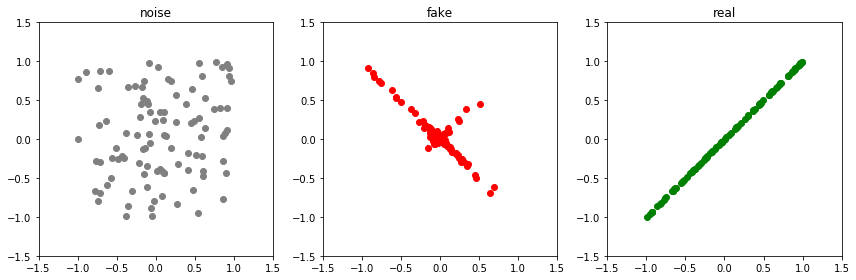

Epoch: 31300 G-error: 2.211035966873169 D-error: 0.4147237539291382


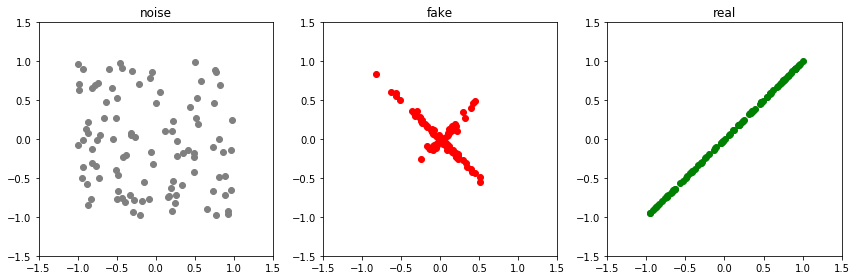

Epoch: 31350 G-error: 2.2628173828125 D-error: 0.4839403033256531


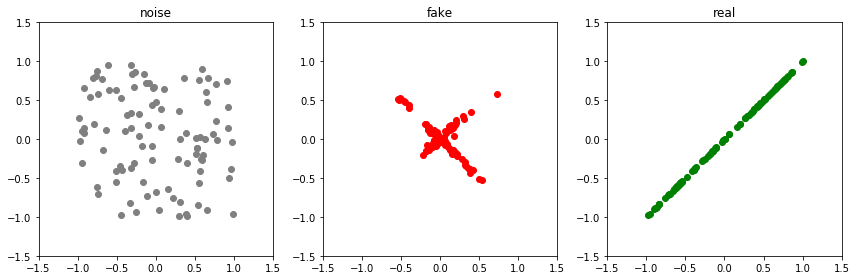

Epoch: 31400 G-error: 2.1044414043426514 D-error: 0.3807617425918579


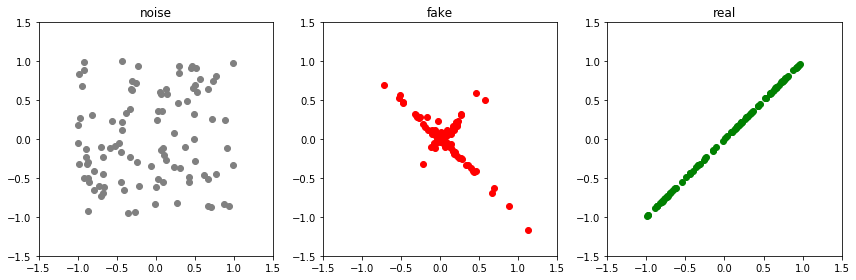

Epoch: 31450 G-error: 2.2494633197784424 D-error: 0.40099310874938965


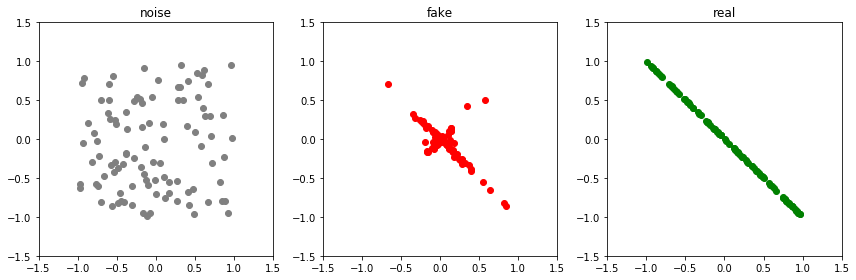

Epoch: 31500 G-error: 2.3031399250030518 D-error: 3.564069986343384


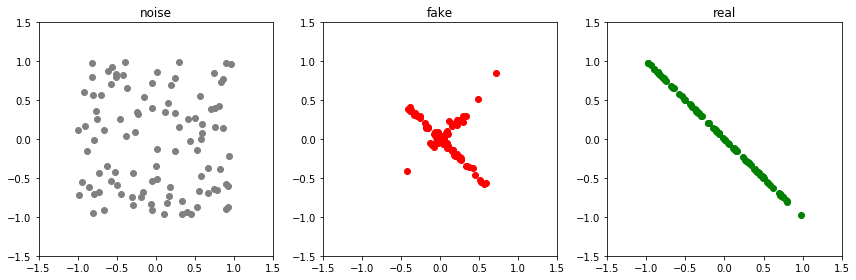

Epoch: 31550 G-error: 1.0784389972686768 D-error: 1.1835641860961914


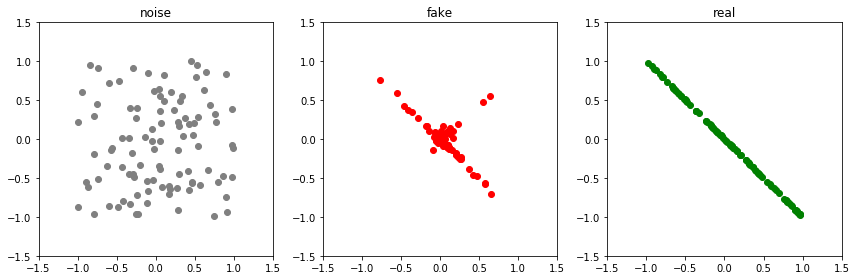

Epoch: 31600 G-error: 1.4434973001480103 D-error: 1.117889642715454


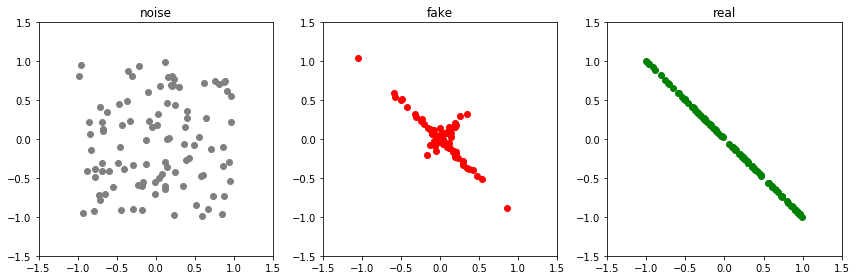

Epoch: 31650 G-error: 1.4568531513214111 D-error: 0.890204906463623


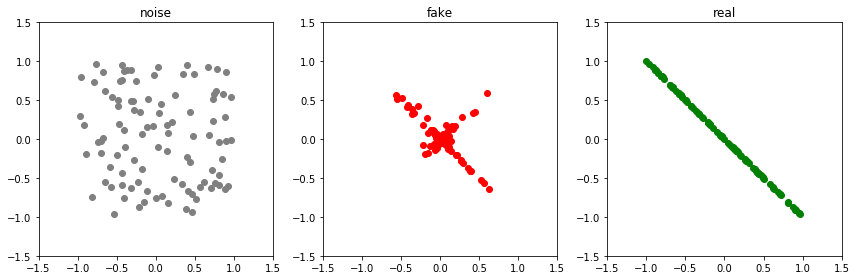

Epoch: 31700 G-error: 1.4085402488708496 D-error: 0.8401252031326294


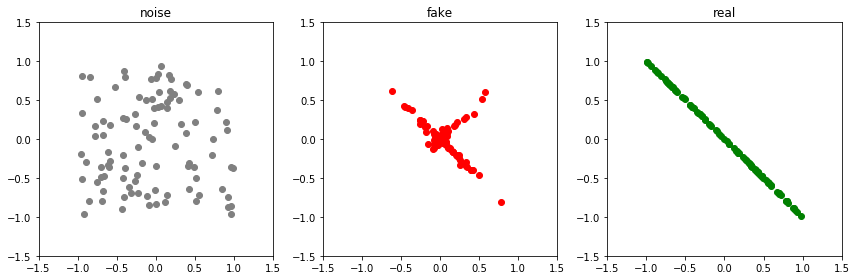

Epoch: 31750 G-error: 1.627261757850647 D-error: 0.7673882246017456


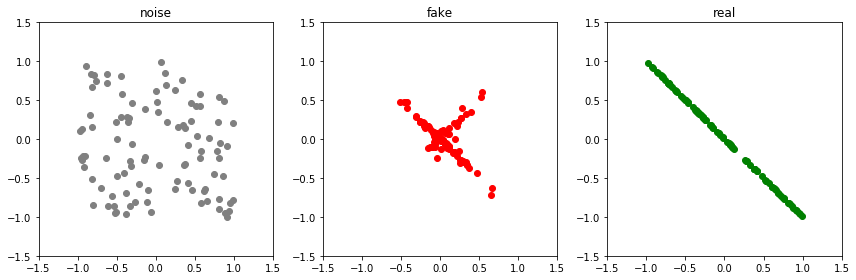

Epoch: 31800 G-error: 1.6025967597961426 D-error: 0.8803539872169495


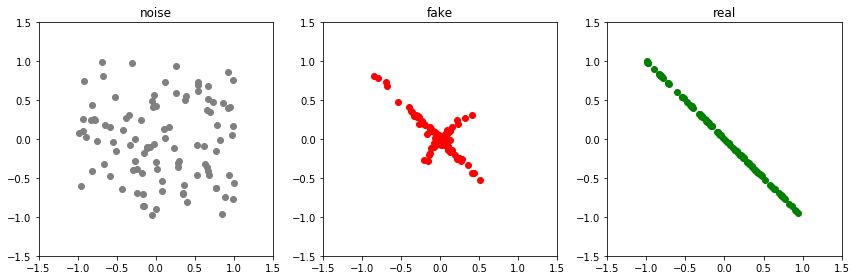

Epoch: 31850 G-error: 1.5952457189559937 D-error: 0.8924139738082886


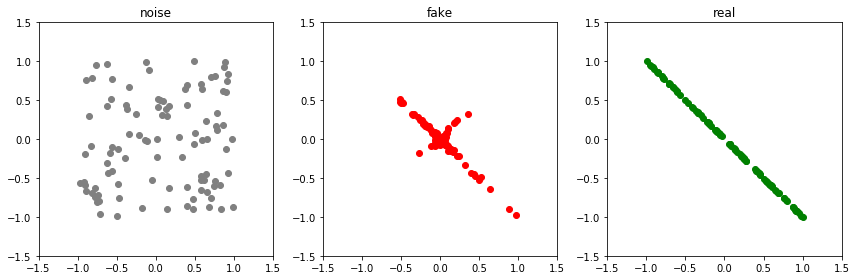

Epoch: 31900 G-error: 1.538601040840149 D-error: 0.8517842888832092


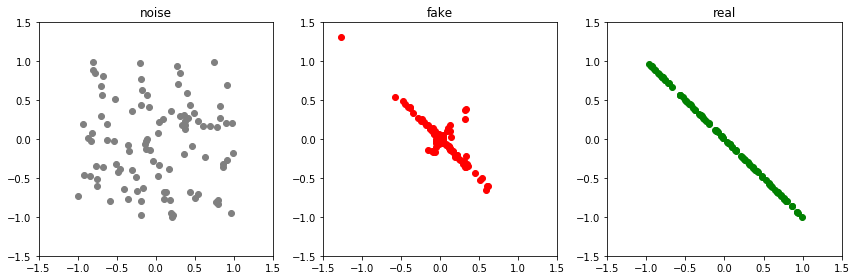

Epoch: 31950 G-error: 1.5573298931121826 D-error: 0.8683072328567505


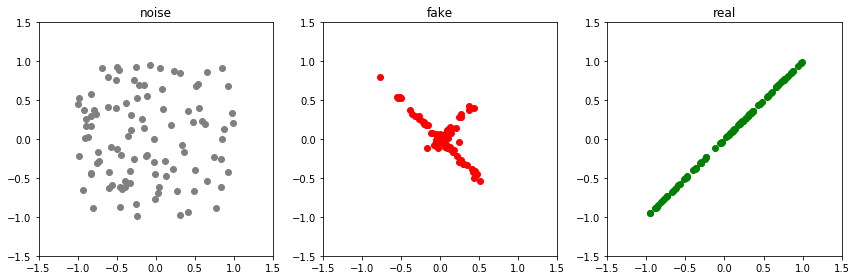

Epoch: 32000 G-error: 1.5850869417190552 D-error: 1.5293059349060059


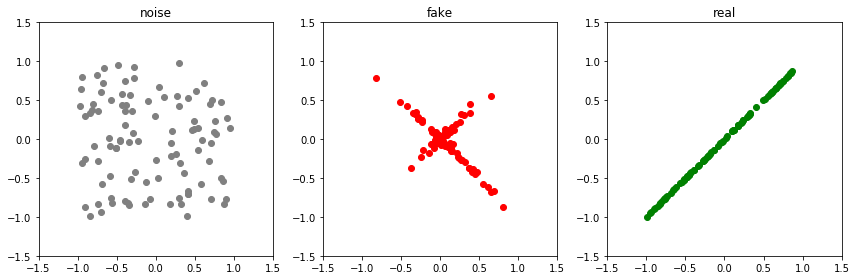

Epoch: 32050 G-error: 1.6298928260803223 D-error: 0.7250831127166748


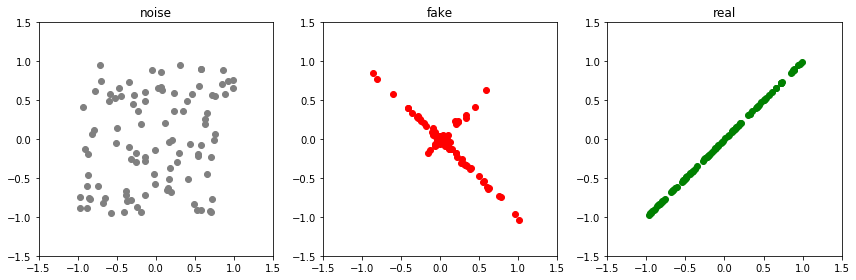

Epoch: 32100 G-error: 1.761359691619873 D-error: 0.6133291721343994


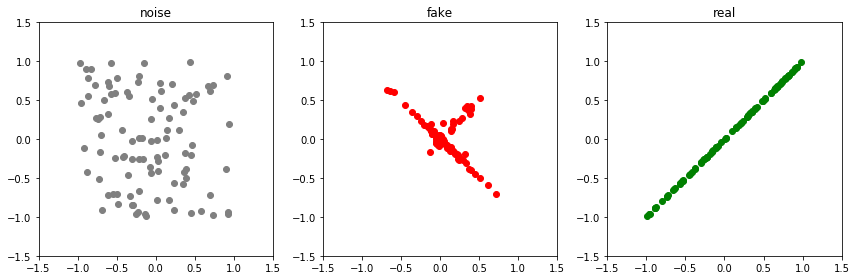

Epoch: 32150 G-error: 1.8020925521850586 D-error: 0.5035313367843628


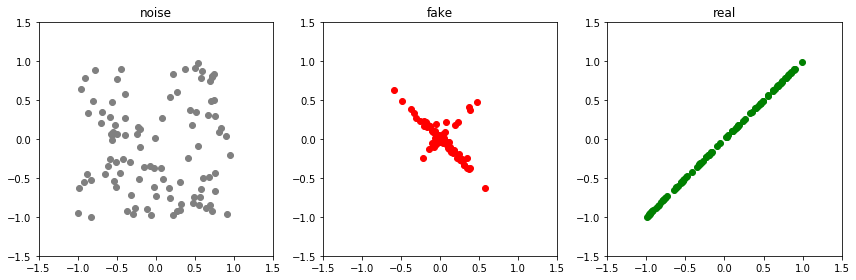

Epoch: 32200 G-error: 2.0438039302825928 D-error: 0.4711400270462036


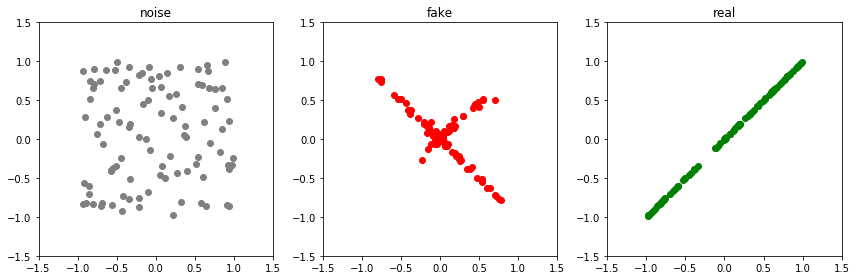

Epoch: 32250 G-error: 2.0765955448150635 D-error: 0.637384295463562


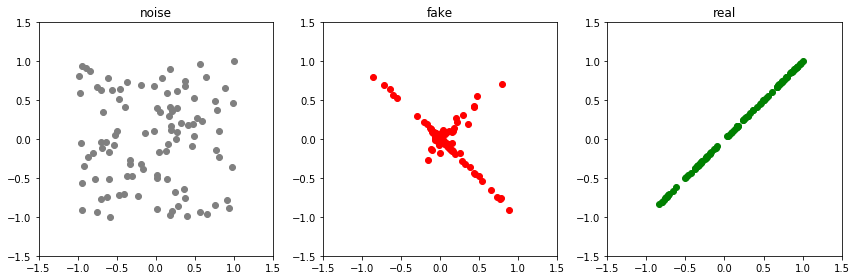

Epoch: 32300 G-error: 2.186025619506836 D-error: 0.4445880949497223


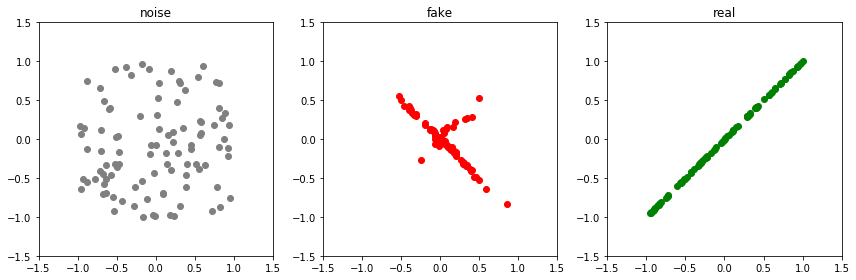

Epoch: 32350 G-error: 2.2046706676483154 D-error: 0.4185329079627991


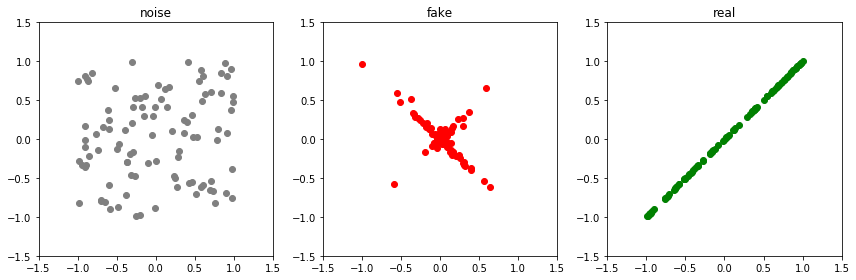

Epoch: 32400 G-error: 2.227250099182129 D-error: 0.4113692045211792


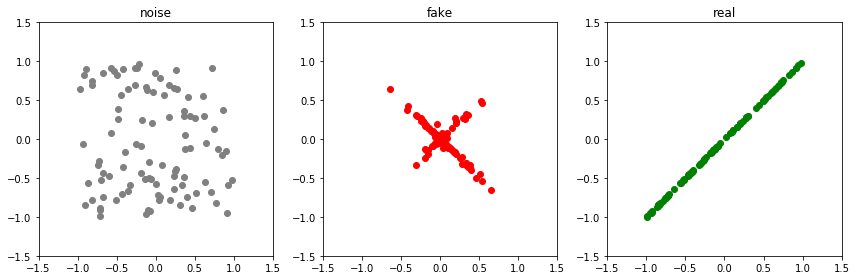

Epoch: 32450 G-error: 2.4360570907592773 D-error: 0.4559715688228607


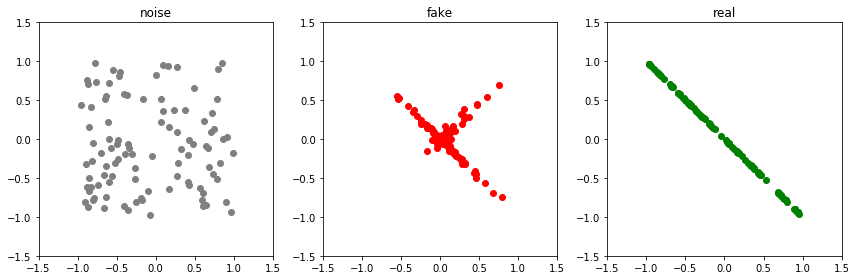

Epoch: 32500 G-error: 2.352902412414551 D-error: 3.5735151767730713


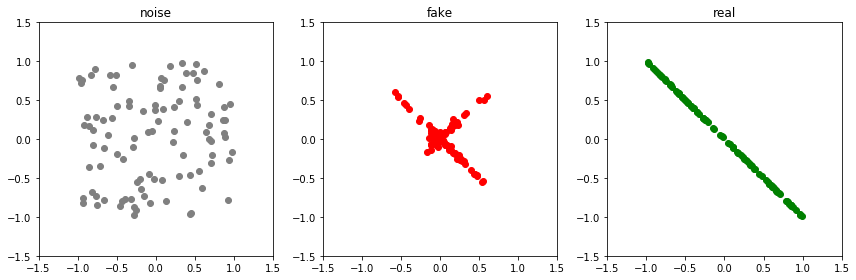

Epoch: 32550 G-error: 1.0842887163162231 D-error: 1.0450655221939087


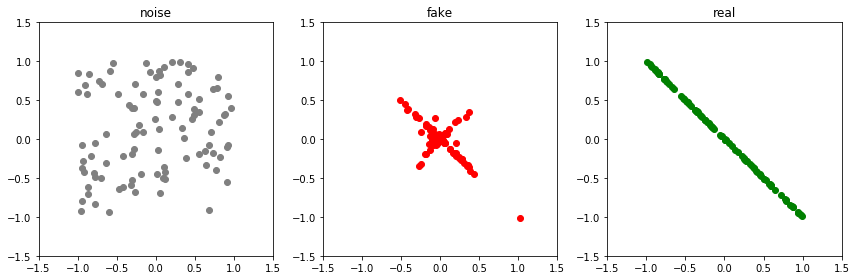

Epoch: 32600 G-error: 1.3617808818817139 D-error: 0.9200360178947449


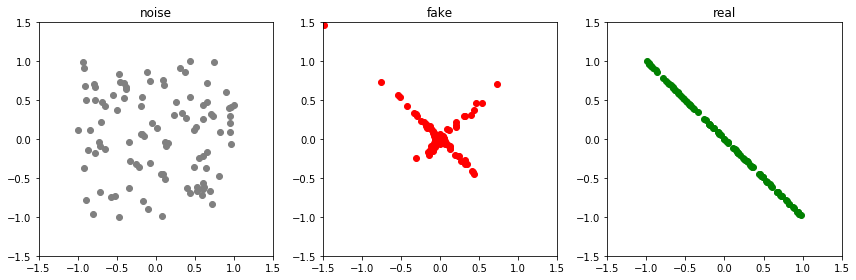

Epoch: 32650 G-error: 1.396133542060852 D-error: 0.9381654262542725


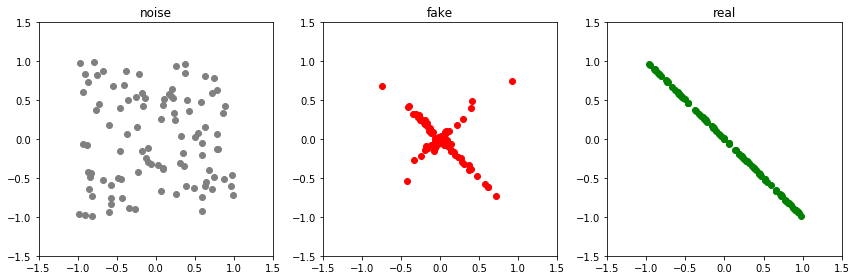

Epoch: 32700 G-error: 1.4870702028274536 D-error: 0.9252259135246277


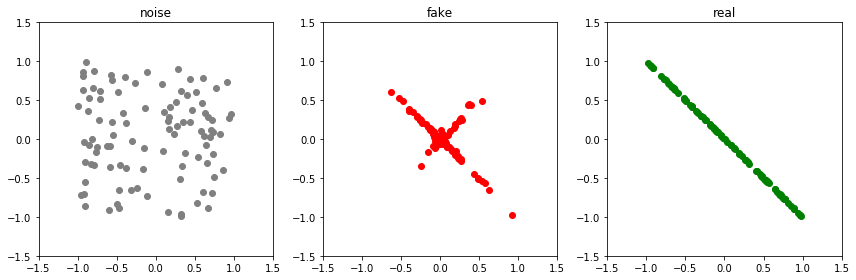

Epoch: 32750 G-error: 1.4926042556762695 D-error: 0.8638467192649841


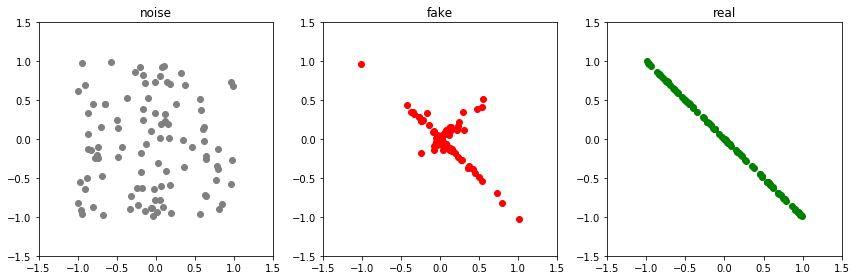

Epoch: 32800 G-error: 1.589551568031311 D-error: 0.8689343929290771


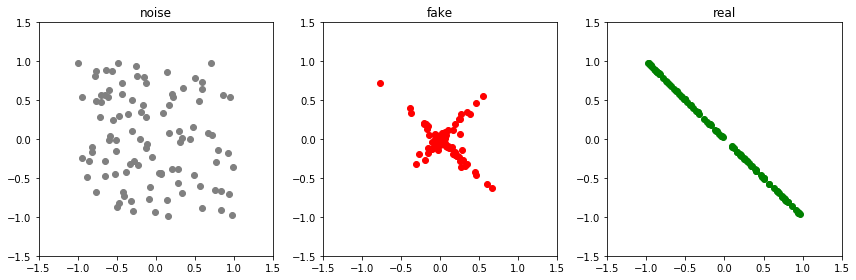

Epoch: 32850 G-error: 1.5446423292160034 D-error: 0.707011342048645


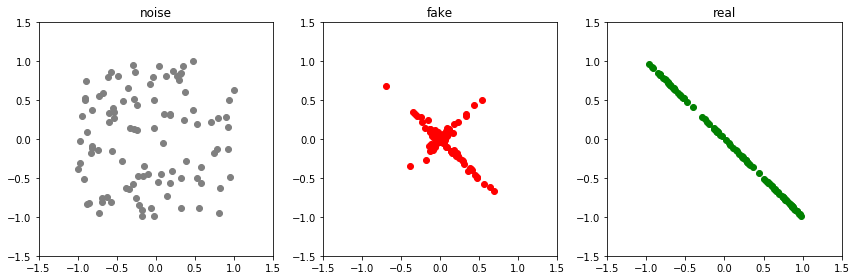

Epoch: 32900 G-error: 1.4329171180725098 D-error: 0.7663106918334961


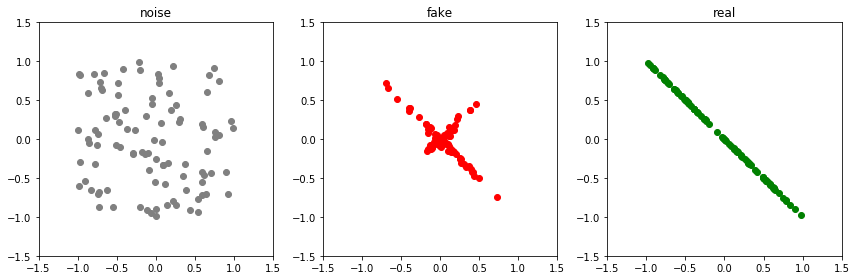

Epoch: 32950 G-error: 1.5961108207702637 D-error: 0.7942796349525452


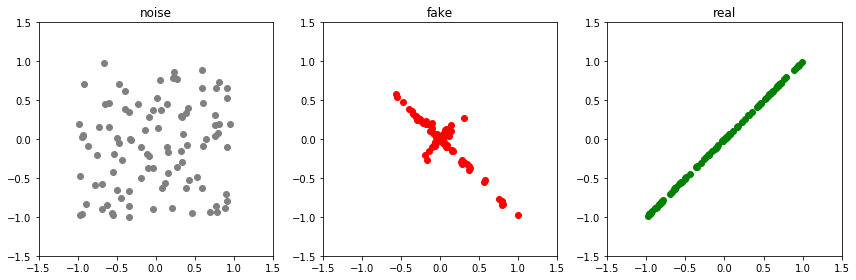

Epoch: 33000 G-error: 1.4359759092330933 D-error: 1.5775270462036133


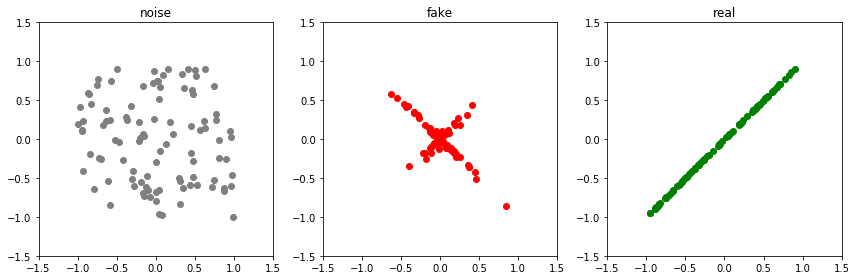

Epoch: 33050 G-error: 1.485396385192871 D-error: 0.6687226891517639


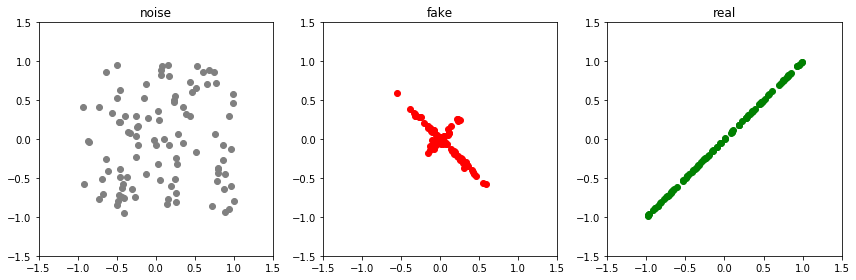

Epoch: 33100 G-error: 1.5936509370803833 D-error: 0.511399507522583


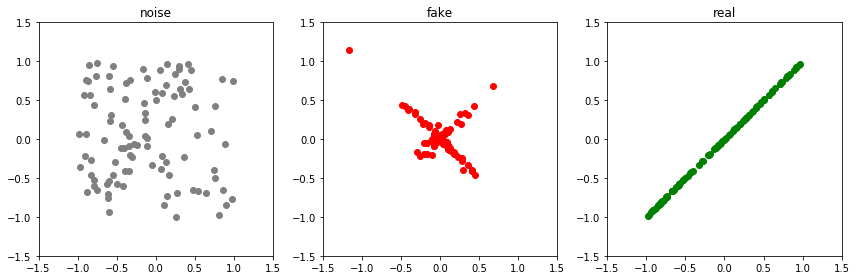

Epoch: 33150 G-error: 1.7601308822631836 D-error: 0.5686373710632324


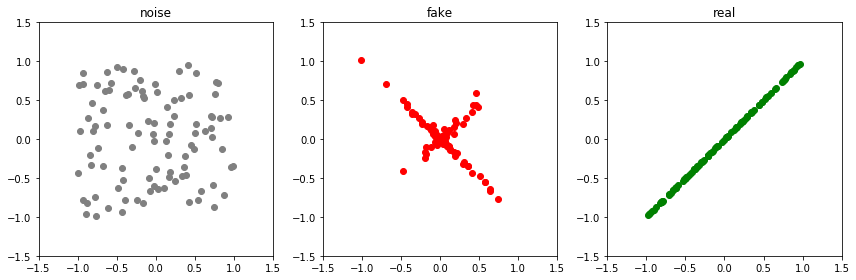

Epoch: 33200 G-error: 1.8426704406738281 D-error: 0.5495491027832031


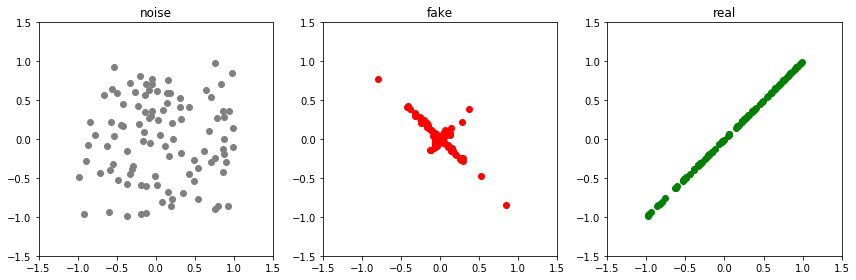

Epoch: 33250 G-error: 2.0361928939819336 D-error: 0.42272812128067017


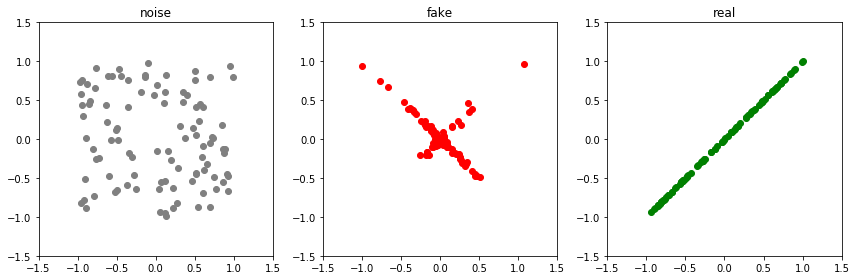

Epoch: 33300 G-error: 1.9390501976013184 D-error: 0.4867323637008667


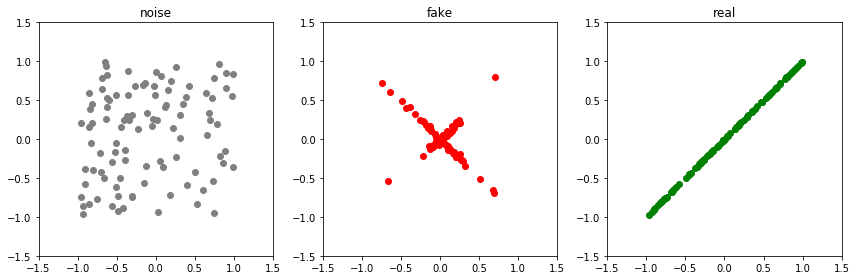

Epoch: 33350 G-error: 2.2794055938720703 D-error: 0.5682529211044312


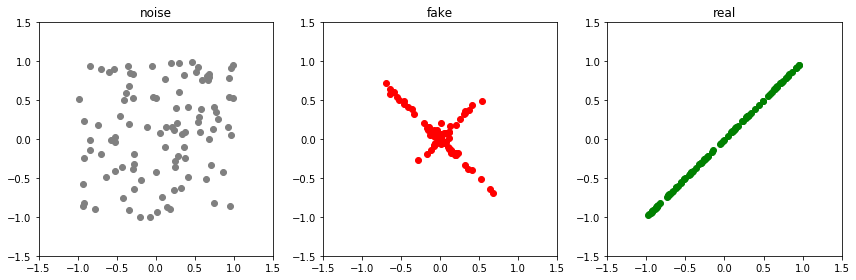

Epoch: 33400 G-error: 2.191526412963867 D-error: 0.4563610255718231


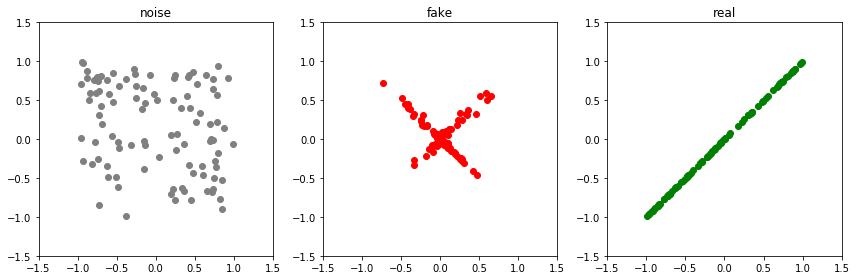

Epoch: 33450 G-error: 2.268160104751587 D-error: 0.5286004543304443


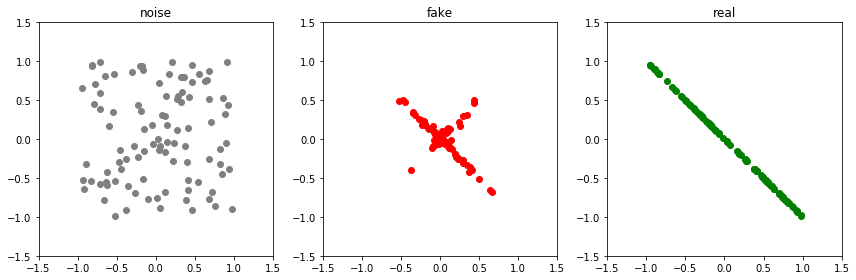

Epoch: 33500 G-error: 2.2177600860595703 D-error: 3.526571035385132


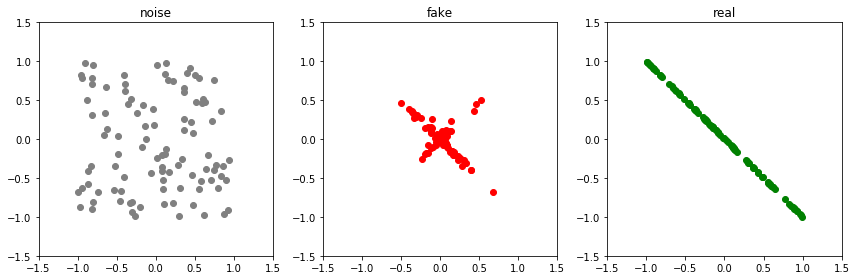

Epoch: 33550 G-error: 1.0198063850402832 D-error: 1.0708460807800293


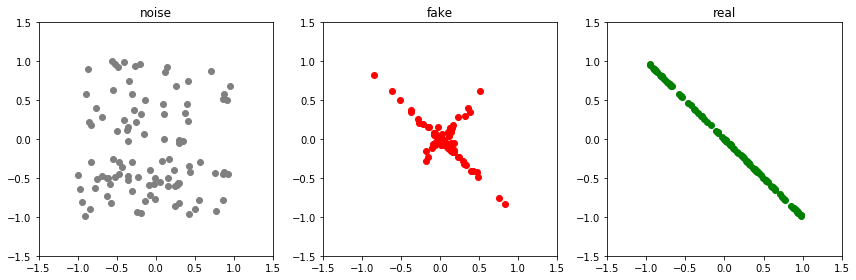

Epoch: 33600 G-error: 1.3800135850906372 D-error: 0.9815198183059692


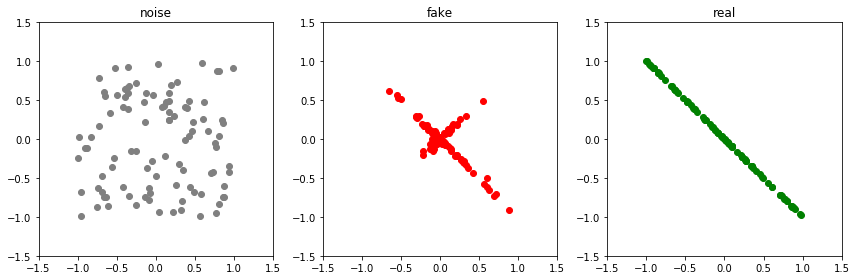

Epoch: 33650 G-error: 1.353786587715149 D-error: 1.0228946208953857


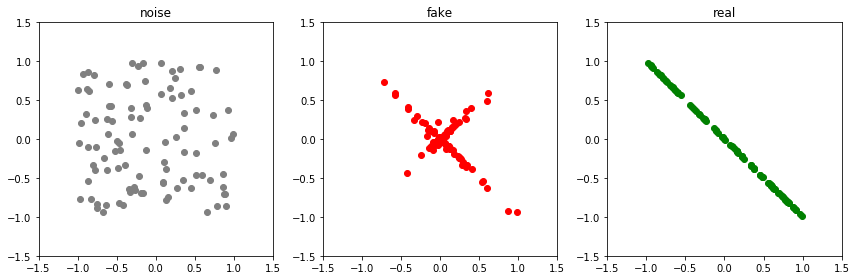

Epoch: 33700 G-error: 1.5830172300338745 D-error: 0.8770499229431152


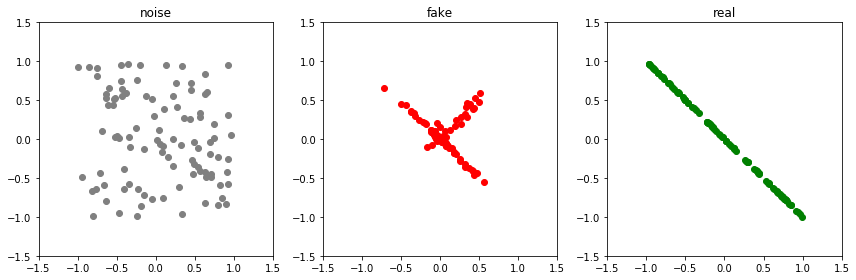

Epoch: 33750 G-error: 1.491200566291809 D-error: 0.7319786548614502


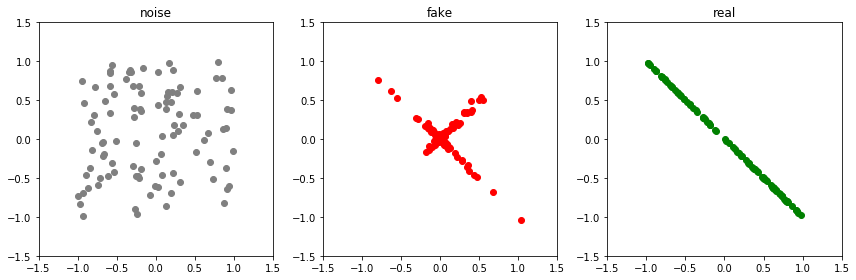

Epoch: 33800 G-error: 1.5545153617858887 D-error: 0.6773142218589783


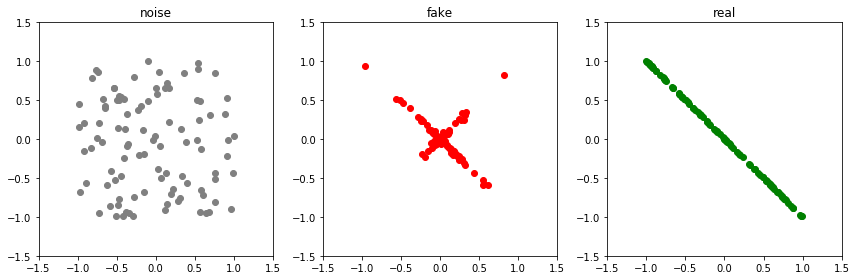

Epoch: 33850 G-error: 1.4977127313613892 D-error: 0.8092992901802063


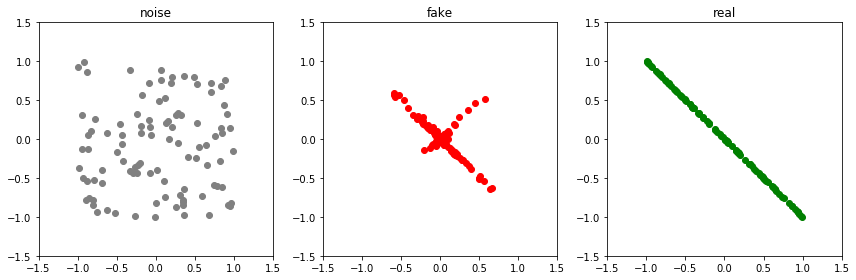

Epoch: 33900 G-error: 1.5933141708374023 D-error: 0.8597979545593262


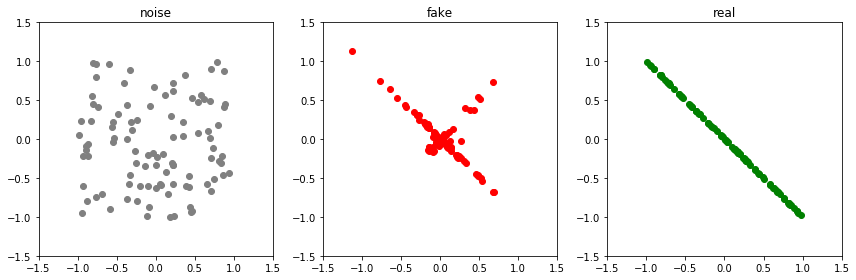

Epoch: 33950 G-error: 1.4663476943969727 D-error: 0.9302157163619995


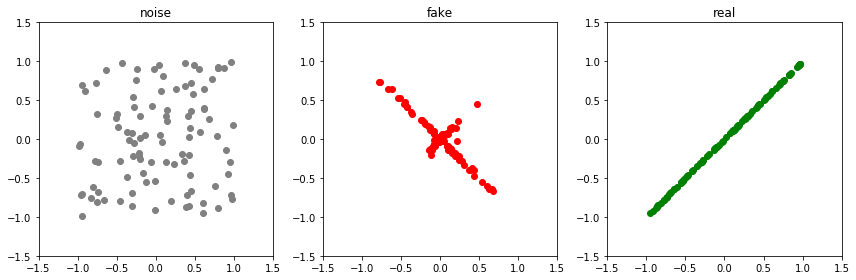

Epoch: 34000 G-error: 1.4445112943649292 D-error: 1.6604876518249512


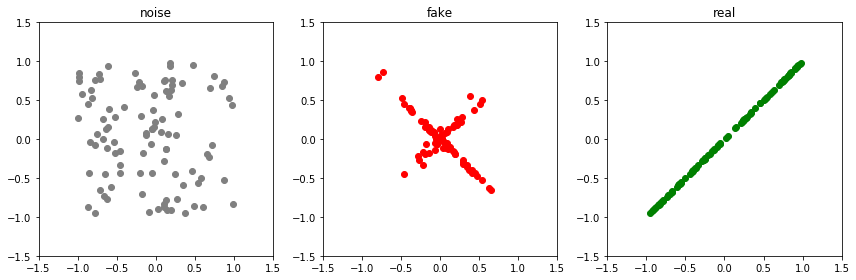

Epoch: 34050 G-error: 1.4262382984161377 D-error: 0.7271054983139038


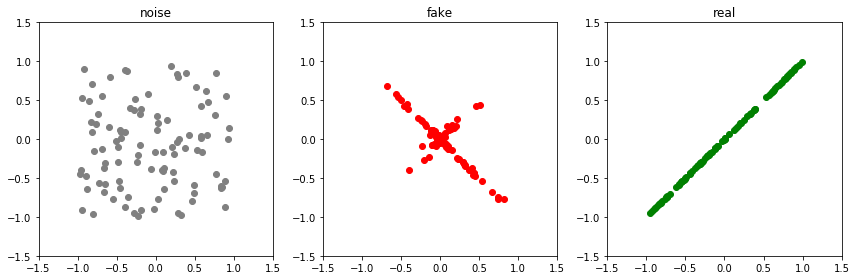

Epoch: 34100 G-error: 1.7057980298995972 D-error: 0.5980541110038757


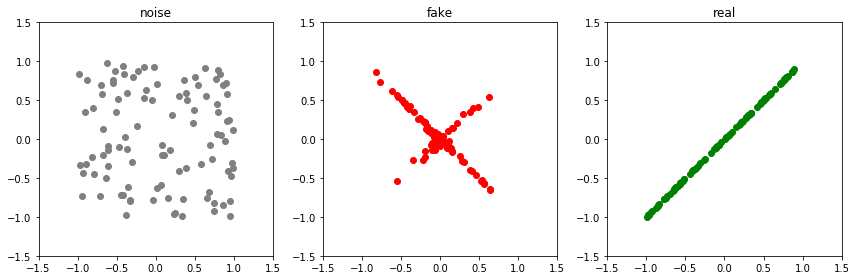

Epoch: 34150 G-error: 1.731808066368103 D-error: 0.5635796785354614


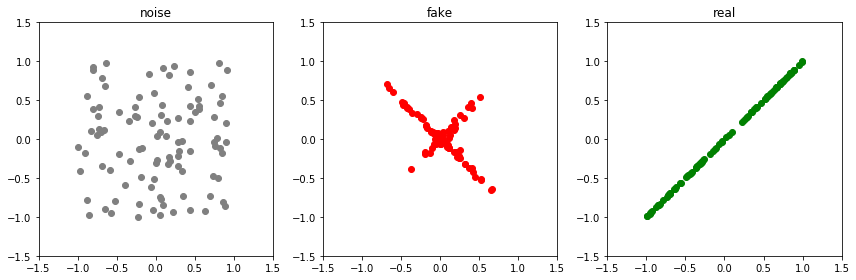

Epoch: 34200 G-error: 1.9089816808700562 D-error: 0.42551296949386597


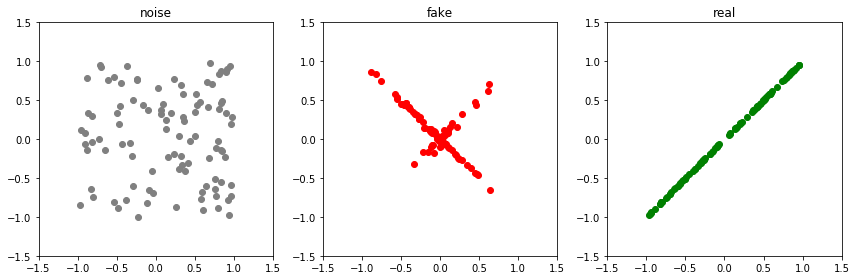

Epoch: 34250 G-error: 1.9132287502288818 D-error: 0.48474475741386414


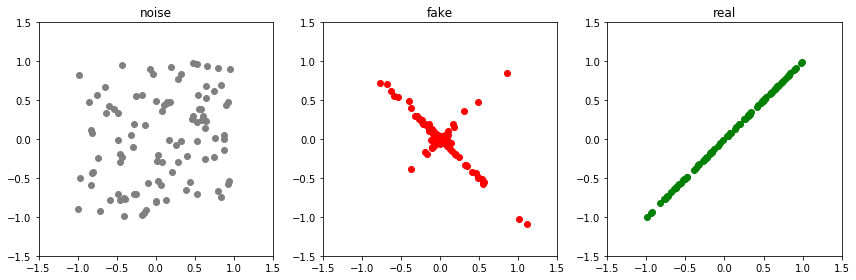

Epoch: 34300 G-error: 2.1889634132385254 D-error: 0.4931153655052185


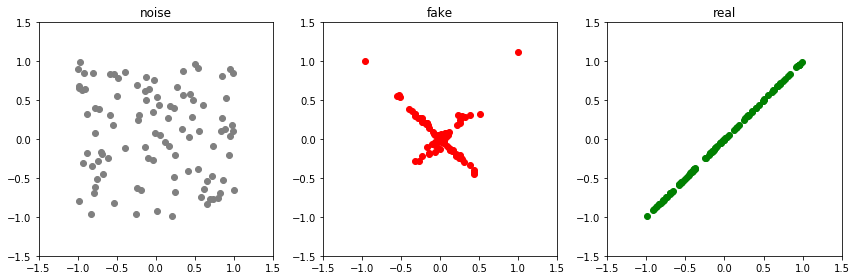

Epoch: 34350 G-error: 2.152852773666382 D-error: 0.5361089706420898


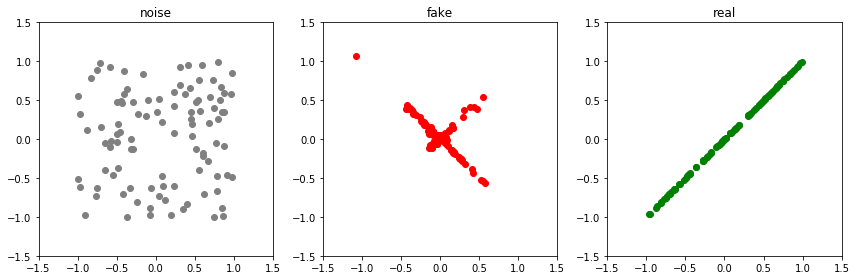

Epoch: 34400 G-error: 2.166468620300293 D-error: 0.5415143370628357


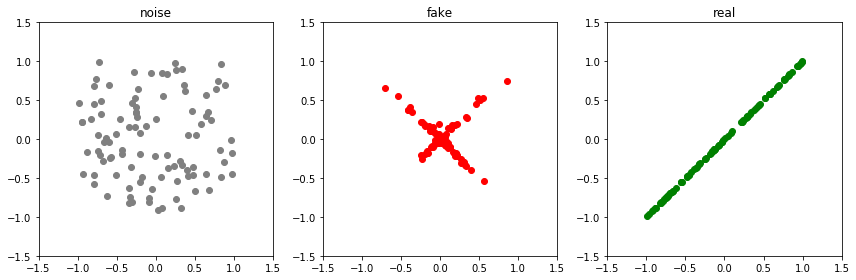

Epoch: 34450 G-error: 2.118739128112793 D-error: 0.5685036182403564


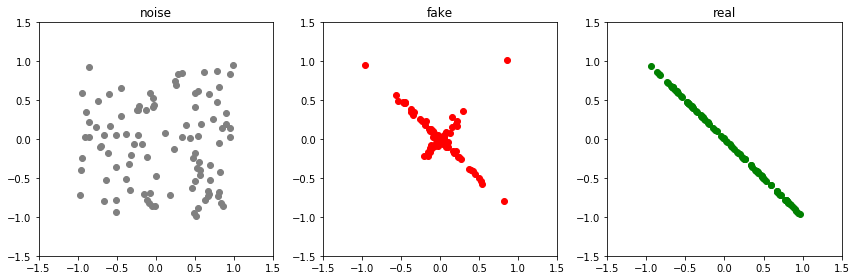

Epoch: 34500 G-error: 2.102785348892212 D-error: 3.4754960536956787


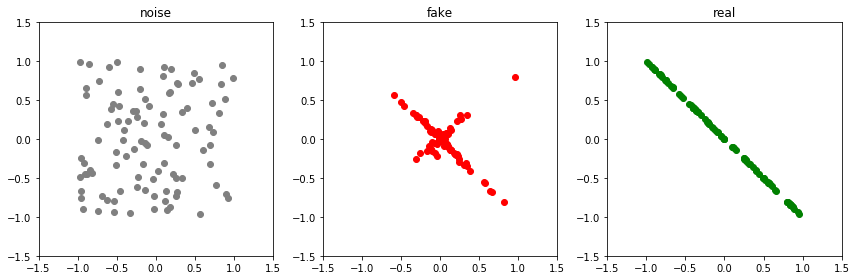

Epoch: 34550 G-error: 1.2116578817367554 D-error: 1.0410346984863281


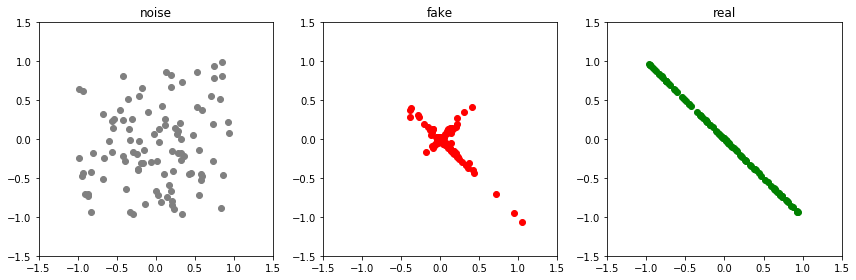

Epoch: 34600 G-error: 1.4067295789718628 D-error: 1.0989739894866943


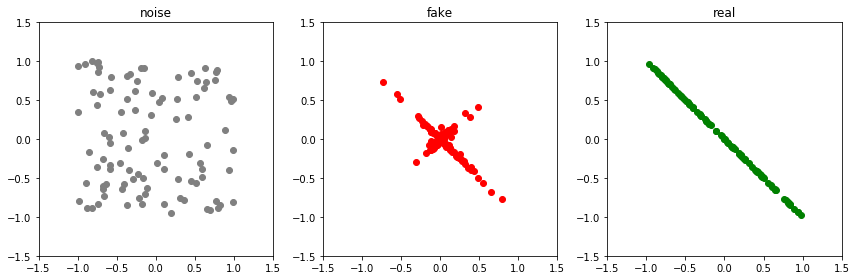

Epoch: 34650 G-error: 1.4673259258270264 D-error: 0.9316672086715698


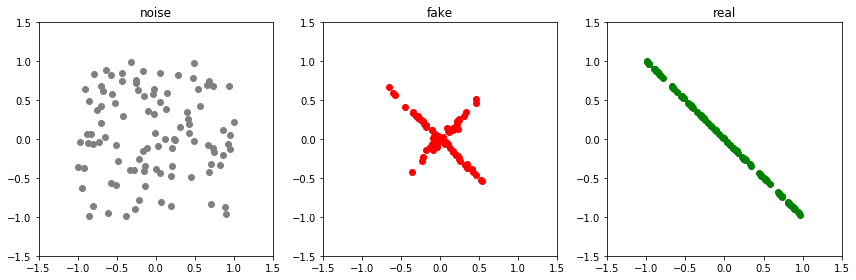

Epoch: 34700 G-error: 1.4526962041854858 D-error: 0.904785692691803


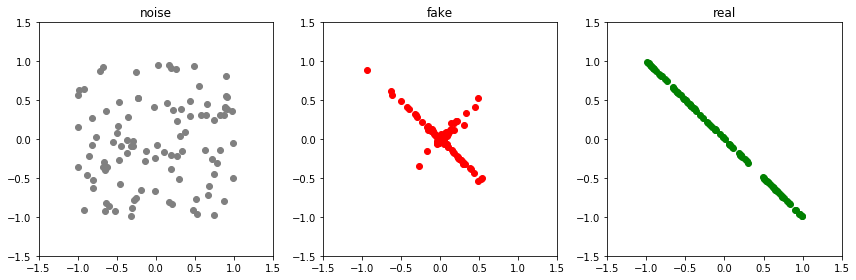

Epoch: 34750 G-error: 1.5625120401382446 D-error: 0.789168655872345


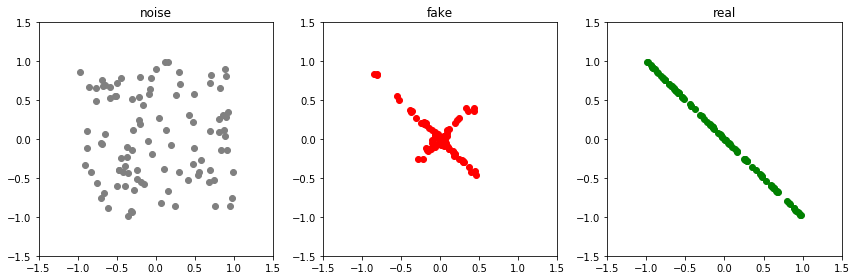

Epoch: 34800 G-error: 1.5400288105010986 D-error: 0.8144956827163696


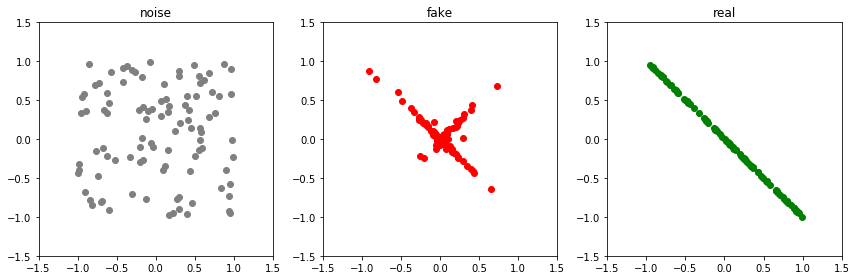

Epoch: 34850 G-error: 1.6061609983444214 D-error: 0.8411107063293457


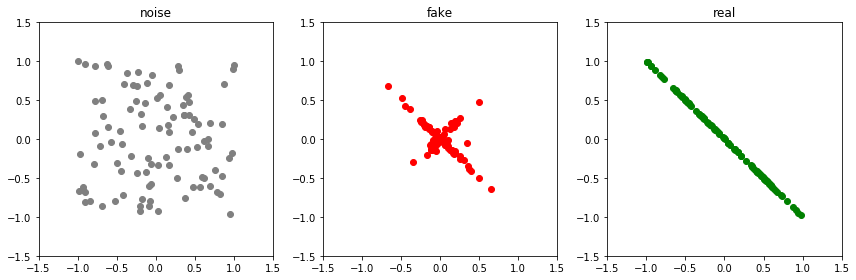

Epoch: 34900 G-error: 1.5082606077194214 D-error: 0.7884997129440308


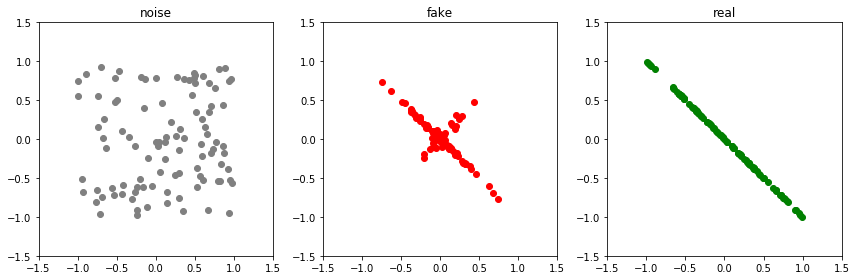

Epoch: 34950 G-error: 1.5914801359176636 D-error: 0.9062379598617554


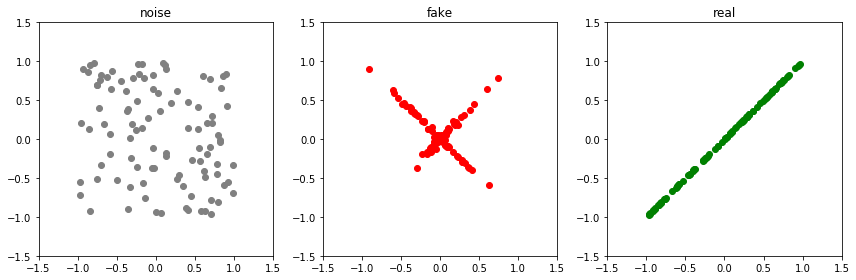

Epoch: 35000 G-error: 1.5543380975723267 D-error: 1.7363557815551758


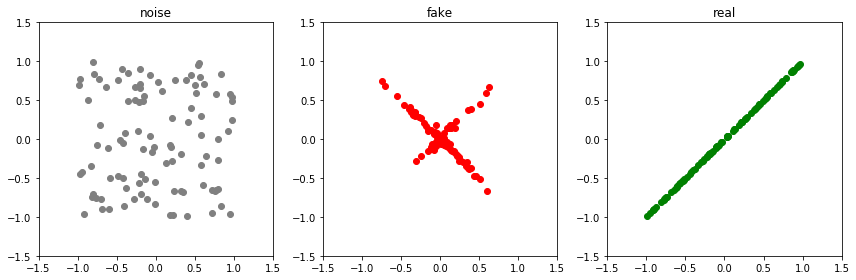

Epoch: 35050 G-error: 1.3356115818023682 D-error: 0.8569598197937012


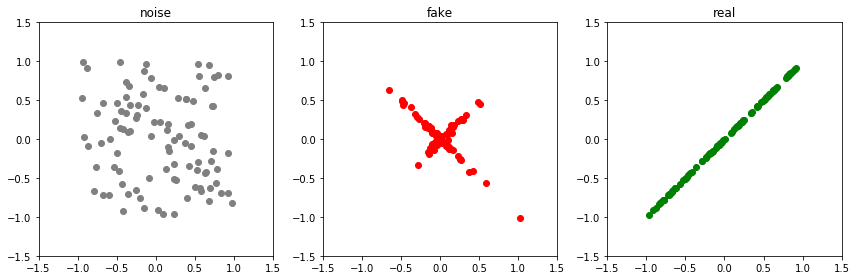

Epoch: 35100 G-error: 1.6258091926574707 D-error: 0.6660854816436768


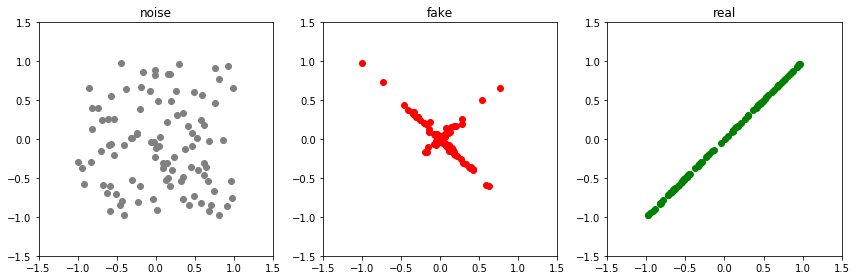

Epoch: 35150 G-error: 1.75749933719635 D-error: 0.4466853141784668


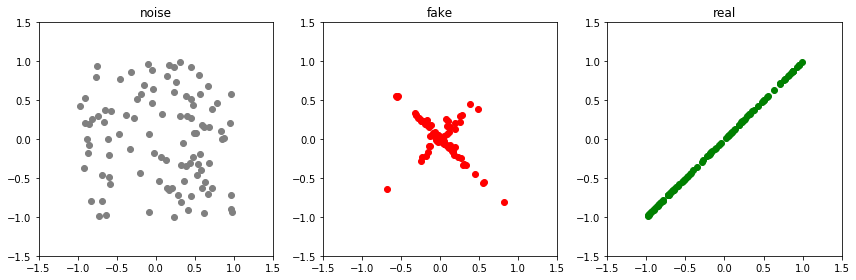

Epoch: 35200 G-error: 1.9197176694869995 D-error: 0.5233787894248962


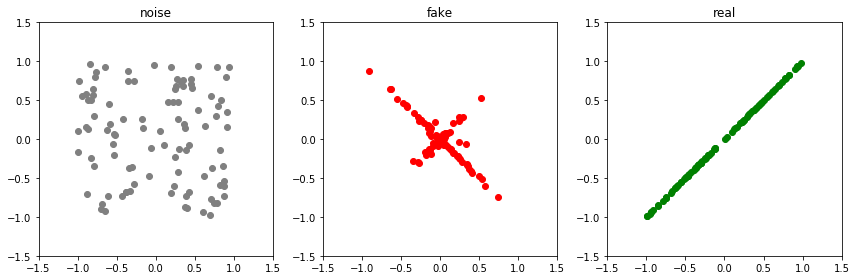

Epoch: 35250 G-error: 1.917343020439148 D-error: 0.46568793058395386


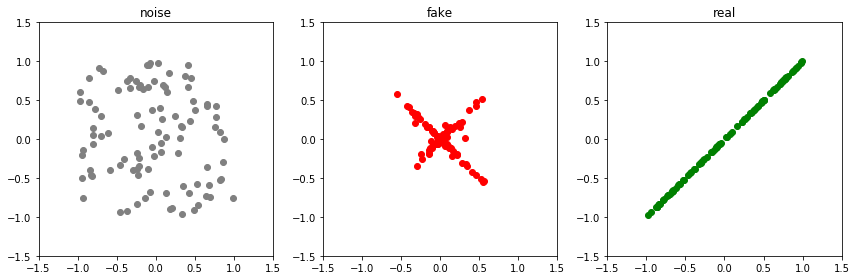

Epoch: 35300 G-error: 1.8854848146438599 D-error: 0.49233490228652954


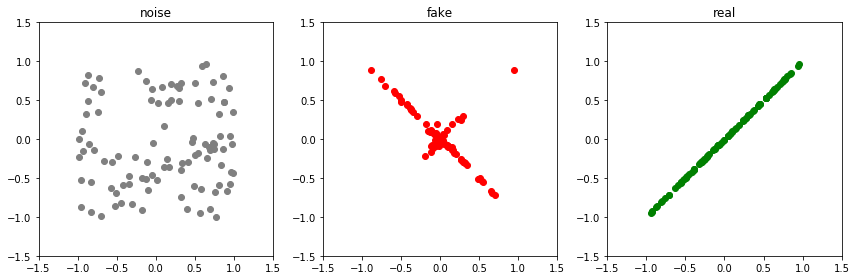

Epoch: 35350 G-error: 2.0293009281158447 D-error: 0.4919096827507019


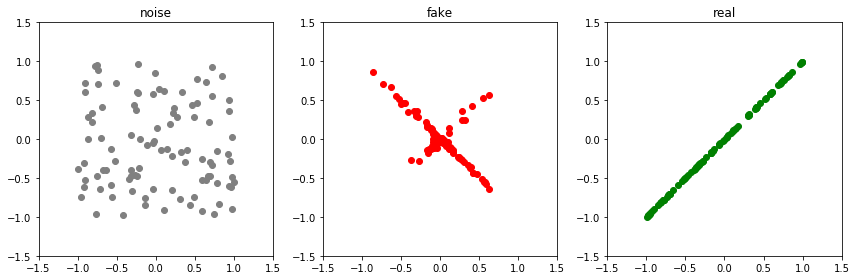

Epoch: 35400 G-error: 2.3203203678131104 D-error: 0.530006468296051


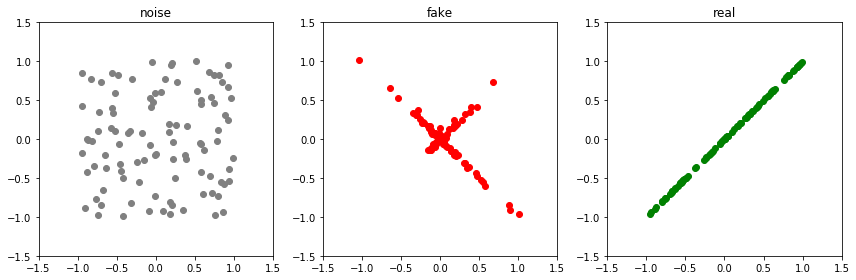

Epoch: 35450 G-error: 2.227797508239746 D-error: 0.5456499457359314


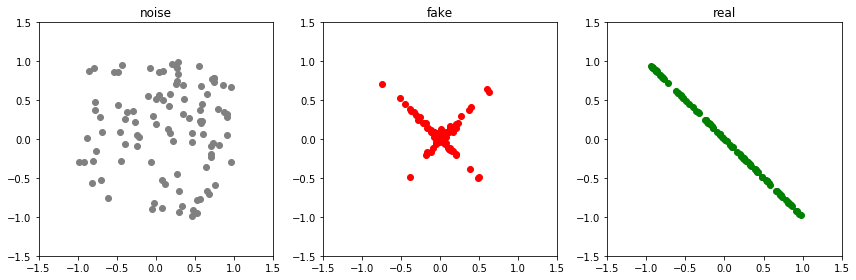

Epoch: 35500 G-error: 2.339340925216675 D-error: 3.5658364295959473


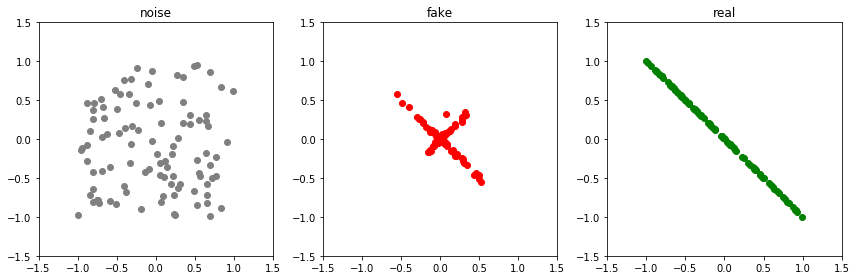

Epoch: 35550 G-error: 1.0969005823135376 D-error: 1.063812494277954


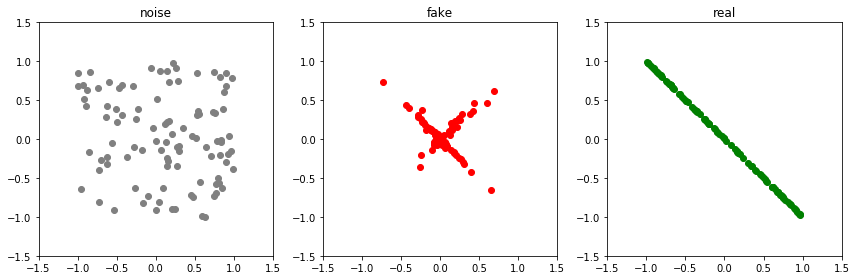

Epoch: 35600 G-error: 1.3849886655807495 D-error: 0.8831847906112671


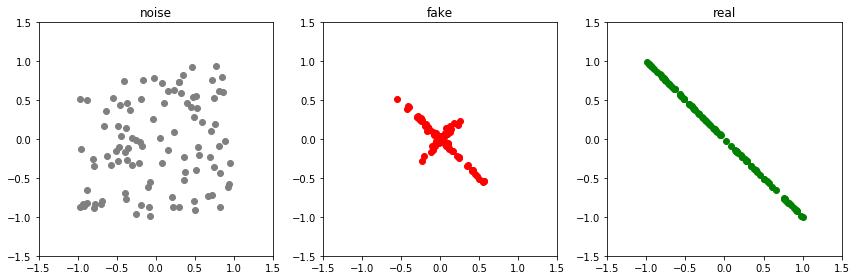

Epoch: 35650 G-error: 1.4392344951629639 D-error: 0.838850736618042


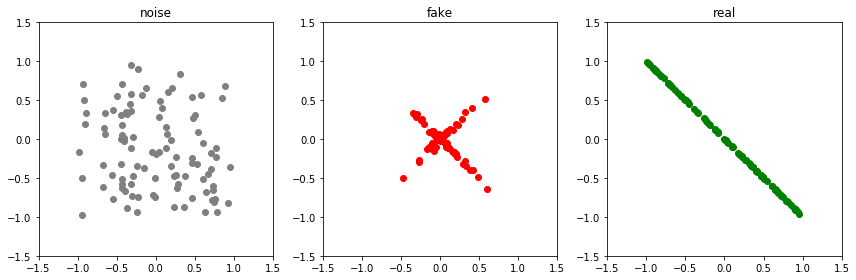

Epoch: 35700 G-error: 1.4196261167526245 D-error: 0.744207501411438


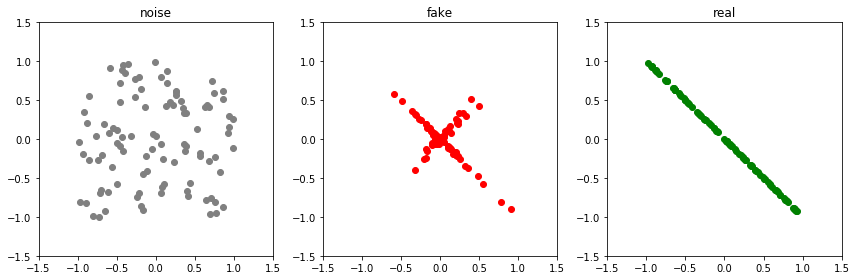

Epoch: 35750 G-error: 1.6004806756973267 D-error: 0.8337597250938416


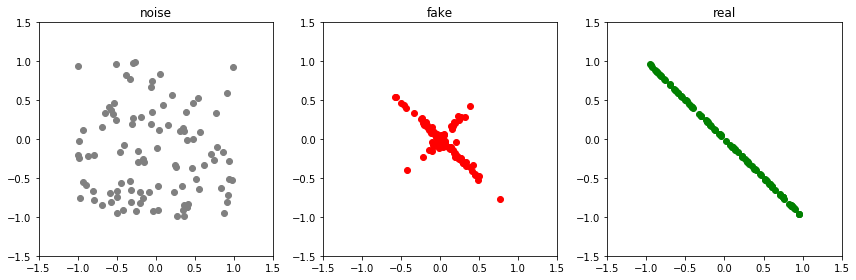

Epoch: 35800 G-error: 1.460437297821045 D-error: 0.866181492805481


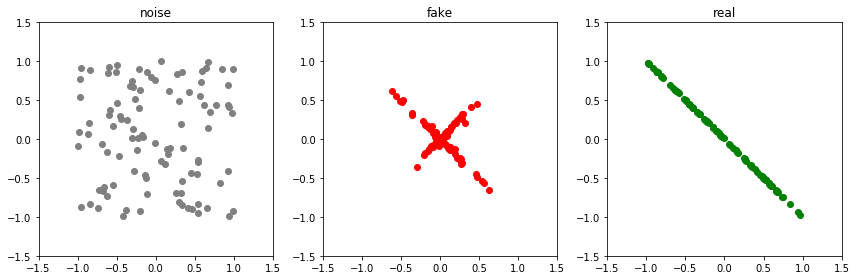

Epoch: 35850 G-error: 1.6623769998550415 D-error: 0.8229804635047913


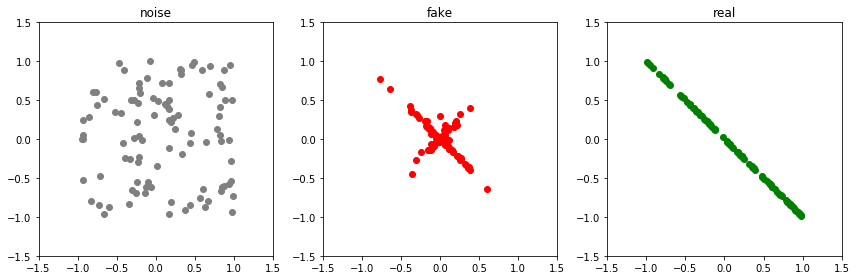

Epoch: 35900 G-error: 1.5903401374816895 D-error: 0.7375870943069458


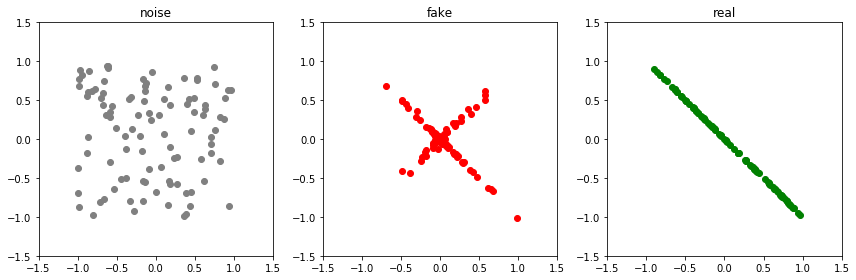

Epoch: 35950 G-error: 1.411471962928772 D-error: 0.808600664138794


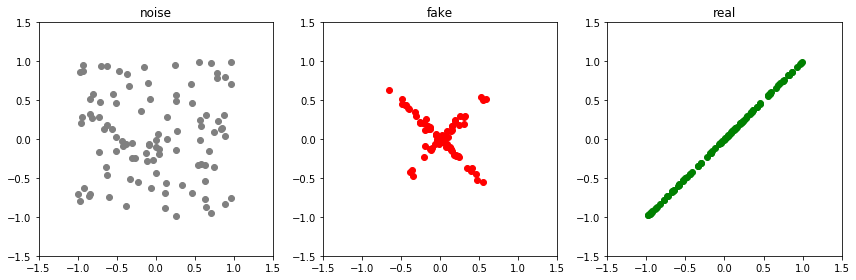

Epoch: 36000 G-error: 1.62272310256958 D-error: 1.83949875831604


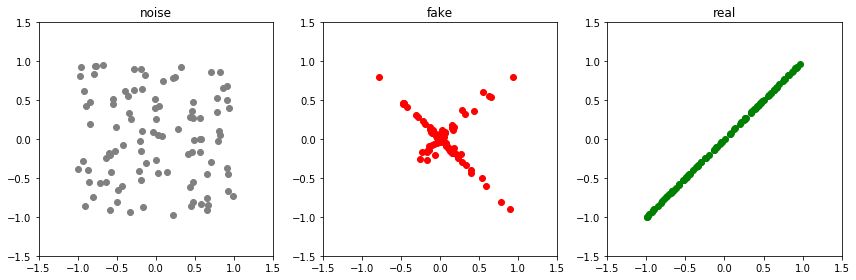

Epoch: 36050 G-error: 1.4106231927871704 D-error: 0.7329070568084717


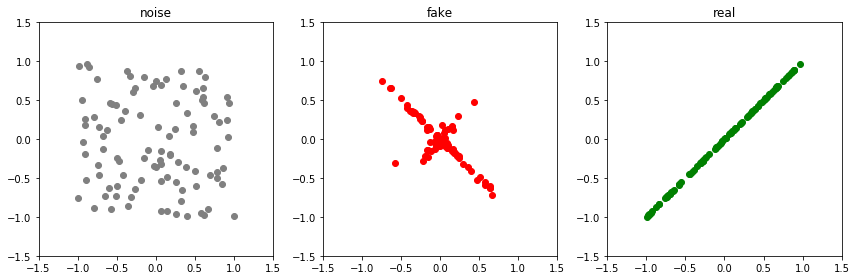

Epoch: 36100 G-error: 1.5504406690597534 D-error: 0.6152615547180176


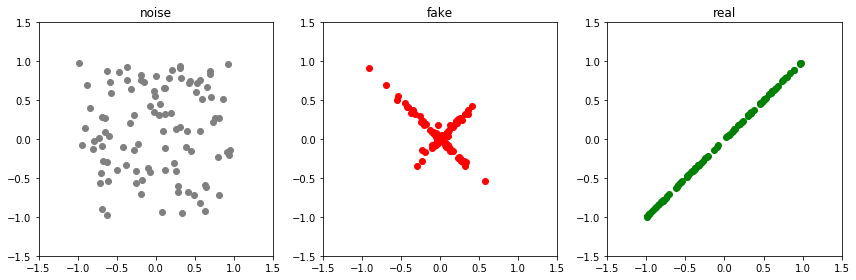

Epoch: 36150 G-error: 1.7173000574111938 D-error: 0.5179563760757446


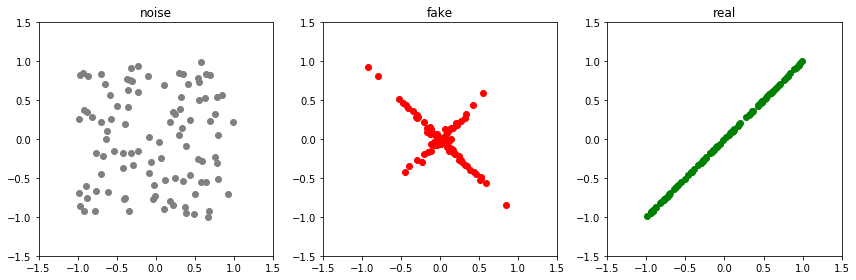

Epoch: 36200 G-error: 1.842576503753662 D-error: 0.5123168230056763


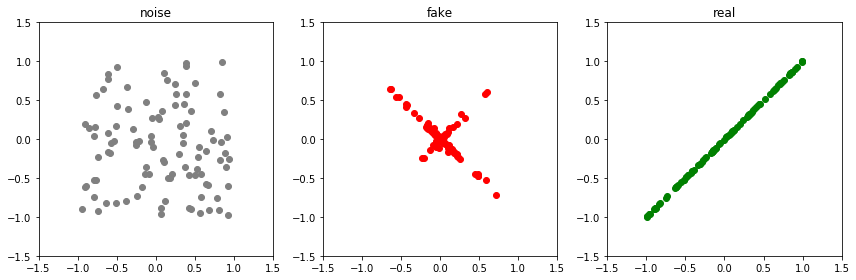

Epoch: 36250 G-error: 2.0286922454833984 D-error: 0.5629757642745972


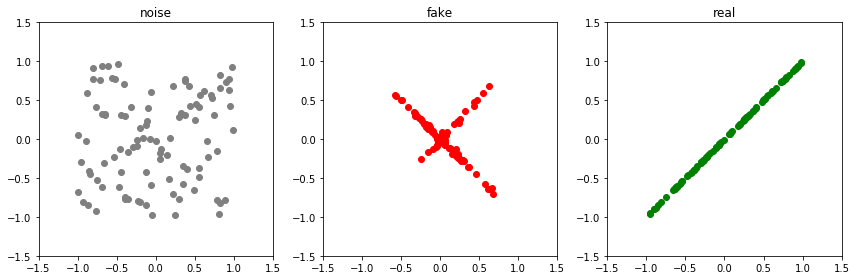

Epoch: 36300 G-error: 1.9088305234909058 D-error: 0.5529357194900513


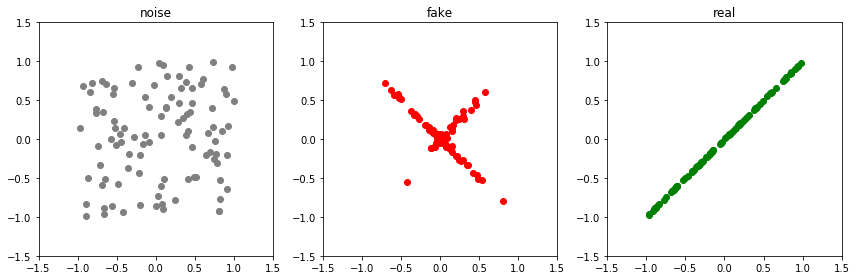

Epoch: 36350 G-error: 2.1250650882720947 D-error: 0.5579447150230408


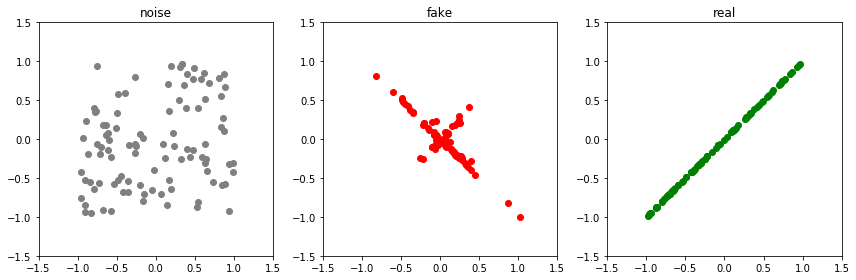

Epoch: 36400 G-error: 2.298962116241455 D-error: 0.4858582615852356


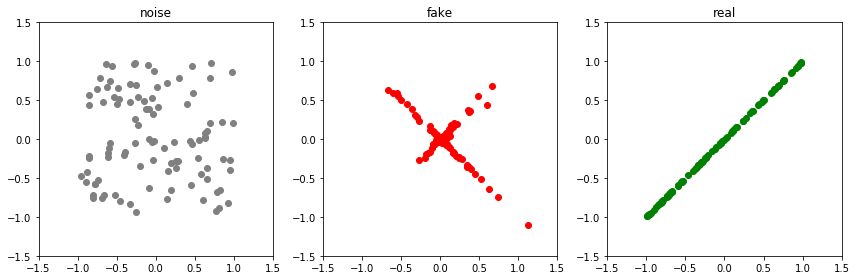

Epoch: 36450 G-error: 2.1439499855041504 D-error: 0.5022826194763184


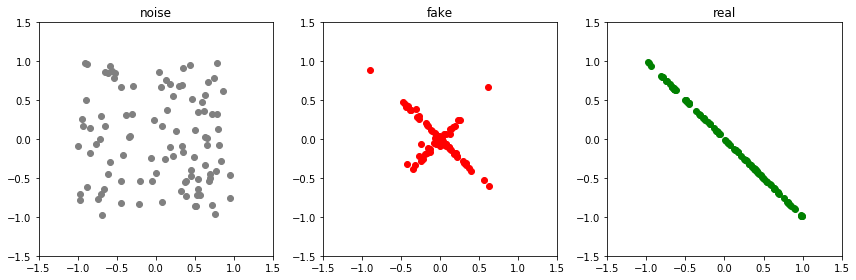

Epoch: 36500 G-error: 2.1940340995788574 D-error: 3.5852394104003906


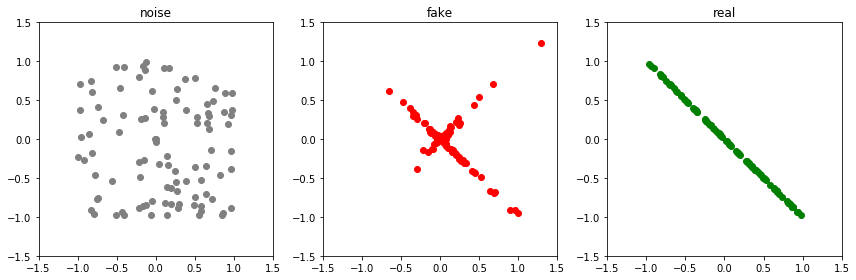

Epoch: 36550 G-error: 1.0359464883804321 D-error: 1.1858329772949219


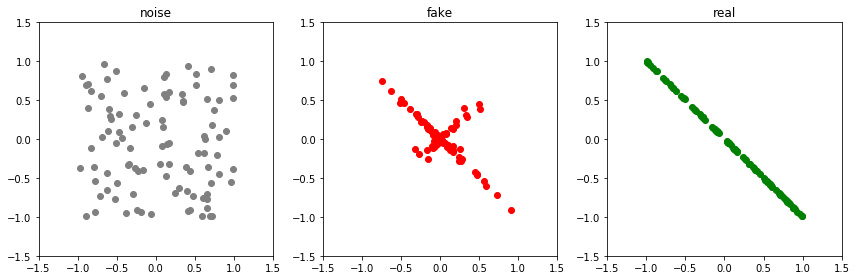

Epoch: 36600 G-error: 1.3118404150009155 D-error: 0.8391767740249634


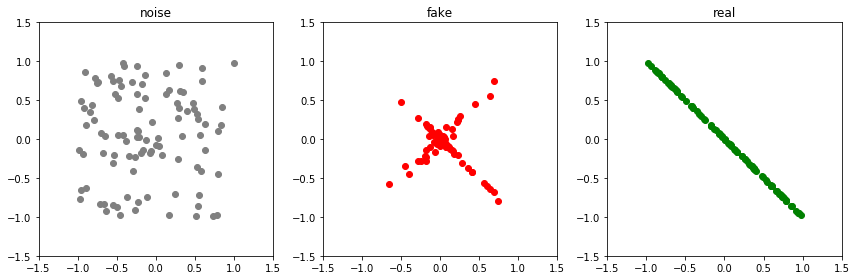

Epoch: 36650 G-error: 1.5186346769332886 D-error: 0.95533287525177


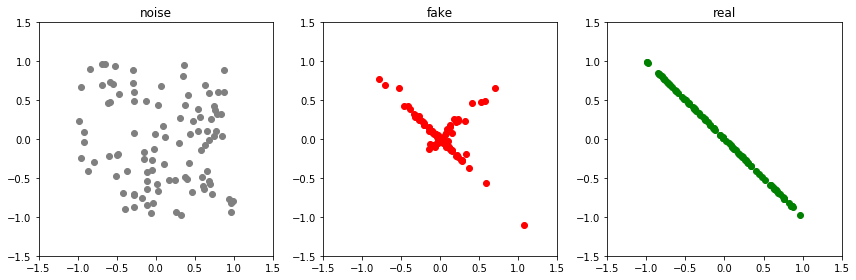

Epoch: 36700 G-error: 1.5421271324157715 D-error: 0.8853474855422974


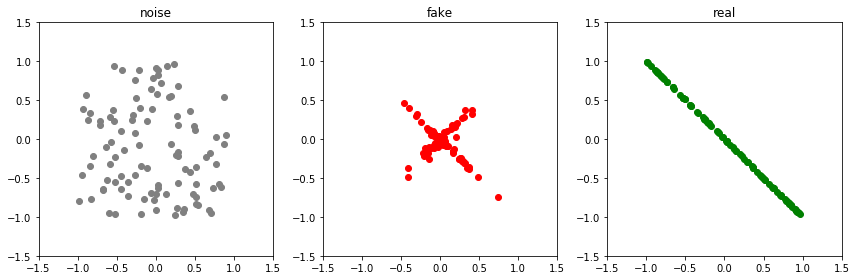

Epoch: 36750 G-error: 1.4977511167526245 D-error: 0.7601028084754944


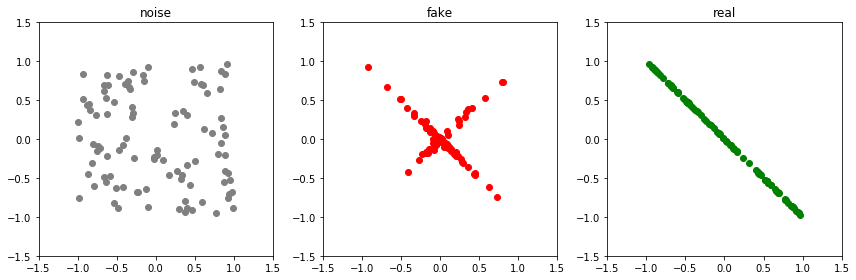

Epoch: 36800 G-error: 1.5148533582687378 D-error: 0.9060523509979248


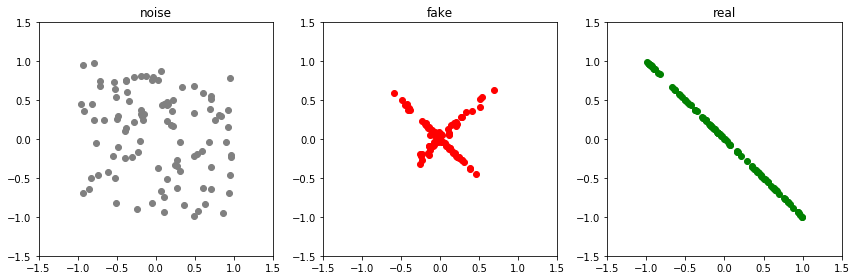

Epoch: 36850 G-error: 1.6900684833526611 D-error: 0.8051540851593018


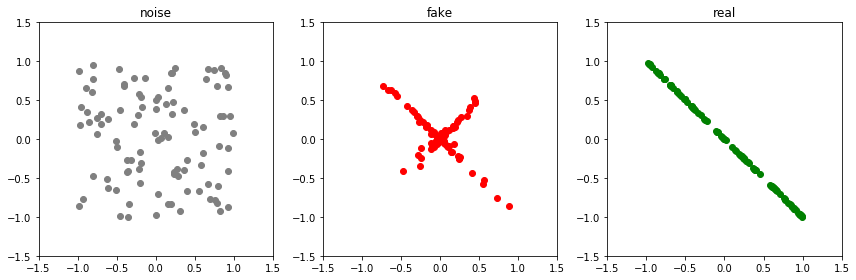

Epoch: 36900 G-error: 1.3879690170288086 D-error: 0.7800513505935669


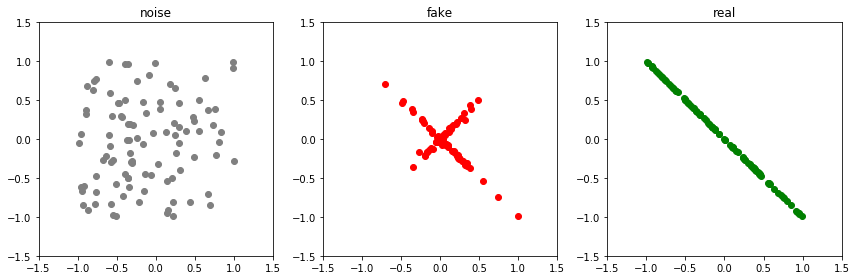

Epoch: 36950 G-error: 1.4736568927764893 D-error: 0.8088351488113403


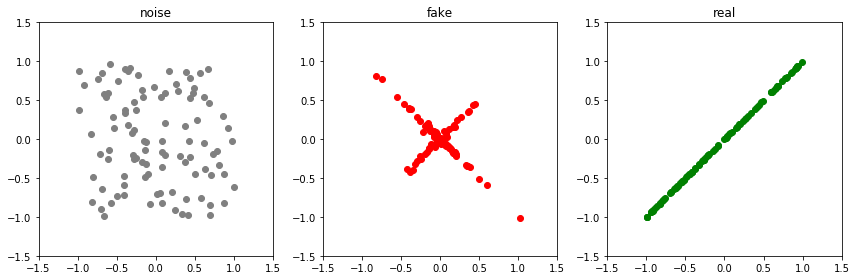

Epoch: 37000 G-error: 1.5427796840667725 D-error: 1.8469197750091553


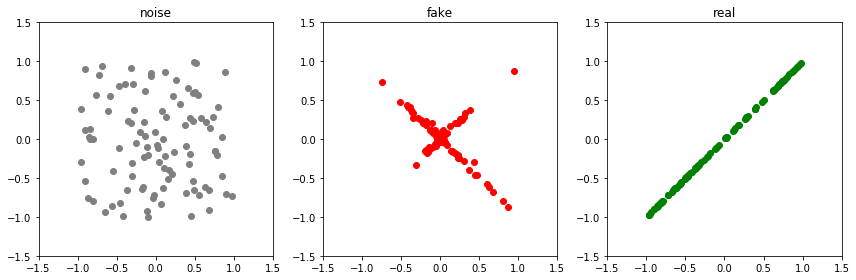

Epoch: 37050 G-error: 1.378635048866272 D-error: 0.7531630396842957


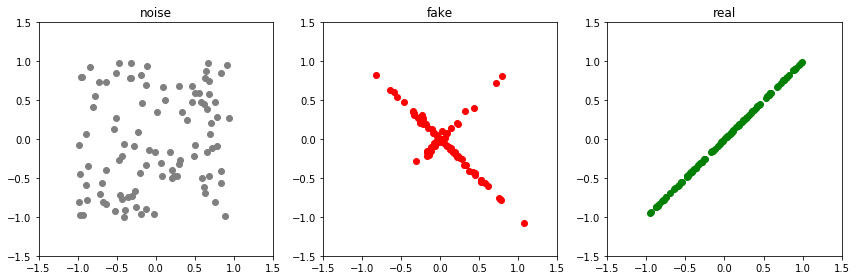

Epoch: 37100 G-error: 1.5213220119476318 D-error: 0.7285686135292053


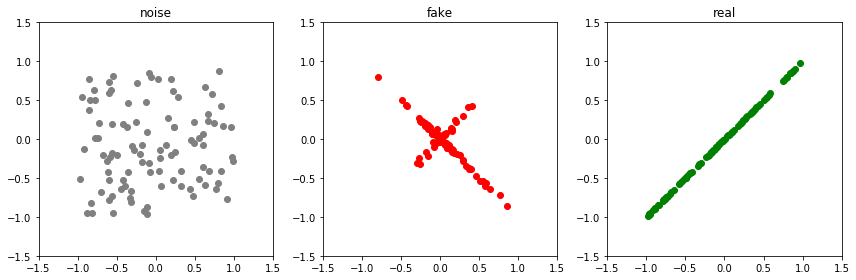

Epoch: 37150 G-error: 1.7139294147491455 D-error: 0.6250295042991638


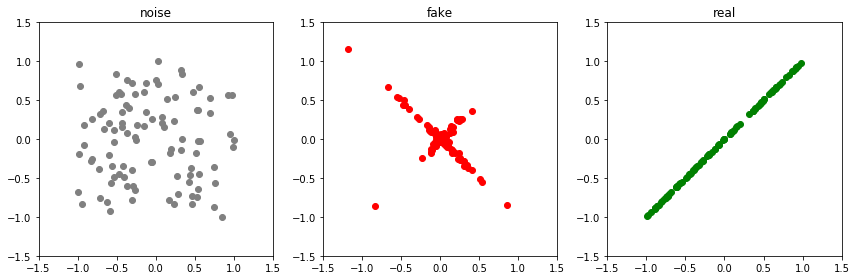

Epoch: 37200 G-error: 1.8582900762557983 D-error: 0.5633970499038696


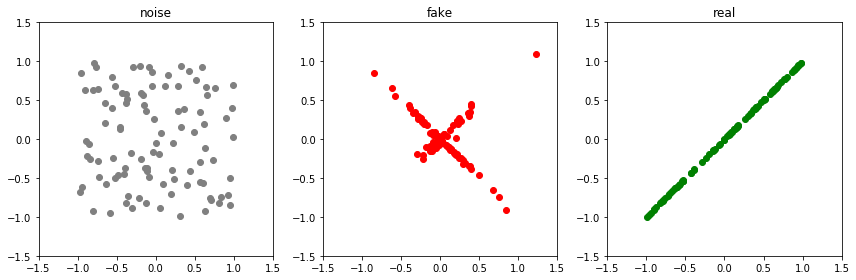

Epoch: 37250 G-error: 1.8708914518356323 D-error: 0.5440834760665894


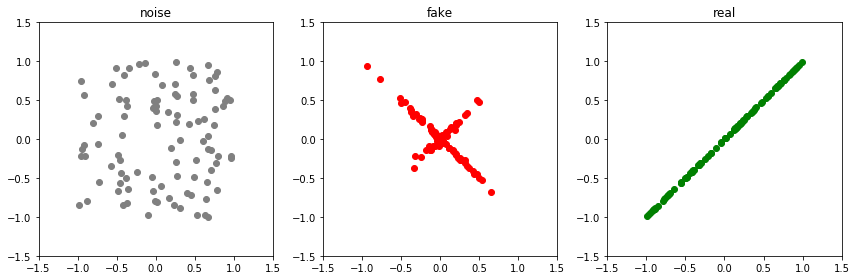

Epoch: 37300 G-error: 2.0888280868530273 D-error: 0.5259565711021423


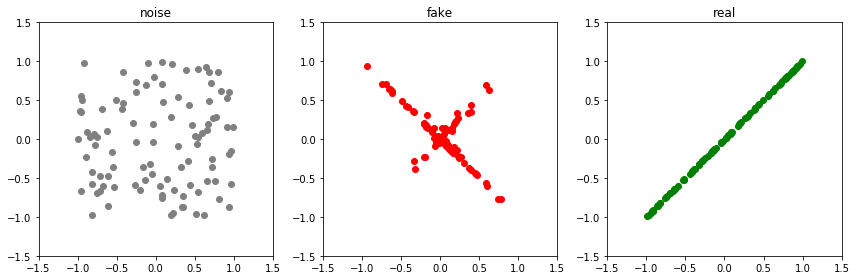

Epoch: 37350 G-error: 2.1084277629852295 D-error: 0.5188878774642944


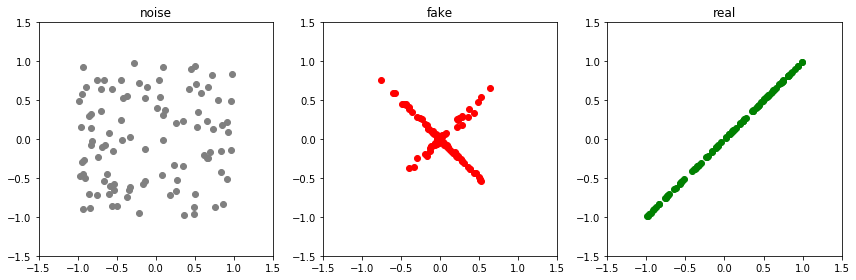

Epoch: 37400 G-error: 2.0862839221954346 D-error: 0.5125364065170288


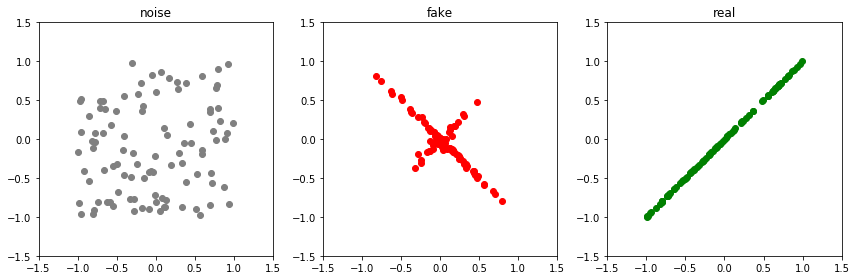

Epoch: 37450 G-error: 2.079322576522827 D-error: 0.4577975869178772


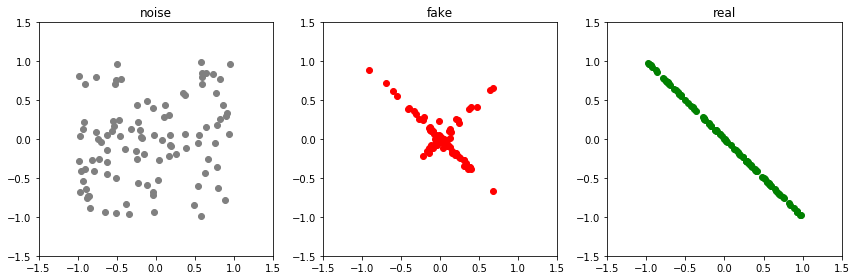

Epoch: 37500 G-error: 2.1542980670928955 D-error: 3.5347983837127686


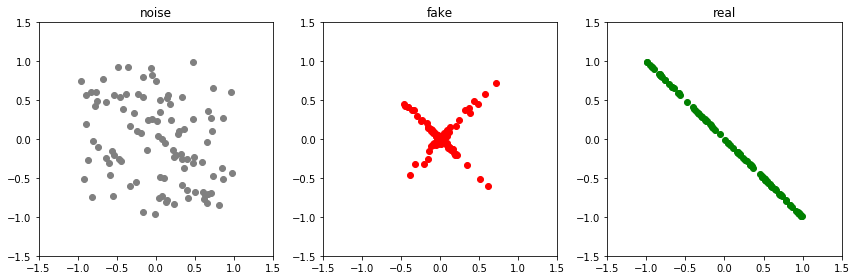

Epoch: 37550 G-error: 1.0793057680130005 D-error: 1.0503853559494019


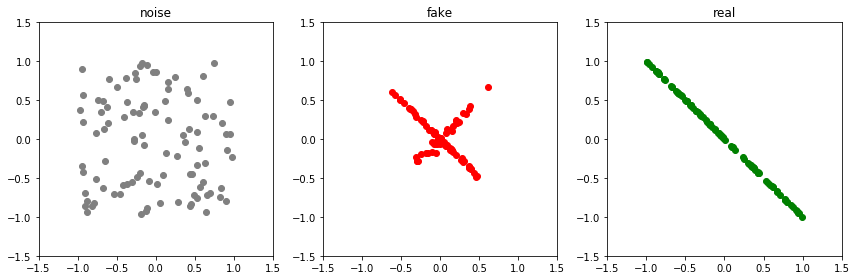

Epoch: 37600 G-error: 1.2072174549102783 D-error: 0.9566285610198975


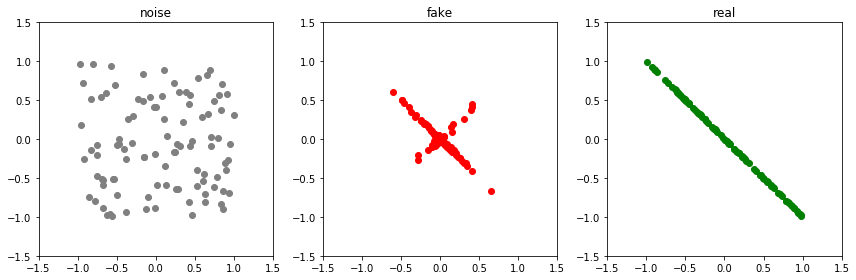

Epoch: 37650 G-error: 1.2949550151824951 D-error: 0.864153265953064


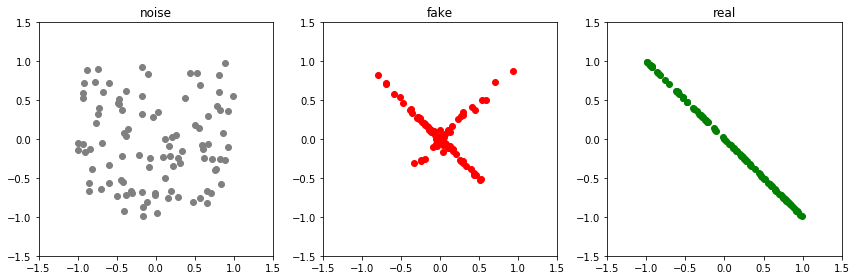

Epoch: 37700 G-error: 1.4976344108581543 D-error: 0.8276122808456421


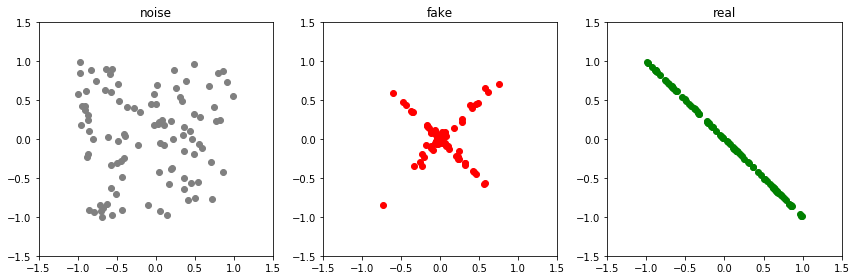

Epoch: 37750 G-error: 1.4509190320968628 D-error: 0.8266149759292603


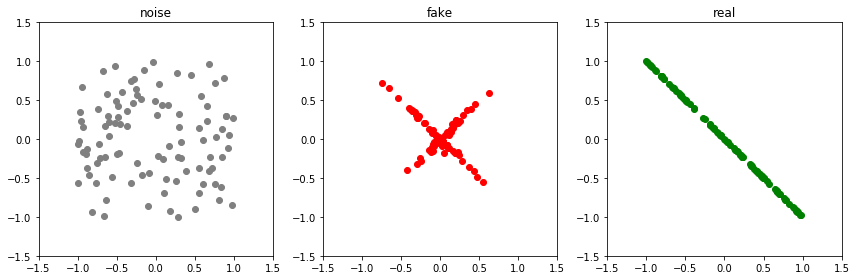

Epoch: 37800 G-error: 1.60996413230896 D-error: 0.7433675527572632


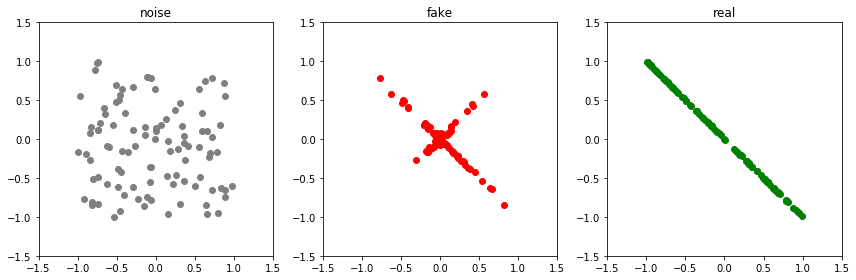

Epoch: 37850 G-error: 1.6210299730300903 D-error: 0.795662522315979


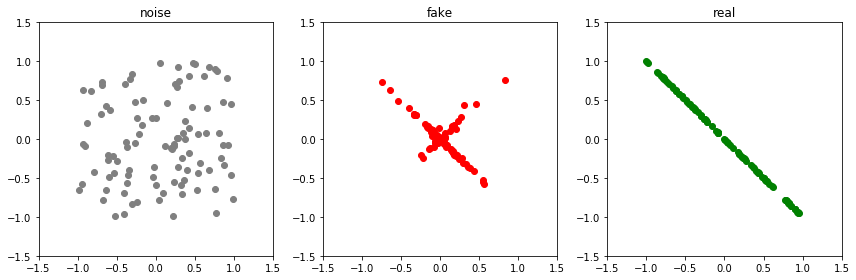

Epoch: 37900 G-error: 1.5353542566299438 D-error: 0.7945328950881958


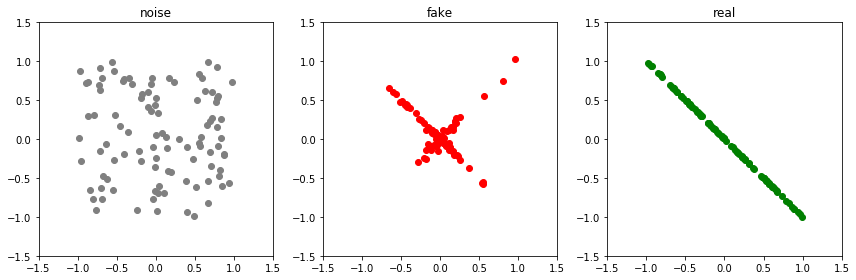

Epoch: 37950 G-error: 1.6581978797912598 D-error: 0.8303964138031006


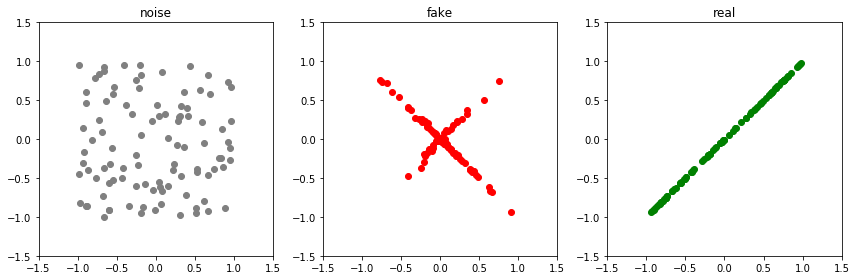

Epoch: 38000 G-error: 1.4608067274093628 D-error: 2.115273952484131


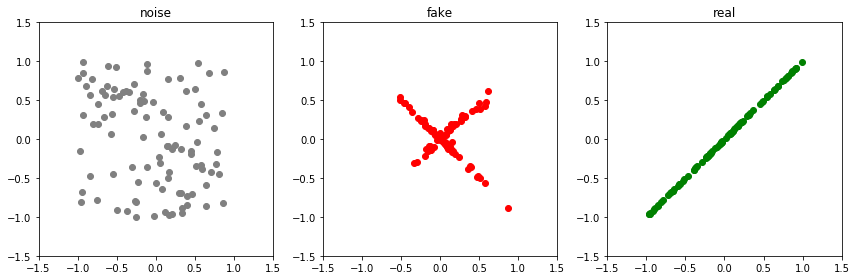

Epoch: 38050 G-error: 1.367116093635559 D-error: 0.9406522512435913


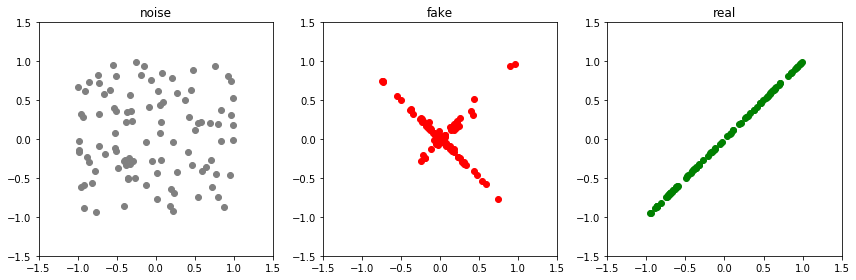

Epoch: 38100 G-error: 1.5421444177627563 D-error: 0.5926173329353333


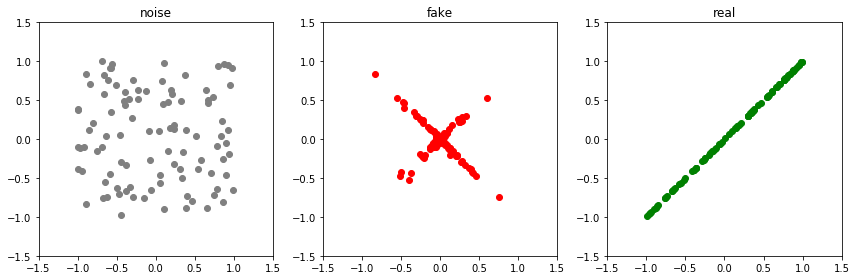

Epoch: 38150 G-error: 1.6606991291046143 D-error: 0.5449883341789246


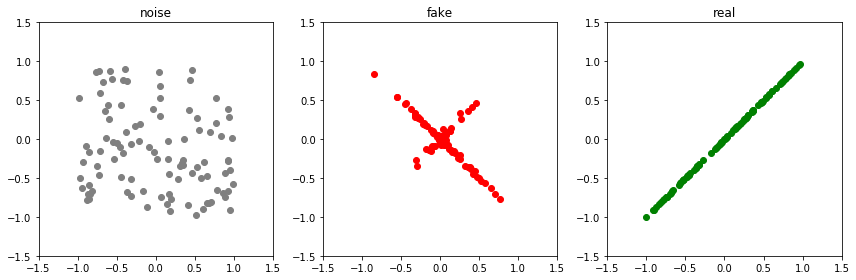

Epoch: 38200 G-error: 1.8889799118041992 D-error: 0.5773283839225769


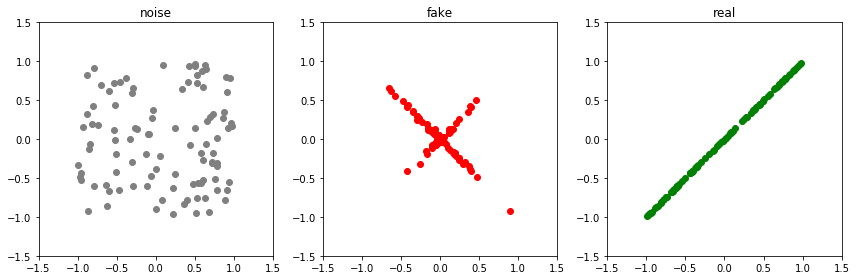

Epoch: 38250 G-error: 1.9168246984481812 D-error: 0.4922124743461609


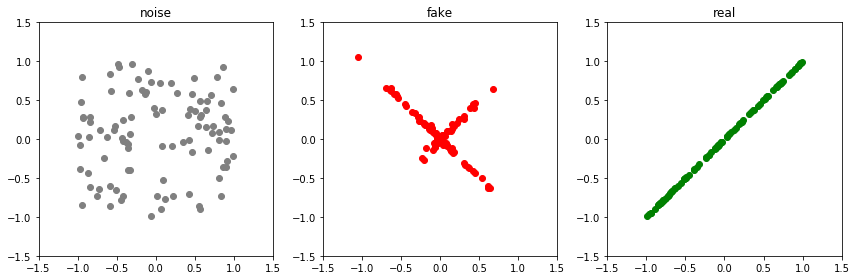

Epoch: 38300 G-error: 1.9981944561004639 D-error: 0.5244218111038208


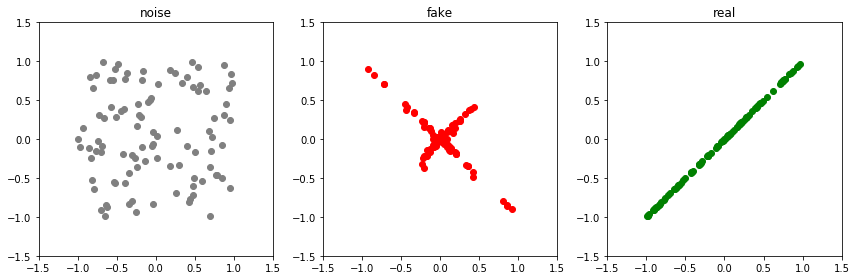

Epoch: 38350 G-error: 2.1068670749664307 D-error: 0.6088775992393494


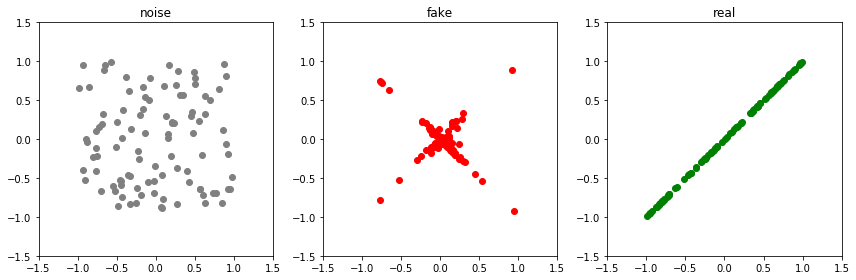

Epoch: 38400 G-error: 2.112039566040039 D-error: 0.4944545030593872


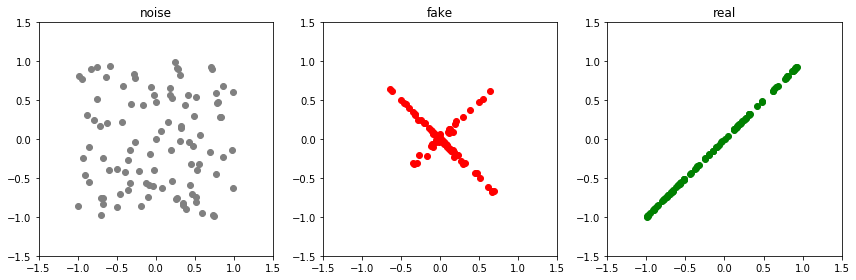

Epoch: 38450 G-error: 2.0751259326934814 D-error: 0.49476367235183716


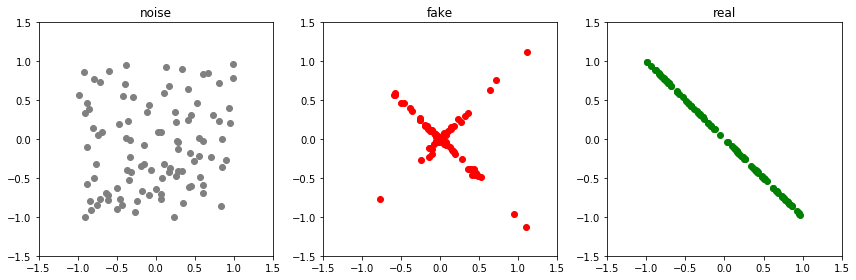

Epoch: 38500 G-error: 2.314333915710449 D-error: 3.750159740447998


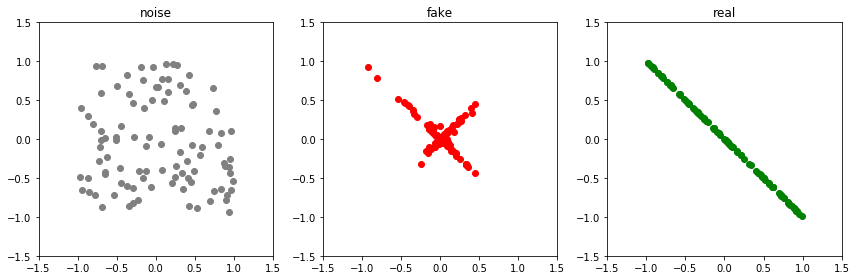

Epoch: 38550 G-error: 1.0798125267028809 D-error: 1.0464906692504883


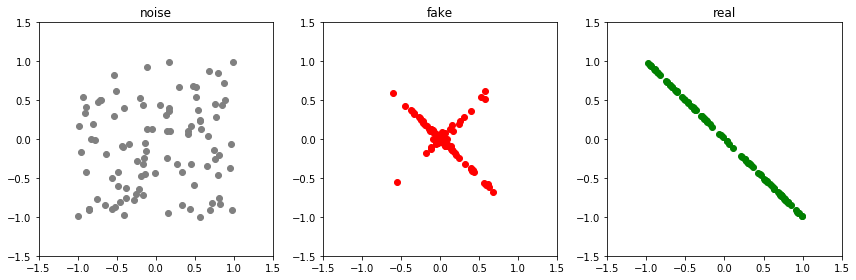

Epoch: 38600 G-error: 1.3177757263183594 D-error: 0.8081905245780945


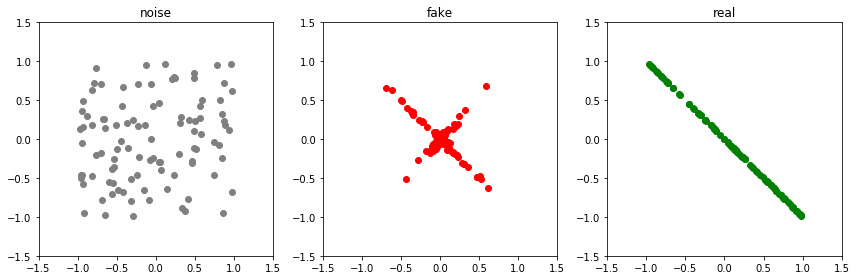

Epoch: 38650 G-error: 1.3266633749008179 D-error: 0.8851865530014038


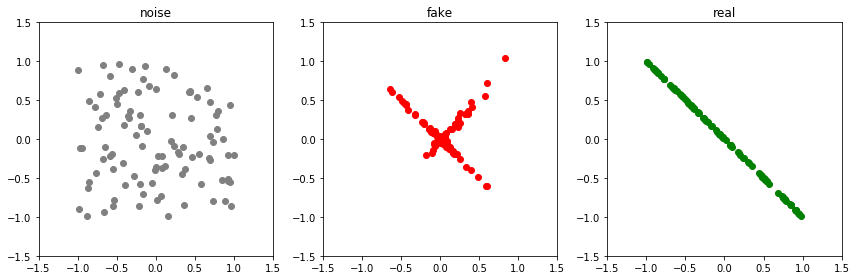

Epoch: 38700 G-error: 1.4845830202102661 D-error: 0.8323407173156738


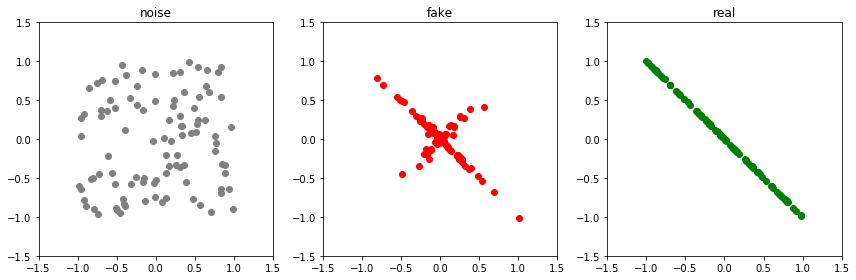

Epoch: 38750 G-error: 1.45488703250885 D-error: 0.9672718048095703


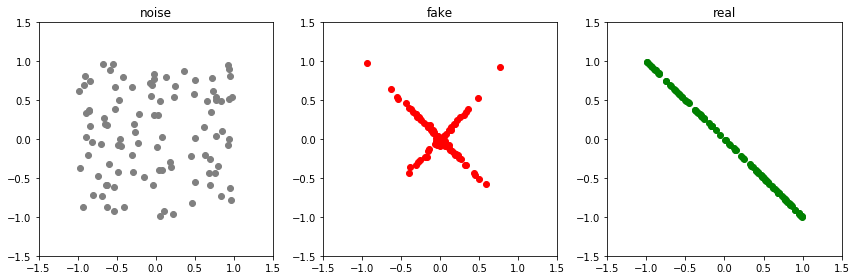

Epoch: 38800 G-error: 1.4635146856307983 D-error: 0.6576462388038635


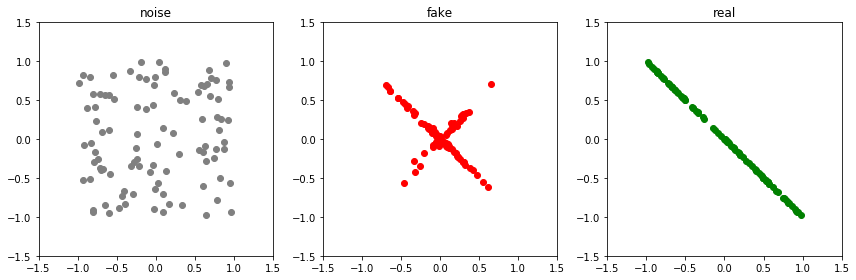

Epoch: 38850 G-error: 1.656984567642212 D-error: 0.8693878650665283


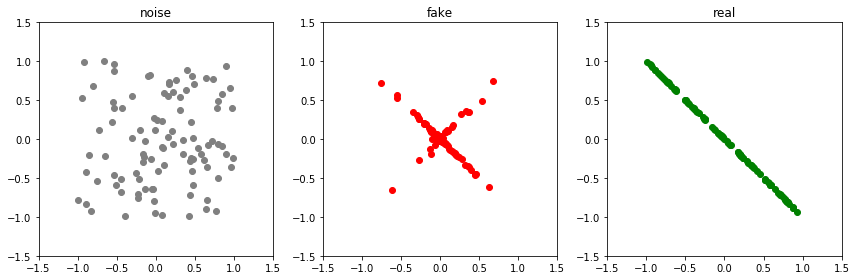

Epoch: 38900 G-error: 1.7054290771484375 D-error: 0.8515981435775757


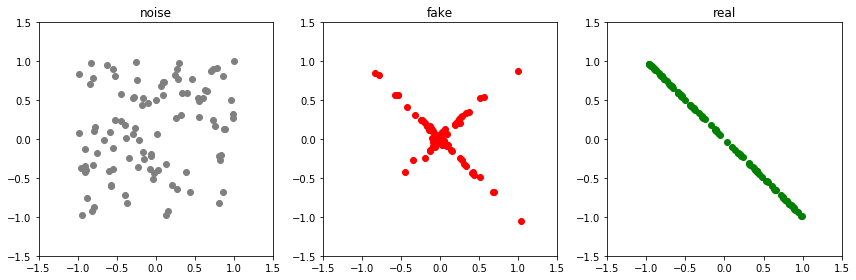

Epoch: 38950 G-error: 1.3798692226409912 D-error: 0.7293139696121216


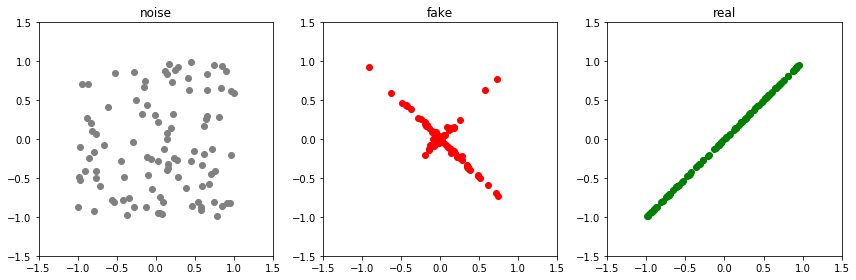

Epoch: 39000 G-error: 1.458024024963379 D-error: 2.174906015396118


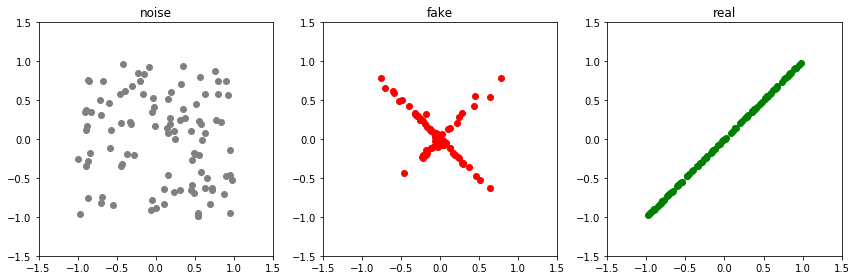

Epoch: 39050 G-error: 1.3614094257354736 D-error: 0.789487361907959


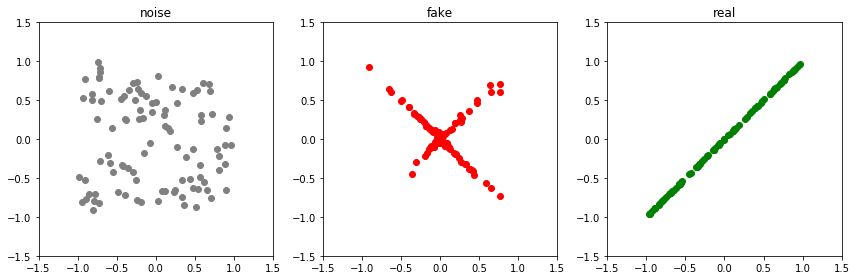

Epoch: 39100 G-error: 1.4822732210159302 D-error: 0.7249225378036499


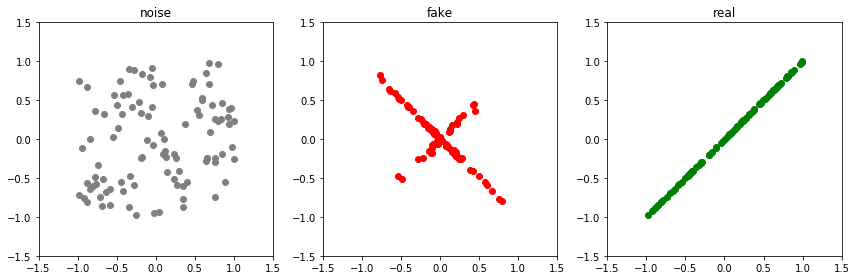

Epoch: 39150 G-error: 1.7179756164550781 D-error: 0.5953985452651978


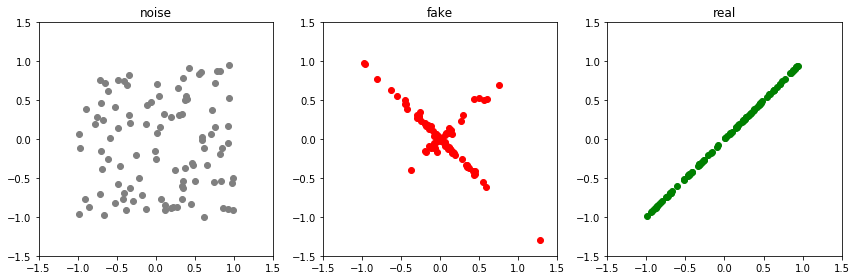

Epoch: 39200 G-error: 1.940843105316162 D-error: 0.5451799631118774


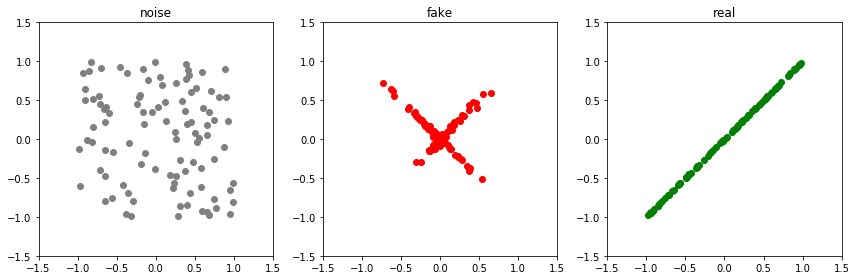

Epoch: 39250 G-error: 1.9749994277954102 D-error: 0.5670725703239441


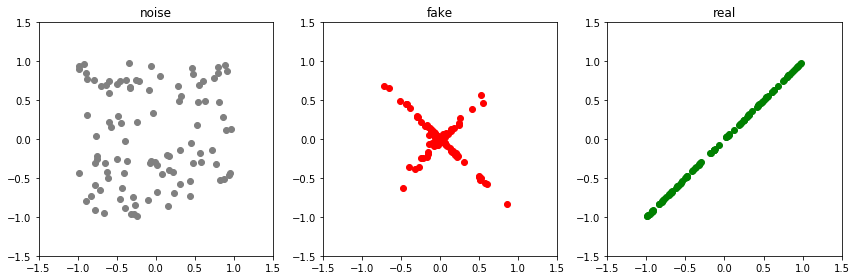

Epoch: 39300 G-error: 1.9771884679794312 D-error: 0.4879135489463806


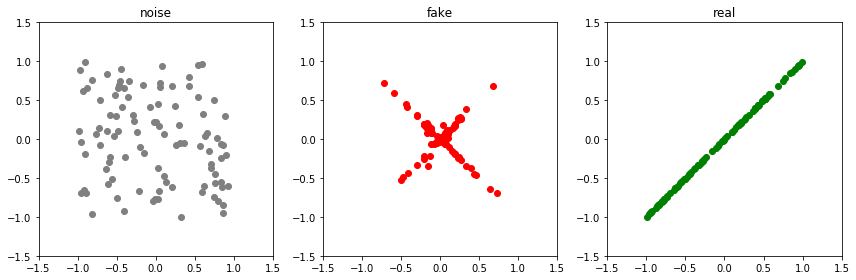

Epoch: 39350 G-error: 2.011643171310425 D-error: 0.5962957143783569


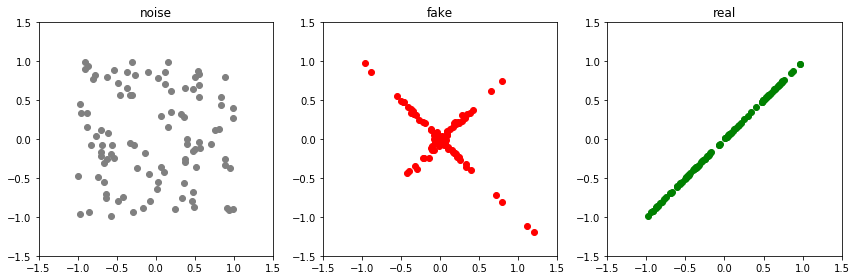

Epoch: 39400 G-error: 2.0848748683929443 D-error: 0.5538173913955688


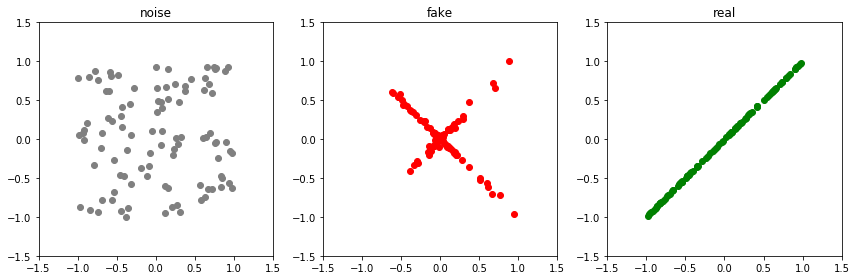

Epoch: 39450 G-error: 2.134683847427368 D-error: 0.559333086013794


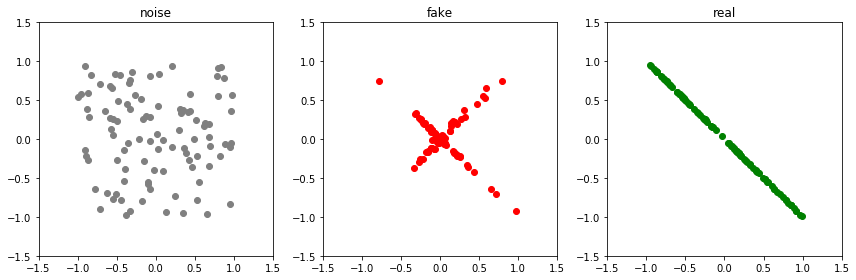

Epoch: 39500 G-error: 2.2590792179107666 D-error: 3.6058928966522217


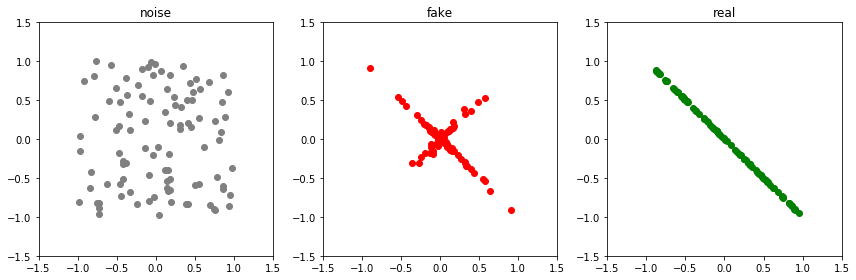

Epoch: 39550 G-error: 0.976223886013031 D-error: 1.1223773956298828


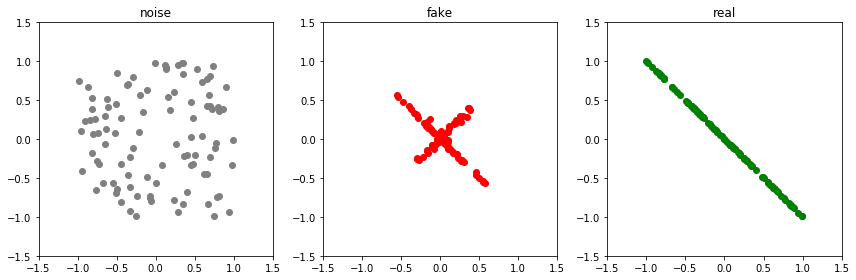

Epoch: 39600 G-error: 1.3219646215438843 D-error: 0.9605303406715393


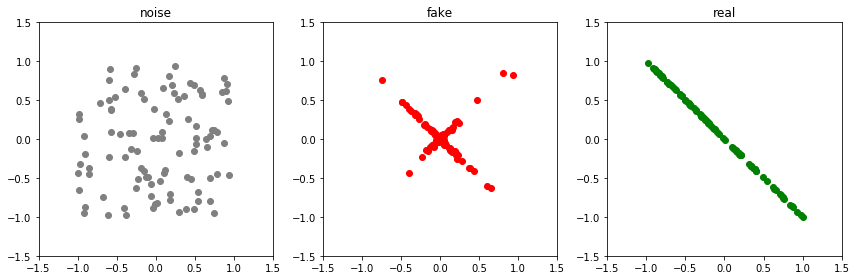

Epoch: 39650 G-error: 1.3423712253570557 D-error: 0.8730196952819824


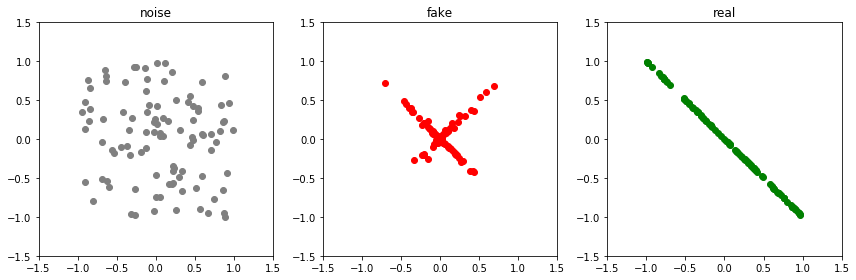

Epoch: 39700 G-error: 1.5567800998687744 D-error: 0.7486574053764343


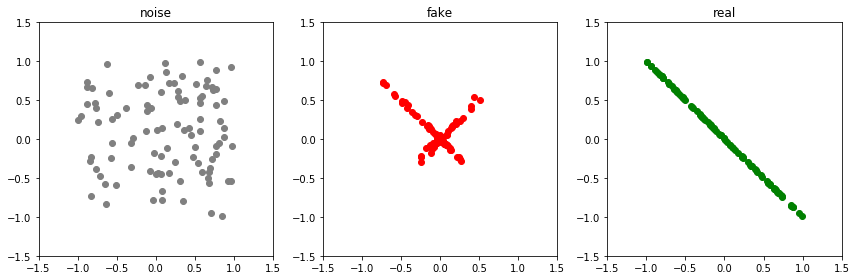

Epoch: 39750 G-error: 1.5225046873092651 D-error: 0.822670578956604


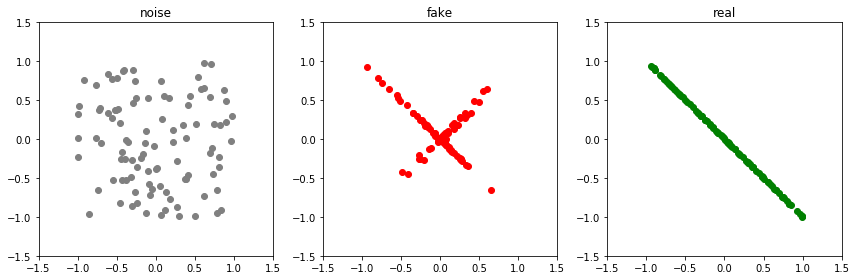

Epoch: 39800 G-error: 1.503625512123108 D-error: 0.8767561912536621


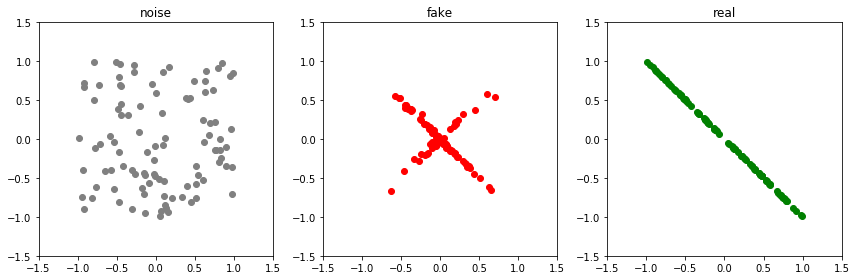

Epoch: 39850 G-error: 1.6900644302368164 D-error: 0.8450491428375244


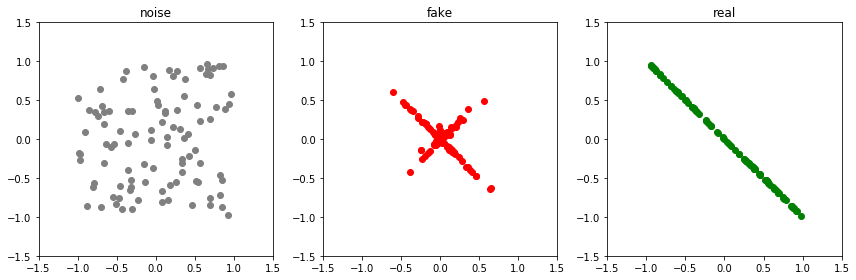

Epoch: 39900 G-error: 1.545395016670227 D-error: 0.751602053642273


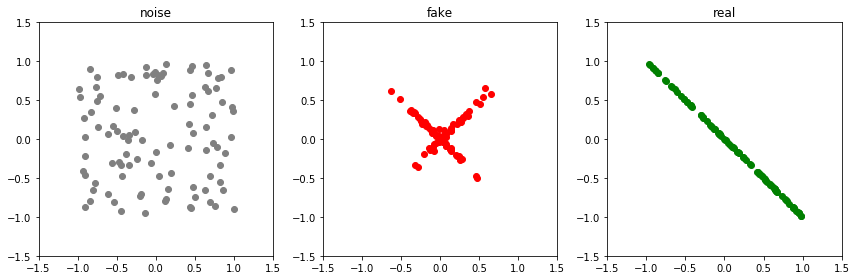

Epoch: 39950 G-error: 1.6442205905914307 D-error: 0.7590291500091553


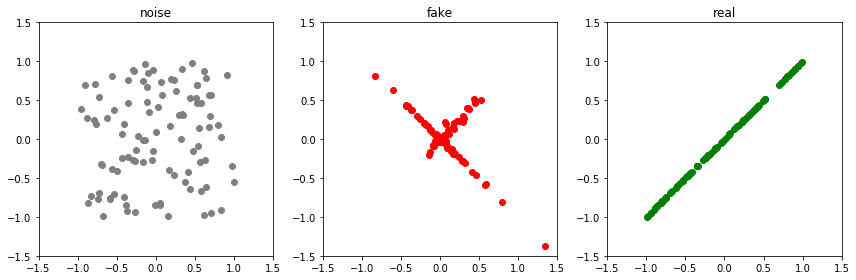

Epoch: 40000 G-error: 1.6292287111282349 D-error: 2.2756268978118896


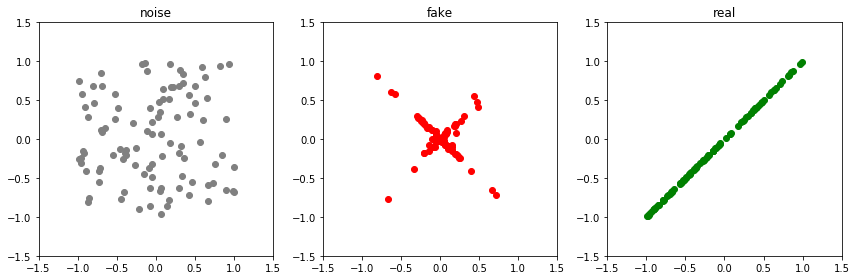

Epoch: 40050 G-error: 1.2993767261505127 D-error: 0.8175239562988281


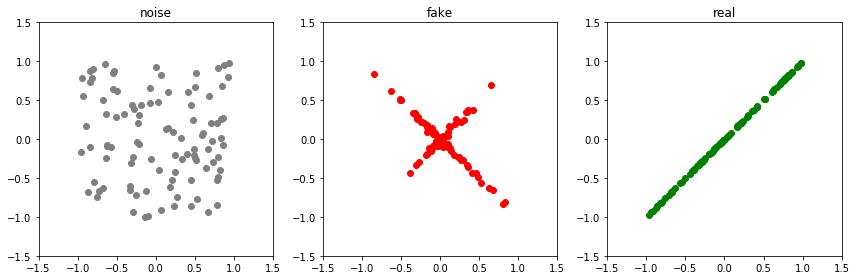

Epoch: 40100 G-error: 1.5204896926879883 D-error: 0.7398200035095215


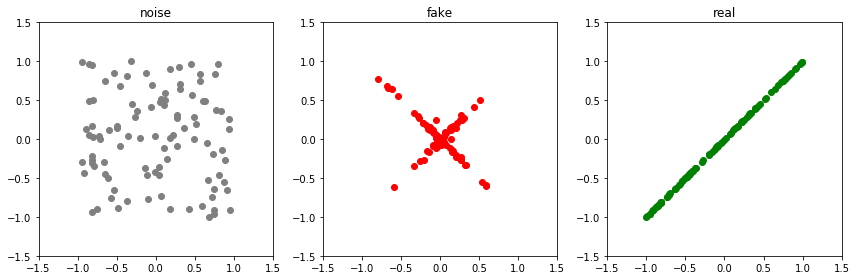

Epoch: 40150 G-error: 1.701877474784851 D-error: 0.6117072105407715


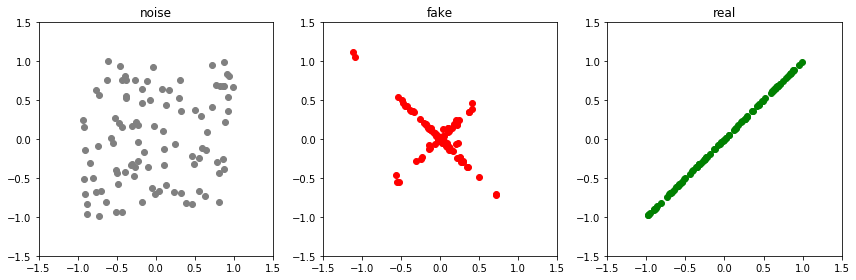

Epoch: 40200 G-error: 1.7931811809539795 D-error: 0.6702378988265991


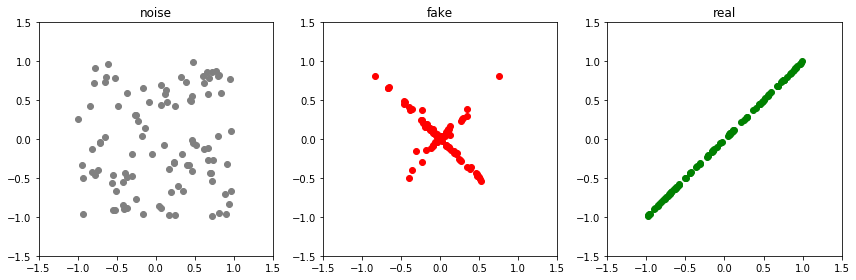

Epoch: 40250 G-error: 1.9850599765777588 D-error: 0.49211597442626953


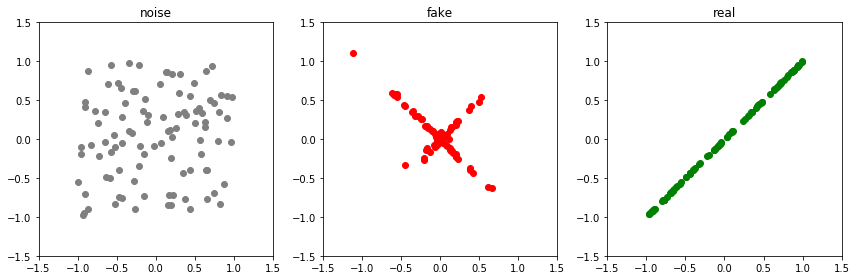

Epoch: 40300 G-error: 1.7665736675262451 D-error: 0.4908432960510254


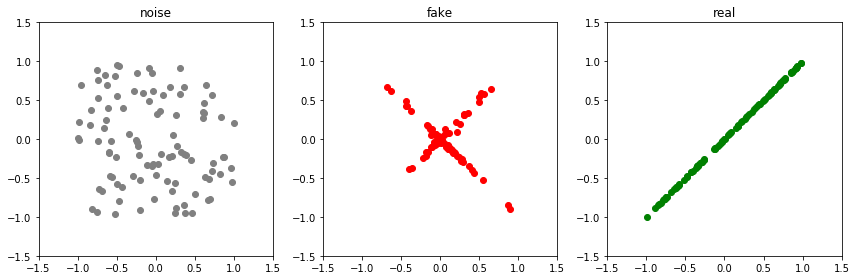

Epoch: 40350 G-error: 2.066650629043579 D-error: 0.5890843868255615


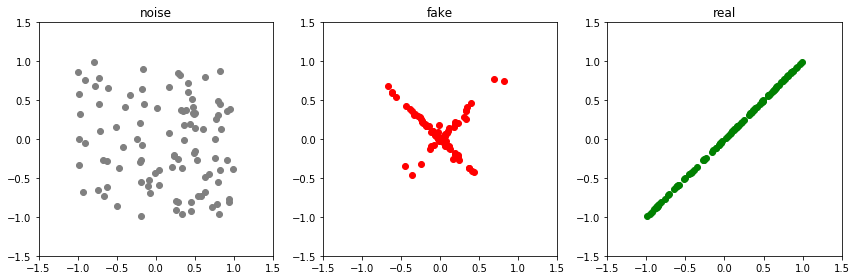

Epoch: 40400 G-error: 2.202418088912964 D-error: 0.54781174659729


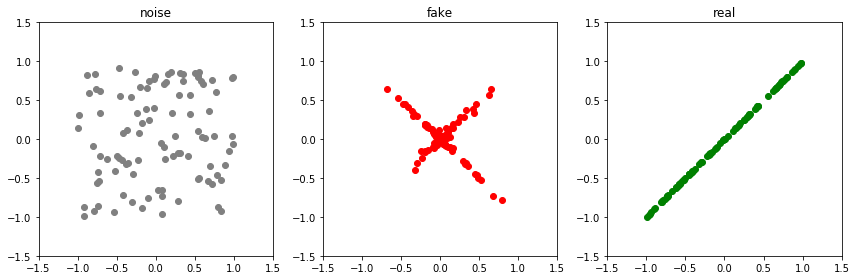

Epoch: 40450 G-error: 1.9382089376449585 D-error: 0.5217113494873047


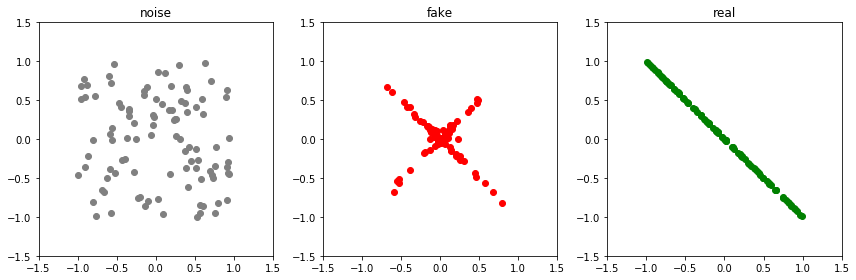

Epoch: 40500 G-error: 1.9613474607467651 D-error: 3.7173357009887695


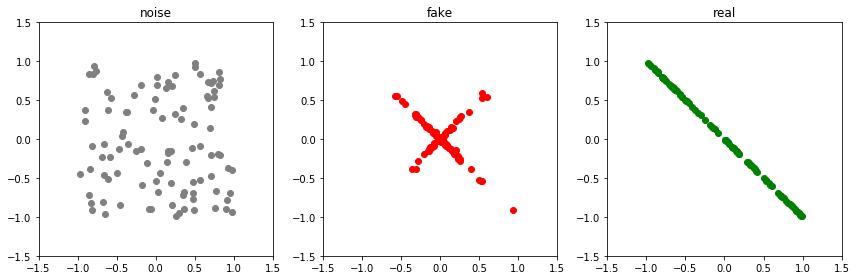

Epoch: 40550 G-error: 1.028115153312683 D-error: 1.0683844089508057


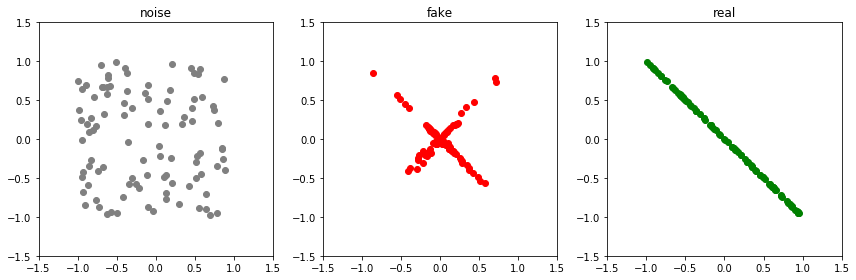

Epoch: 40600 G-error: 1.2849297523498535 D-error: 0.9300918579101562


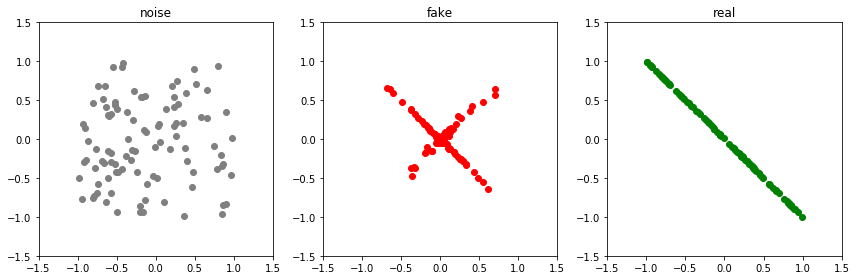

Epoch: 40650 G-error: 1.2840461730957031 D-error: 0.9024516344070435


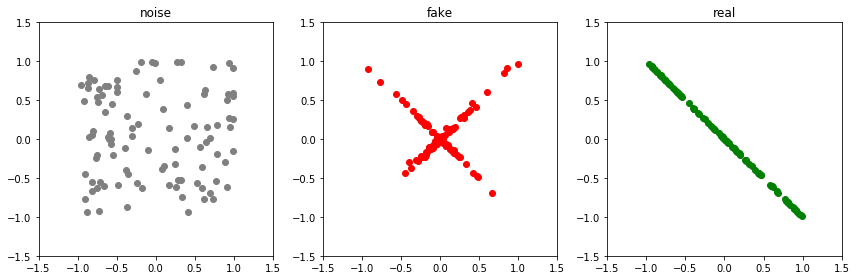

Epoch: 40700 G-error: 1.5730972290039062 D-error: 0.9114736318588257


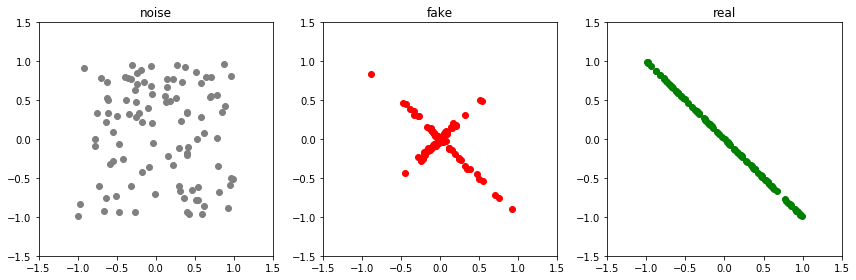

Epoch: 40750 G-error: 1.5073062181472778 D-error: 0.8289466500282288


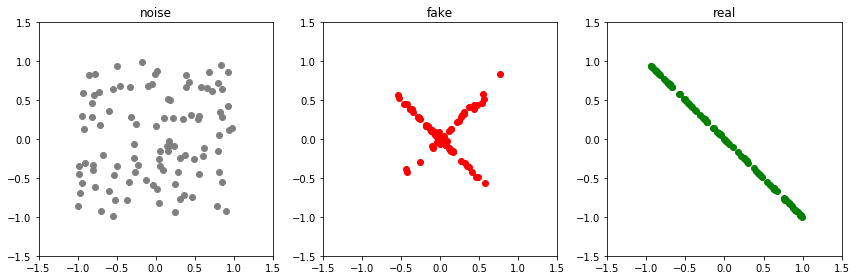

Epoch: 40800 G-error: 1.5008927583694458 D-error: 0.7395009994506836


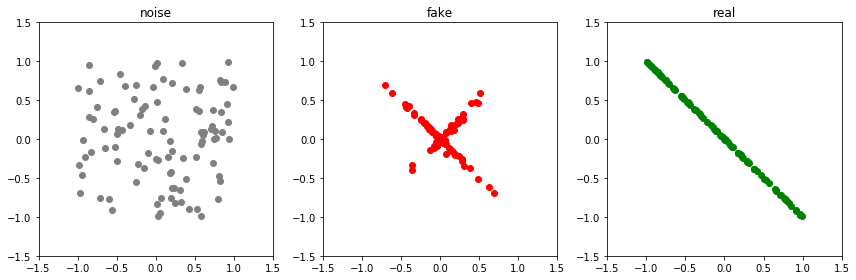

Epoch: 40850 G-error: 1.706264615058899 D-error: 0.8501408100128174


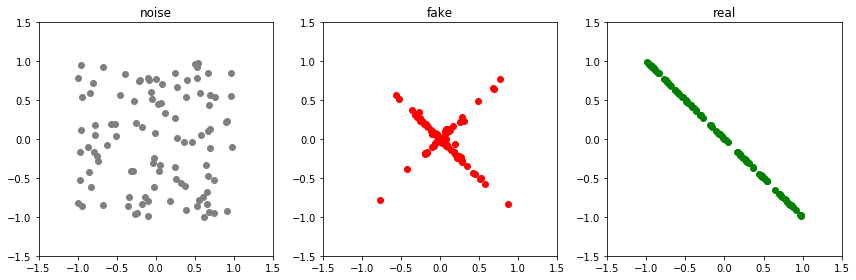

Epoch: 40900 G-error: 1.6525835990905762 D-error: 0.7958881855010986


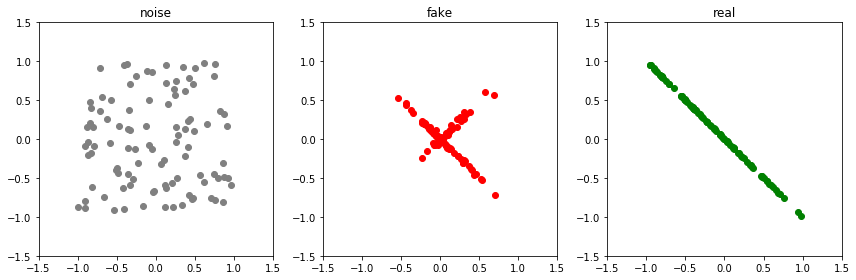

Epoch: 40950 G-error: 1.6645007133483887 D-error: 0.8895392417907715


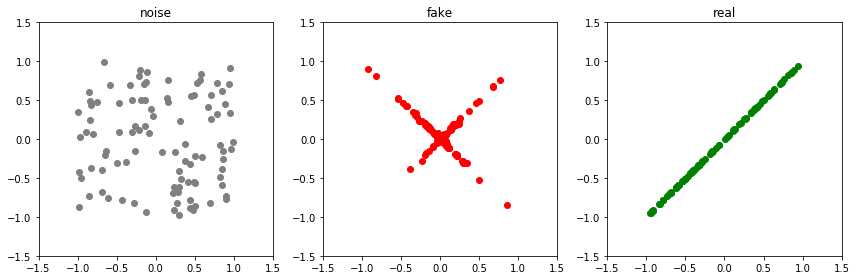

Epoch: 41000 G-error: 1.4615451097488403 D-error: 2.38614821434021


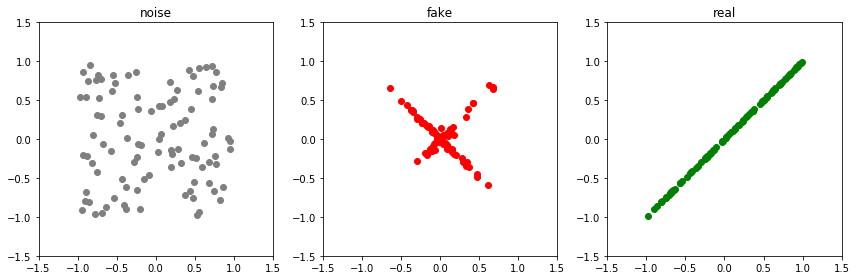

Epoch: 41050 G-error: 1.2663557529449463 D-error: 0.8596044778823853


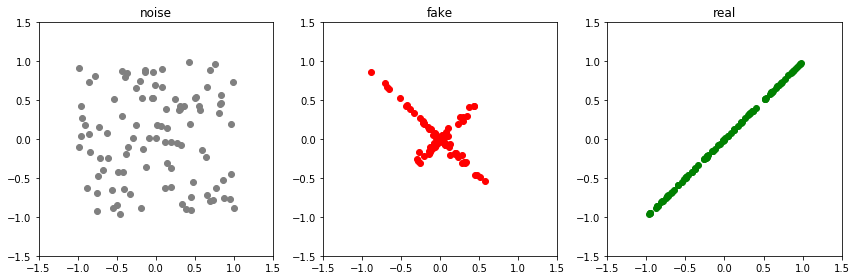

Epoch: 41100 G-error: 1.4629254341125488 D-error: 0.6584835052490234


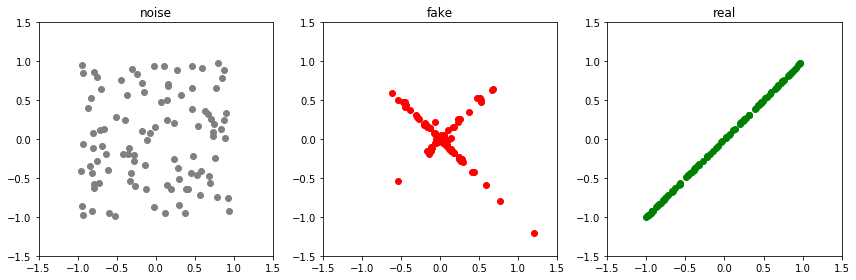

Epoch: 41150 G-error: 1.506704568862915 D-error: 0.5931577682495117


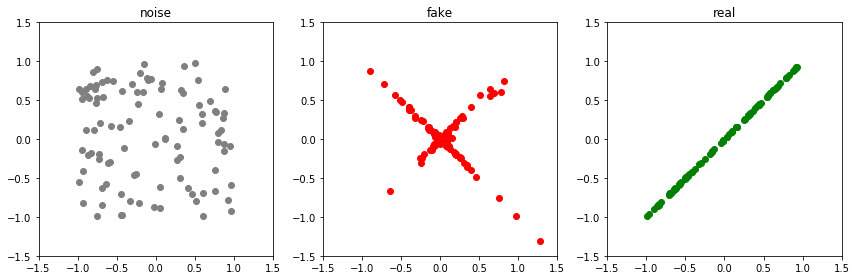

Epoch: 41200 G-error: 1.7639929056167603 D-error: 0.5572491884231567


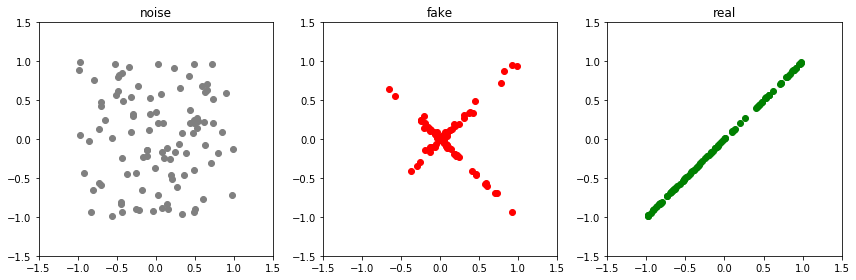

Epoch: 41250 G-error: 1.8594295978546143 D-error: 0.5941043496131897


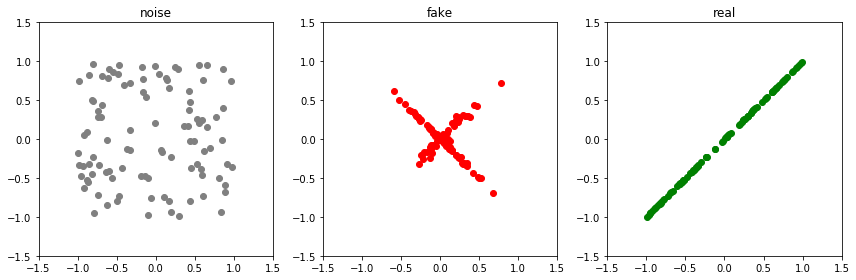

Epoch: 41300 G-error: 1.8108104467391968 D-error: 0.514009952545166


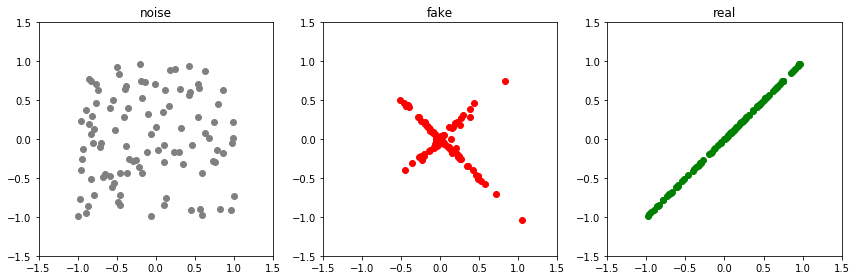

Epoch: 41350 G-error: 2.0835790634155273 D-error: 0.6133501529693604


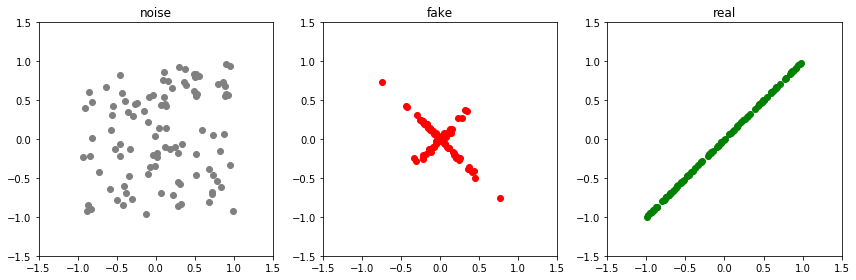

Epoch: 41400 G-error: 2.029262065887451 D-error: 0.46879029273986816


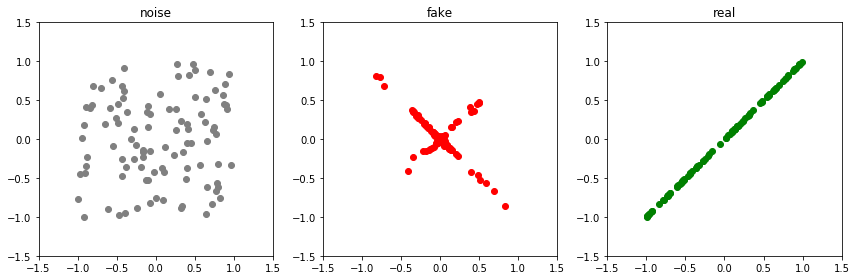

Epoch: 41450 G-error: 2.1862664222717285 D-error: 0.5068798661231995


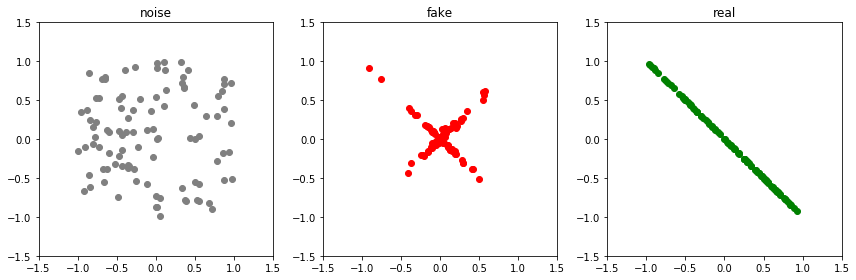

Epoch: 41500 G-error: 2.202009677886963 D-error: 3.5924484729766846


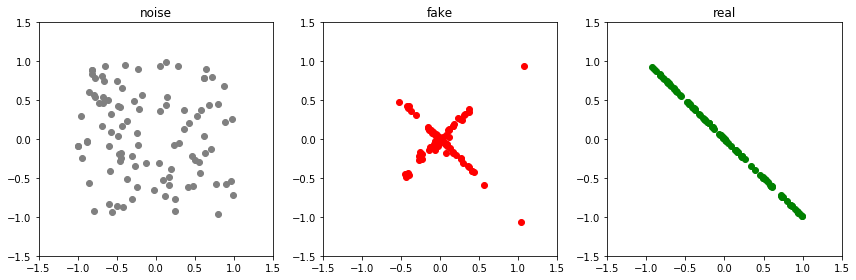

Epoch: 41550 G-error: 1.0709303617477417 D-error: 1.2122093439102173


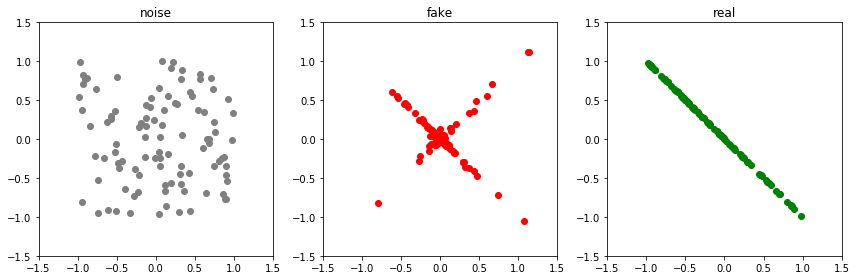

Epoch: 41600 G-error: 1.3337839841842651 D-error: 0.896061897277832


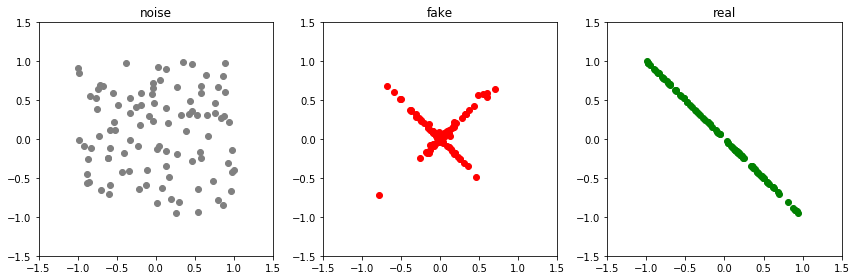

Epoch: 41650 G-error: 1.4393599033355713 D-error: 0.941137433052063


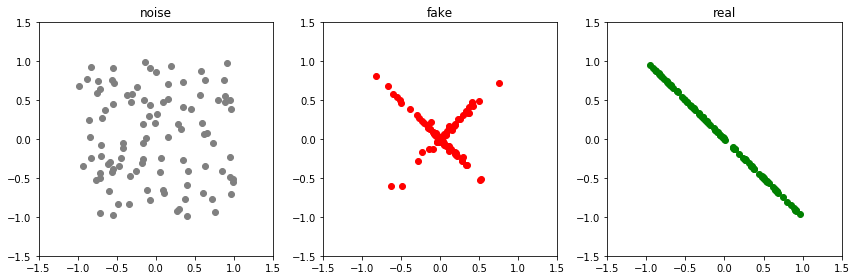

Epoch: 41700 G-error: 1.401553750038147 D-error: 0.8938565850257874


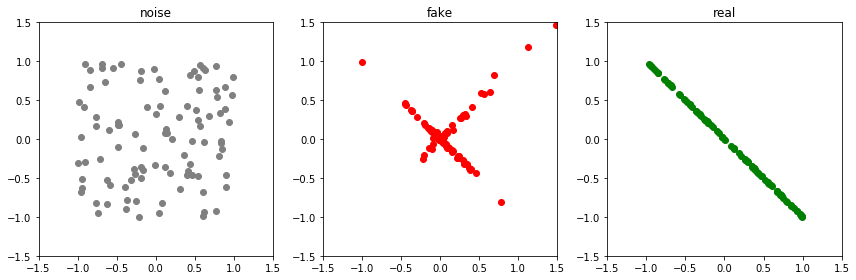

Epoch: 41750 G-error: 1.4249094724655151 D-error: 0.7918042540550232


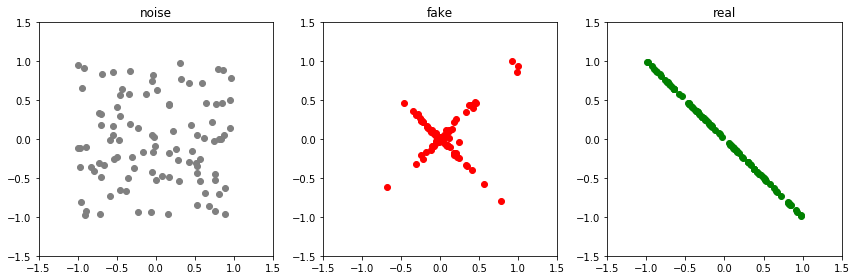

Epoch: 41800 G-error: 1.6469398736953735 D-error: 0.7217044830322266


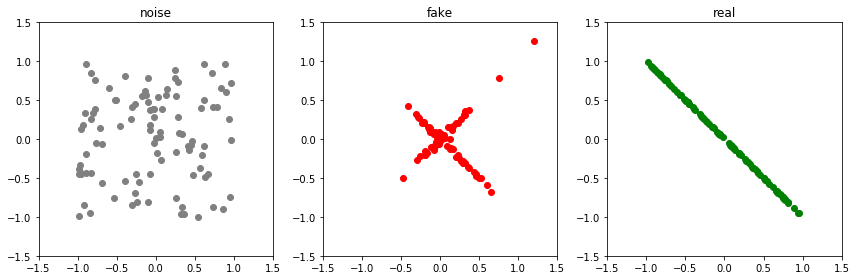

Epoch: 41850 G-error: 1.6971702575683594 D-error: 0.7909876108169556


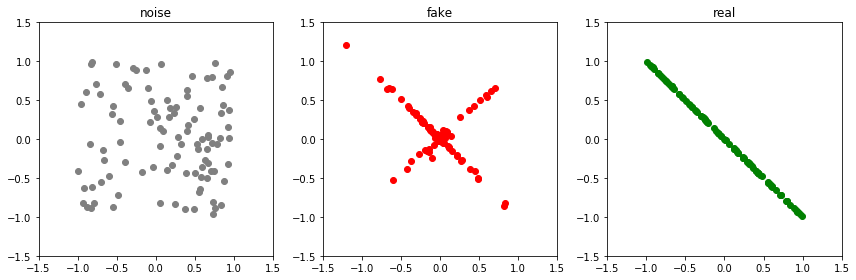

Epoch: 41900 G-error: 1.5679349899291992 D-error: 0.9388611316680908


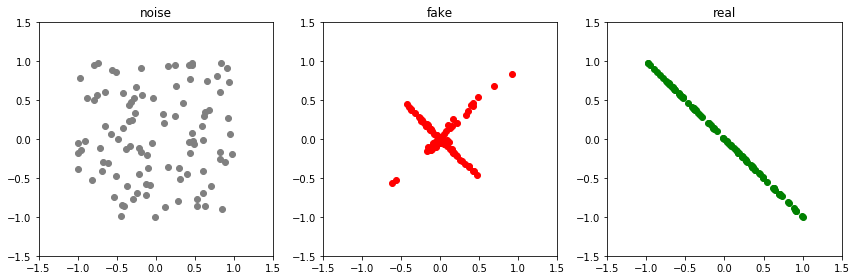

Epoch: 41950 G-error: 1.5845887660980225 D-error: 0.7540045976638794


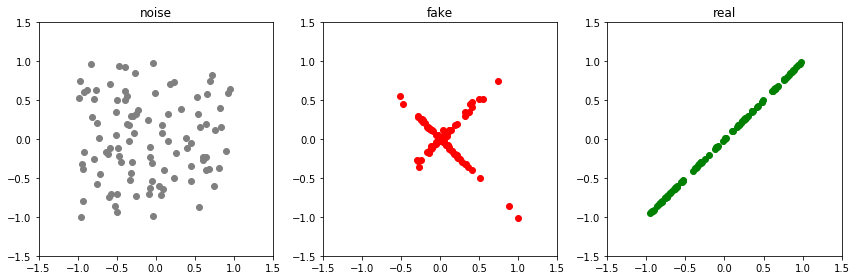

Epoch: 42000 G-error: 1.620683193206787 D-error: 2.401411533355713


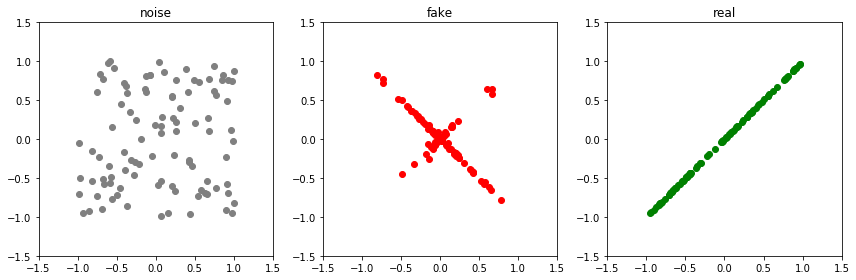

Epoch: 42050 G-error: 1.2312052249908447 D-error: 0.9115411639213562


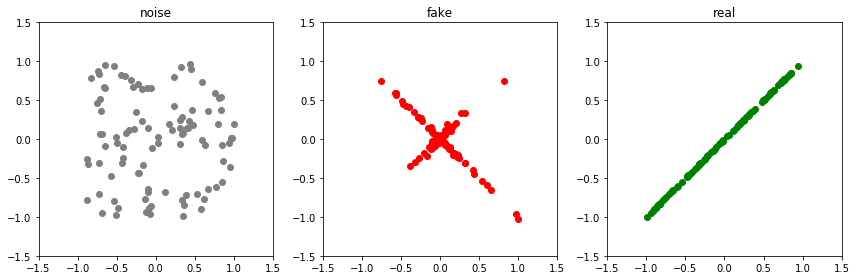

Epoch: 42100 G-error: 1.3480228185653687 D-error: 0.6515493988990784


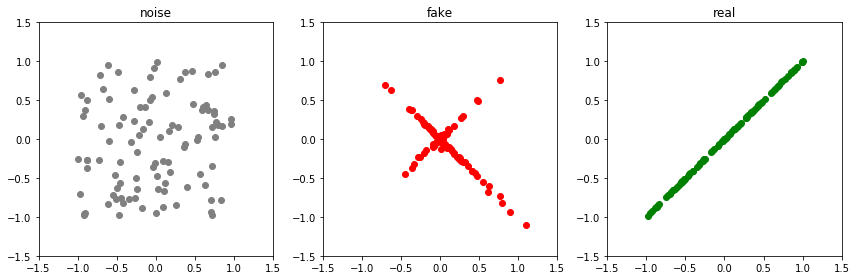

Epoch: 42150 G-error: 1.6364752054214478 D-error: 0.6508240699768066


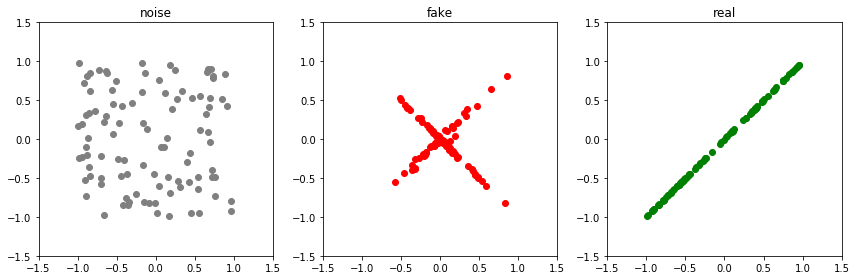

Epoch: 42200 G-error: 1.6581852436065674 D-error: 0.5787314176559448


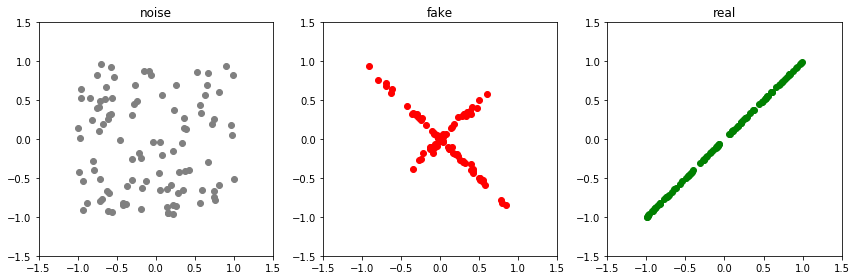

Epoch: 42250 G-error: 1.7468323707580566 D-error: 0.5678697824478149


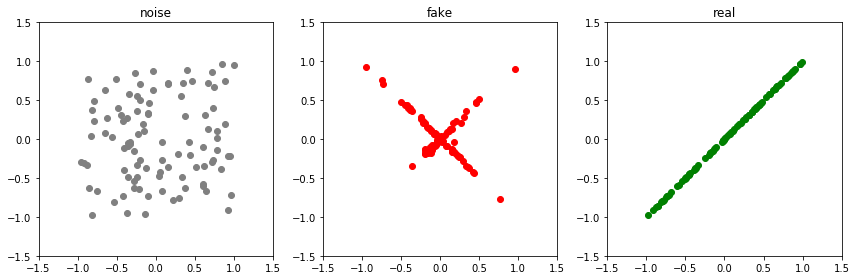

Epoch: 42300 G-error: 1.9137517213821411 D-error: 0.5944671630859375


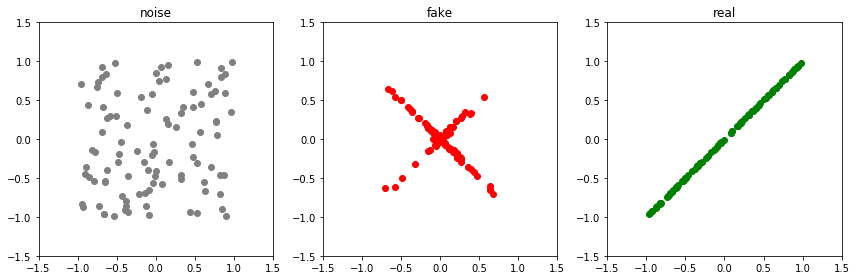

Epoch: 42350 G-error: 2.0723118782043457 D-error: 0.5654454231262207


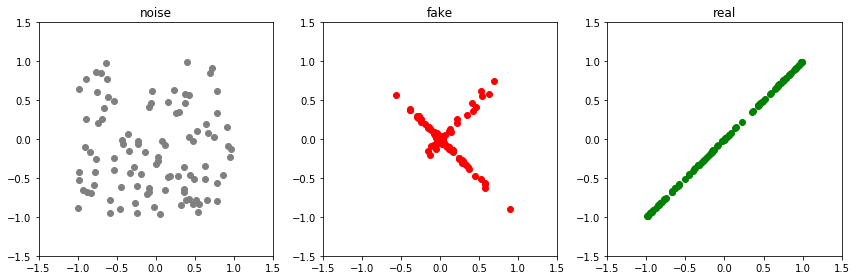

Epoch: 42400 G-error: 2.165093183517456 D-error: 0.6217833161354065


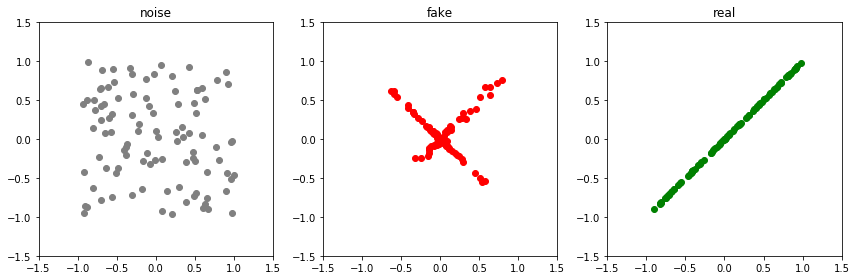

Epoch: 42450 G-error: 2.2573330402374268 D-error: 0.6458250880241394


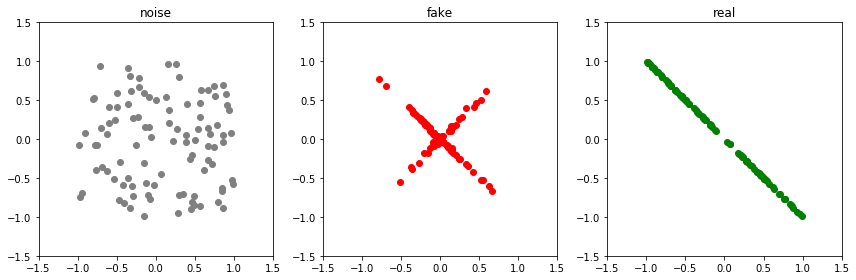

Epoch: 42500 G-error: 1.9846519231796265 D-error: 3.818511724472046


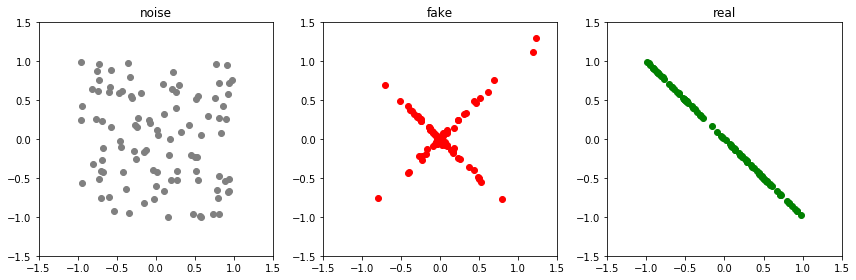

Epoch: 42550 G-error: 1.0543102025985718 D-error: 1.24684739112854


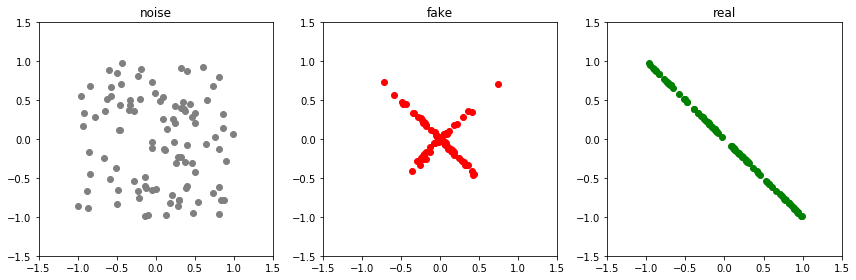

Epoch: 42600 G-error: 1.2760965824127197 D-error: 0.9248311519622803


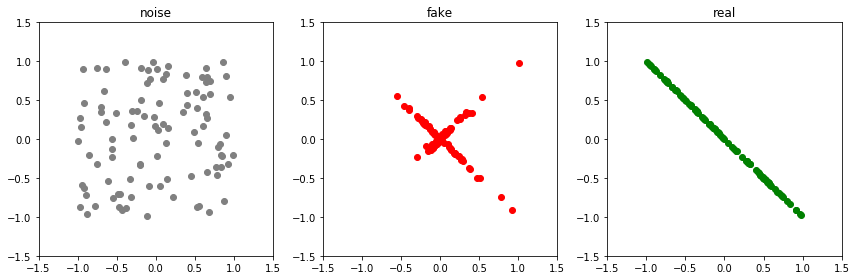

Epoch: 42650 G-error: 1.2942994832992554 D-error: 0.8342962265014648


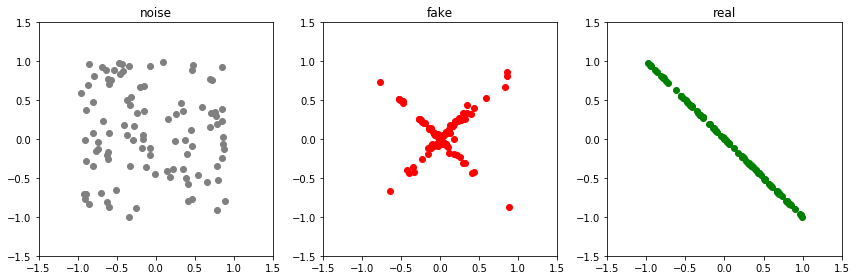

Epoch: 42700 G-error: 1.5463334321975708 D-error: 0.8330614566802979


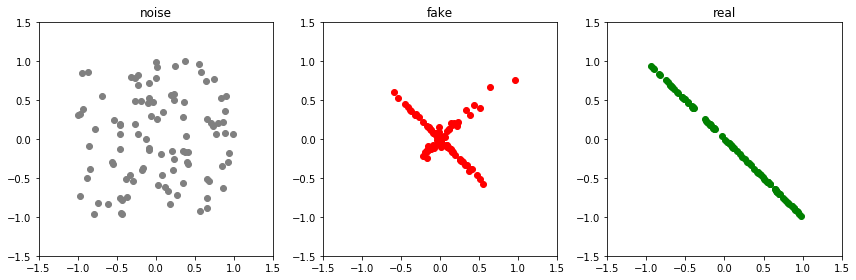

Epoch: 42750 G-error: 1.5277791023254395 D-error: 0.8035813570022583


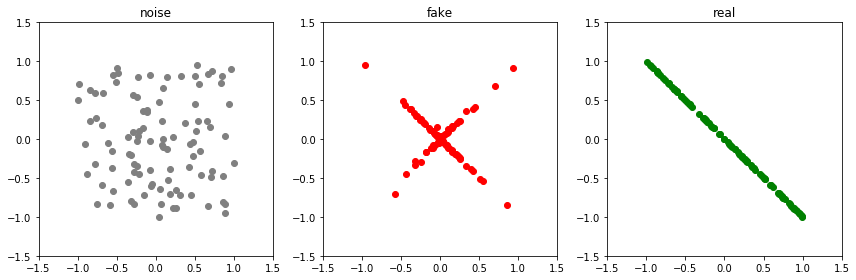

Epoch: 42800 G-error: 1.5380749702453613 D-error: 0.6232626438140869


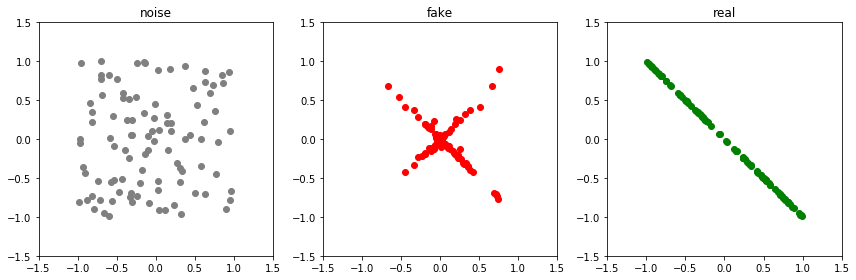

Epoch: 42850 G-error: 1.5401573181152344 D-error: 0.7142488956451416


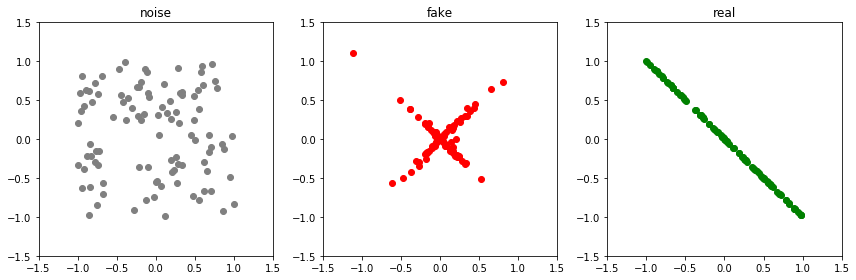

Epoch: 42900 G-error: 1.7075114250183105 D-error: 0.7540453672409058


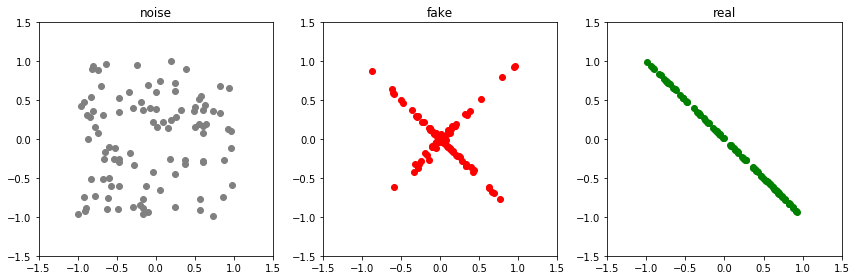

Epoch: 42950 G-error: 1.5794066190719604 D-error: 0.8832988739013672


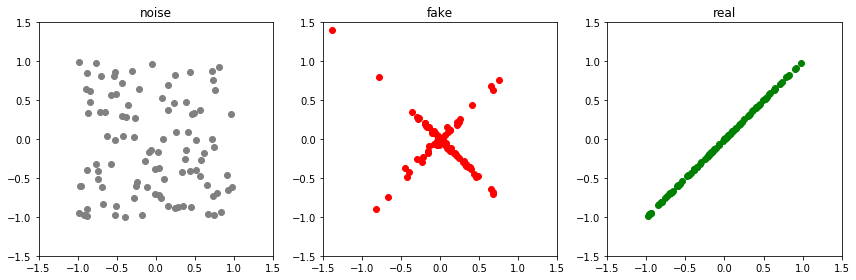

Epoch: 43000 G-error: 1.513401746749878 D-error: 2.543933629989624


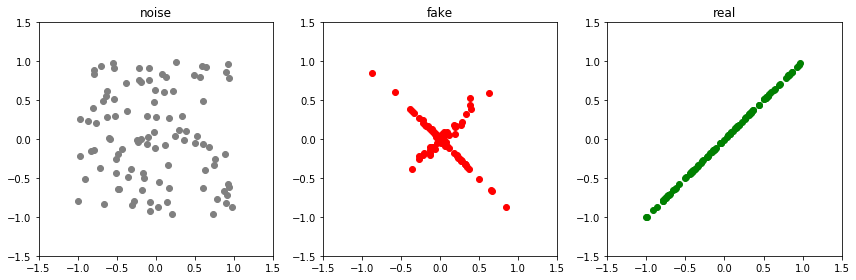

Epoch: 43050 G-error: 1.2548168897628784 D-error: 0.9272235631942749


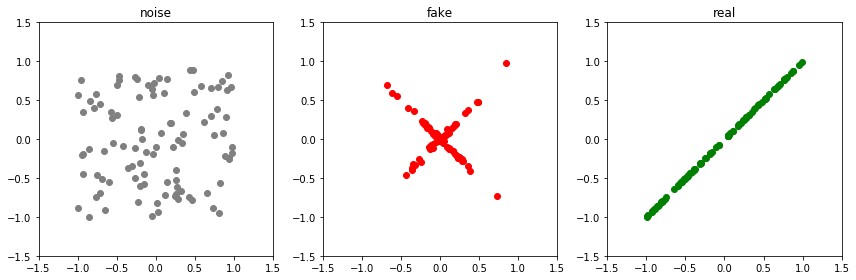

Epoch: 43100 G-error: 1.5032044649124146 D-error: 0.6828703284263611


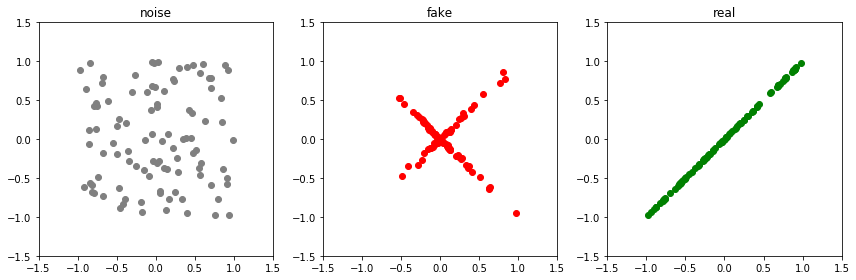

Epoch: 43150 G-error: 1.6343694925308228 D-error: 0.7141406536102295


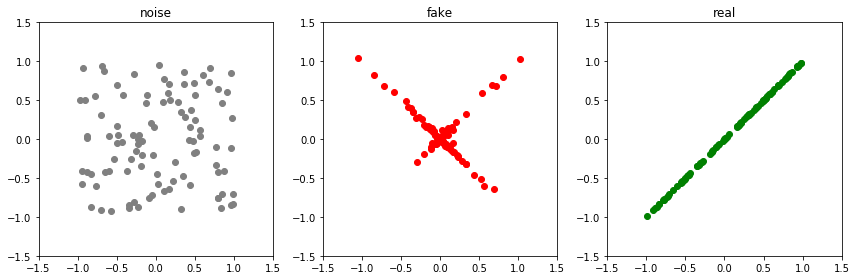

Epoch: 43200 G-error: 1.8806568384170532 D-error: 0.585547149181366


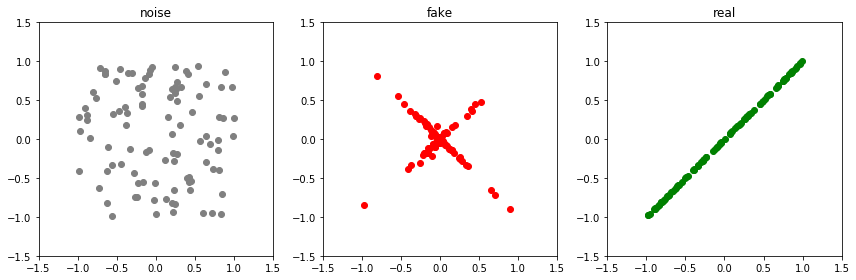

Epoch: 43250 G-error: 1.880690574645996 D-error: 0.5475461483001709


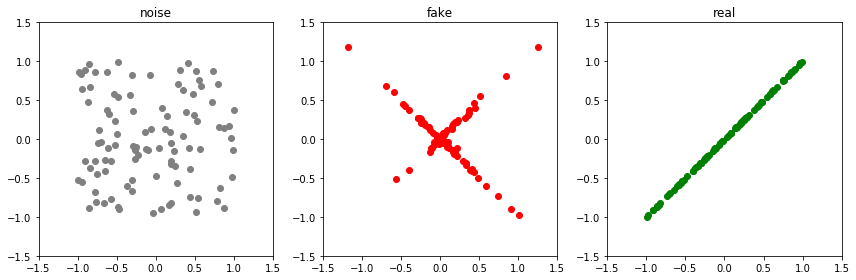

Epoch: 43300 G-error: 2.129528284072876 D-error: 0.6534827351570129


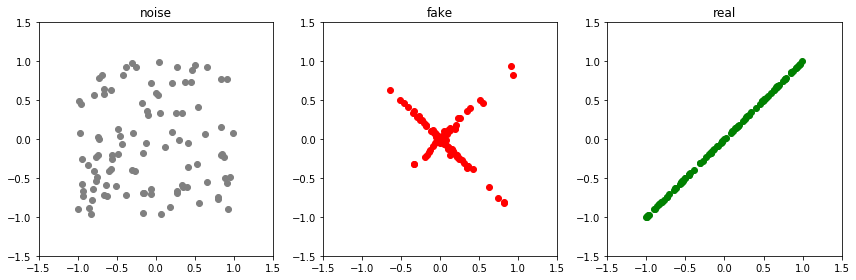

Epoch: 43350 G-error: 1.8976082801818848 D-error: 0.5370805859565735


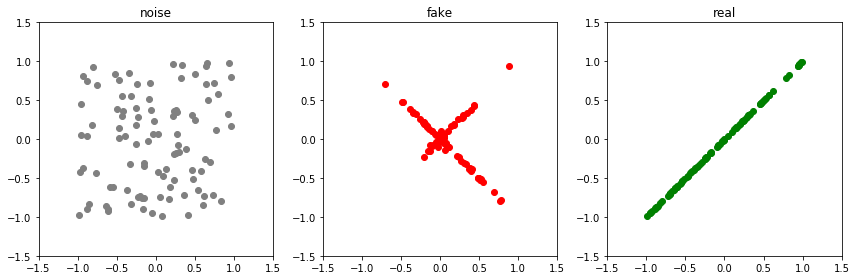

Epoch: 43400 G-error: 2.1109774112701416 D-error: 0.5498502254486084


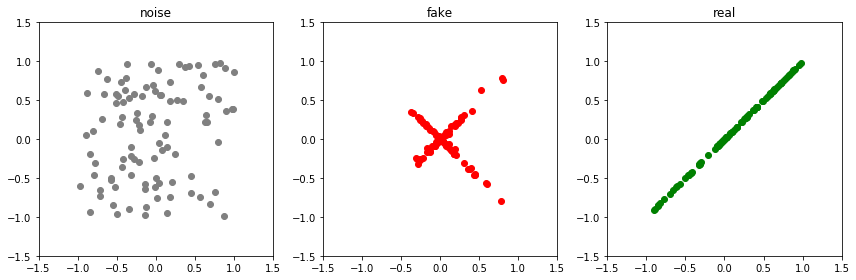

Epoch: 43450 G-error: 2.001404047012329 D-error: 0.6860300302505493


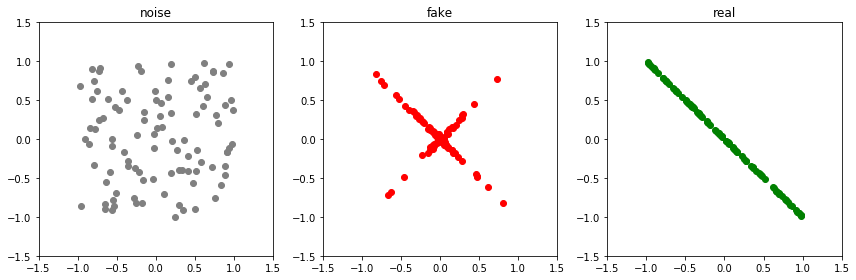

Epoch: 43500 G-error: 2.209725856781006 D-error: 3.6596240997314453


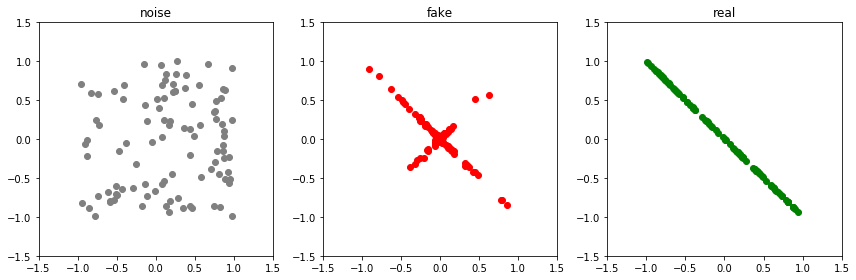

Epoch: 43550 G-error: 1.0743825435638428 D-error: 1.1365082263946533


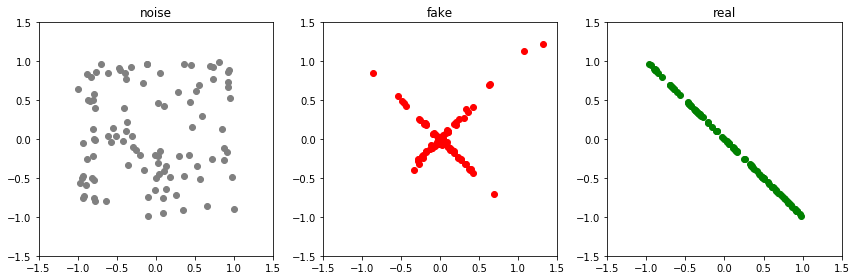

Epoch: 43600 G-error: 1.2908096313476562 D-error: 0.9639363288879395


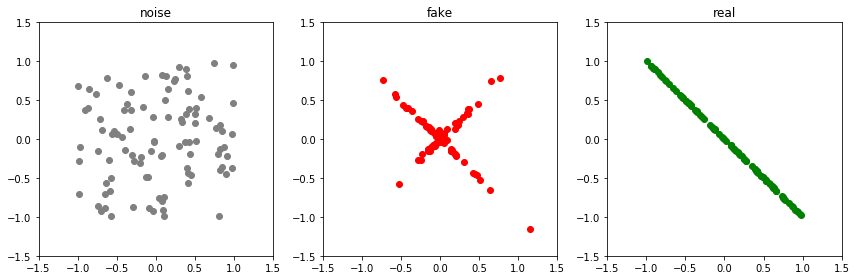

Epoch: 43650 G-error: 1.3580015897750854 D-error: 0.8932031393051147


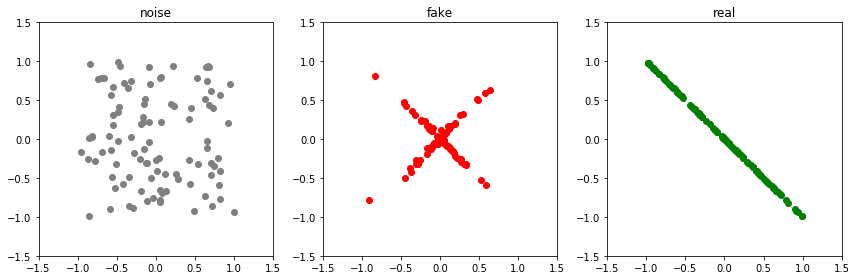

Epoch: 43700 G-error: 1.5376800298690796 D-error: 0.916131854057312


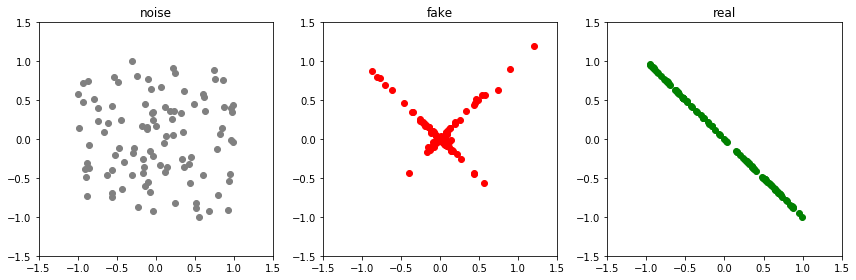

Epoch: 43750 G-error: 1.4507521390914917 D-error: 0.7567594051361084


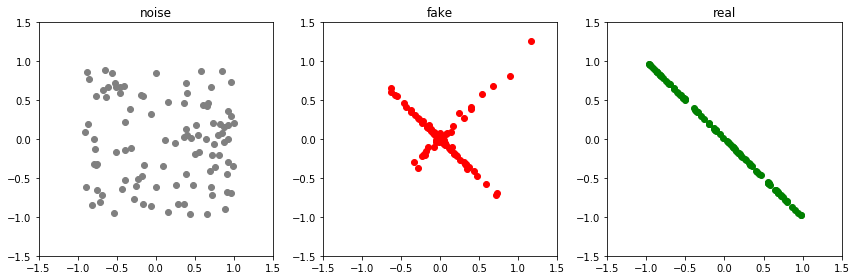

Epoch: 43800 G-error: 1.506943702697754 D-error: 0.8008618354797363


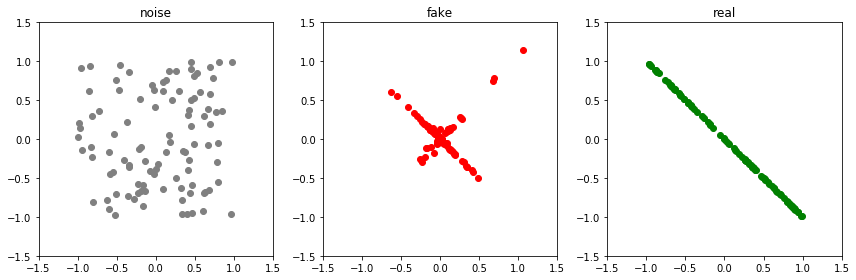

Epoch: 43850 G-error: 1.4370620250701904 D-error: 0.6694930195808411


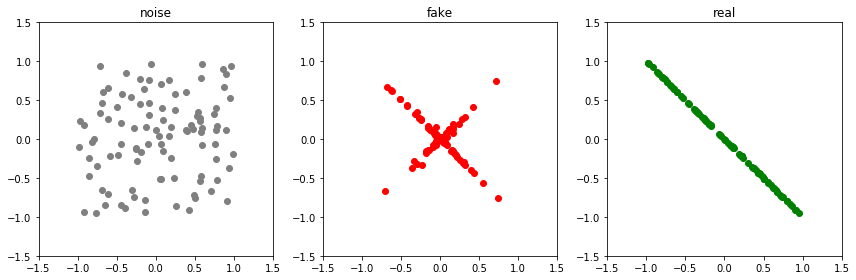

Epoch: 43900 G-error: 1.5155882835388184 D-error: 0.841164767742157


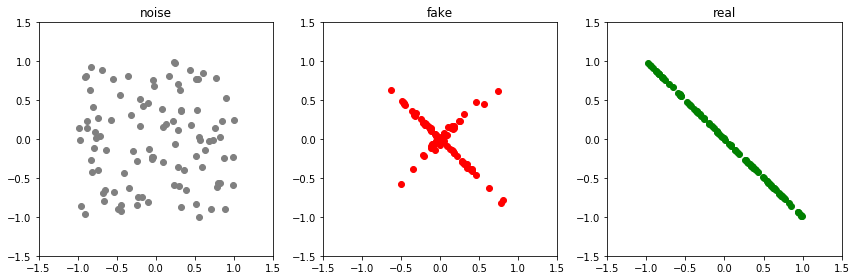

Epoch: 43950 G-error: 1.7229634523391724 D-error: 0.8500364422798157


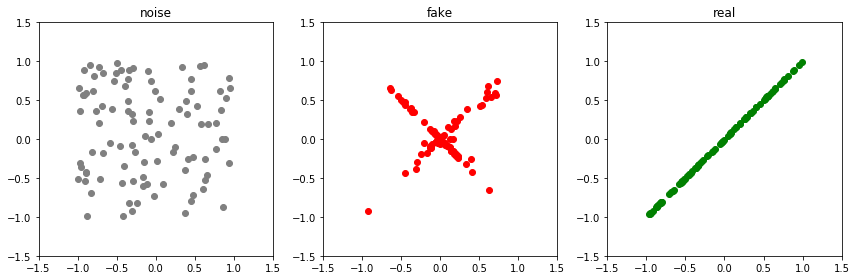

Epoch: 44000 G-error: 1.8648388385772705 D-error: 2.520368814468384


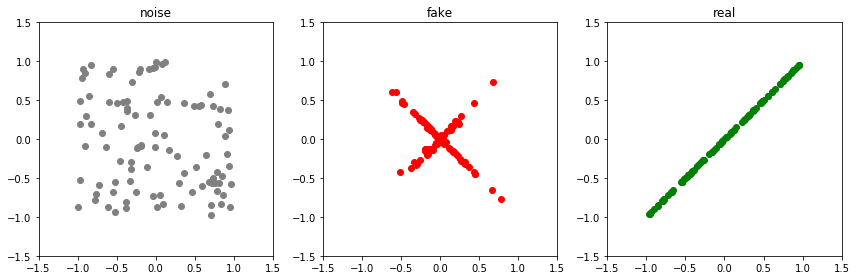

Epoch: 44050 G-error: 1.262620449066162 D-error: 0.9019853472709656


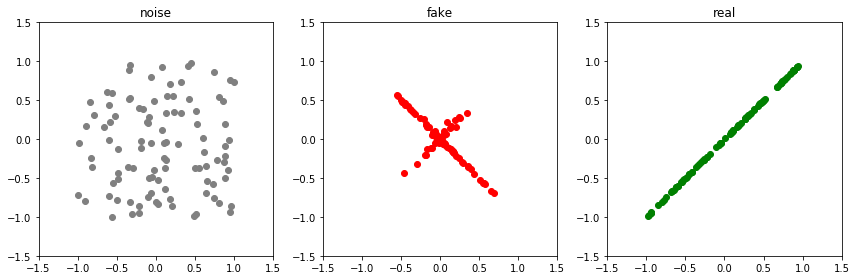

Epoch: 44100 G-error: 1.5213650465011597 D-error: 0.6272687911987305


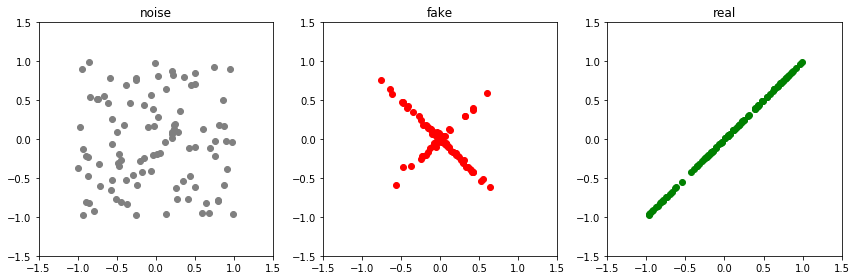

Epoch: 44150 G-error: 1.550492763519287 D-error: 0.6939249038696289


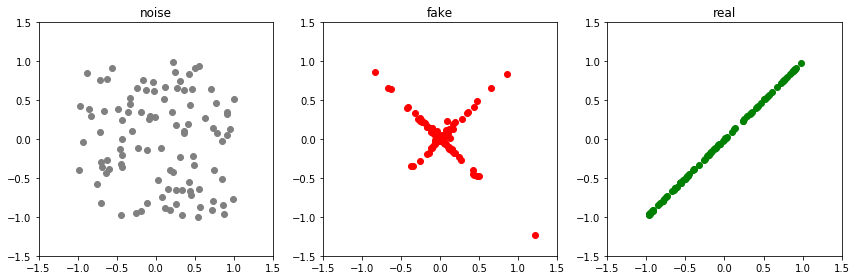

Epoch: 44200 G-error: 1.7831400632858276 D-error: 0.6053663492202759


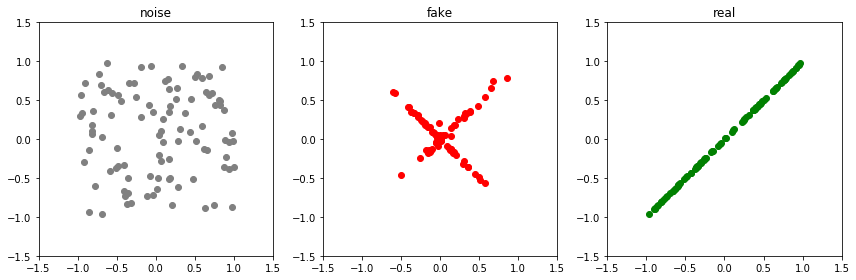

Epoch: 44250 G-error: 1.6578178405761719 D-error: 0.5642069578170776


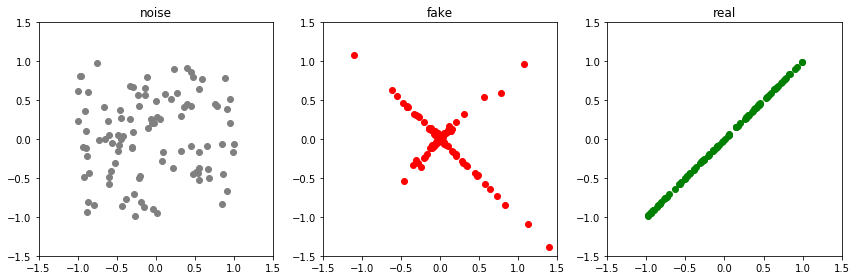

Epoch: 44300 G-error: 1.8390471935272217 D-error: 0.5649079084396362


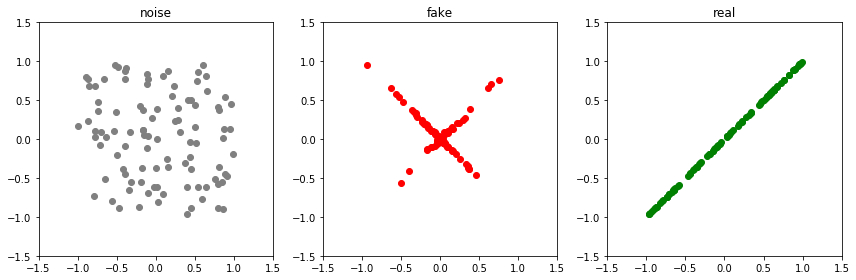

Epoch: 44350 G-error: 1.9732779264450073 D-error: 0.563477635383606


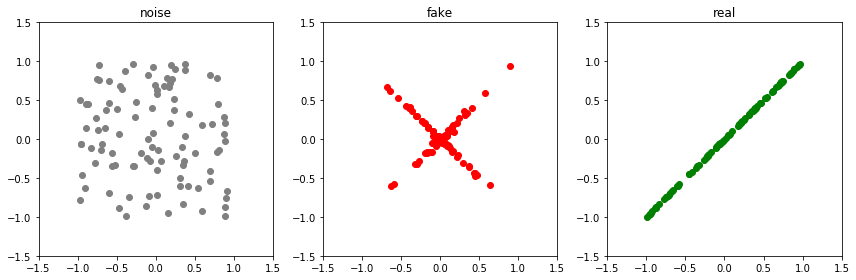

Epoch: 44400 G-error: 1.9563297033309937 D-error: 0.6596355438232422


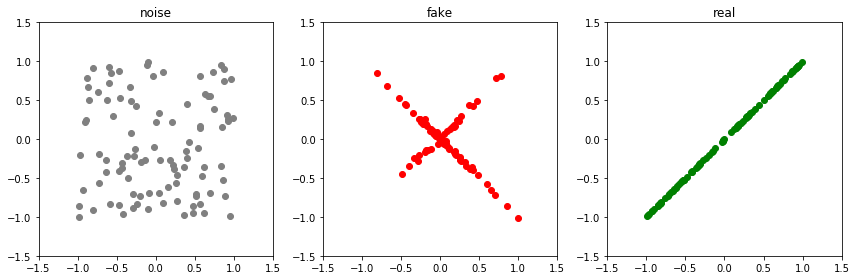

Epoch: 44450 G-error: 1.8247573375701904 D-error: 0.5203310251235962


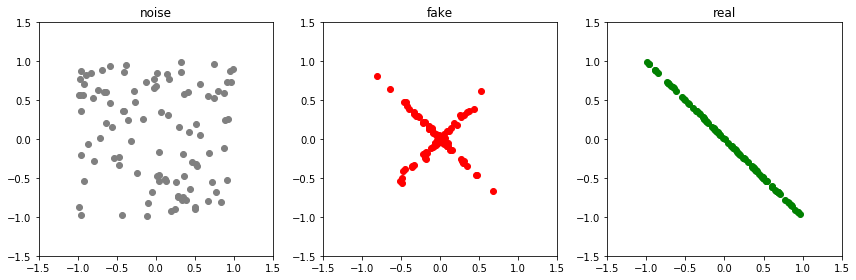

Epoch: 44500 G-error: 2.110307216644287 D-error: 3.651664972305298


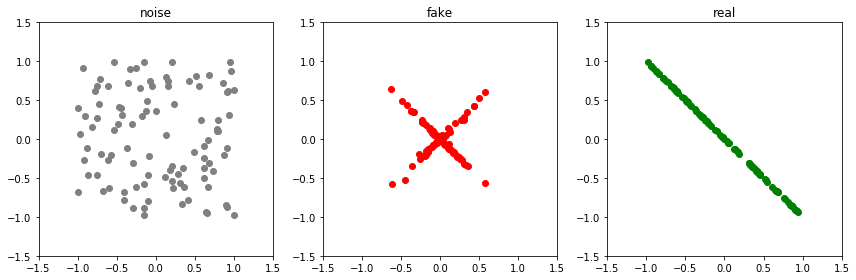

Epoch: 44550 G-error: 0.996836245059967 D-error: 1.1675658226013184


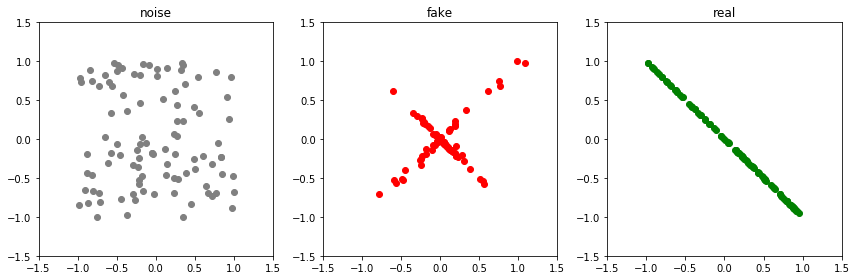

Epoch: 44600 G-error: 1.2979191541671753 D-error: 1.0371302366256714


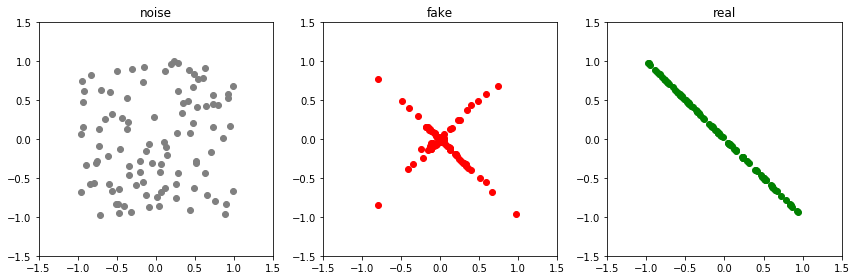

Epoch: 44650 G-error: 1.3865065574645996 D-error: 0.9615683555603027


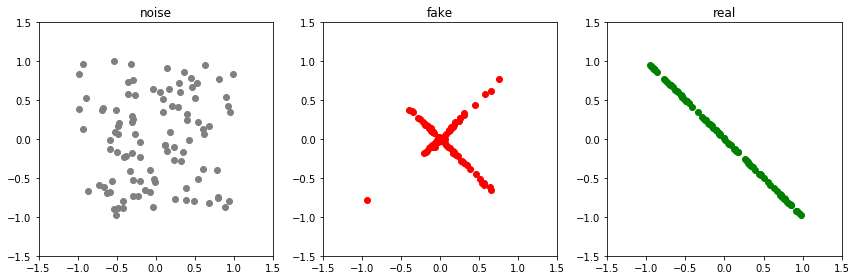

Epoch: 44700 G-error: 1.4734687805175781 D-error: 0.8662331104278564


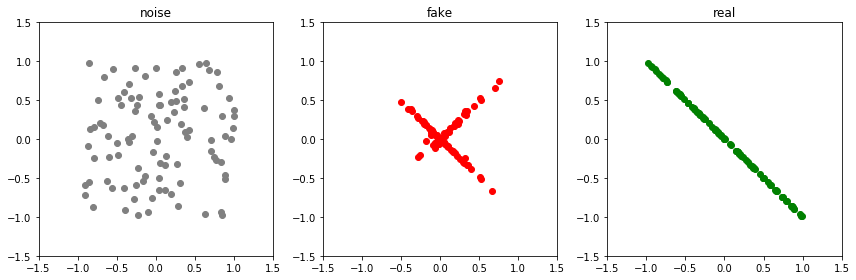

Epoch: 44750 G-error: 1.5998061895370483 D-error: 0.8123937845230103


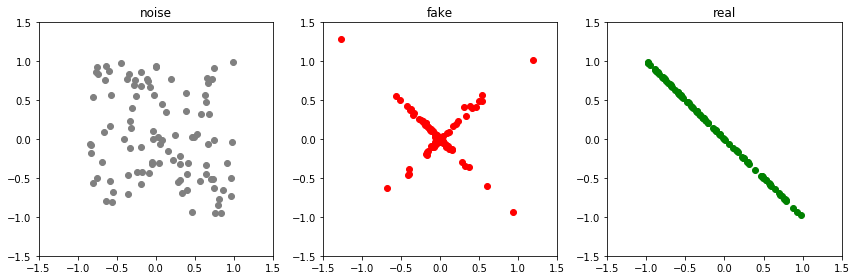

Epoch: 44800 G-error: 1.6990035772323608 D-error: 0.8467119932174683


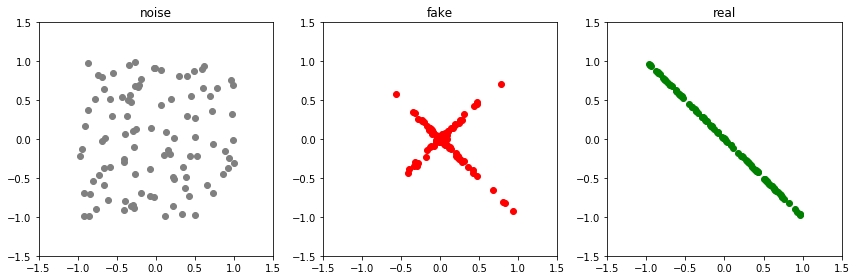

Epoch: 44850 G-error: 1.5852664709091187 D-error: 0.8228998184204102


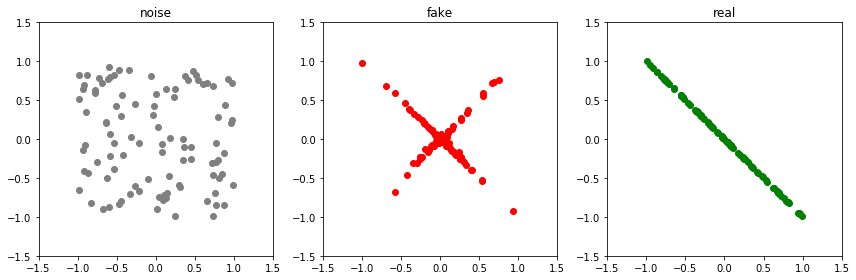

Epoch: 44900 G-error: 1.6733871698379517 D-error: 0.9671819806098938


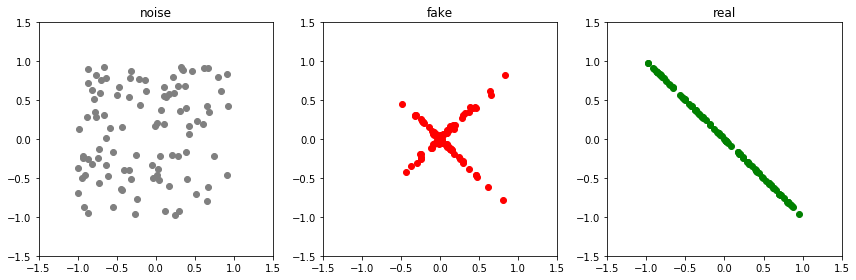

Epoch: 44950 G-error: 1.594346523284912 D-error: 0.7736864686012268


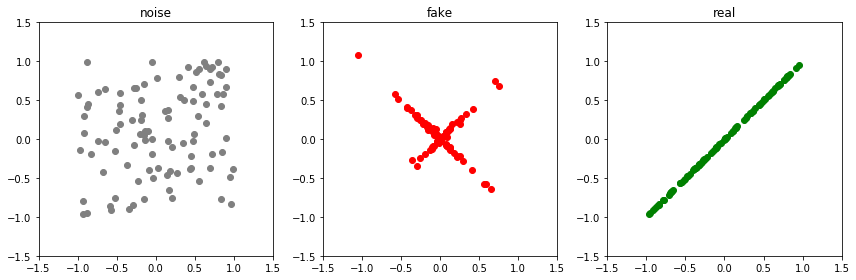

Epoch: 45000 G-error: 1.6361987590789795 D-error: 2.6240086555480957


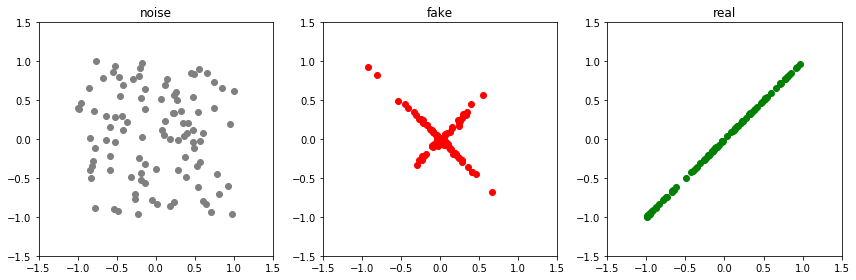

Epoch: 45050 G-error: 1.2412399053573608 D-error: 0.9063595533370972


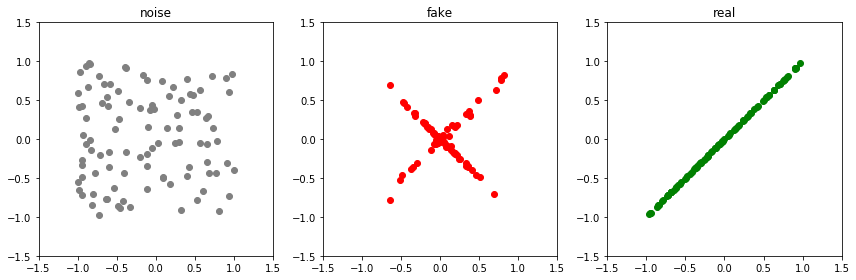

Epoch: 45100 G-error: 1.4468929767608643 D-error: 0.7954742908477783


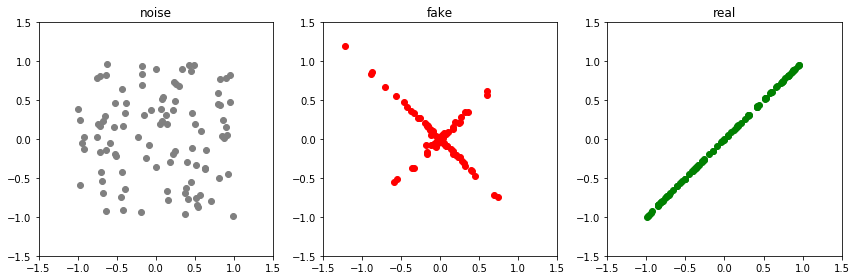

Epoch: 45150 G-error: 1.6154712438583374 D-error: 0.5835520029067993


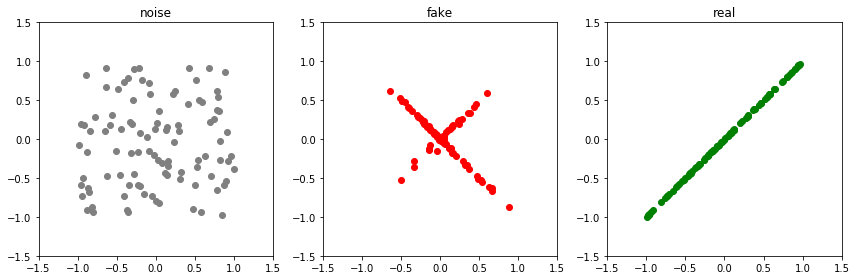

Epoch: 45200 G-error: 1.7812188863754272 D-error: 0.7218821048736572


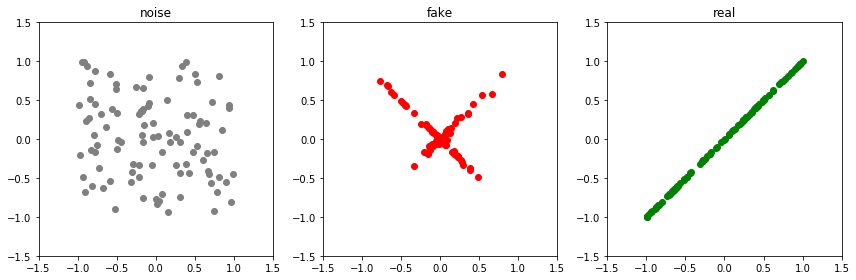

Epoch: 45250 G-error: 1.7837125062942505 D-error: 0.5412893891334534


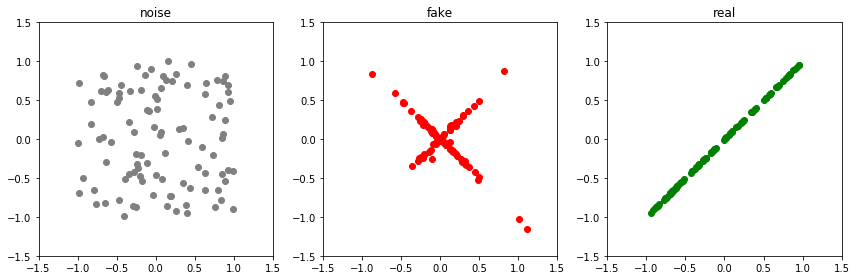

Epoch: 45300 G-error: 1.8635464906692505 D-error: 0.5579698085784912


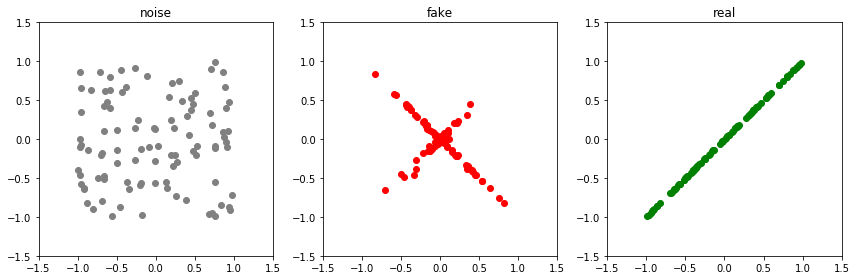

Epoch: 45350 G-error: 2.046793222427368 D-error: 0.5309703350067139


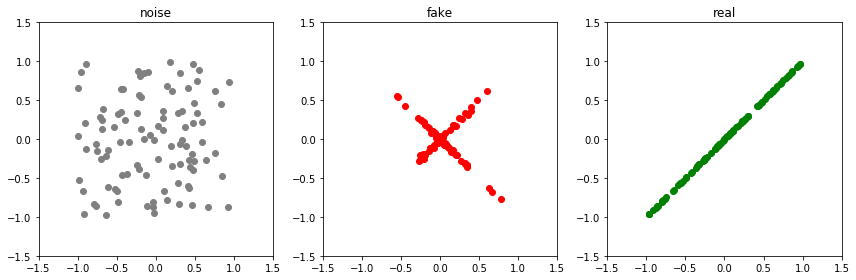

Epoch: 45400 G-error: 1.9286179542541504 D-error: 0.6348579525947571


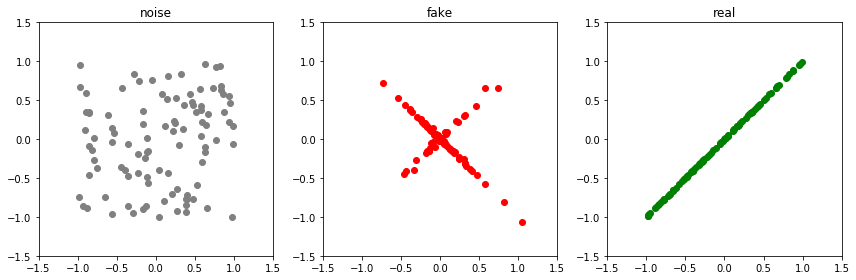

Epoch: 45450 G-error: 1.9790257215499878 D-error: 0.544547975063324


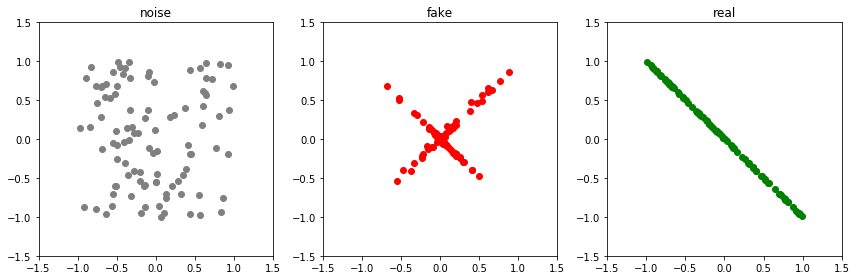

Epoch: 45500 G-error: 1.8482873439788818 D-error: 3.8257057666778564


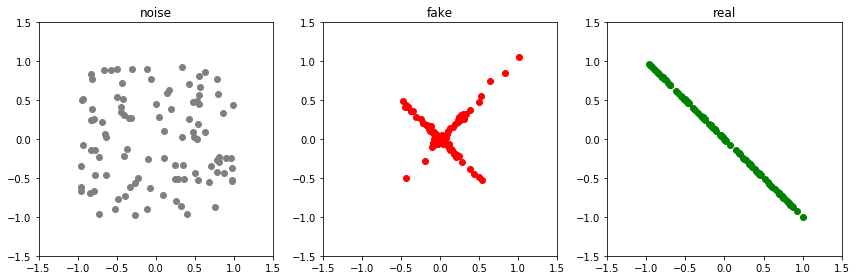

Epoch: 45550 G-error: 1.0029700994491577 D-error: 1.119859218597412


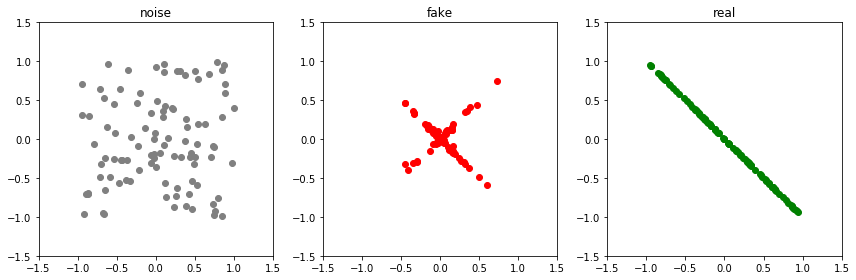

Epoch: 45600 G-error: 1.400123119354248 D-error: 0.9899826049804688


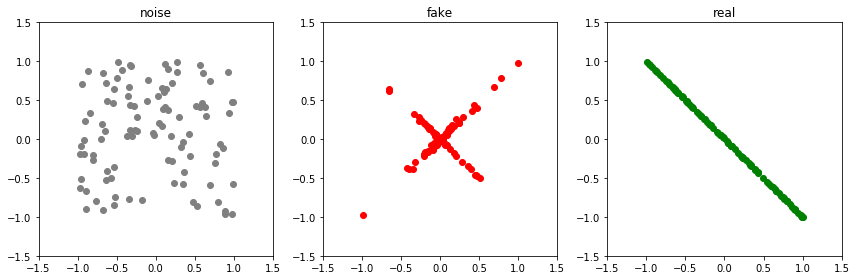

Epoch: 45650 G-error: 1.3381469249725342 D-error: 0.8473058938980103


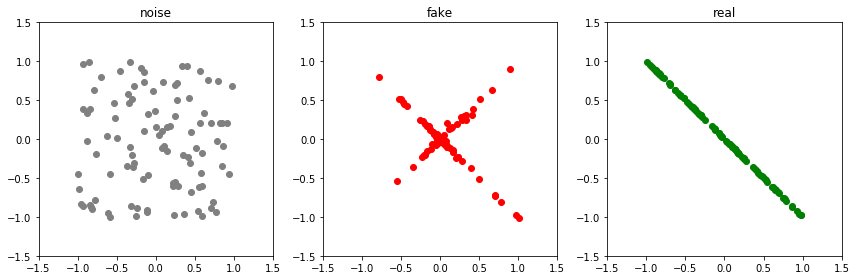

Epoch: 45700 G-error: 1.5272635221481323 D-error: 1.0099513530731201


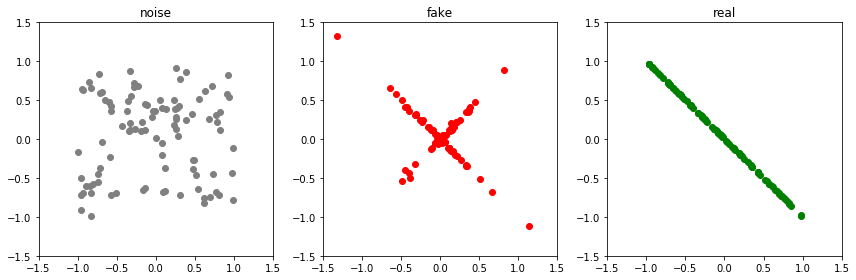

Epoch: 45750 G-error: 1.6265698671340942 D-error: 0.9098306894302368


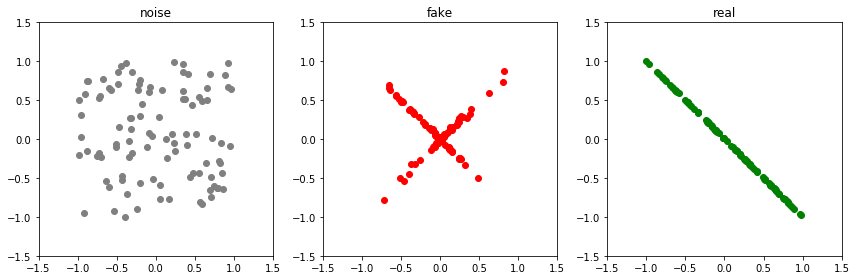

Epoch: 45800 G-error: 1.5315715074539185 D-error: 0.8713744282722473


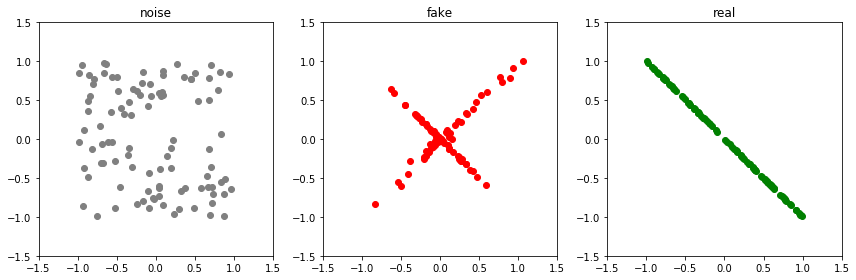

Epoch: 45850 G-error: 1.5986918210983276 D-error: 0.7006679177284241


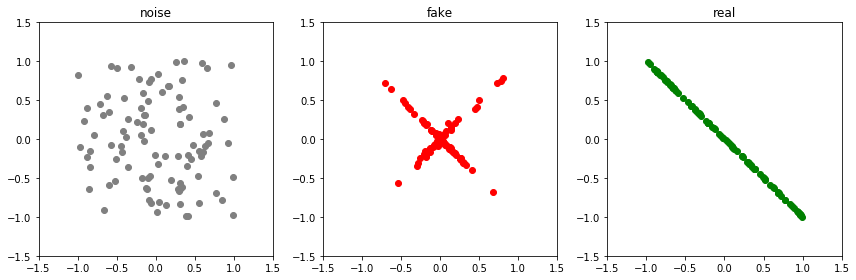

Epoch: 45900 G-error: 1.6785578727722168 D-error: 0.756740152835846


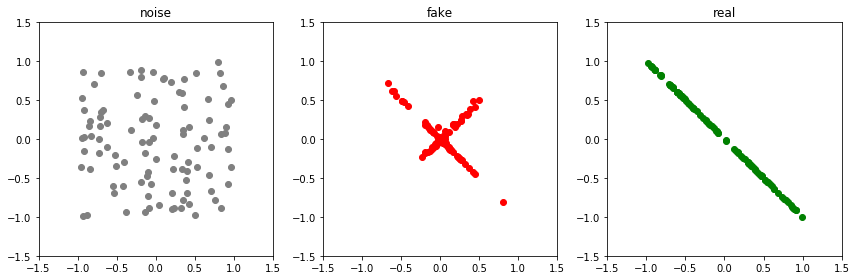

Epoch: 45950 G-error: 1.4936774969100952 D-error: 0.7454758882522583


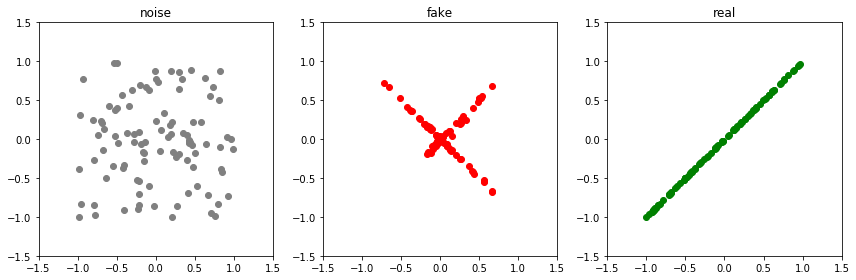

Epoch: 46000 G-error: 1.623916506767273 D-error: 2.8123865127563477


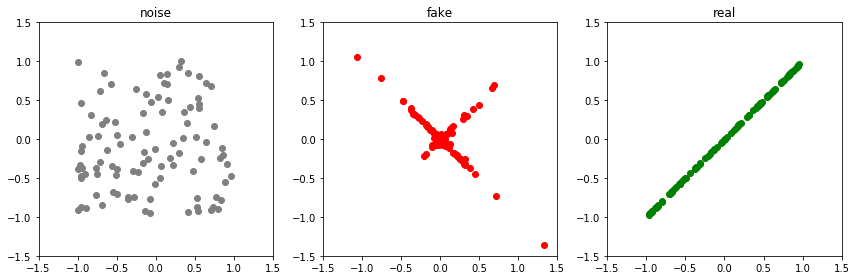

Epoch: 46050 G-error: 1.3192743062973022 D-error: 0.8370382785797119


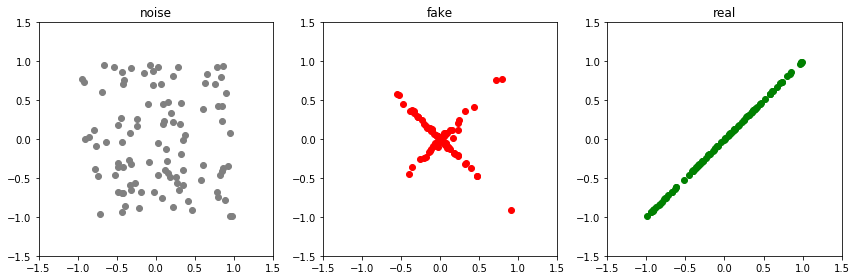

Epoch: 46100 G-error: 1.45151686668396 D-error: 0.7355242967605591


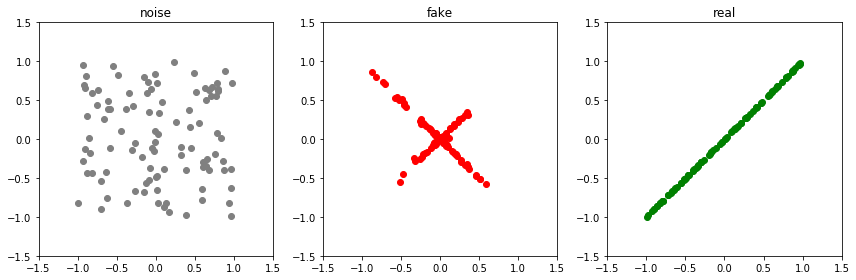

Epoch: 46150 G-error: 1.5309191942214966 D-error: 0.6130733489990234


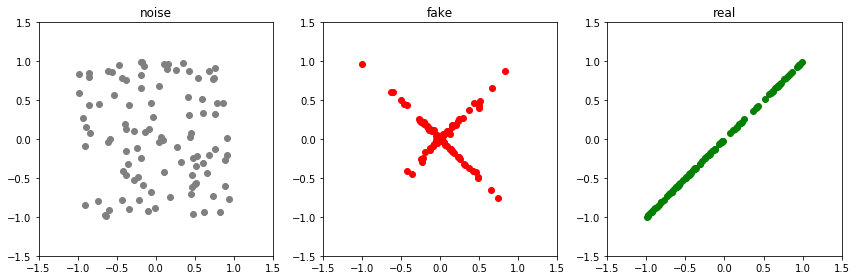

Epoch: 46200 G-error: 1.6870019435882568 D-error: 0.5901293754577637


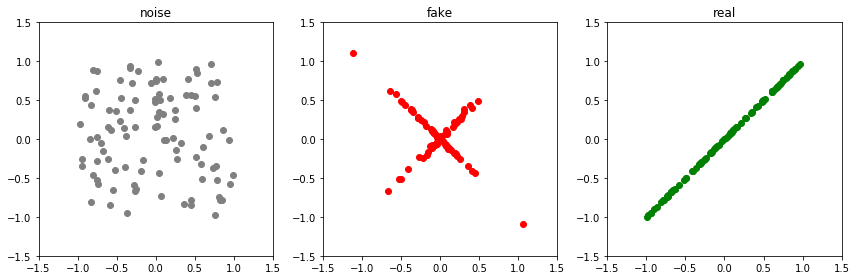

Epoch: 46250 G-error: 1.9035040140151978 D-error: 0.6650665998458862


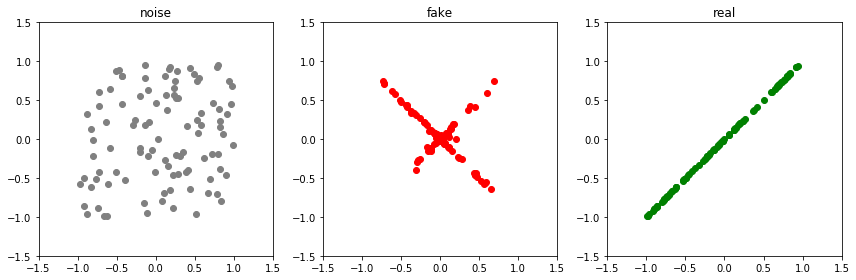

Epoch: 46300 G-error: 2.0106825828552246 D-error: 0.5677210092544556


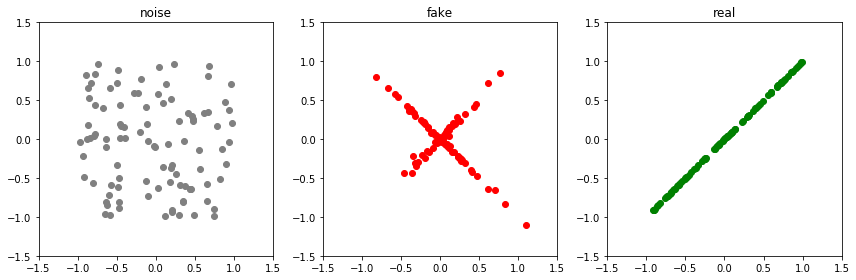

Epoch: 46350 G-error: 2.0033512115478516 D-error: 0.6633039712905884


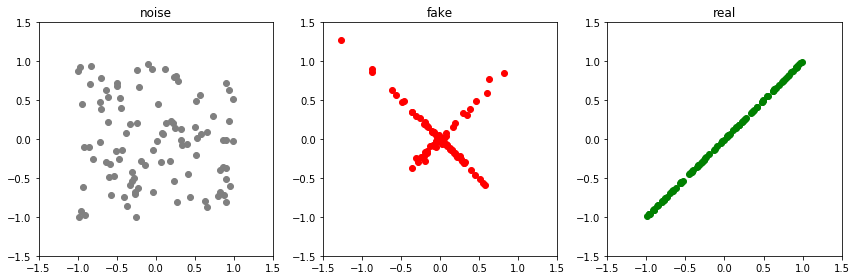

Epoch: 46400 G-error: 2.1082470417022705 D-error: 0.5489503145217896


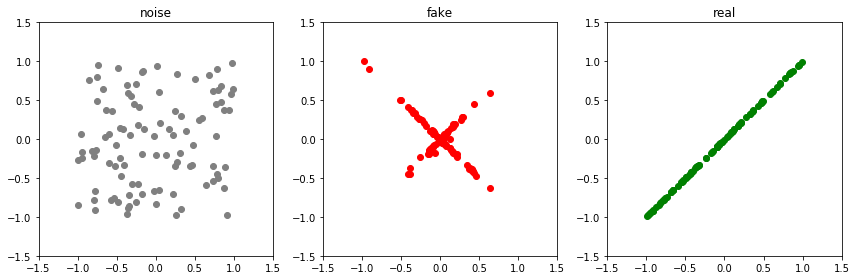

Epoch: 46450 G-error: 2.0933895111083984 D-error: 0.5845569968223572


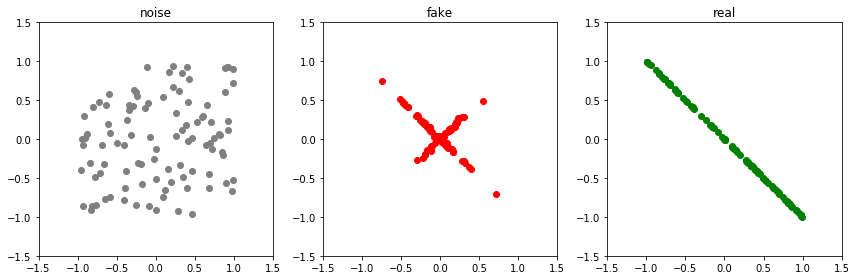

Epoch: 46500 G-error: 1.9263954162597656 D-error: 3.691054105758667


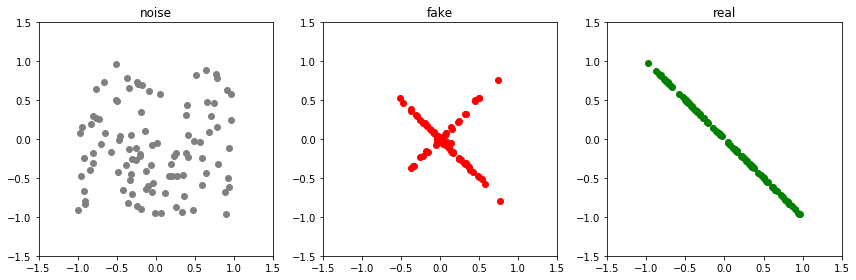

Epoch: 46550 G-error: 1.1371248960494995 D-error: 1.1832218170166016


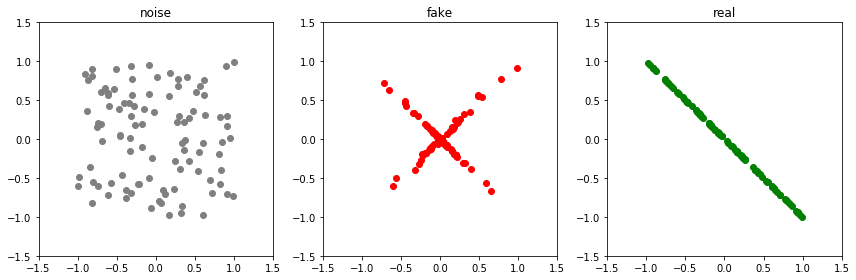

Epoch: 46600 G-error: 1.276851773262024 D-error: 0.9727232456207275


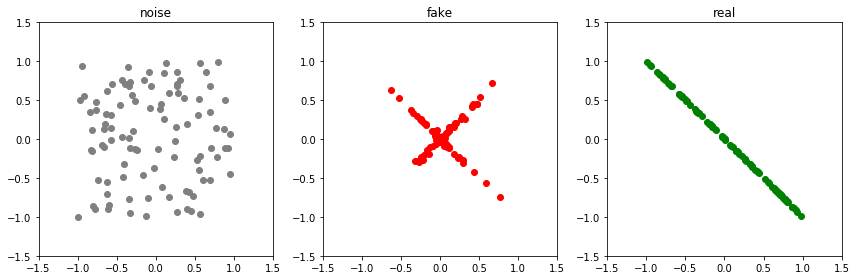

Epoch: 46650 G-error: 1.2676723003387451 D-error: 0.8180074691772461


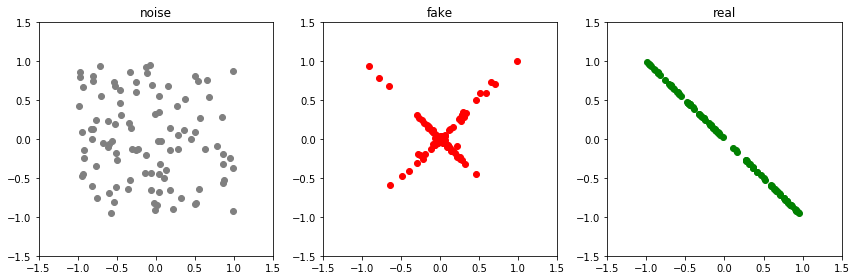

Epoch: 46700 G-error: 1.5102849006652832 D-error: 0.7063767910003662


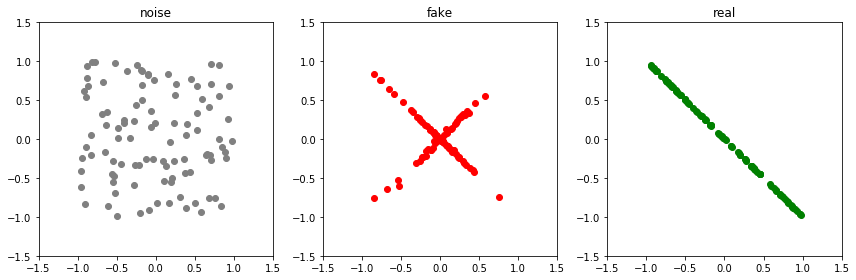

Epoch: 46750 G-error: 1.4736918210983276 D-error: 0.8538580536842346


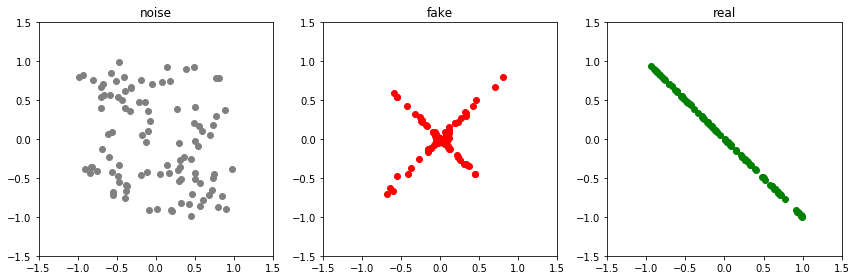

Epoch: 46800 G-error: 1.606400728225708 D-error: 0.8768489956855774


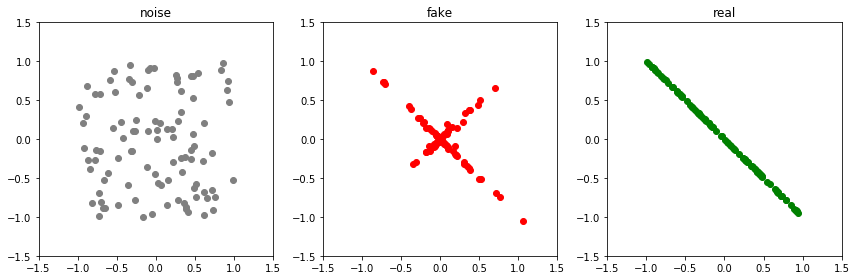

Epoch: 46850 G-error: 1.537123680114746 D-error: 0.8597384095191956


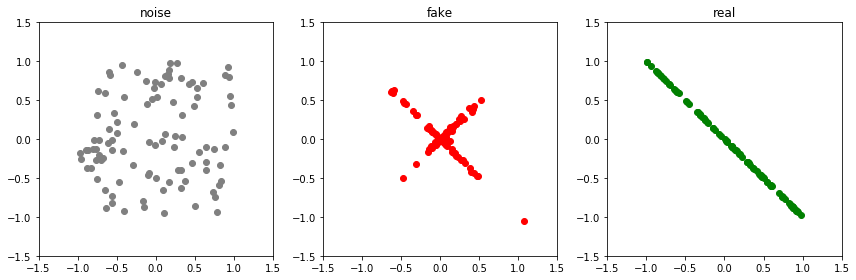

Epoch: 46900 G-error: 1.6522903442382812 D-error: 0.8044085502624512


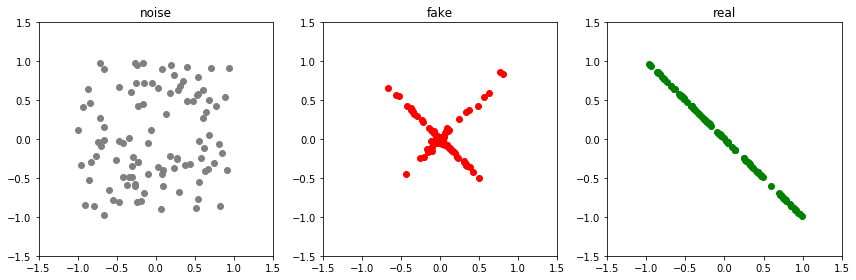

Epoch: 46950 G-error: 1.6102372407913208 D-error: 0.8069676160812378


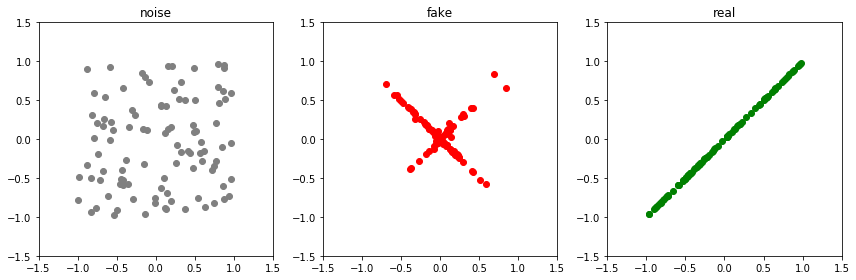

Epoch: 47000 G-error: 1.534698486328125 D-error: 2.9793970584869385


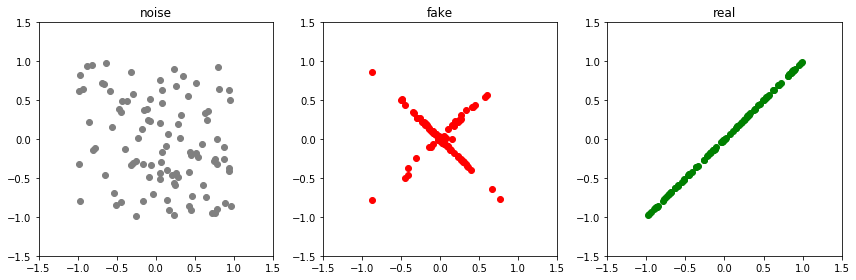

Epoch: 47050 G-error: 1.255456805229187 D-error: 0.946007490158081


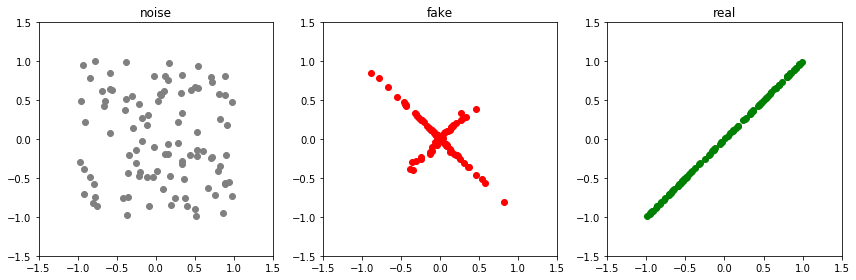

Epoch: 47100 G-error: 1.4034936428070068 D-error: 0.5996630787849426


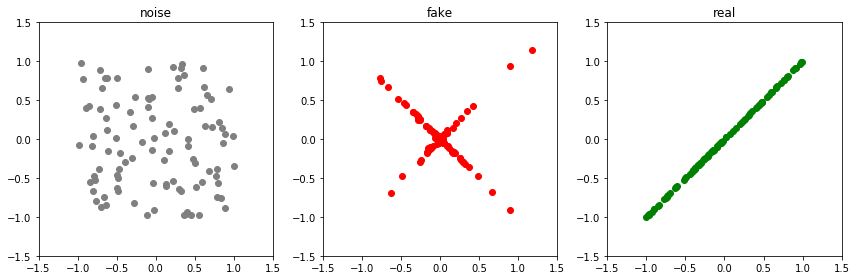

Epoch: 47150 G-error: 1.5555227994918823 D-error: 0.7052924633026123


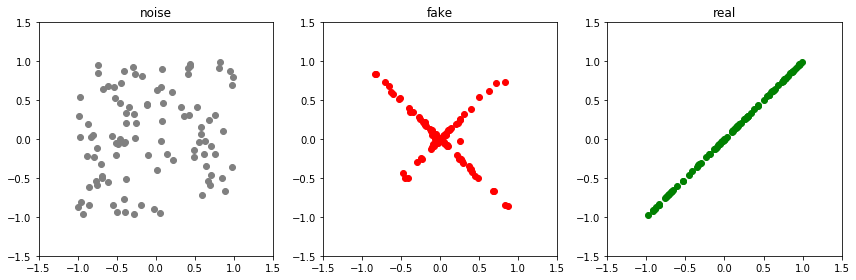

Epoch: 47200 G-error: 1.6533607244491577 D-error: 0.763695478439331


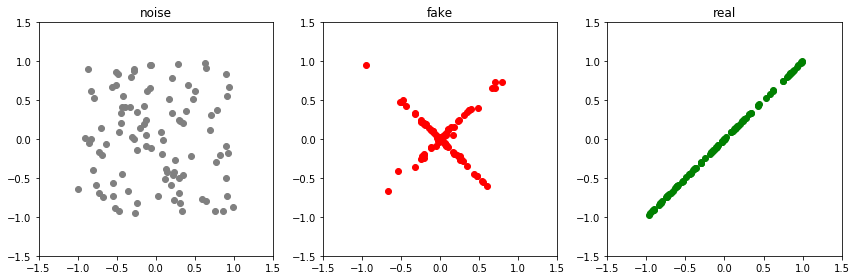

Epoch: 47250 G-error: 1.8195959329605103 D-error: 0.7305606007575989


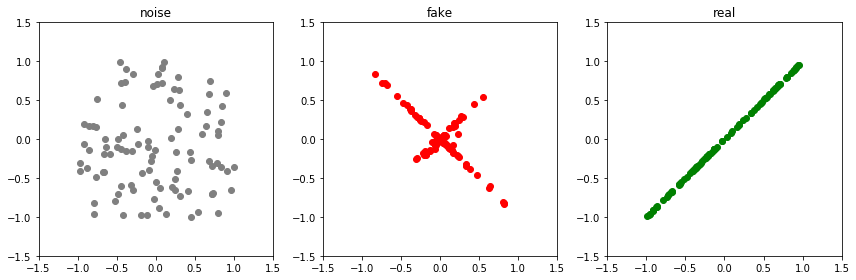

Epoch: 47300 G-error: 1.9414808750152588 D-error: 0.5036577582359314


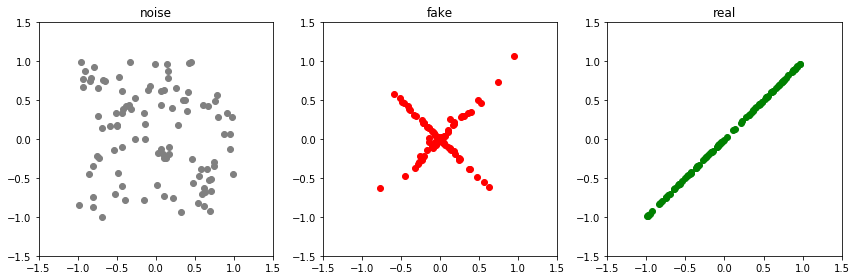

Epoch: 47350 G-error: 1.9952147006988525 D-error: 0.6009889841079712


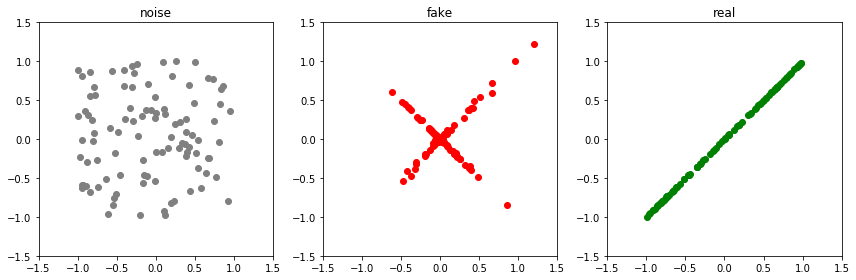

Epoch: 47400 G-error: 1.882800579071045 D-error: 0.5413913726806641


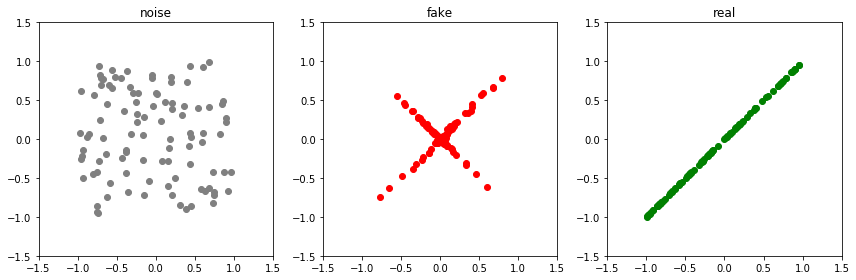

Epoch: 47450 G-error: 2.035668134689331 D-error: 0.7181838750839233


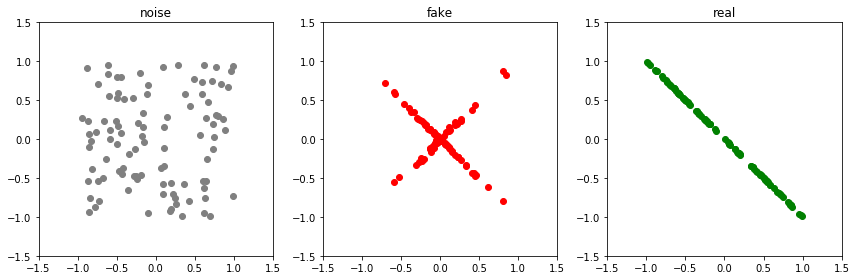

Epoch: 47500 G-error: 2.1955699920654297 D-error: 3.7698917388916016


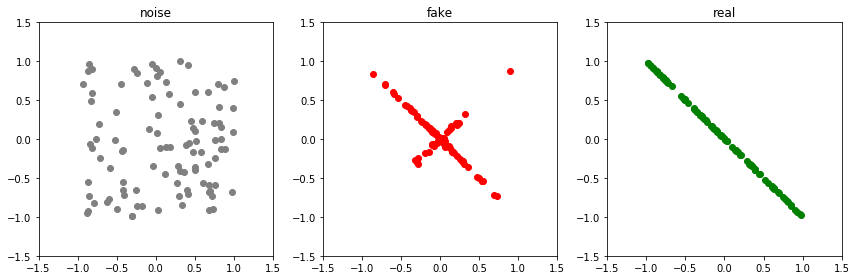

Epoch: 47550 G-error: 0.9932175278663635 D-error: 1.1947276592254639


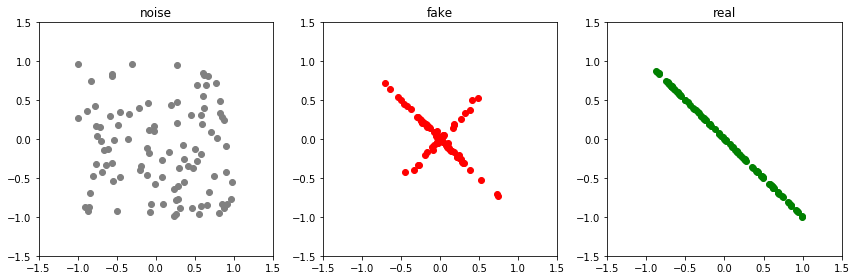

Epoch: 47600 G-error: 1.2953057289123535 D-error: 0.9616125226020813


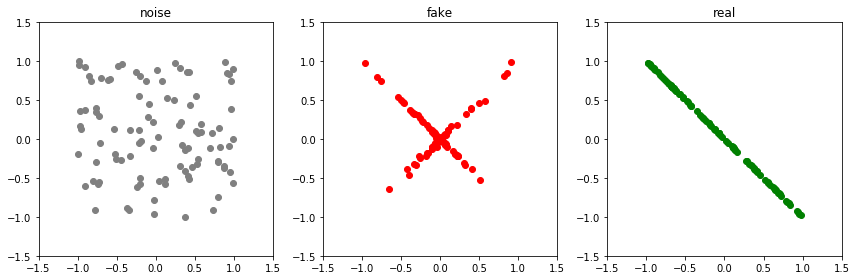

Epoch: 47650 G-error: 1.4808170795440674 D-error: 0.8905626535415649


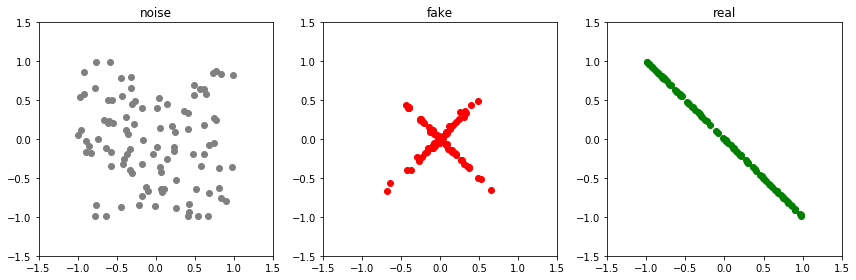

Epoch: 47700 G-error: 1.5423983335494995 D-error: 0.7502787709236145


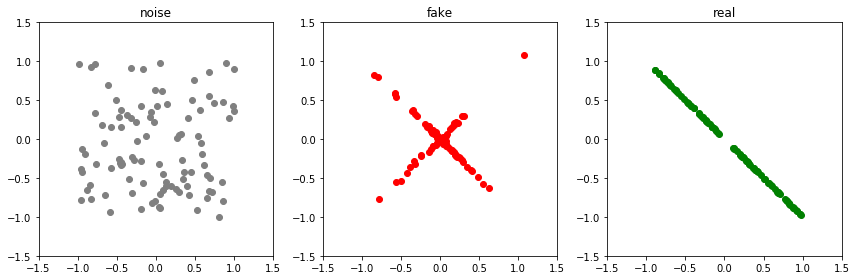

Epoch: 47750 G-error: 1.4717909097671509 D-error: 0.8166946768760681


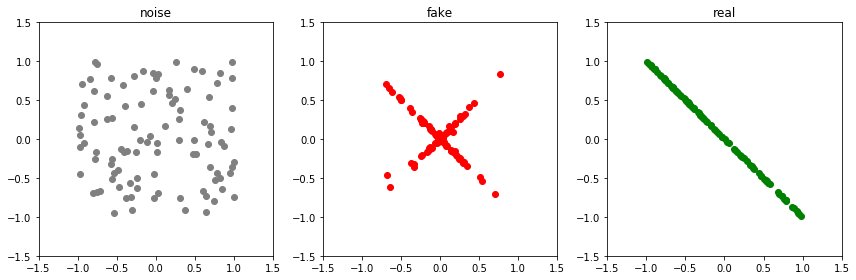

Epoch: 47800 G-error: 1.5497207641601562 D-error: 0.8338025808334351


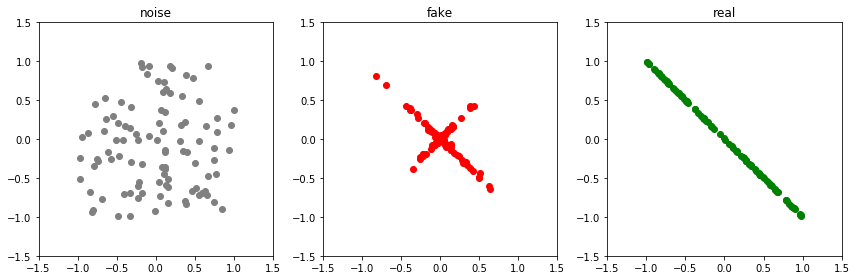

Epoch: 47850 G-error: 1.515153169631958 D-error: 0.7386960983276367


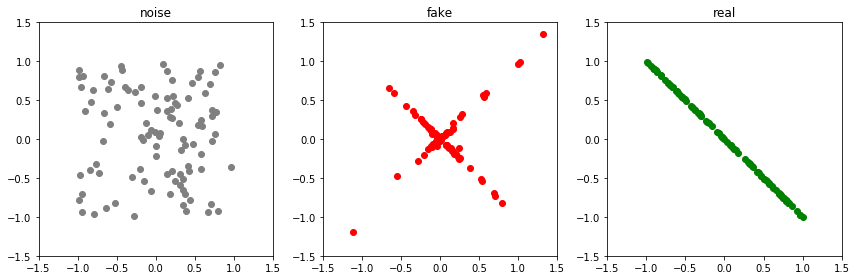

Epoch: 47900 G-error: 1.601155400276184 D-error: 0.7555256485939026


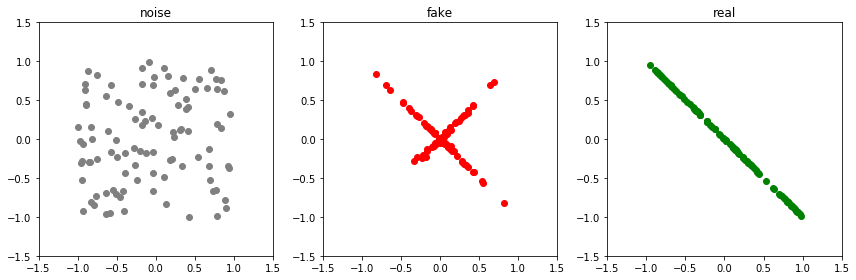

Epoch: 47950 G-error: 1.5823800563812256 D-error: 0.8830896615982056


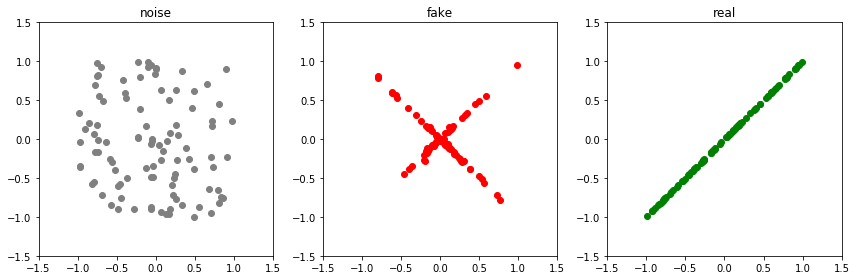

Epoch: 48000 G-error: 1.5771043300628662 D-error: 2.978667974472046


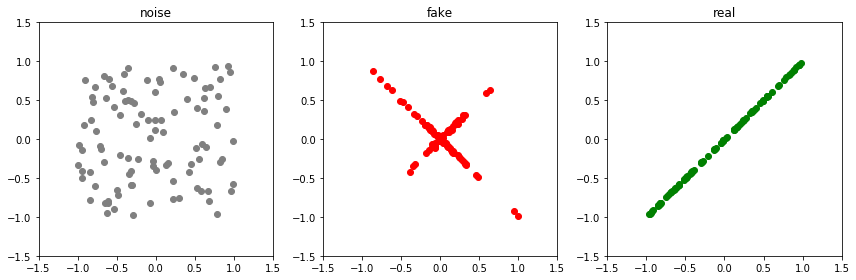

Epoch: 48050 G-error: 1.154215931892395 D-error: 0.9442402124404907


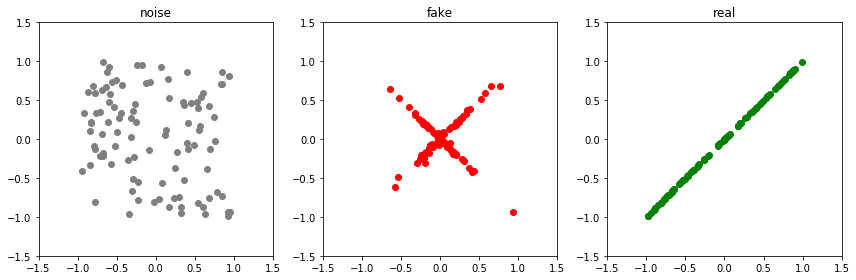

Epoch: 48100 G-error: 1.3794682025909424 D-error: 0.7486686706542969


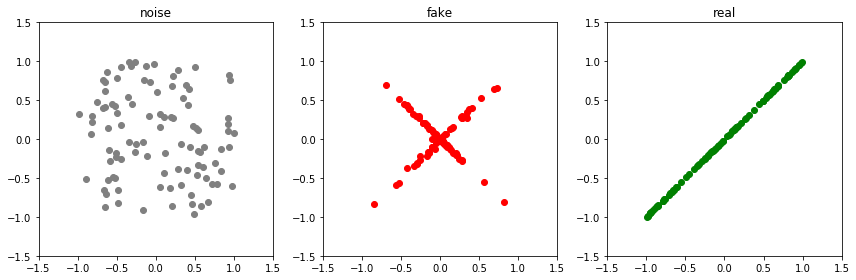

Epoch: 48150 G-error: 1.6691882610321045 D-error: 0.7481814622879028


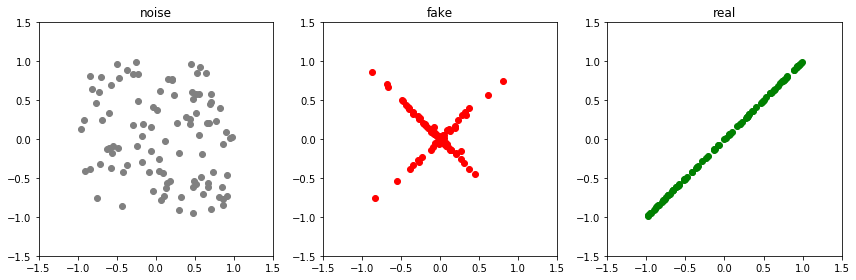

Epoch: 48200 G-error: 1.7661662101745605 D-error: 0.555107831954956


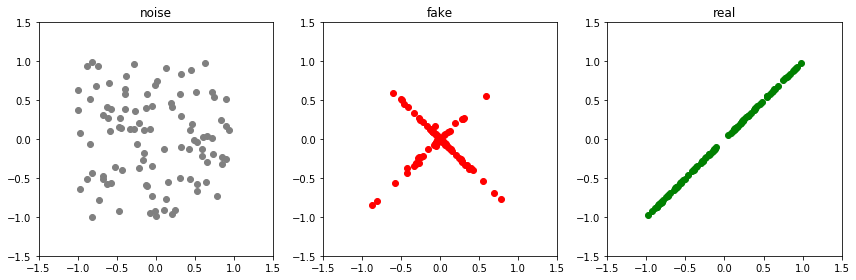

Epoch: 48250 G-error: 1.698495626449585 D-error: 0.6741079688072205


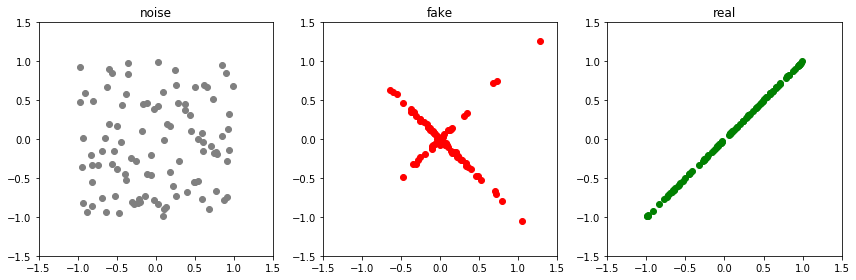

Epoch: 48300 G-error: 1.8183692693710327 D-error: 0.6009165048599243


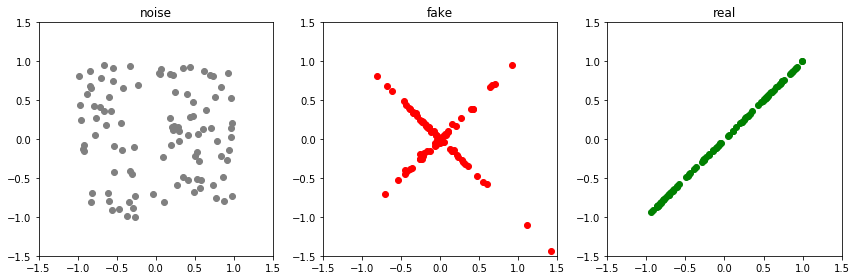

Epoch: 48350 G-error: 1.872808575630188 D-error: 0.6871451139450073


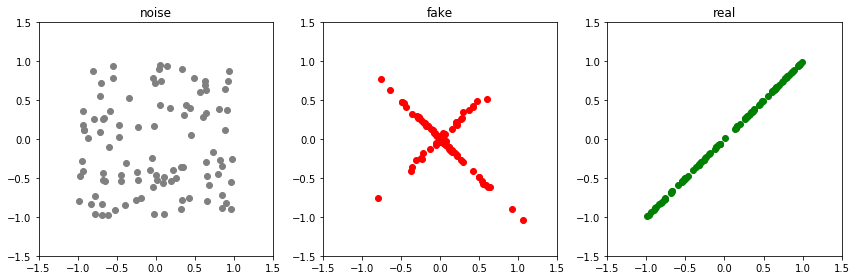

Epoch: 48400 G-error: 2.096860885620117 D-error: 0.4979710578918457


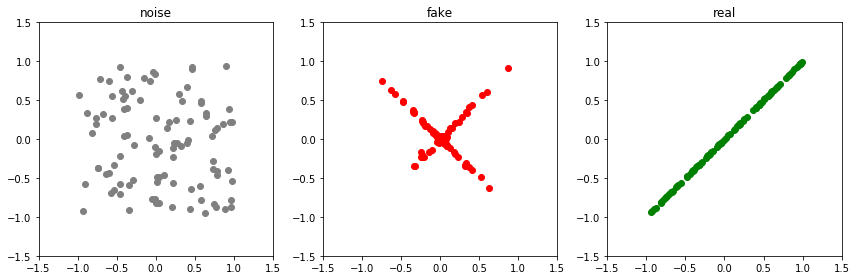

Epoch: 48450 G-error: 2.0390539169311523 D-error: 0.5939710140228271


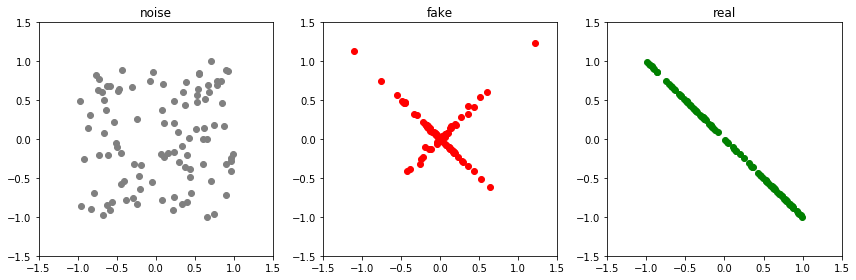

Epoch: 48500 G-error: 2.2549591064453125 D-error: 3.803854465484619


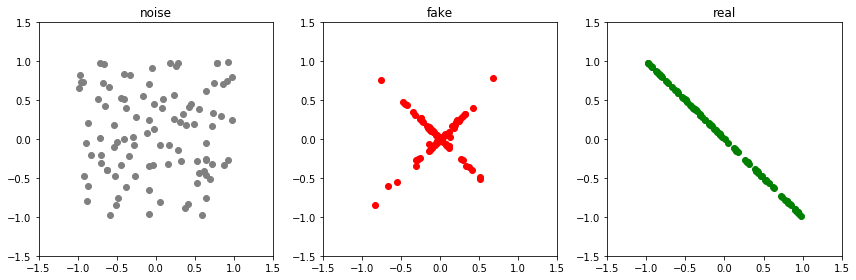

Epoch: 48550 G-error: 0.9941017627716064 D-error: 1.204557180404663


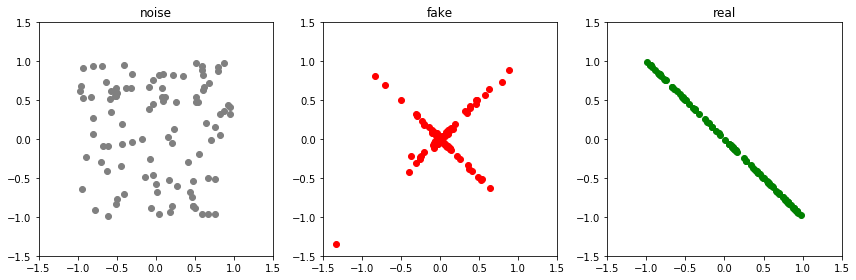

Epoch: 48600 G-error: 1.3400839567184448 D-error: 0.8897681832313538


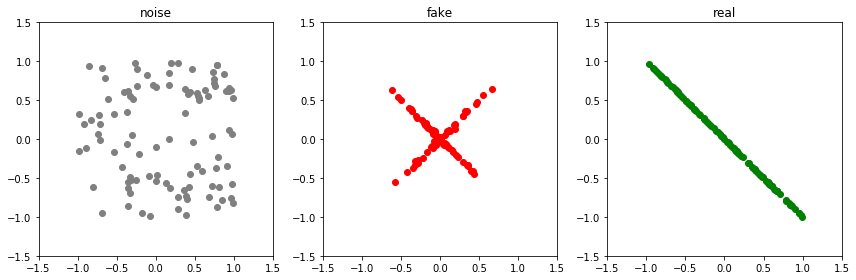

Epoch: 48650 G-error: 1.3522447347640991 D-error: 0.8463890552520752


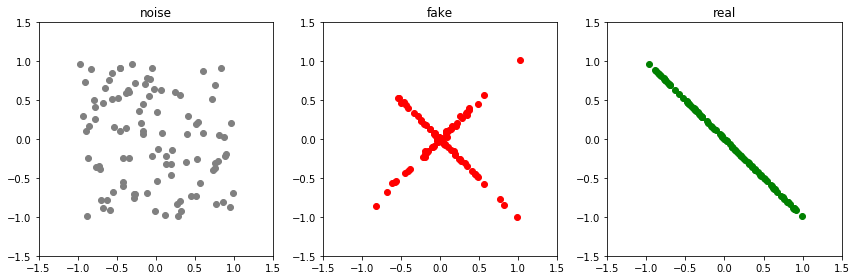

Epoch: 48700 G-error: 1.485528588294983 D-error: 0.9798350930213928


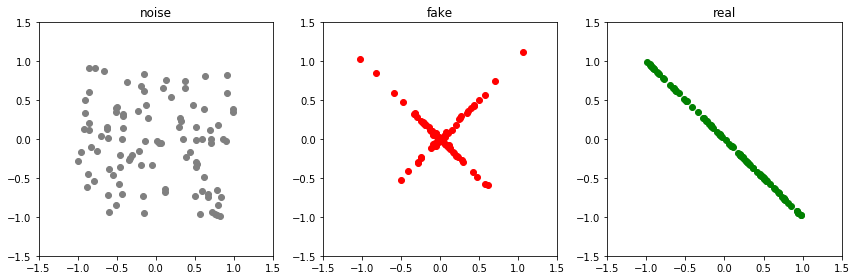

Epoch: 48750 G-error: 1.527077078819275 D-error: 0.8698493838310242


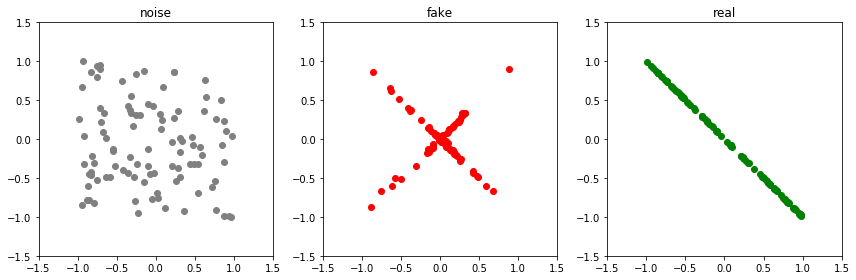

Epoch: 48800 G-error: 1.5346784591674805 D-error: 0.6904216408729553


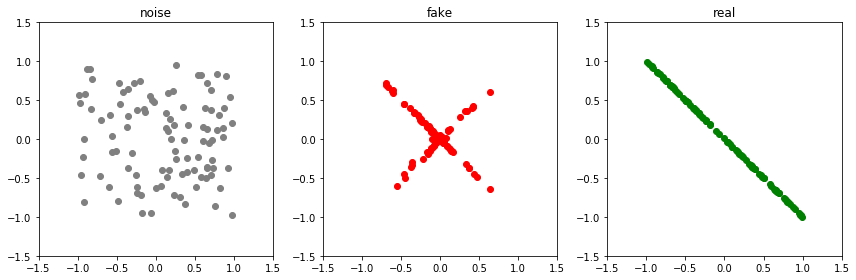

Epoch: 48850 G-error: 1.564494013786316 D-error: 0.7990367412567139


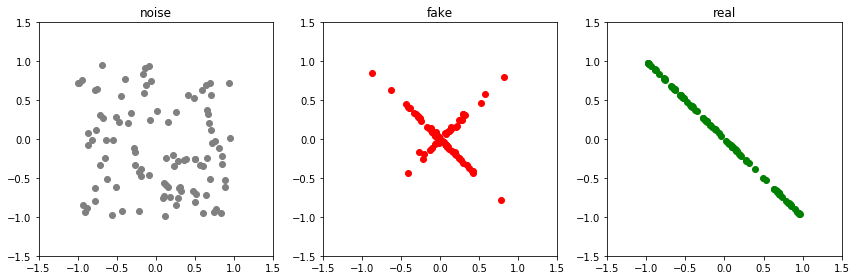

Epoch: 48900 G-error: 1.5455868244171143 D-error: 0.8280773758888245


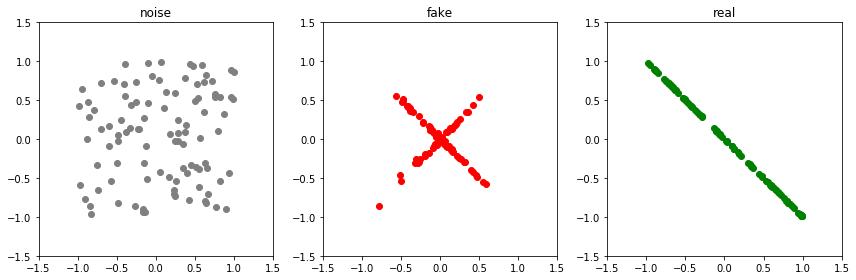

Epoch: 48950 G-error: 1.4557567834854126 D-error: 0.7666603326797485


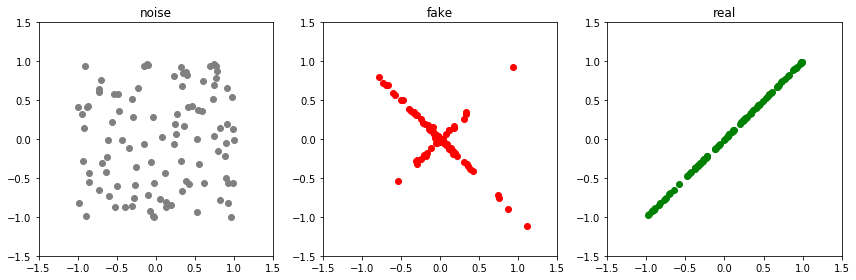

Epoch: 49000 G-error: 1.4416433572769165 D-error: 3.026977300643921


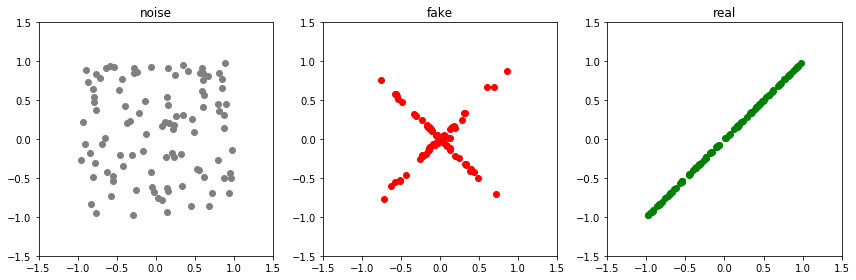

Epoch: 49050 G-error: 1.2237037420272827 D-error: 0.9668443202972412


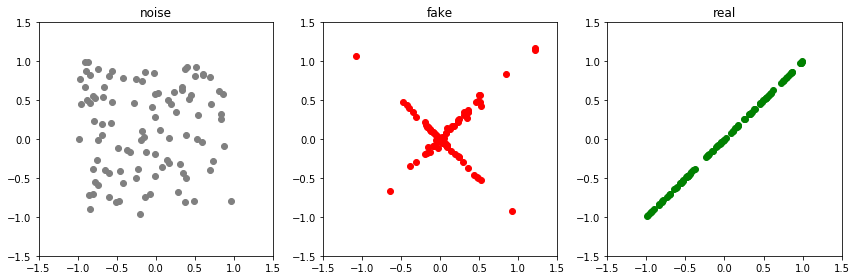

Epoch: 49100 G-error: 1.3507895469665527 D-error: 0.7829684019088745


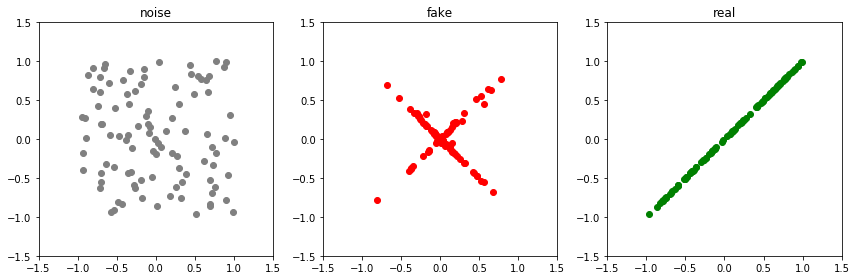

Epoch: 49150 G-error: 1.4540772438049316 D-error: 0.7045690417289734


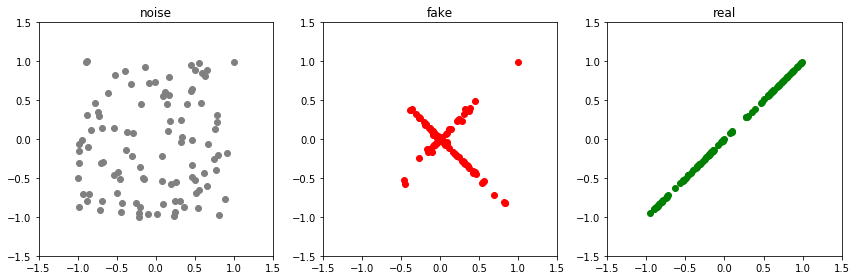

Epoch: 49200 G-error: 1.7260067462921143 D-error: 0.6167502403259277


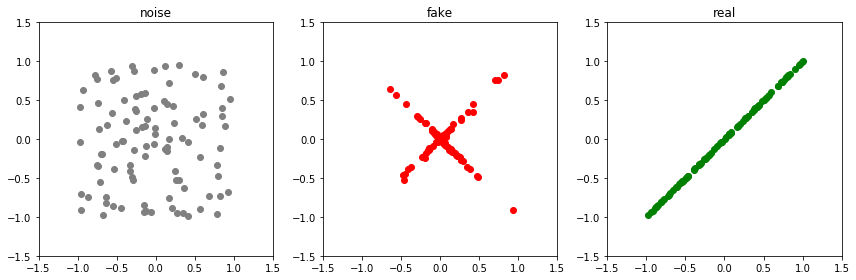

Epoch: 49250 G-error: 1.8026585578918457 D-error: 0.6732518672943115


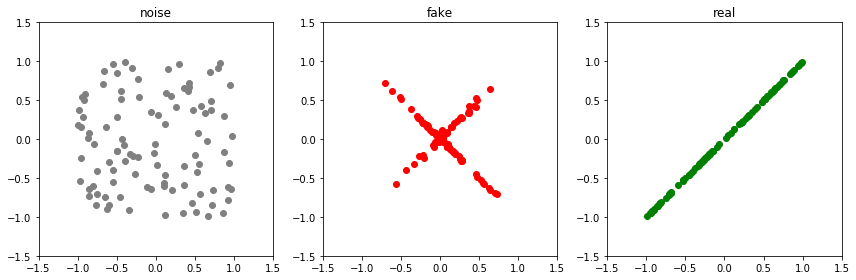

Epoch: 49300 G-error: 1.734002947807312 D-error: 0.5739077925682068


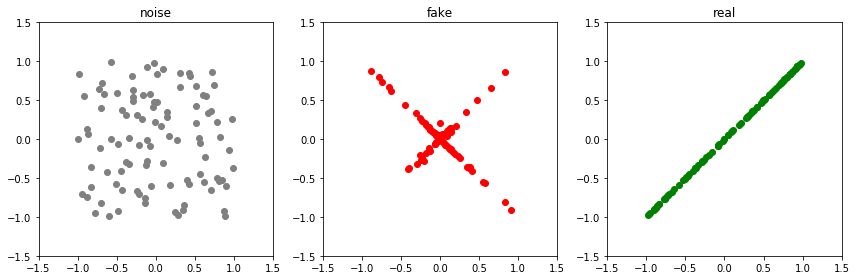

Epoch: 49350 G-error: 1.8864120244979858 D-error: 0.5457960367202759


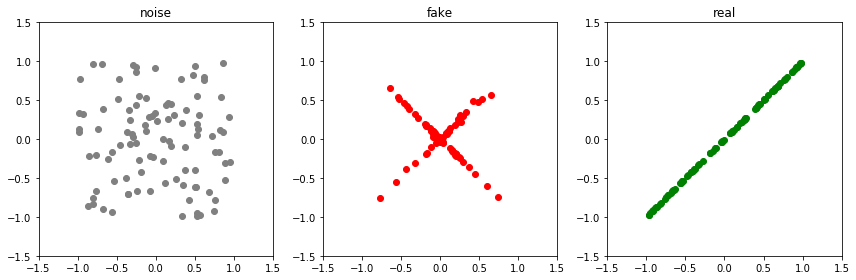

Epoch: 49400 G-error: 1.8882689476013184 D-error: 0.572844386100769


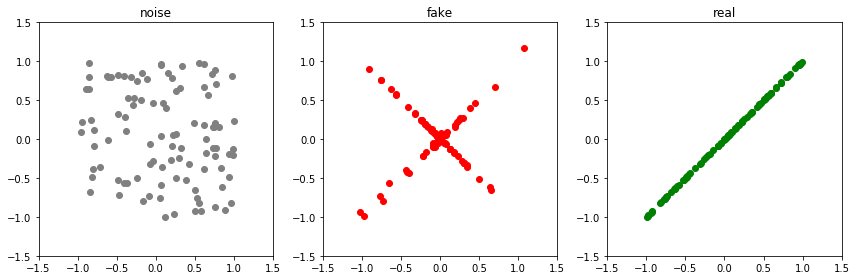

Epoch: 49450 G-error: 1.8490670919418335 D-error: 0.7673923373222351


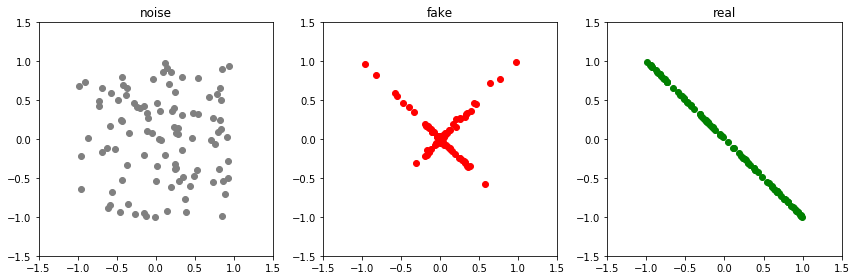

Epoch: 49500 G-error: 2.0685791969299316 D-error: 3.884772300720215


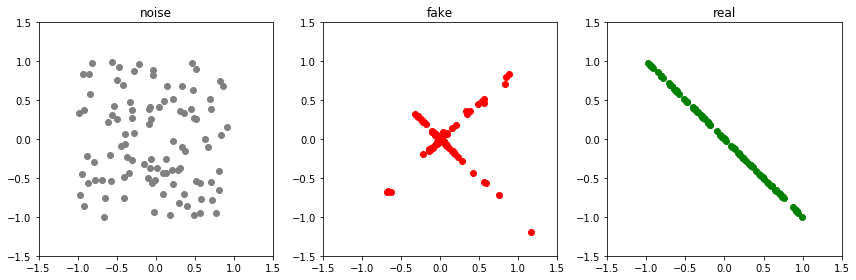

Epoch: 49550 G-error: 0.9246733784675598 D-error: 1.182397484779358


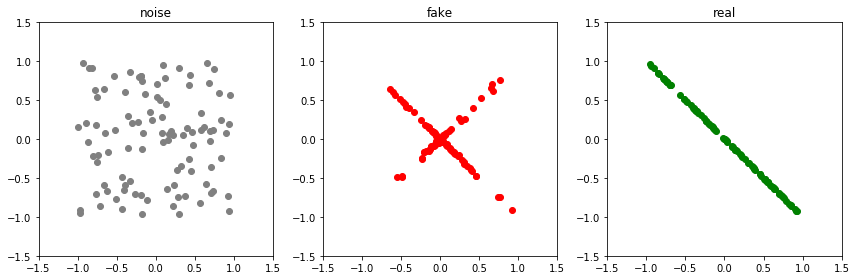

Epoch: 49600 G-error: 1.169816493988037 D-error: 0.879371166229248


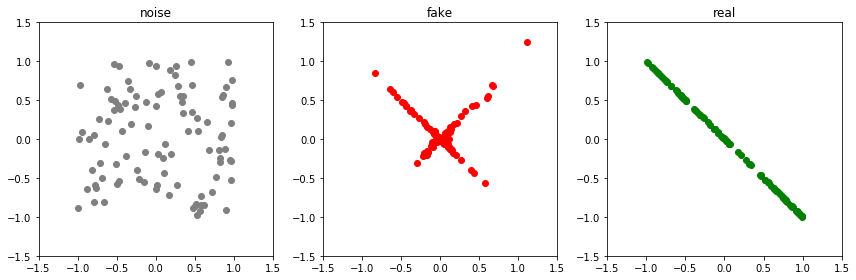

Epoch: 49650 G-error: 1.4214911460876465 D-error: 0.8158121705055237


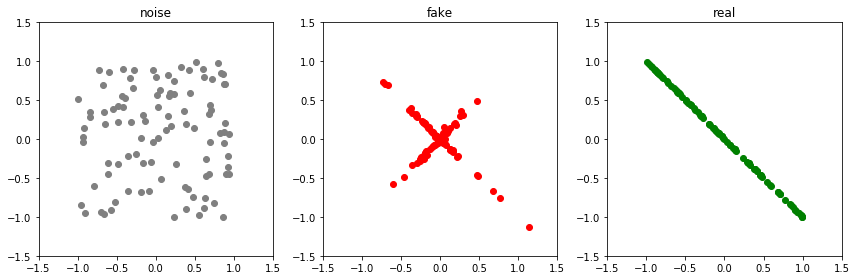

Epoch: 49700 G-error: 1.4270529747009277 D-error: 0.8981692790985107


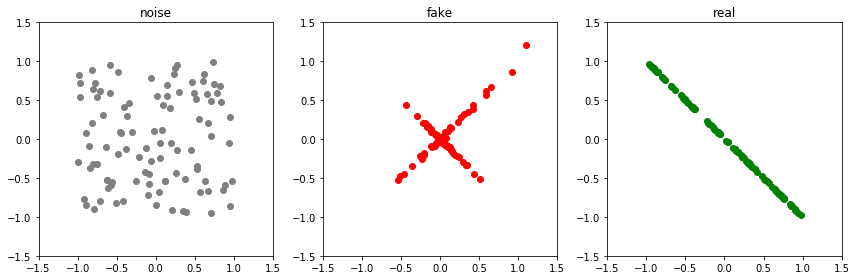

Epoch: 49750 G-error: 1.5585999488830566 D-error: 0.7153052091598511


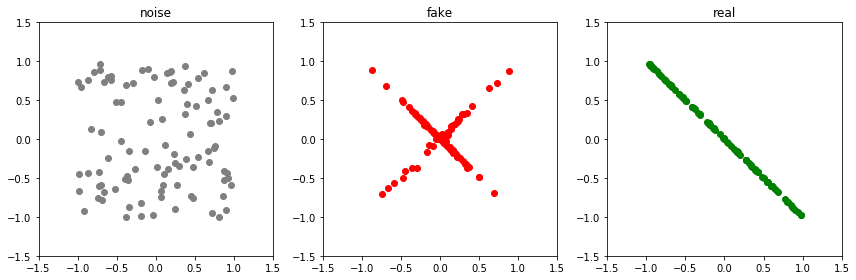

Epoch: 49800 G-error: 1.4171931743621826 D-error: 0.9554826617240906


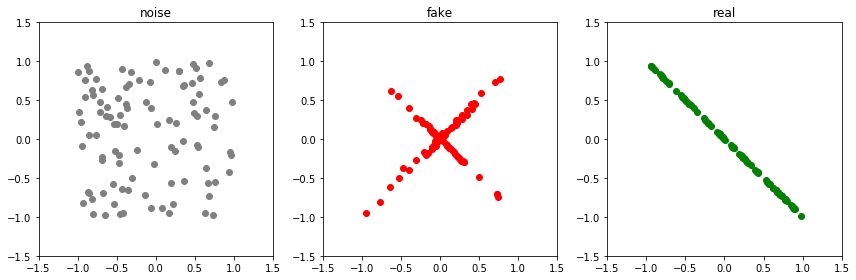

Epoch: 49850 G-error: 1.5165551900863647 D-error: 0.7975650429725647


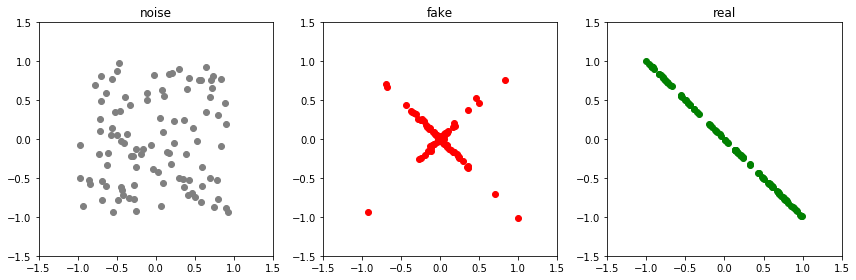

Epoch: 49900 G-error: 1.6149531602859497 D-error: 0.7649717330932617


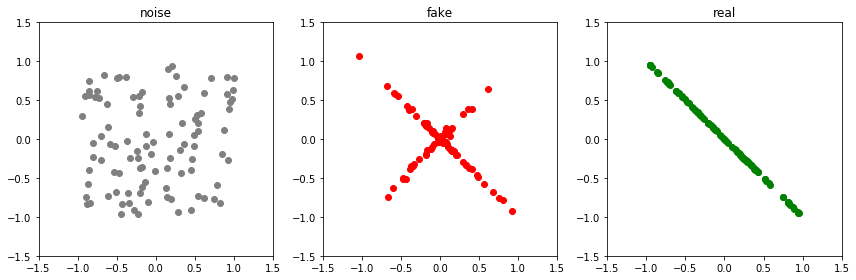

Epoch: 49950 G-error: 1.7128000259399414 D-error: 0.976488471031189


In [12]:
num_epochs = 50000
real_sample_size = 100
noise_sample_size = real_sample_size

for epoch in range(num_epochs):
    
    # real data
    if epoch%1000<500:
        base = np.random.uniform(-1,1,(real_sample_size,1)).astype('float32')
        data = np.concatenate((base, base),axis=1)
        real_data = t.from_numpy(data)
    else:
        base = np.random.uniform(-1,1,(real_sample_size,1)).astype('float32')
        data = np.concatenate((base, (-1)*base),axis=1)
        real_data = t.from_numpy(data)
        
    
    # train discriminator:
    noise = t.empty(noise_sample_size,2, device=device).uniform_(-1,1)
    fake_data = generator(noise)  
    d_error = train_discriminator(d_optimizer, real_data, fake_data)
    

    # train generator     
    if epoch%8 ==0:
        noise = t.empty(noise_sample_size,2, device=device).uniform_(-1,1)
        fake_data = generator(noise)  
        g_error = train_generator(g_optimizer, fake_data)
 
    if epoch%50 ==0:
        show(noise, fake_data, real_data)
        print(f"Epoch: {epoch} G-error: {g_error.item()} D-error: {d_error.item()}")


## Training only the generator:

In [13]:
d_optimizer = t.optim.Adam(discriminator.parameters(), lr=0.00001)
g_optimizer = t.optim.Adam(generator.parameters(), lr=0.00001)

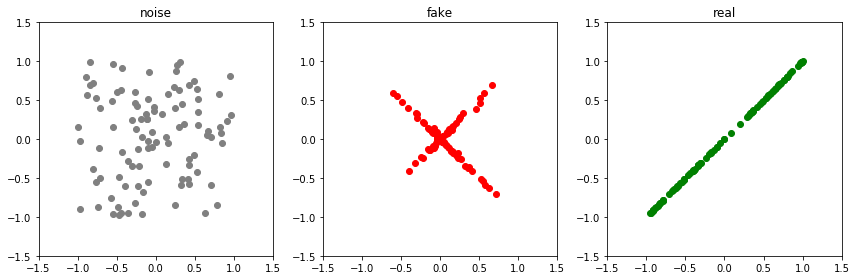

Epoch: 0 G-error: 1.6141119003295898 D-error: 3.149552583694458


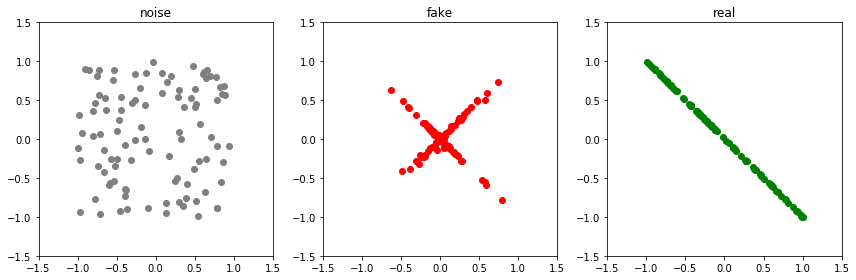

Epoch: 50 G-error: 1.4555000066757202 D-error: 0.8210362195968628


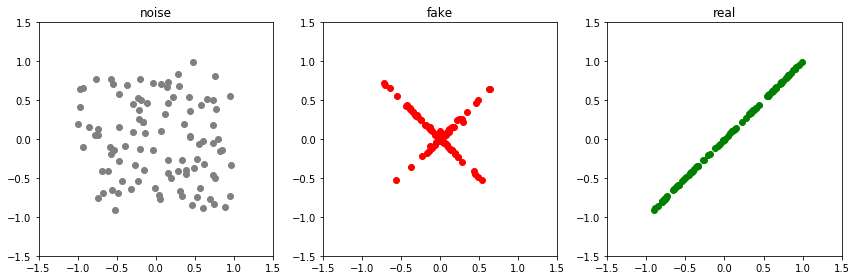

Epoch: 100 G-error: 1.1235331296920776 D-error: 2.3106167316436768


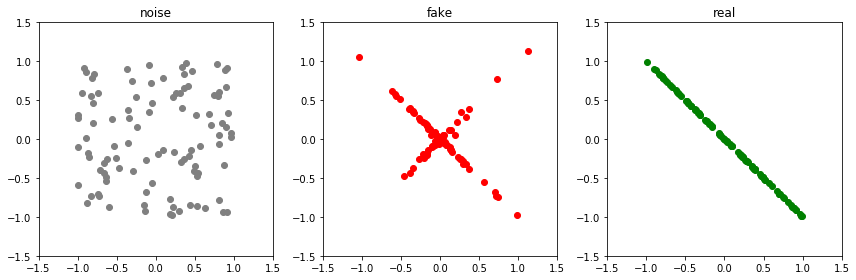

Epoch: 150 G-error: 1.1369528770446777 D-error: 0.9597783088684082


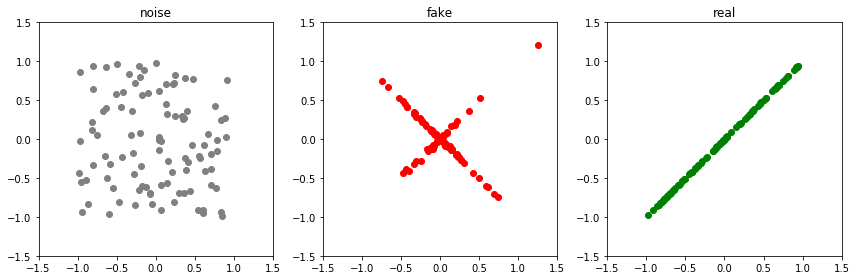

Epoch: 200 G-error: 1.0327914953231812 D-error: 1.8796718120574951


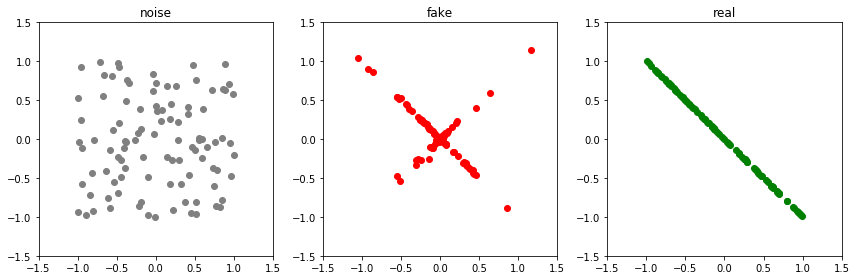

Epoch: 250 G-error: 0.9871618747711182 D-error: 0.9326828718185425


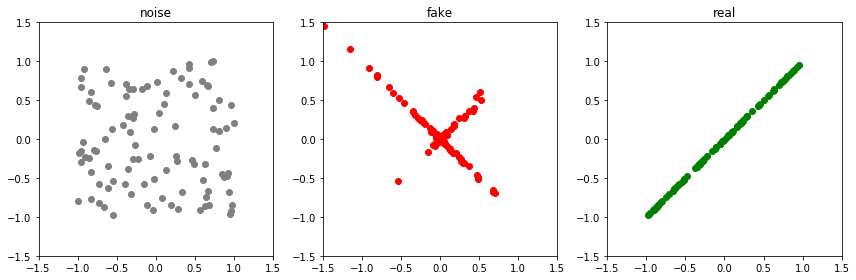

Epoch: 300 G-error: 1.0225343704223633 D-error: 1.643473505973816


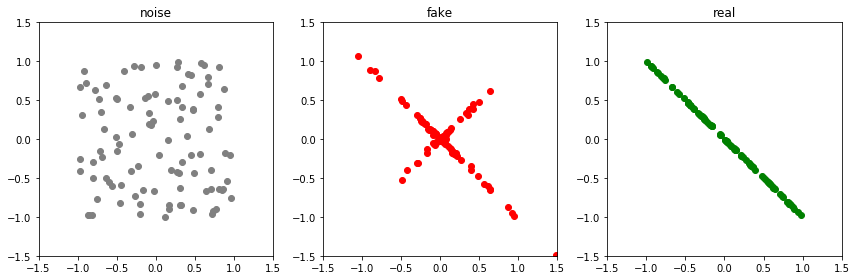

Epoch: 350 G-error: 0.9537478685379028 D-error: 0.9982378482818604


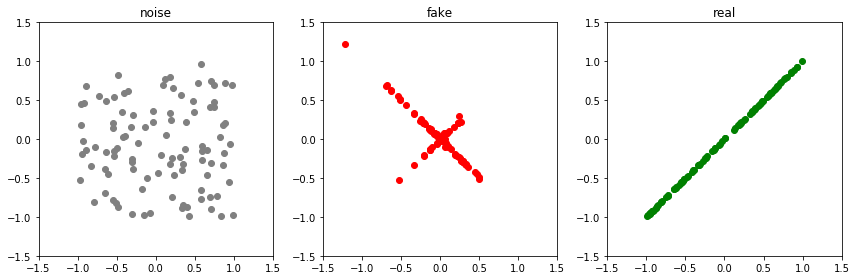

Epoch: 400 G-error: 0.9815323352813721 D-error: 1.2949538230895996


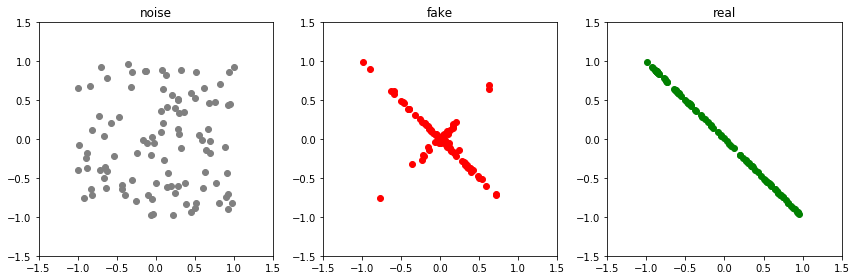

Epoch: 450 G-error: 0.9935280680656433 D-error: 0.96082603931427


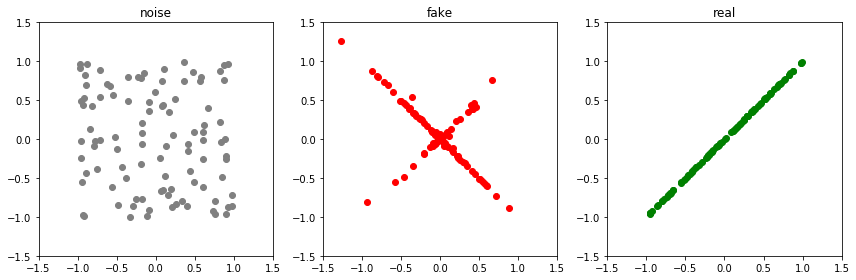

Epoch: 500 G-error: 1.031264066696167 D-error: 1.3747076988220215


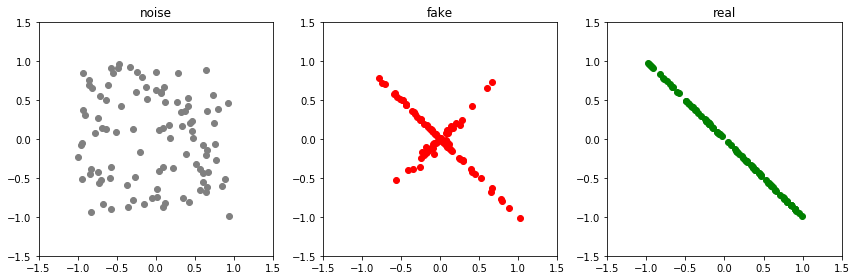

Epoch: 550 G-error: 1.0375844240188599 D-error: 1.0478918552398682


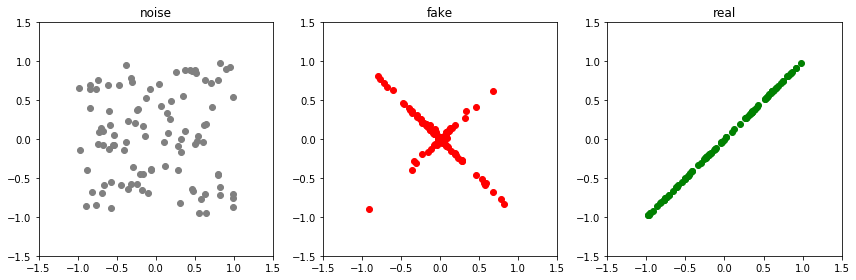

Epoch: 600 G-error: 1.0118693113327026 D-error: 1.226059913635254


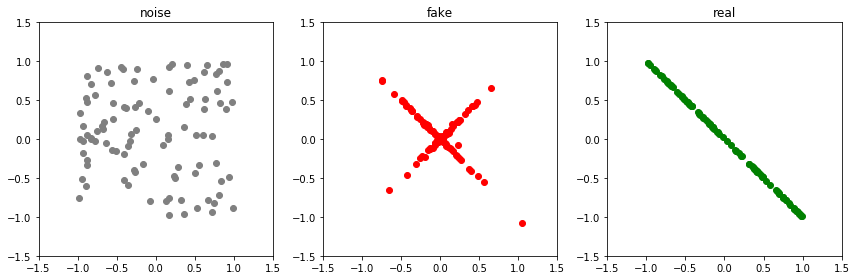

Epoch: 650 G-error: 1.0323368310928345 D-error: 1.0452754497528076


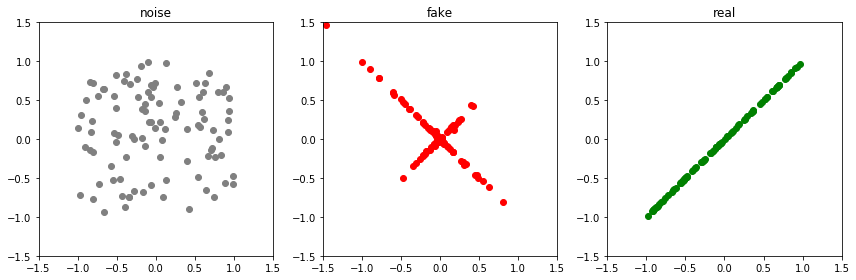

Epoch: 700 G-error: 1.013644814491272 D-error: 1.0760416984558105


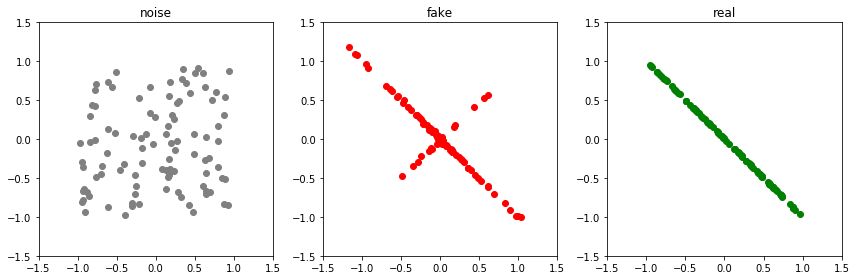

Epoch: 750 G-error: 1.0054519176483154 D-error: 1.0699036121368408


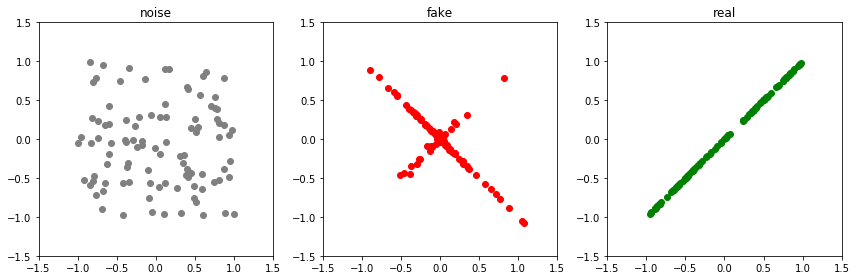

Epoch: 800 G-error: 1.0140587091445923 D-error: 0.9849960803985596


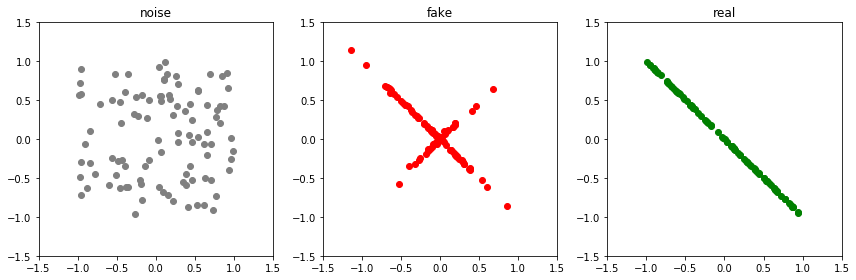

Epoch: 850 G-error: 0.9708034992218018 D-error: 1.1214747428894043


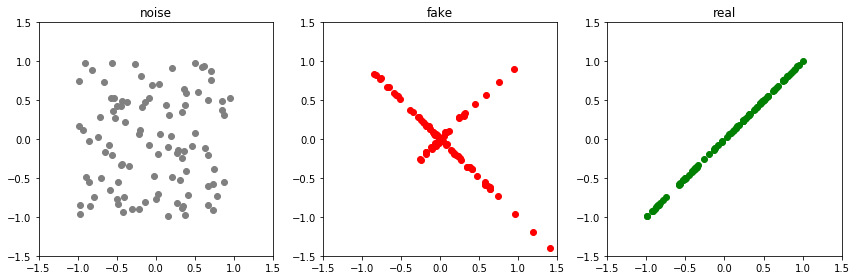

Epoch: 900 G-error: 0.9640753865242004 D-error: 0.9852257966995239


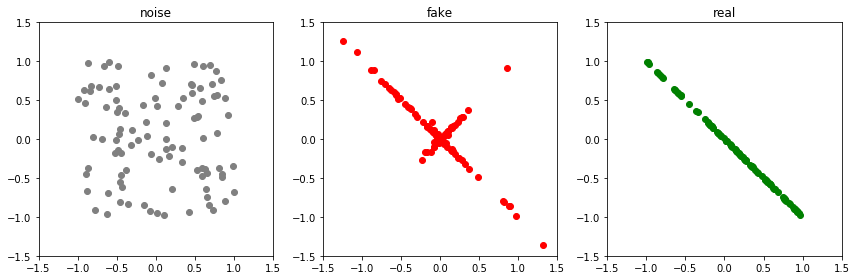

Epoch: 950 G-error: 1.09242582321167 D-error: 1.1990467309951782


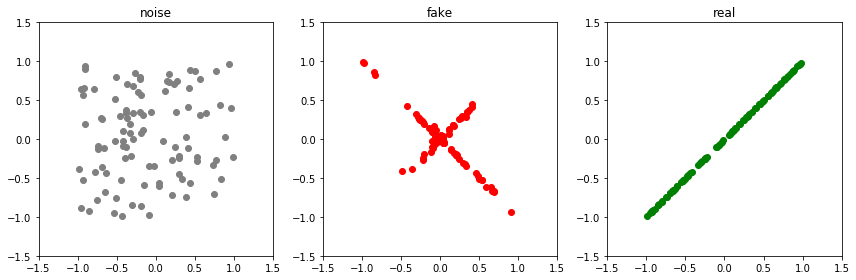

Epoch: 1000 G-error: 1.0966498851776123 D-error: 0.9082868099212646


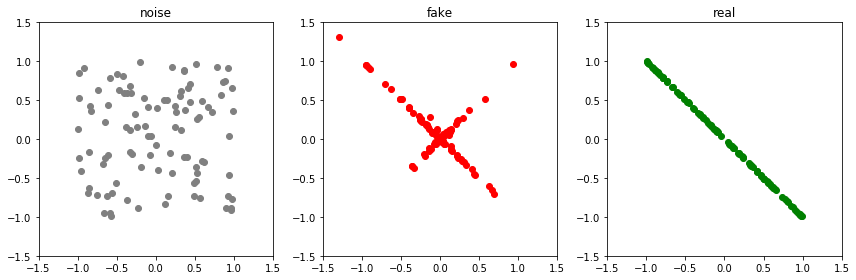

Epoch: 1050 G-error: 1.1209688186645508 D-error: 1.1401472091674805


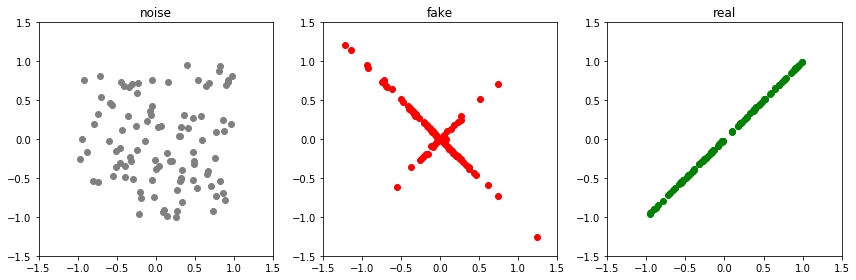

Epoch: 1100 G-error: 0.9743679165840149 D-error: 0.9771244525909424


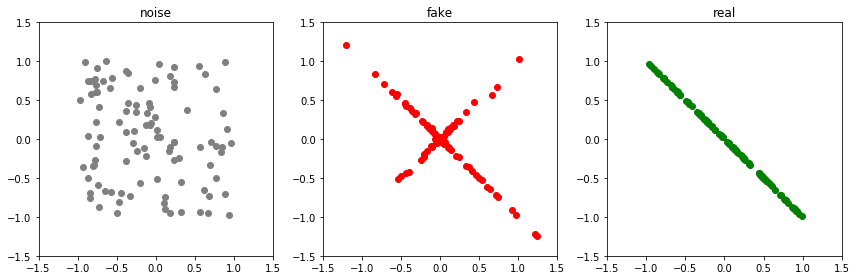

Epoch: 1150 G-error: 1.0120083093643188 D-error: 1.1402698755264282


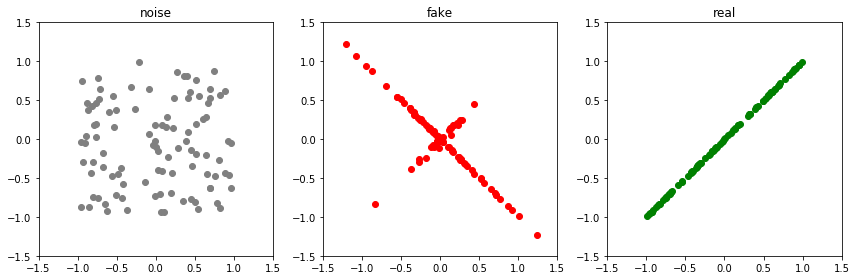

Epoch: 1200 G-error: 0.9941724538803101 D-error: 0.9259983897209167


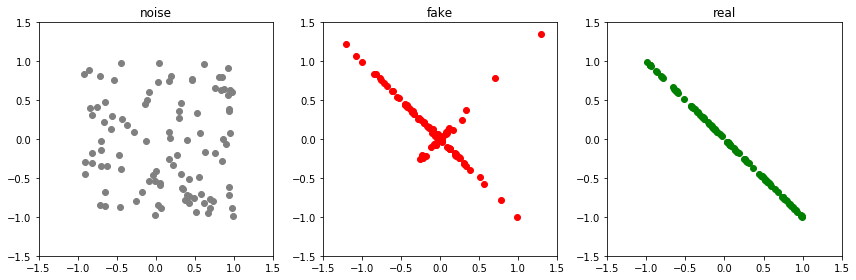

Epoch: 1250 G-error: 1.038935899734497 D-error: 1.2010728120803833


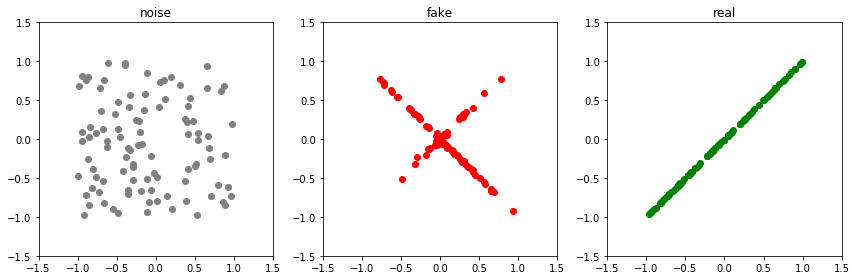

Epoch: 1300 G-error: 1.0356212854385376 D-error: 0.9404275417327881


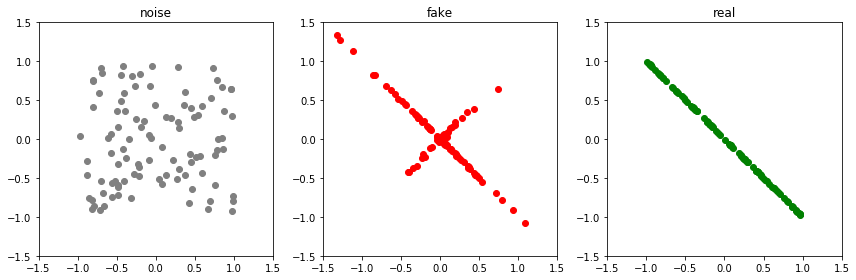

Epoch: 1350 G-error: 1.0226954221725464 D-error: 1.174399733543396


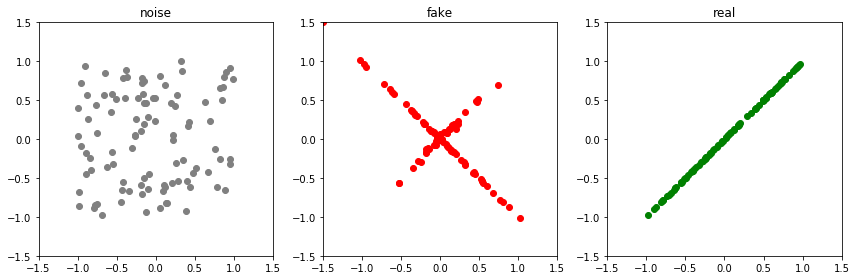

Epoch: 1400 G-error: 1.0279650688171387 D-error: 0.9656710624694824


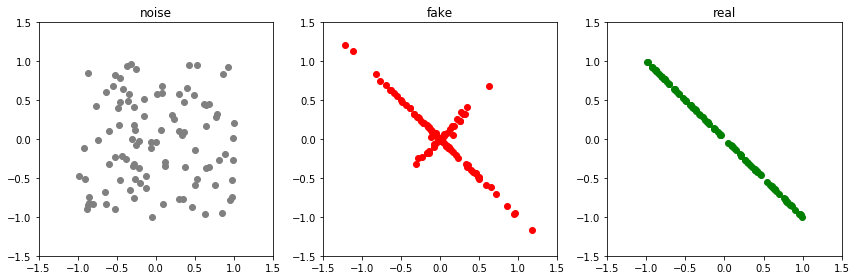

Epoch: 1450 G-error: 1.0549585819244385 D-error: 1.2027719020843506


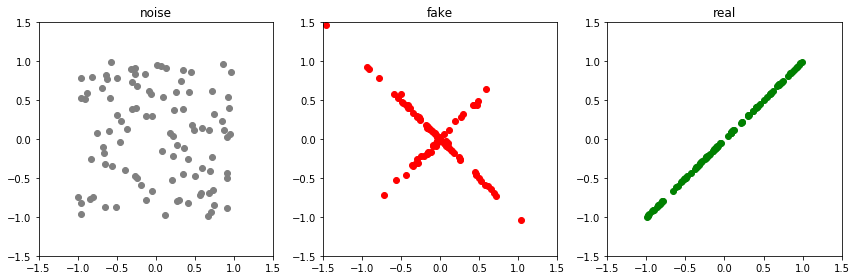

Epoch: 1500 G-error: 1.035933017730713 D-error: 0.93651282787323


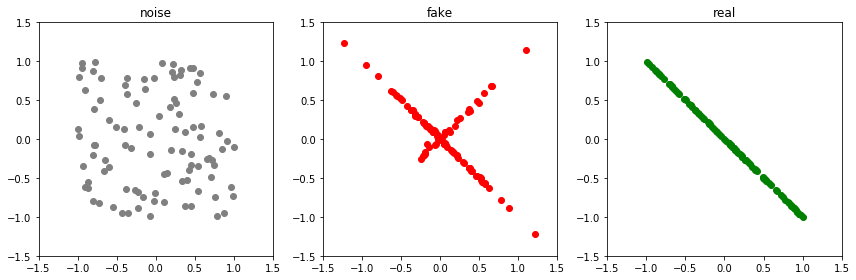

Epoch: 1550 G-error: 1.014198660850525 D-error: 1.2409803867340088


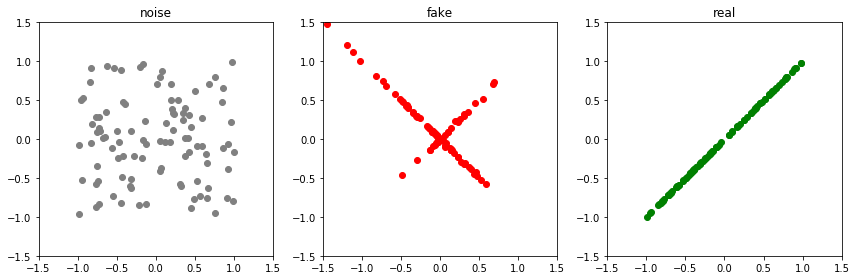

Epoch: 1600 G-error: 1.0358949899673462 D-error: 0.8535236716270447


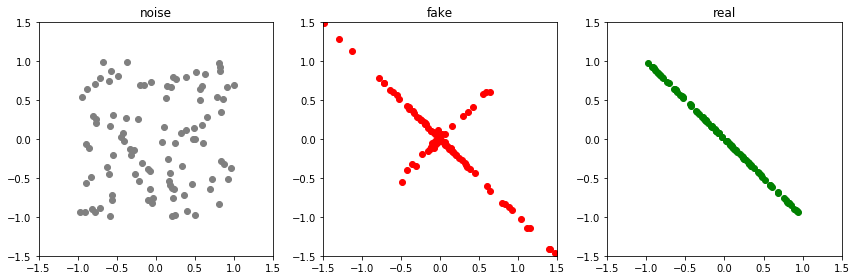

Epoch: 1650 G-error: 1.0703548192977905 D-error: 1.28025221824646


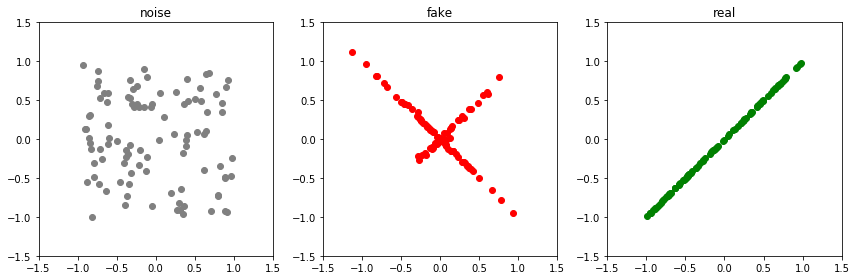

Epoch: 1700 G-error: 1.070969581604004 D-error: 0.8593012094497681


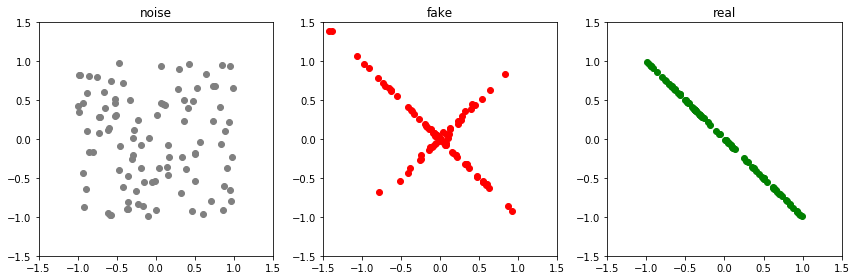

Epoch: 1750 G-error: 1.0162092447280884 D-error: 1.2655081748962402


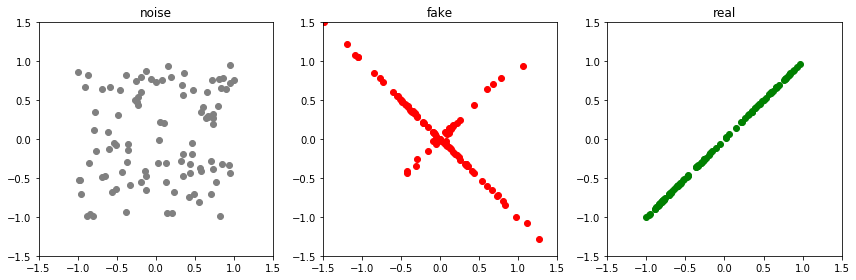

Epoch: 1800 G-error: 0.9503358602523804 D-error: 0.7578147649765015


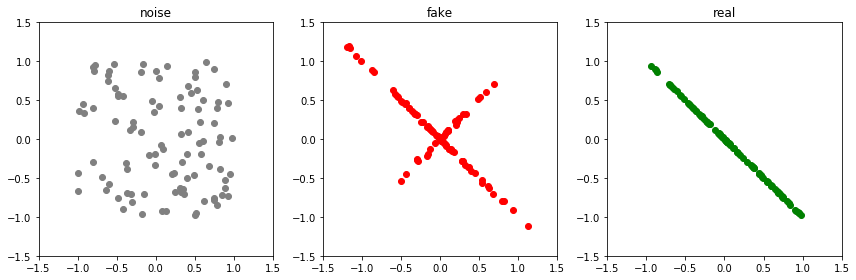

Epoch: 1850 G-error: 0.9926090836524963 D-error: 1.3683643341064453


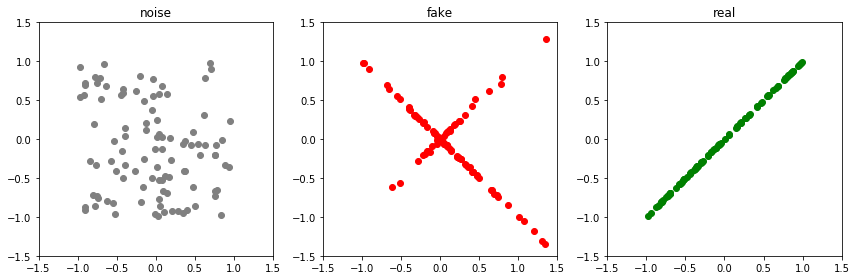

Epoch: 1900 G-error: 0.9821245670318604 D-error: 0.8821658492088318


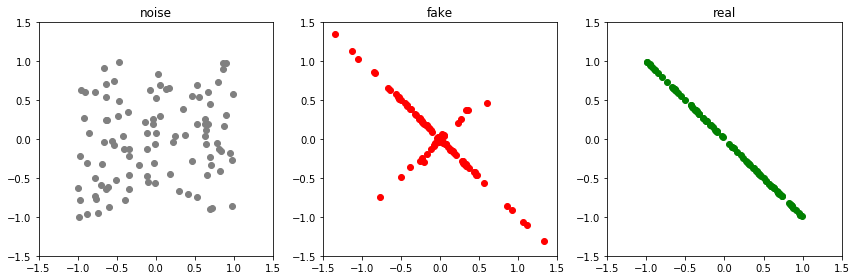

Epoch: 1950 G-error: 1.0656189918518066 D-error: 1.2082228660583496


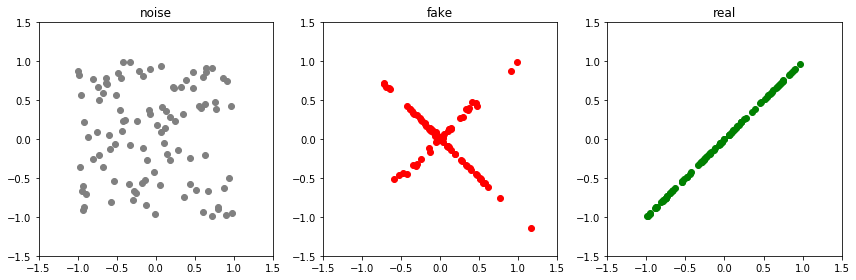

Epoch: 2000 G-error: 1.0355472564697266 D-error: 0.9365460872650146


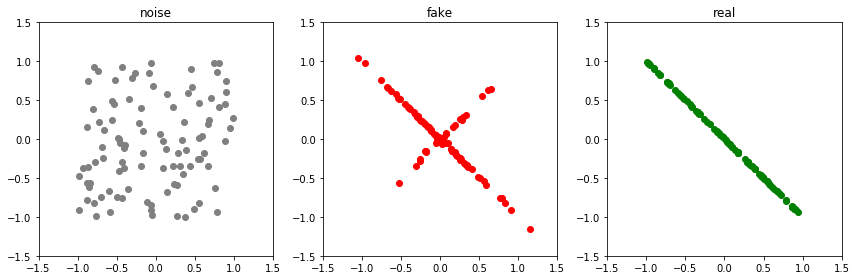

Epoch: 2050 G-error: 1.0059491395950317 D-error: 1.2340292930603027


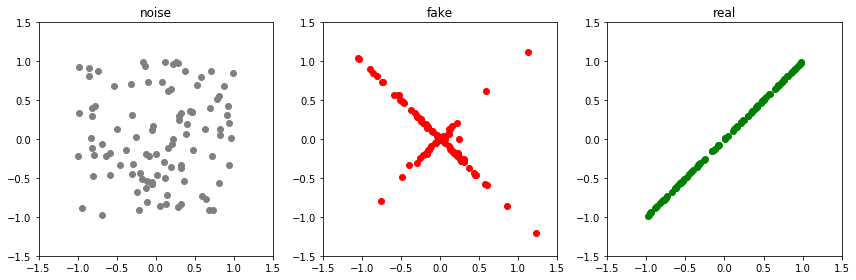

Epoch: 2100 G-error: 1.1248449087142944 D-error: 0.862195611000061


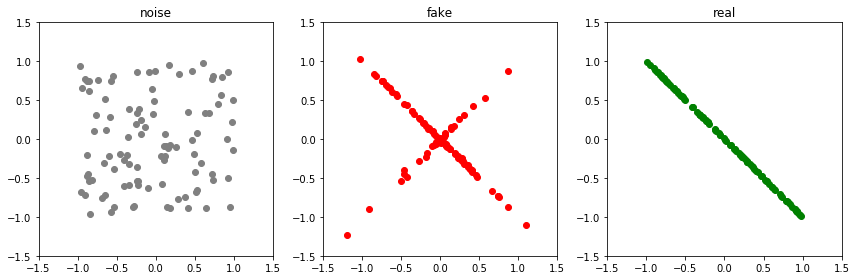

Epoch: 2150 G-error: 0.9638352990150452 D-error: 1.2021410465240479


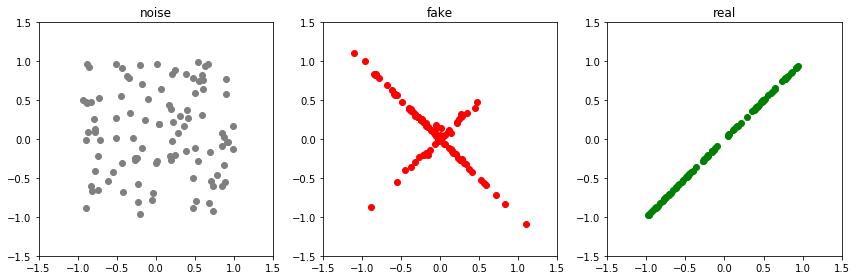

Epoch: 2200 G-error: 1.0720406770706177 D-error: 0.9084522724151611


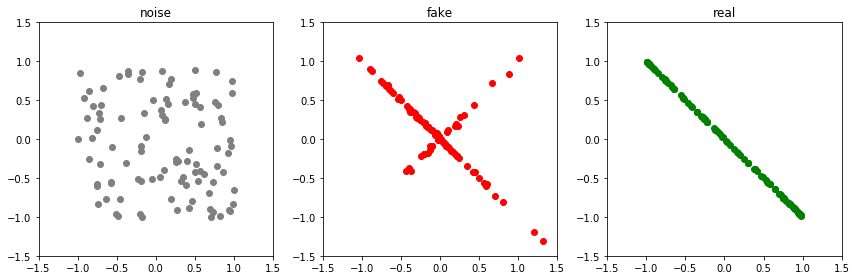

Epoch: 2250 G-error: 1.0484660863876343 D-error: 1.2057214975357056


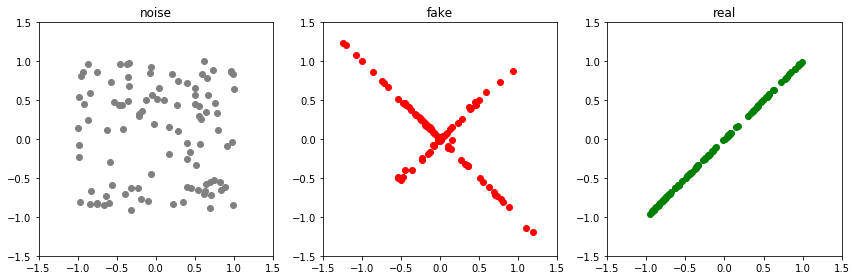

Epoch: 2300 G-error: 0.9785742163658142 D-error: 0.870388388633728


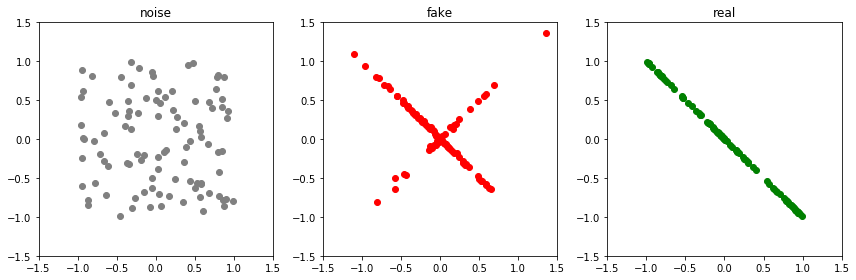

Epoch: 2350 G-error: 1.0280029773712158 D-error: 1.2743151187896729


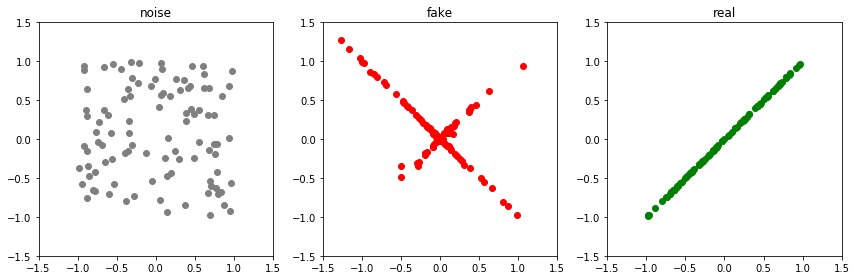

Epoch: 2400 G-error: 1.0644859075546265 D-error: 0.9003939628601074


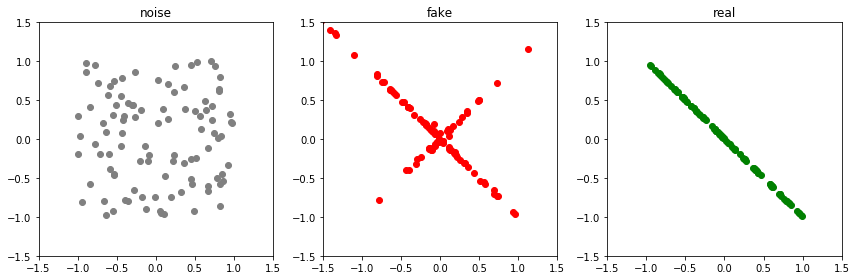

Epoch: 2450 G-error: 1.042039394378662 D-error: 1.348794937133789


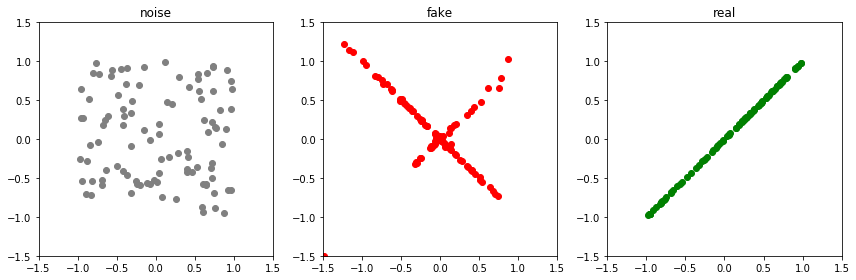

Epoch: 2500 G-error: 1.014207363128662 D-error: 0.9011138677597046


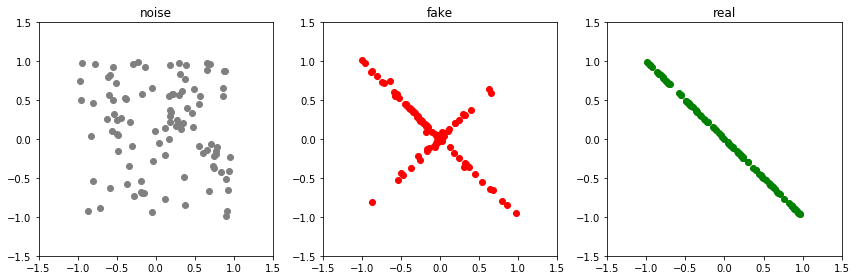

Epoch: 2550 G-error: 1.1014769077301025 D-error: 1.2020418643951416


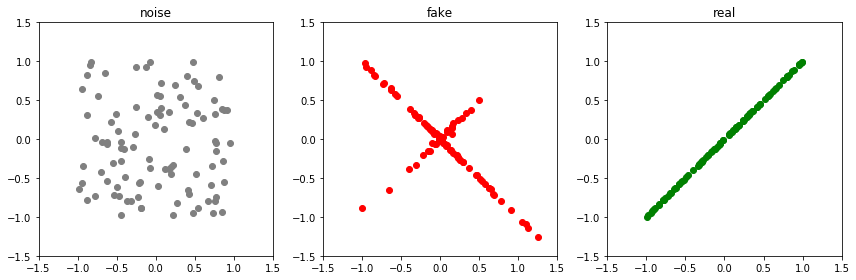

Epoch: 2600 G-error: 1.0022954940795898 D-error: 0.8860468864440918


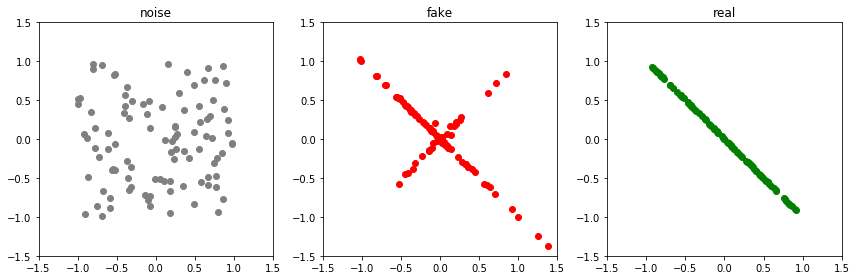

Epoch: 2650 G-error: 1.061533808708191 D-error: 1.2545909881591797


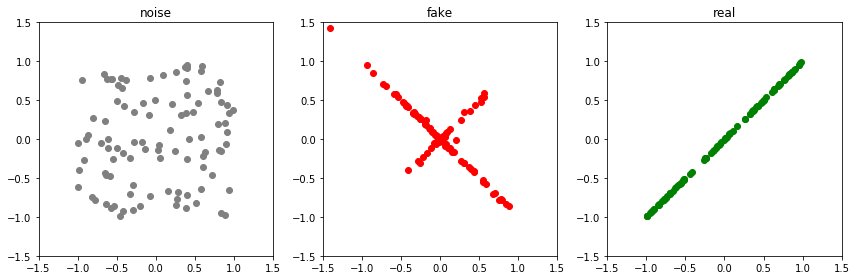

Epoch: 2700 G-error: 1.032893180847168 D-error: 0.889443039894104


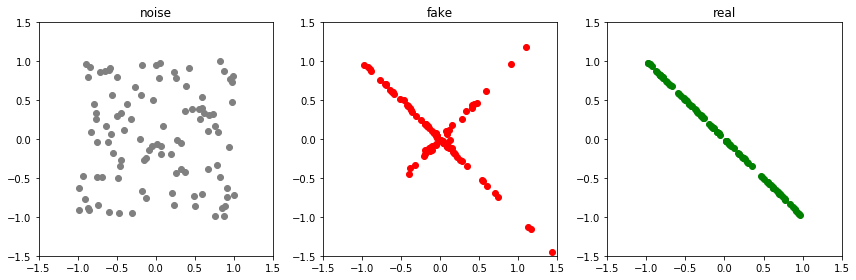

Epoch: 2750 G-error: 1.0814845561981201 D-error: 1.2468911409378052


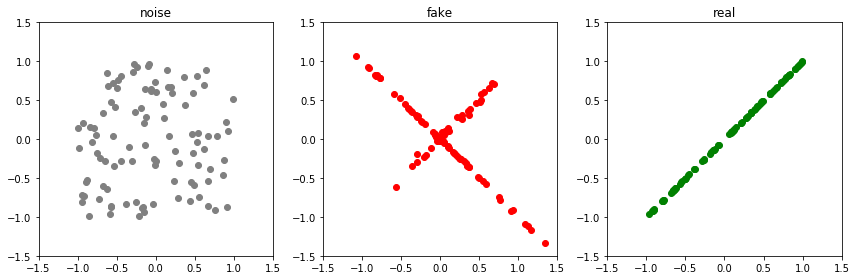

Epoch: 2800 G-error: 0.9905025959014893 D-error: 0.839711606502533


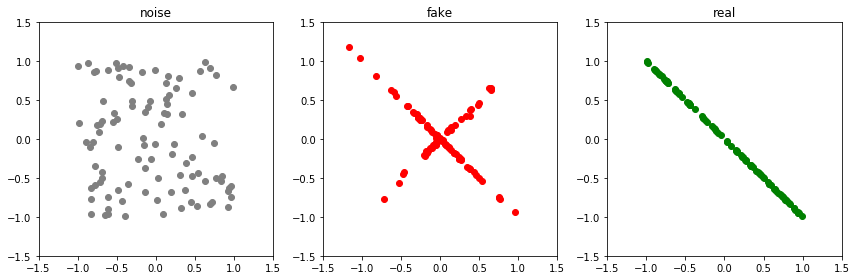

Epoch: 2850 G-error: 1.008631706237793 D-error: 1.180745005607605


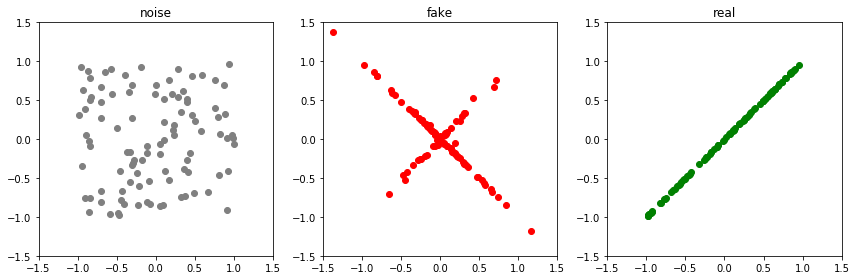

Epoch: 2900 G-error: 1.0676058530807495 D-error: 0.8799118995666504


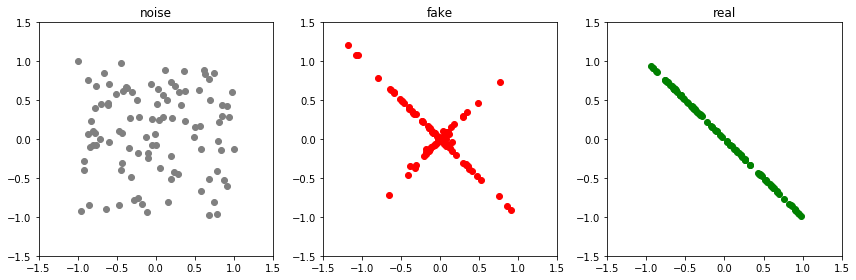

Epoch: 2950 G-error: 1.086402416229248 D-error: 1.2412141561508179


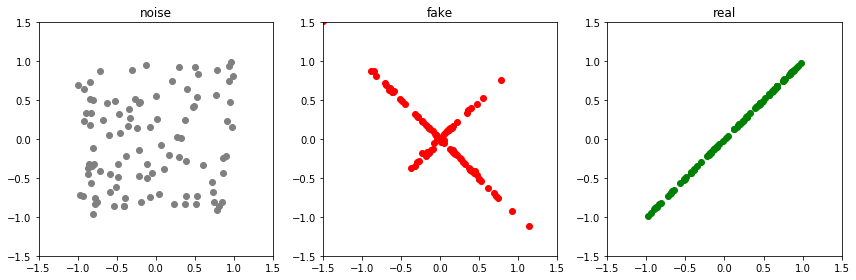

Epoch: 3000 G-error: 0.9911085367202759 D-error: 0.9134443998336792


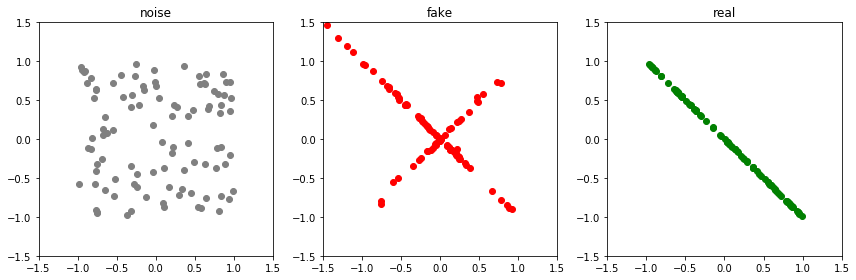

Epoch: 3050 G-error: 1.001364827156067 D-error: 1.2551069259643555


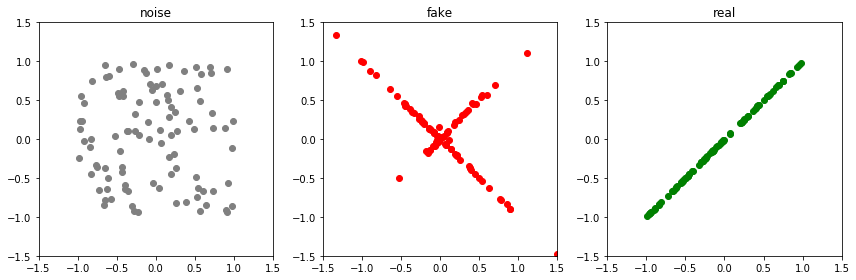

Epoch: 3100 G-error: 1.0378012657165527 D-error: 0.9137506484985352


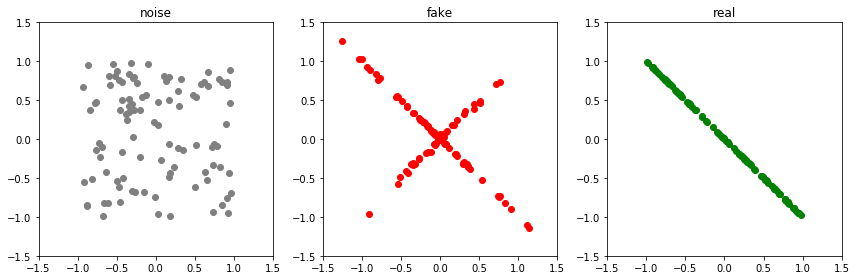

Epoch: 3150 G-error: 1.0005717277526855 D-error: 1.2070369720458984


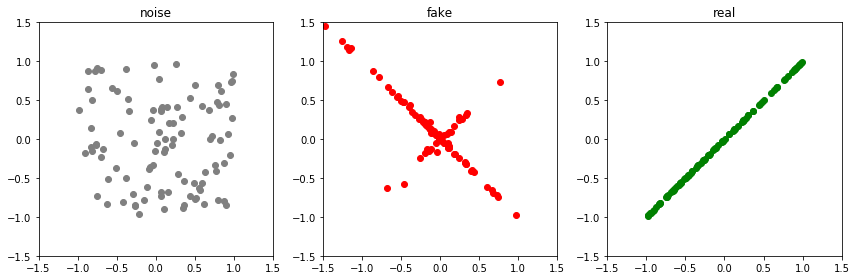

Epoch: 3200 G-error: 1.1620739698410034 D-error: 0.895085871219635


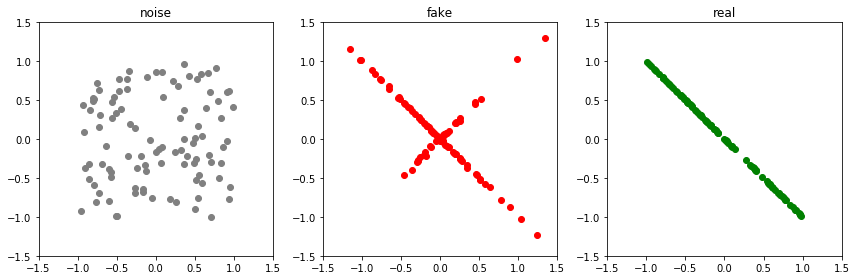

Epoch: 3250 G-error: 0.9789714217185974 D-error: 1.1962354183197021


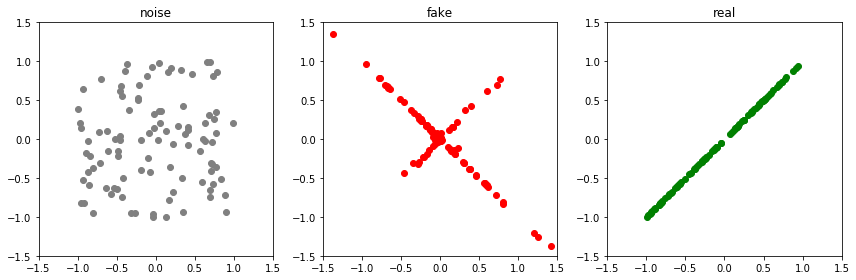

Epoch: 3300 G-error: 1.0751917362213135 D-error: 0.7978461384773254


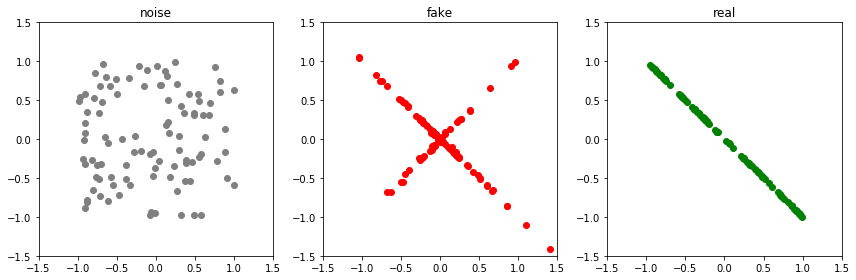

Epoch: 3350 G-error: 0.9941716194152832 D-error: 1.2188153266906738


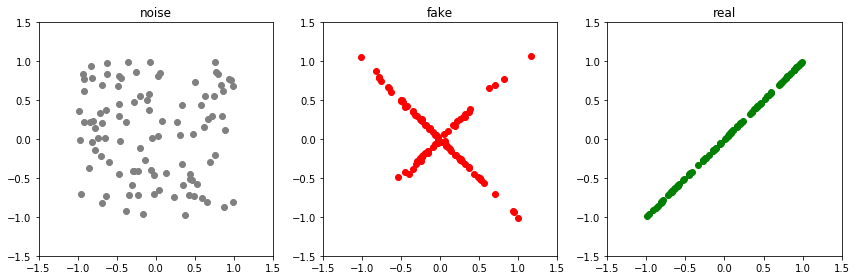

Epoch: 3400 G-error: 0.9442389011383057 D-error: 0.9015967845916748


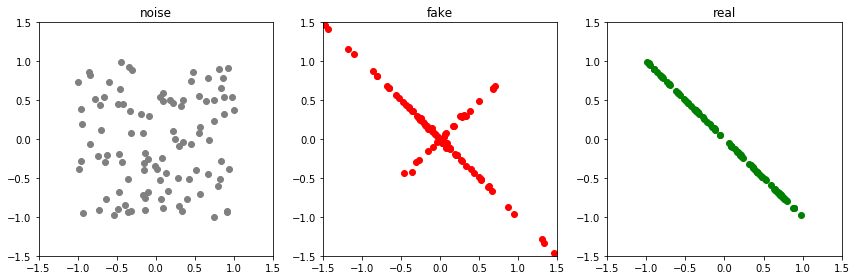

Epoch: 3450 G-error: 1.0292367935180664 D-error: 1.1762479543685913


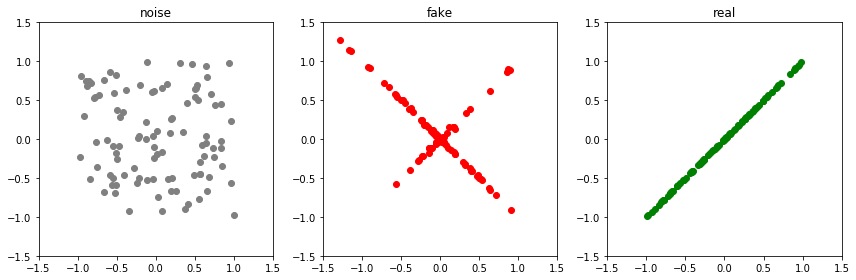

Epoch: 3500 G-error: 1.0503982305526733 D-error: 1.0192979574203491


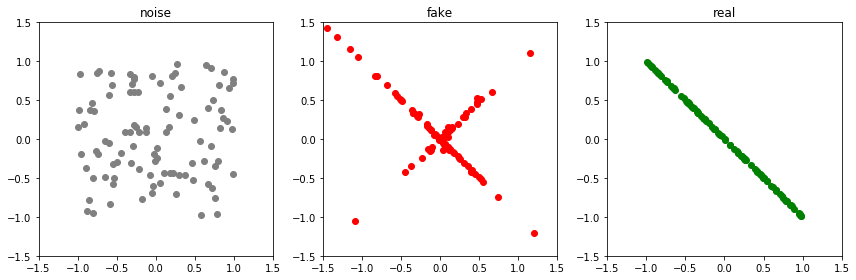

Epoch: 3550 G-error: 1.0954716205596924 D-error: 1.2265353202819824


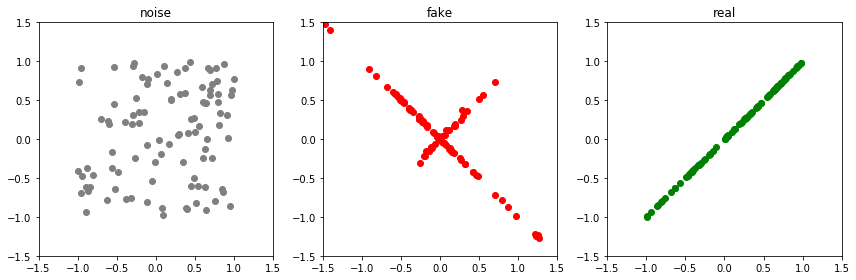

Epoch: 3600 G-error: 1.033275842666626 D-error: 0.8963537812232971


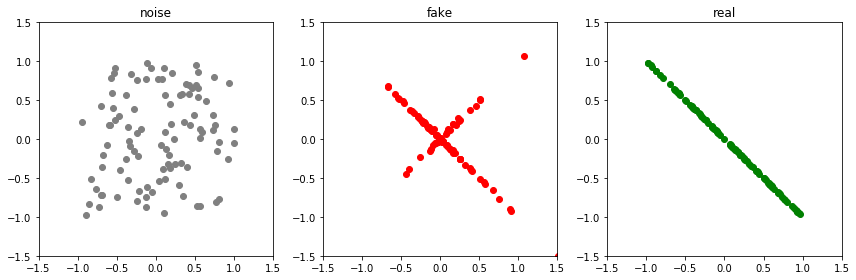

Epoch: 3650 G-error: 1.0632827281951904 D-error: 1.2354768514633179


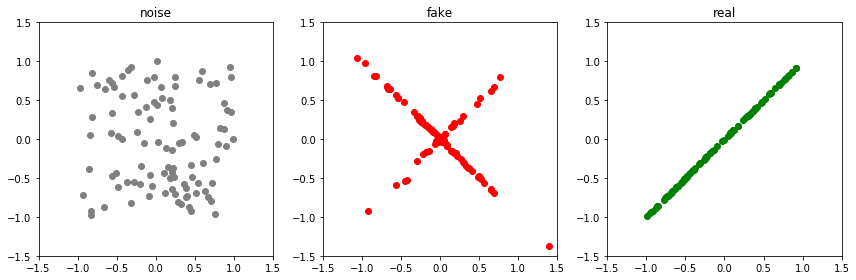

Epoch: 3700 G-error: 1.0332340002059937 D-error: 0.9362697601318359


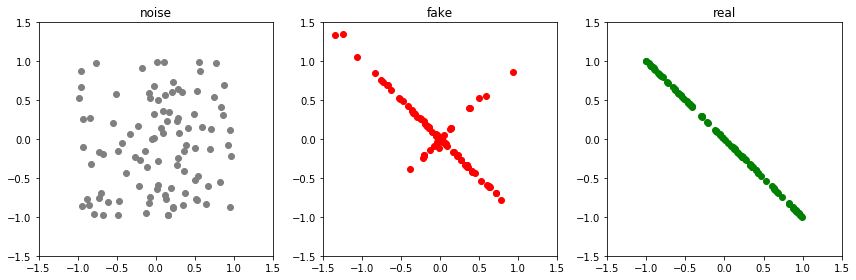

Epoch: 3750 G-error: 1.0960195064544678 D-error: 1.26808500289917


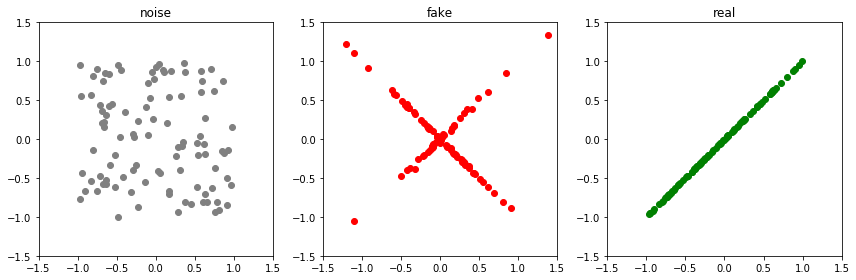

Epoch: 3800 G-error: 1.0156766176223755 D-error: 0.9748887419700623


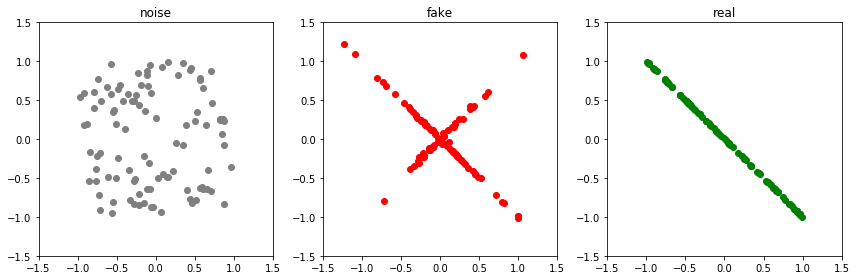

Epoch: 3850 G-error: 1.0037424564361572 D-error: 1.2406609058380127


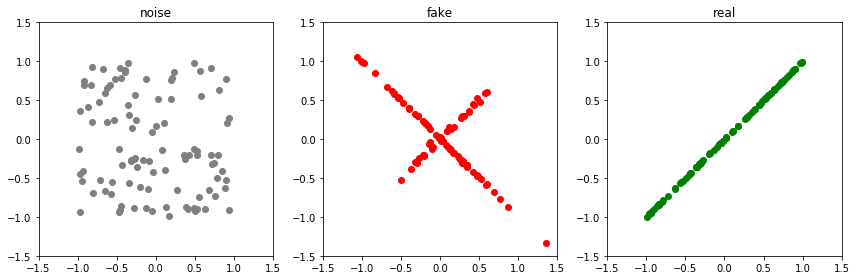

Epoch: 3900 G-error: 0.99744713306427 D-error: 0.9172913432121277


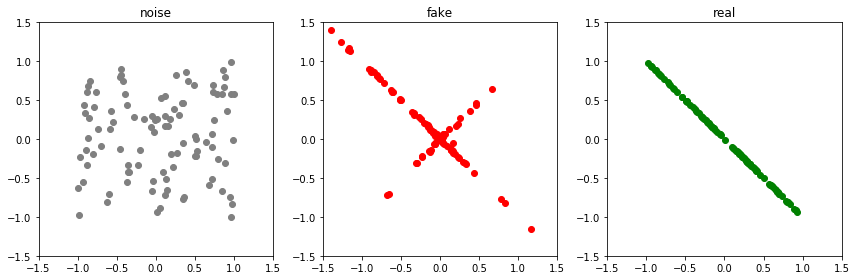

Epoch: 3950 G-error: 1.0911712646484375 D-error: 1.2666137218475342


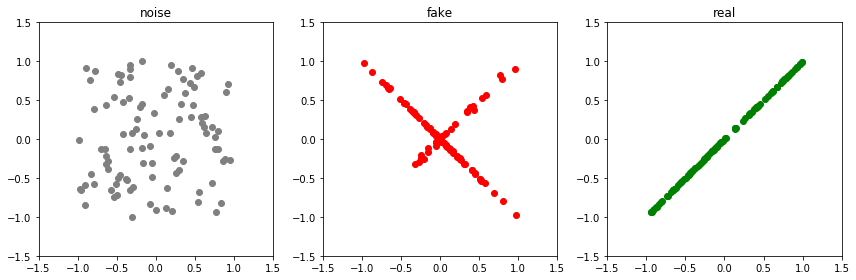

Epoch: 4000 G-error: 1.0046013593673706 D-error: 0.8908014297485352


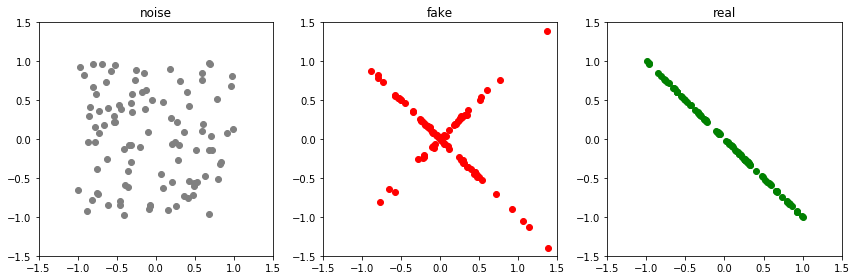

Epoch: 4050 G-error: 0.9459388852119446 D-error: 1.227283000946045


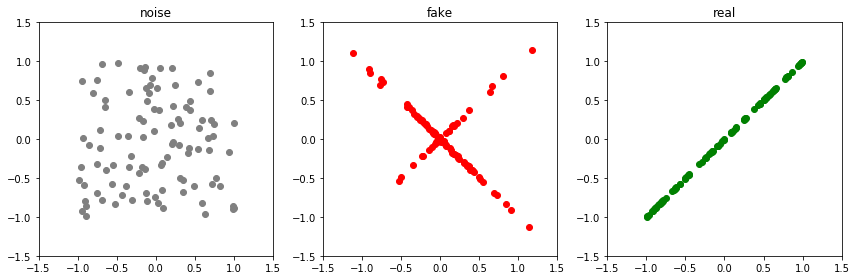

Epoch: 4100 G-error: 1.0189106464385986 D-error: 0.8801689743995667


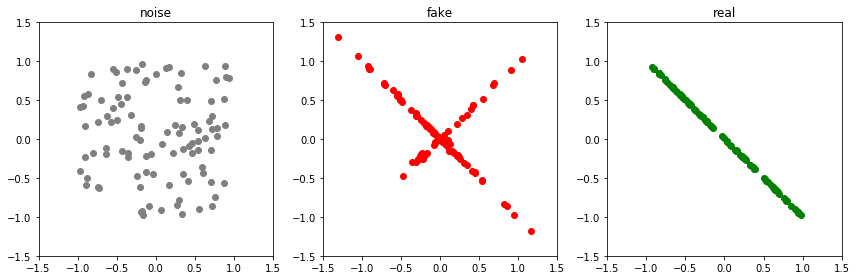

Epoch: 4150 G-error: 1.0385596752166748 D-error: 1.2985239028930664


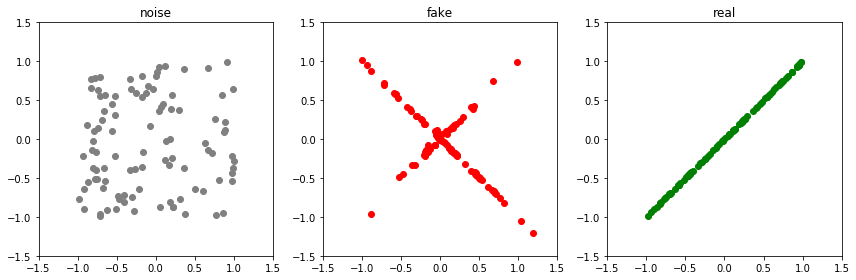

Epoch: 4200 G-error: 1.0051630735397339 D-error: 0.9278975129127502


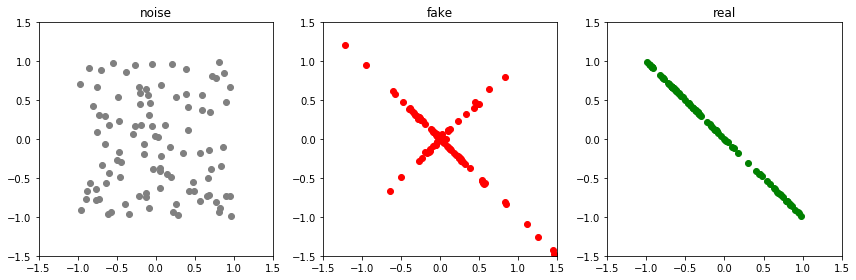

Epoch: 4250 G-error: 1.0842859745025635 D-error: 1.2008179426193237


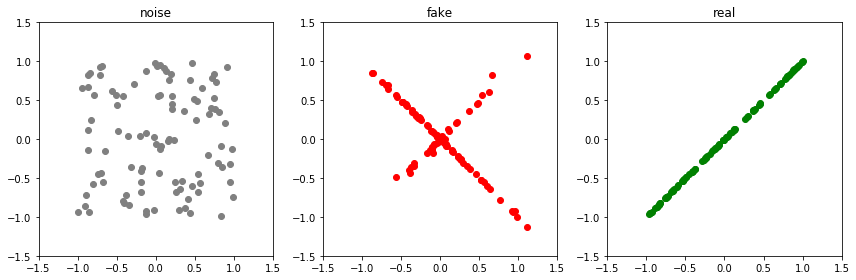

Epoch: 4300 G-error: 1.0099575519561768 D-error: 0.8738884925842285


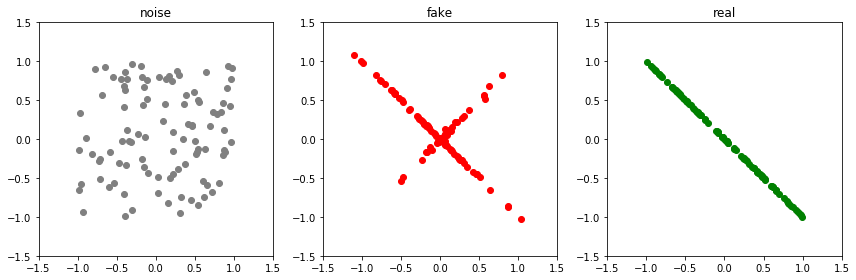

Epoch: 4350 G-error: 1.0342419147491455 D-error: 1.2757136821746826


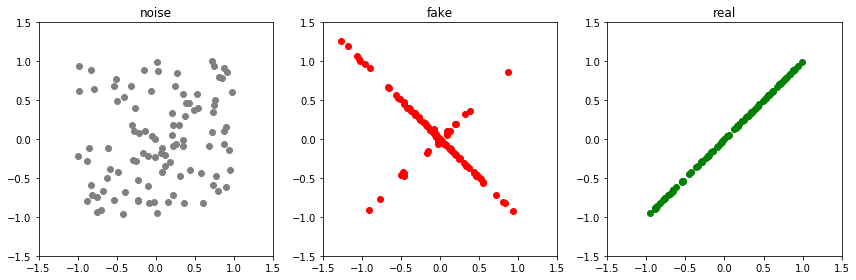

Epoch: 4400 G-error: 0.9870269894599915 D-error: 0.8870137929916382


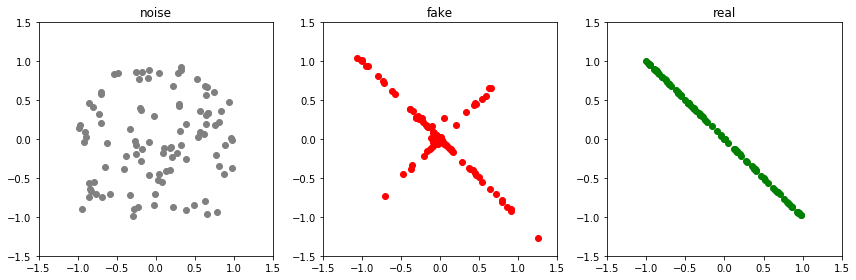

Epoch: 4450 G-error: 1.1035585403442383 D-error: 1.235569953918457


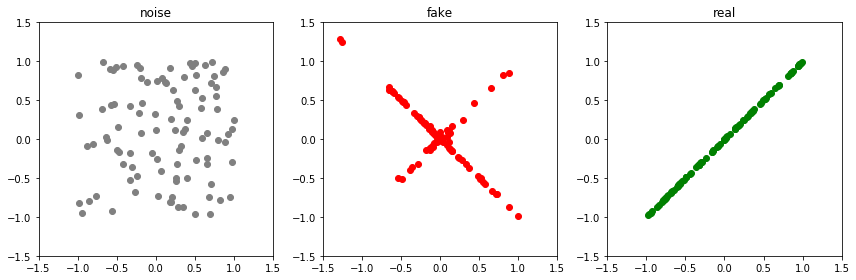

Epoch: 4500 G-error: 1.0375477075576782 D-error: 0.8920328617095947


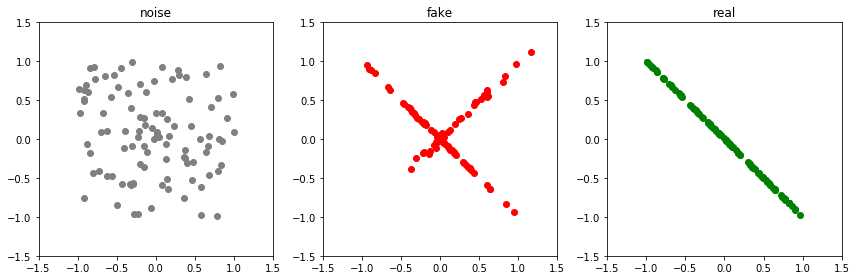

Epoch: 4550 G-error: 1.0352779626846313 D-error: 1.3175480365753174


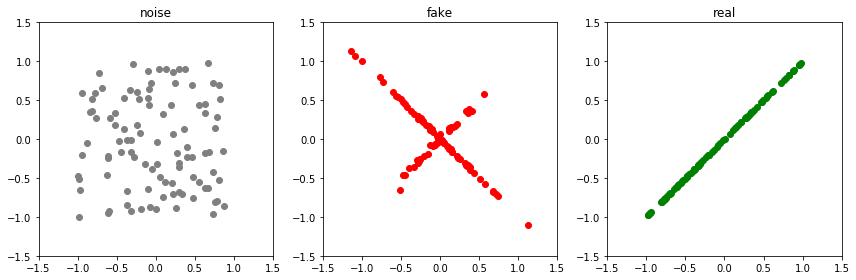

Epoch: 4600 G-error: 1.0078539848327637 D-error: 0.8664491772651672


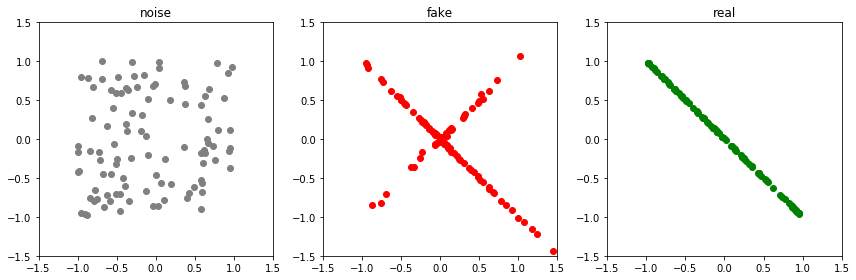

Epoch: 4650 G-error: 0.9407849311828613 D-error: 1.2154563665390015


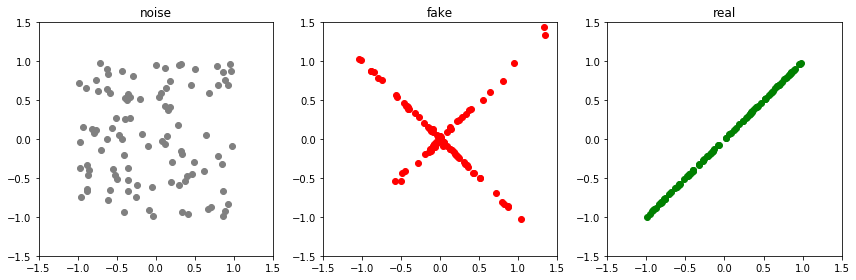

Epoch: 4700 G-error: 1.0182478427886963 D-error: 0.8991589546203613


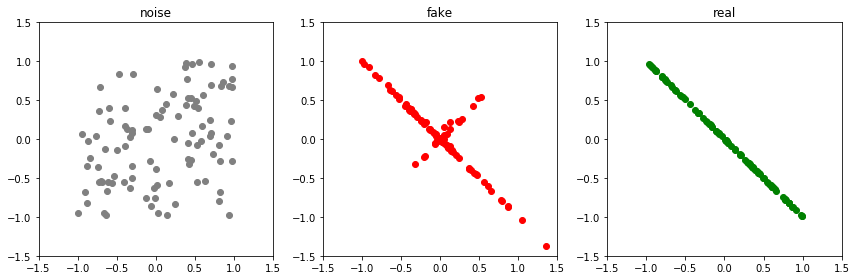

Epoch: 4750 G-error: 1.0975422859191895 D-error: 1.2340657711029053


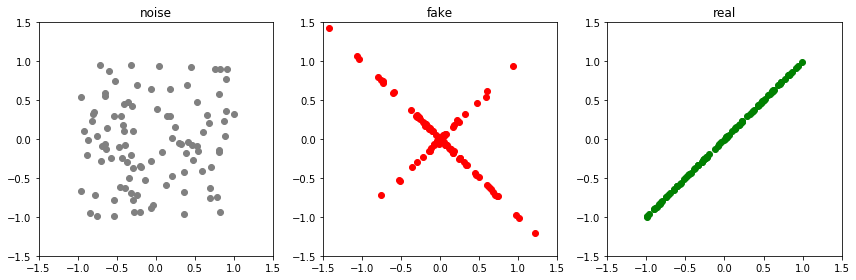

Epoch: 4800 G-error: 0.9742633700370789 D-error: 0.9269395470619202


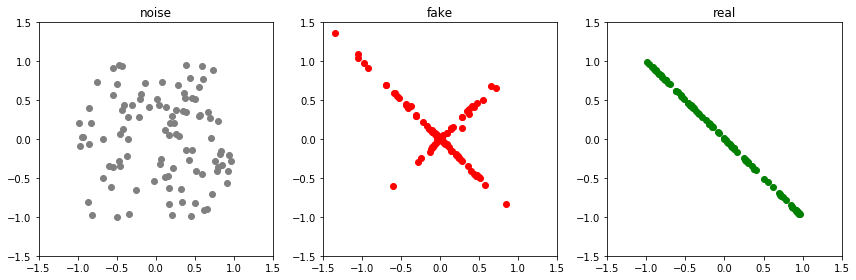

Epoch: 4850 G-error: 1.087825059890747 D-error: 1.2472712993621826


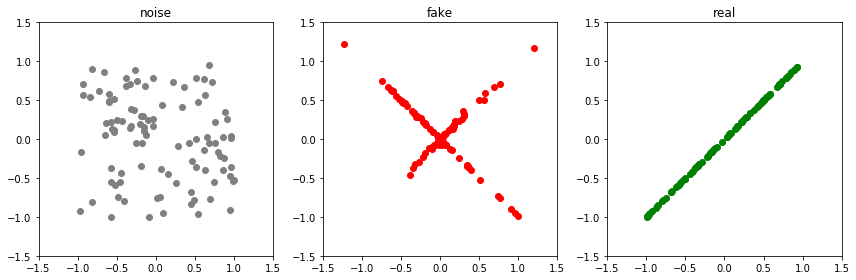

Epoch: 4900 G-error: 0.9886611700057983 D-error: 0.8529260158538818


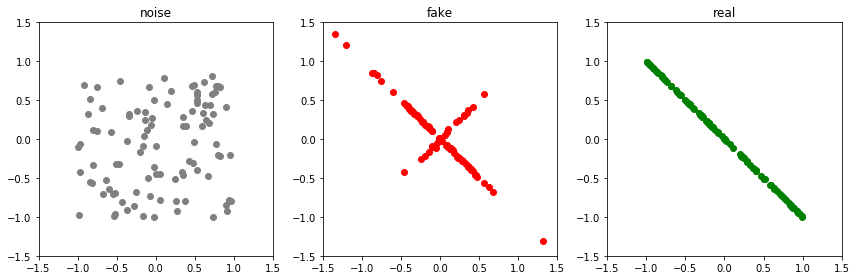

Epoch: 4950 G-error: 1.0166757106781006 D-error: 1.2183876037597656


In [14]:
num_epochs = 5000
real_sample_size = 100
noise_sample_size = real_sample_size

for epoch in range(num_epochs):
    
    # real data
    if epoch%20<10:
        base = np.random.uniform(-1,1,(real_sample_size,1)).astype('float32')
        data = np.concatenate((base, base),axis=1)
        real_data = t.from_numpy(data)
    else:
        base = np.random.uniform(-1,1,(real_sample_size,1)).astype('float32')
        data = np.concatenate((base, (-1)*base),axis=1)
        real_data = t.from_numpy(data)
        
    # train discriminator:
    noise = t.empty(noise_sample_size,2, device=device).uniform_(-1,1)
    fake_data = generator(noise)  
    d_error = train_discriminator(d_optimizer, real_data, fake_data)
    

    # train generator     
    noise = t.empty(noise_sample_size,2, device=device).uniform_(-1,1)
    fake_data = generator(noise)  
    g_error = train_generator(g_optimizer, fake_data)
 
    if epoch%50 ==0:
        show(noise, fake_data, real_data)
        print(f"Epoch: {epoch} G-error: {g_error.item()} D-error: {d_error.item()}")


## Final result

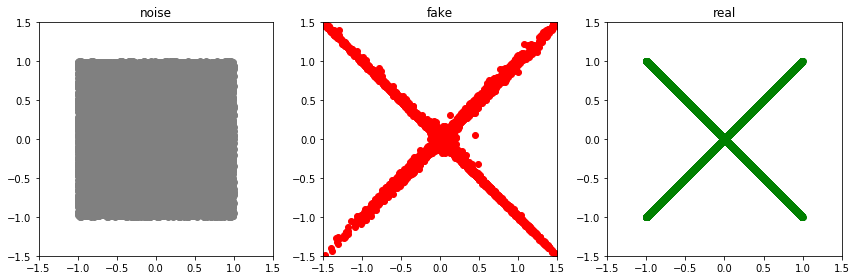

In [16]:
real_sample_size = 10000
noise_sample_size = 2*real_sample_size

#real data
base = np.random.uniform(-1,1,(real_sample_size,1)).astype('float32')
data1 = np.concatenate((base, base),axis=1)
data2 = np.concatenate((base, (-1)*base),axis=1)
data = np.concatenate((data1, data2),axis=0)
np.random.shuffle(data)
real_data = t.from_numpy(data)
    
#fake data:
noise = t.empty(noise_sample_size,2, device=device).uniform_(-1,1)
fake_data = generator(noise).detach()

show(noise, fake_data, real_data)

## Saving the model

In [17]:
t.save(discriminator, "discriminator_cross")
t.save(generator, "generator_cross")

model_d = t.load("discriminator_cross")
model_g = t.load("generator_cross")

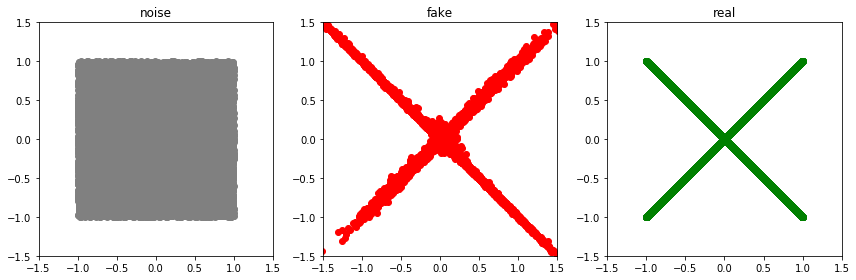

In [19]:
real_sample_size = 10000
noise_sample_size = 2*real_sample_size

#real data
base = np.random.uniform(-1,1,(real_sample_size,1)).astype('float32')
data1 = np.concatenate((base, base),axis=1)
data2 = np.concatenate((base, (-1)*base),axis=1)
data = np.concatenate((data1, data2),axis=0)
np.random.shuffle(data)
real_data = t.from_numpy(data)
    
#fake data:
noise = t.empty(noise_sample_size,2, device=device).uniform_(-1,1)
fake_data = model_g(noise).detach()

show(noise, fake_data, real_data)

### Problem 1

Implement the GAN train loop that will train GAN to generate from the sample distribution.  

### Problem 2

Use another sampling distribution. One that is not concentrated on a line e.g. an ellipse. 